# Your first neural network

In this project, you'll build your first neural network and use it to predict daily bike rental ridership. We've provided some of the code, but left the implementation of the neural network up to you (for the most part). After you've submitted this project, feel free to explore the data and the model more.



In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

## Load and prepare the data

A critical step in working with neural networks is preparing the data correctly. Variables on different scales make it difficult for the network to efficiently learn the correct weights. Below, we've written the code to load and prepare the data. You'll learn more about this soon!

In [2]:
data_path = 'Bike-Sharing-Dataset/hour.csv'

rides = pd.read_csv(data_path)

In [3]:
rides.head()


,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0,8,32,40
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0,5,27,32
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0,3,10,13
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0,0,1,1


## Checking out the data

This dataset has the number of riders for each hour of each day from January 1 2011 to December 31 2012. The number of riders is split between casual and registered, summed up in the `cnt` column. You can see the first few rows of the data above.

Below is a plot showing the number of bike riders over the first 10 days or so in the data set. (Some days don't have exactly 24 entries in the data set, so it's not exactly 10 days.) You can see the hourly rentals here. This data is pretty complicated! The weekends have lower over all ridership and there are spikes when people are biking to and from work during the week. Looking at the data above, we also have information about temperature, humidity, and windspeed, all of these likely affecting the number of riders. You'll be trying to capture all this with your model.

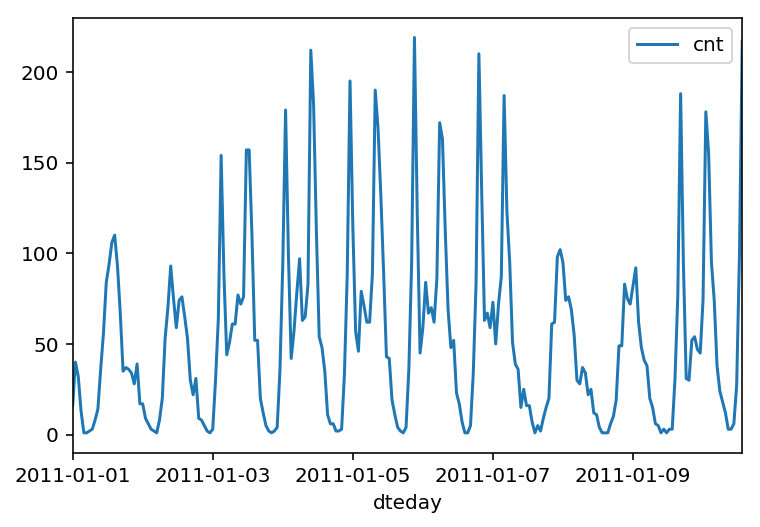

In [4]:
rides[:24*10].plot(x='dteday', y='cnt')

### Dummy variables
Here we have some categorical variables like season, weather, month. To include these in our model, we'll need to make binary dummy variables. This is simple to do with Pandas thanks to `get_dummies()`.

In [5]:
dummy_fields = ['season', 'weathersit', 'mnth', 'hr', 'weekday']
for each in dummy_fields:
    dummies = pd.get_dummies(rides[each], prefix=each, drop_first=False)
    rides = pd.concat([rides, dummies], axis=1)

fields_to_drop = ['instant', 'dteday', 'season', 'weathersit', 
                  'weekday', 'atemp', 'mnth', 'workingday', 'hr']
data = rides.drop(fields_to_drop, axis=1)
data.head()

,yr,holiday,temp,hum,windspeed,casual,registered,cnt,season_1,season_2,...,hr_21,hr_22,hr_23,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6
0,0,0,0.24,0.81,0.0,3,13,16,1,0,...,0,0,0,0,0,0,0,0,0,1
1,0,0,0.22,0.80,0.0,8,32,40,1,0,...,0,0,0,0,0,0,0,0,0,1
2,0,0,0.22,0.80,0.0,5,27,32,1,0,...,0,0,0,0,0,0,0,0,0,1
3,0,0,0.24,0.75,0.0,3,10,13,1,0,...,0,0,0,0,0,0,0,0,0,1
4,0,0,0.24,0.75,0.0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,1


### Scaling target variables
To make training the network easier, we'll standardize each of the continuous variables. That is, we'll shift and scale the variables such that they have zero mean and a standard deviation of 1.

The scaling factors are saved so we can go backwards when we use the network for predictions.

In [6]:
quant_features = ['casual', 'registered', 'cnt', 'temp', 'hum', 'windspeed']
# Store scalings in a dictionary so we can convert back later
scaled_features = {}
for each in quant_features:
    mean, std = data[each].mean(), data[each].std()
    scaled_features[each] = [mean, std]
    data.loc[:, each] = (data[each] - mean)/std

### Splitting the data into training, testing, and validation sets

We'll save the data for the last approximately 21 days to use as a test set after we've trained the network. We'll use this set to make predictions and compare them with the actual number of riders.

In [7]:
# Save data for approximately the last 21 days 
test_data = data[-21*24:]

# Now remove the test data from the data set 
data = data[:-21*24]

# Separate the data into features and targets
target_fields = ['cnt', 'casual', 'registered']
features, targets = data.drop(target_fields, axis=1), data[target_fields]
test_features, test_targets = test_data.drop(target_fields, axis=1), test_data[target_fields]

We'll split the data into two sets, one for training and one for validating as the network is being trained. Since this is time series data, we'll train on historical data, then try to predict on future data (the validation set).

In [8]:
# Hold out the last 60 days or so of the remaining data as a validation set
train_features, train_targets = features[:-60*24], targets[:-60*24]
val_features, val_targets = features[-60*24:], targets[-60*24:]

## Time to build the network

Below you'll build your network. We've built out the structure and the backwards pass. You'll implement the forward pass through the network. You'll also set the hyperparameters: the learning rate, the number of hidden units, and the number of training passes.

<img src="assets/neural_network.png" width=300px>

The network has two layers, a hidden layer and an output layer. The hidden layer will use the sigmoid function for activations. The output layer has only one node and is used for the regression, the output of the node is the same as the input of the node. That is, the activation function is $f(x)=x$. A function that takes the input signal and generates an output signal, but takes into account the threshold, is called an activation function. We work through each layer of our network calculating the outputs for each neuron. All of the outputs from one layer become inputs to the neurons on the next layer. This process is called *forward propagation*.

We use the weights to propagate signals forward from the input to the output layers in a neural network. We use the weights to also propagate error backwards from the output back into the network to update our weights. This is called *backpropagation*.

> **Hint:** You'll need the derivative of the output activation function ($f(x) = x$) for the backpropagation implementation. If you aren't familiar with calculus, this function is equivalent to the equation $y = x$. What is the slope of that equation? That is the derivative of $f(x)$.

Below, you have these tasks:
1. Implement the sigmoid function to use as the activation function. Set `self.activation_function` in `__init__` to your sigmoid function.
2. Implement the forward pass in the `train` method.
3. Implement the backpropagation algorithm in the `train` method, including calculating the output error.
4. Implement the forward pass in the `run` method.
  

In [9]:
class NeuralNetwork(object):
    def __init__(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Set number of nodes in input, hidden and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Initialize weights
        self.weights_input_to_hidden = np.random.normal(0.0, self.input_nodes**-0.5, 
                                       (self.input_nodes, self.hidden_nodes))

        self.weights_hidden_to_output = np.random.normal(0.0, self.hidden_nodes**-0.5, 
                                       (self.hidden_nodes, self.output_nodes))
        self.lr = learning_rate
        
        #### TODO: Set self.activation_function to your implemented sigmoid function ####
        #
        # Note: in Python, you can define a function with a lambda expression,
        # as shown below.
        self.activation_function = lambda x : 0  # Replace 0 with your sigmoid calculation.
        
        ### If the lambda code above is not something you're familiar with,
        # You can uncomment out the following three lines and put your 
        # implementation there instead.
        #
        def sigmoid(x):
            return 1 / (1 + np.exp(-x))  # Replace 0 with your sigmoid calculation here
        self.activation_function = sigmoid
                    
    
    def train(self, features, targets):
        ''' Train the network on batch of features and targets. 
        
            Arguments
            ---------
            
            features: 2D array, each row is one data record, each column is a feature
            targets: 1D array of target values
        
        '''
        n_records = features.shape[0]
        delta_weights_i_h = np.zeros(self.weights_input_to_hidden.shape)
        delta_weights_h_o = np.zeros(self.weights_hidden_to_output.shape)
        for X, y in zip(features, targets):
            #### Implement the forward pass here ####
            ### Forward pass ###
            # TODO: Hidden layer - Replace these values with your calculations.
            hidden_inputs = np.dot(X,self.weights_input_to_hidden) # signals into hidden layer
            hidden_outputs = self.activation_function(hidden_inputs) # signals from hidden layer
            print("hidden_inputs",hidden_inputs)
            print("hidden outputs",hidden_outputs)

            # TODO: Output layer - Replace these values with your calculations.
            final_inputs = np.dot(hidden_outputs,self.weights_hidden_to_output) # signals into final output layer
            final_outputs = final_inputs # signals from final output layer
            print("final_inputs",final_outputs)
            print("final_outputs",final_outputs)
            
            #### Implement the backward pass here ####
            ### Backward pass ###

            # TODO: Output error - Replace this value with your calculations.
            error = (y - final_outputs)  # Output layer error is the difference between desired target and actual output.
            print("error",error)
            # TODO: Calculate the hidden layer's contribution to the error
            hidden_error = np.dot(self.weights_hidden_to_output,error)
            print("hidden_error",hidden_error)
            
            # TODO: Backpropagated error terms - Replace these values with your calculations.
            output_error_term = error
            print("output_error_term",output_error_term)
            
            hidden_error_term = hidden_error * hidden_outputs * (1.0 - hidden_outputs)
            print("hidden_error_term",hidden_error_term)

            # Weight step (input to hidden)
            delta_weights_i_h  += hidden_error_term*X[:,None]
            
            # Weight step (hidden to output)
            delta_weights_h_o += output_error_term*hidden_outputs[:,None]

        # TODO: Update the weights - Replace these values with your calculations.
        self.weights_hidden_to_output += (self.lr * delta_weights_h_o) / n_records # update hidden-to-output weights with gradient descent step
        self.weights_input_to_hidden += (self.lr * delta_weights_i_h) / n_records  # update input-to-hidden weights with gradient descent step
        print("X",X)
        print("features",features[0])
    def run(self, features):
        ''' Run a forward pass through the network with input features 
        
            Arguments
            ---------
            features: 1D array of feature values
        '''
        #### Implement the forward pass here ####
        # TODO: Hidden layer - replace these values with the appropriate calculations.
        hidden_inputs = np.dot(features,self.weights_input_to_hidden) # signals into hidden layer
        hidden_outputs = self.activation_function(hidden_inputs) # signals from hidden layer
        
        # TODO: Output layer - Replace these values with the appropriate calculations.
        final_inputs = np.dot(hidden_outputs,self.weights_hidden_to_output) # signals into final output layer
        final_outputs =  final_inputs # signals from final output layer 
        
        return final_outputs

In [10]:
def MSE(y, Y):
    return np.mean((y-Y)**2)

## Unit tests

Run these unit tests to check the correctness of your network implementation. This will help you be sure your network was implemented correctly befor you starting trying to train it. These tests must all be successful to pass the project.

In [11]:
import unittest

inputs = np.array([[0.5, -0.2, 0.1]])
targets = np.array([[0.4]])
test_w_i_h = np.array([[0.1, -0.2],
                       [0.4, 0.5],
                       [-0.3, 0.2]])
test_w_h_o = np.array([[0.3],
                       [-0.1]])

class TestMethods(unittest.TestCase):
    
    ##########
    # Unit tests for data loading
    ##########
    
    def test_data_path(self):
        # Test that file path to dataset has been unaltered
        self.assertTrue(data_path.lower() == 'bike-sharing-dataset/hour.csv')
        
    def test_data_loaded(self):
        # Test that data frame loaded
        self.assertTrue(isinstance(rides, pd.DataFrame))
    
    ##########
    # Unit tests for network functionality
    ##########

    def test_activation(self):
        network = NeuralNetwork(3, 2, 1, 0.5)
        # Test that the activation function is a sigmoid
        self.assertTrue(np.all(network.activation_function(0.5) == 1/(1+np.exp(-0.5))))

    def test_train(self):
        # Test that weights are updated correctly on training
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()
        
        network.train(inputs, targets)
        self.assertTrue(np.allclose(network.weights_hidden_to_output, 
                                    np.array([[ 0.37275328], 
                                              [-0.03172939]])))
        self.assertTrue(np.allclose(network.weights_input_to_hidden,
                                    np.array([[ 0.10562014, -0.20185996], 
                                              [0.39775194, 0.50074398], 
                                              [-0.29887597, 0.19962801]])))

    def test_run(self):
        # Test correctness of run method
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()

        self.assertTrue(np.allclose(network.run(inputs), 0.09998924))

suite = unittest.TestLoader().loadTestsFromModule(TestMethods())
unittest.TextTestRunner().run(suite)

.....

hidden_inputs [-0.06 -0.18]
hidden outputs [ 0.4850045   0.45512111]
final_inputs [ 0.09998924]
final_outputs [ 0.09998924]
error [ 0.30001076]
hidden_error [ 0.09000323 -0.03000108]
output_error_term [ 0.30001076]
hidden_error_term [ 0.02248057 -0.00743984]
X [ 0.5 -0.2  0.1]
features [ 0.5 -0.2  0.1]



----------------------------------------------------------------------
Ran 5 tests in 0.035s

OK


<unittest.runner.TextTestResult run=5 errors=0 failures=0>

## Training the network

Here you'll set the hyperparameters for the network. The strategy here is to find hyperparameters such that the error on the training set is low, but you're not overfitting to the data. If you train the network too long or have too many hidden nodes, it can become overly specific to the training set and will fail to generalize to the validation set. That is, the loss on the validation set will start increasing as the training set loss drops.

You'll also be using a method know as Stochastic Gradient Descent (SGD) to train the network. The idea is that for each training pass, you grab a random sample of the data instead of using the whole data set. You use many more training passes than with normal gradient descent, but each pass is much faster. This ends up training the network more efficiently. You'll learn more about SGD later.

### Choose the number of iterations
This is the number of batches of samples from the training data we'll use to train the network. The more iterations you use, the better the model will fit the data. However, if you use too many iterations, then the model with not generalize well to other data, this is called overfitting. You want to find a number here where the network has a low training loss, and the validation loss is at a minimum. As you start overfitting, you'll see the training loss continue to decrease while the validation loss starts to increase.

### Choose the learning rate
This scales the size of weight updates. If this is too big, the weights tend to explode and the network fails to fit the data. A good choice to start at is 0.1. If the network has problems fitting the data, try reducing the learning rate. Note that the lower the learning rate, the smaller the steps are in the weight updates and the longer it takes for the neural network to converge.

### Choose the number of hidden nodes
The more hidden nodes you have, the more accurate predictions the model will make. Try a few different numbers and see how it affects the performance. You can look at the losses dictionary for a metric of the network performance. If the number of hidden units is too low, then the model won't have enough space to learn and if it is too high there are too many options for the direction that the learning can take. The trick here is to find the right balance in number of hidden units you choose.

In [12]:
import sys

### Set the hyperparameters here ###
iterations = 100
learning_rate = 0.1
hidden_nodes = 25
output_nodes = 2

N_i = train_features.shape[1]
network = NeuralNetwork(N_i, hidden_nodes, output_nodes, learning_rate)

losses = {'train':[], 'validation':[]}
for ii in range(iterations):
    # Go through a random batch of 128 records from the training data set
    batch = np.random.choice(train_features.index, size=128)
    X, y = train_features.ix[batch].values, train_targets.ix[batch]['cnt']
                             
    network.train(X, y)
    
    # Printing out the training progress
    train_loss = MSE(network.run(train_features).T, train_targets['cnt'].values)
    val_loss = MSE(network.run(val_features).T, val_targets['cnt'].values)
    sys.stdout.write("\rProgress: {:2.1f}".format(100 * ii/float(iterations)) \
                     + "% ... Training loss: " + str(train_loss)[:5] \
                     + " ... Validation loss: " + str(val_loss)[:5])
    sys.stdout.flush()
    
    losses['train'].append(train_loss)
    losses['validation'].append(val_loss)

hidden_inputs [-0.26025555  0.49299884 -0.09179004  0.02009876 -0.10503998  0.56690489
 -0.15636148  0.01793922 -0.08463544 -0.15953167  0.06039087  0.42728211
  0.06385299 -0.07560701  0.29392647 -0.06960669 -0.23223853  0.26503468
 -0.08256207 -0.61475959  0.06310124  0.32287189  0.57351386 -0.66786259
 -0.11130296]
hidden outputs [ 0.43530089  0.62081263  0.47706859  0.50502452  0.47376412  0.63804869
  0.46098908  0.50448469  0.47885376  0.46020145  0.51509313  0.60522447
  0.51595783  0.48110725  0.57295712  0.48260535  0.44219992  0.56587352
  0.4793712   0.35097424  0.51577008  0.58002399  0.63957358  0.33897561
  0.47220295]
final_inputs [-0.4784007  -0.33316315]
final_outputs [-0.4784007  -0.33316315]
error [ 2.15181671  2.00657916]
hidden_error [ 0.18254329  0.23270651  0.42865492 -0.79228098 -0.48411464 -0.36137476
  0.63227162 -0.46322149 -0.02807427 -0.44270596 -0.40594589 -0.66642914
 -0.64068794 -0.17277849 -0.04011658 -1.24857849 -0.3572813   0.83131763
 -0.62326901  0.

error [ 1.04173061  1.07502542]
hidden_error [ 0.07570929  0.12052356  0.20127322 -0.40463749 -0.24465086 -0.17814908
  0.31416467 -0.24467369  0.00396412 -0.22010395 -0.22409089 -0.31349062
 -0.32561314 -0.07442968 -0.00888696 -0.62943768 -0.20442306  0.41236067
 -0.3340148   0.4048671  -0.07746408  0.55398247 -0.06092758  0.05942961
 -0.24997394]
output_error_term [ 1.04173061  1.07502542]
hidden_error_term [ 0.01891546  0.02274487  0.04730644 -0.09538826 -0.06115807 -0.04352249
  0.07853372 -0.06047567  0.00098893 -0.0548379  -0.05602227 -0.07826551
 -0.08071738 -0.01785596 -0.00214217 -0.13251311 -0.05075545  0.09713095
 -0.08332766  0.10099245 -0.01863645  0.12572107 -0.01512657  0.01294525
 -0.06099027]
hidden_inputs [-0.22413974 -0.19286294 -0.31984065  0.73839454  0.13042325 -0.44188008
 -0.4626235  -0.05294556 -0.34136329  0.23222163  0.1854642   0.84305851
  0.6656766   0.08932869 -0.2555412  -0.32532575  0.23862382  0.2228917
  0.06736804 -0.10913981  0.09272653  0.36605035 

error [-0.37687084 -0.56955187]
hidden_error [-0.00531204 -0.0573172  -0.06192594  0.18314139  0.10643613  0.07003138
 -0.12772876  0.12411898 -0.03204143  0.08970959  0.12913028  0.09747921
  0.1447269   0.01086009 -0.01515096  0.27126584  0.12879974 -0.16645188
  0.17711686 -0.19985267  0.07298761 -0.25327733 -0.00528608 -0.06949153
  0.1085172 ]
output_error_term [-0.37687084 -0.56955187]
hidden_error_term [-0.00125604 -0.01396116 -0.01521386  0.04573461  0.02651826  0.01695411
 -0.02897612  0.03016991 -0.00785285  0.02221872  0.03098651  0.02436914
  0.03521415  0.00271265 -0.00365402  0.06428804  0.03219844 -0.0388469
  0.0436324  -0.04912865  0.01807283 -0.06289262 -0.00123692 -0.01680103
  0.02570856]
hidden_inputs [-0.36383546  0.73260925  0.22796838  0.21288743  0.20876741 -0.19414668
 -0.73080191 -0.20733778 -0.27566498  0.47002484  0.04335271  0.37230873
  1.03428422 -0.0901827  -0.65916859  0.4558804   0.30044085  0.37277148
 -0.10039893 -0.10980024 -1.11387114 -0.17023    

Progress: 0.0% ... Training loss: 1.048 ... Validation loss: 1.639hidden_inputs [-0.1091177   0.58633229  0.63880062 -0.2652235  -0.14076149  0.10125157
 -0.63470948 -0.17989491 -0.22631703  0.16143522 -0.60513881 -0.04966625
  1.38585232 -0.16689429 -0.47416366  0.10608841  0.16750773 -0.03075124
 -0.74741154 -0.09516851 -1.31601703 -0.18061218 -0.55426386 -0.10700475
 -0.91198164]
hidden outputs [ 0.47274761  0.64252316  0.65448229  0.43408009  0.46486762  0.52529129
  0.34644345  0.45514717  0.44366101  0.54027138  0.3531689   0.48758599
  0.79992926  0.45837301  0.38363123  0.52649726  0.54177929  0.4923128
  0.32138557  0.47622581  0.21148172  0.4549693   0.36487573  0.47327431
  0.2865945 ]
final_inputs [-0.30710879 -0.21142242]
final_outputs [-0.30710879 -0.21142242]
error [ 0.82278303  0.72709666]
hidden_error [ 0.08478578  0.09838782  0.17802662 -0.27475035 -0.16913783 -0.12504042
  0.25097666 -0.15269793 -0.0007101  -0.15098376 -0.12843881 -0.23744368
 -0.22568421 -0.05559483

 -0.11887663]
hidden_inputs [-0.18606737  0.94861766  0.00308345  0.07345834 -0.26767588  0.13721116
 -0.3887074  -0.45307175 -0.11470251 -0.3076455   0.2492467   0.74346052
  0.46741468  0.15061083 -0.35981634  0.08994828 -0.26123766 -0.22353788
 -0.22065265 -0.61266321 -0.65984923 -0.29739937 -0.04116058  0.11748499
 -0.10634927]
hidden outputs [ 0.4536169   0.72083709  0.50077086  0.51835633  0.43347775  0.53424907
  0.40402851  0.38863068  0.47135577  0.42368955  0.56199108  0.67775211
  0.61477166  0.53758169  0.41100402  0.52247192  0.43505949  0.44434708
  0.44505957  0.35145192  0.34077348  0.42619335  0.48971131  0.52933751
  0.47343771]
final_inputs [-0.45481922 -0.24787312]
final_outputs [-0.45481922 -0.24787312]
error [-0.54559696 -0.75254305]
hidden_error [-0.02404018 -0.0869189  -0.10288039  0.23483073  0.13780045  0.09021855
 -0.18882013  0.1525497  -0.04731125  0.11337712  0.15528168  0.13111226
  0.18879439  0.01135371 -0.02689756  0.36677832  0.15533043 -0.24836893
  

output_error_term [ 0.67116201  0.52282288]
hidden_error_term [ 0.01853379  0.01789897  0.03653156 -0.04790967 -0.03219088 -0.02434918
  0.04874511 -0.0258707  -0.00315354 -0.02958672 -0.02100683 -0.04575903
 -0.04331628 -0.01262687 -0.002535   -0.08880467 -0.01736733  0.06177645
 -0.03764386  0.05466449  0.00162981  0.07835406 -0.01247775  0.00033232
 -0.03267126]
hidden_inputs [-0.47819362 -0.21470451  0.21517421  0.04458313 -0.81251544 -0.09494252
 -0.1427207  -0.68100783  0.05917293  0.42083449  0.58103833  0.26951201
 -0.17934403 -0.33760527  0.04932746  0.00121279 -0.38262967  0.21870854
 -0.11843044  0.06625936 -0.11001667  0.15324041  0.24199062 -0.23751182
 -0.17084727]
hidden outputs [ 0.38267877  0.44652912  0.55358695  0.51114394  0.30735473  0.47628218
  0.46438027  0.3360364   0.51478892  0.60368292  0.64130629  0.5669731
  0.45528378  0.4163913   0.51232937  0.5003032   0.40549281  0.55446022
  0.47042695  0.51655878  0.47252354  0.53823531  0.56020415  0.44089962
  0.45

error [ 0.03404446 -0.06256921]
hidden_error [ 0.0145358  -0.00335678  0.01256479  0.00666947  0.00178847 -0.00267144
  0.00271096  0.01125822 -0.01640245 -0.00170427  0.01871035 -0.01885023
  0.00407377 -0.01104228 -0.01016089  0.00309116  0.02308051  0.00413666
  0.01957152 -0.01557842  0.02175313 -0.01045295 -0.01676833 -0.0238798
  0.00162549]
output_error_term [ 0.03404446 -0.06256921]
hidden_error_term [ 0.00356174 -0.0008386   0.00305485  0.0016097   0.00044458 -0.00064602
  0.0006524   0.00279826 -0.00403562 -0.00041998  0.00453944 -0.00471191
  0.0008681  -0.00275836 -0.00246248  0.00074322  0.00576181  0.00102576
  0.00479896 -0.00388116  0.00430395 -0.0026028  -0.00407324 -0.00595673
  0.0003906 ]
hidden_inputs [ 0.17590764  0.29157939  0.19635084 -0.11678837 -0.24391737  0.17448507
 -0.64703267 -0.92084314 -0.48024541 -0.56810262 -0.44168539 -0.01186023
  0.42199126  0.41856222  0.17018918  0.01078751  0.017308   -0.36338779
  0.12720122 -0.59094145 -0.32282333  0.42485235 

output_error_term [-0.67626251 -0.8007652 ]
hidden_error_term [-0.01137395 -0.02350053 -0.0337279   0.06633844  0.03420448  0.02702839
 -0.04979899  0.0409992  -0.00876409  0.03340448  0.03485672  0.04314215
  0.04648768  0.0064703  -0.00456199  0.10396511  0.03825713 -0.0733806
  0.05879988 -0.0741708   0.01453822 -0.10012634  0.00185115 -0.01816326
  0.03868627]
hidden_inputs [-0.03896385  0.74159276  0.21751247  0.18828126 -0.1839898   0.06944463
 -0.49460055 -0.66401101 -0.3393609   0.04583736 -0.38425023  0.34675234
  1.11552296 -0.01318625  0.02937811 -0.1919008   0.0714653  -0.3600088
 -0.45468451 -0.11331839 -0.2886898  -0.23268826 -0.8206202   0.30455272
 -0.19831241]
hidden outputs [ 0.49026027  0.67734405  0.55416473  0.54693175  0.45413187  0.51735418
  0.3788104   0.33983917  0.41596473  0.51145733  0.4051022   0.58582981
  0.75315733  0.49670349  0.507344    0.45217149  0.51785872  0.41095744
  0.38824756  0.47170068  0.42832466  0.44208899  0.30563202  0.57555509
  0.450

Progress: 1.0% ... Training loss: 0.973 ... Validation loss: 1.438hidden_inputs [-0.49179426 -0.29609969  0.33408622  0.44025671 -0.16509108  0.38158326
 -0.14502577 -0.67594801 -0.22404979 -0.07826185  0.0088395   0.01227293
  0.48394347 -0.52221931  0.16274457  0.14381428 -0.03560446  0.33519632
 -0.49256779 -0.25015179 -0.27733665  0.02240119  0.25955247 -0.36019807
  0.00589522]
hidden outputs [ 0.37947098  0.42651122  0.58275328  0.6083202   0.45882072  0.59425491
  0.46380697  0.33716626  0.44422069  0.48044452  0.50220986  0.50306819
  0.61867864  0.37233343  0.54059658  0.53589173  0.49109983  0.58302318
  0.37928885  0.43778614  0.43110685  0.50560006  0.56452628  0.41091162
  0.5014738 ]
final_inputs [-0.10286118 -0.09818728]
final_outputs [-0.10286118 -0.09818728]
error [-0.01546603 -0.02013992]
hidden_error [ -1.20715877e-03  -2.79603157e-03  -3.47241950e-03   5.73129910e-03
   3.33899111e-03   2.04833945e-03  -5.71731123e-03   3.56673164e-03
  -1.69236905e-03   2.60603357e

  0.04268869]
hidden_inputs [-0.13660664 -0.40363166 -0.4786397   0.7900945   0.18007075 -0.02482582
 -0.20901455  0.23310234  0.02463718 -0.15651652  0.28255849  0.24793316
  0.56623209 -0.36179436  0.97202285 -0.57818723  0.12537125  0.21301459
  0.25208891 -0.26127512  0.45188529  0.40152495 -0.42469595 -0.13194416
  0.71568355]
hidden outputs [ 0.46590135  0.40044011  0.38257339  0.68785162  0.54489644  0.49379386
  0.44793577  0.55801314  0.50615898  0.46095056  0.57017336  0.56166772
  0.6378933   0.41052527  0.72552251  0.35934982  0.53130182  0.55305319
  0.56269059  0.43505028  0.61108739  0.59905399  0.3953936   0.46706173
  0.6716558 ]
final_inputs [-0.07441001 -0.2025704 ]
final_outputs [-0.07441001 -0.2025704 ]
error [ 2.95518529  3.08334568]
hidden_error [ 0.31435407  0.46494874  0.696862   -0.95990857 -0.5743184  -0.37993132
  1.02000246 -0.54689626  0.17717528 -0.4711739  -0.48040808 -0.68914436
 -0.77856139 -0.07414169  0.13952443 -1.67289274 -0.46390018  1.35091179
 -

  0.45008253]
final_inputs [-0.15943626 -0.25596857]
final_outputs [-0.15943626 -0.25596857]
error [-0.85200603 -0.75547372]
hidden_error [-0.10523648 -0.12195451 -0.20673414  0.25315592  0.15446803  0.10753823
 -0.28143477  0.1341828  -0.02556897  0.13117093  0.10598447  0.21402496
  0.20711781  0.03554703 -0.02376009  0.4521874   0.09539401 -0.37344046
  0.19650111 -0.33114314 -0.01197917 -0.46352717  0.02126702 -0.0449241
  0.1488291 ]
output_error_term [-0.85200603 -0.75547372]
hidden_error_term [-0.02462128 -0.03032021 -0.04683789  0.06128793  0.03765903  0.02598845
 -0.0656276   0.0335414  -0.00638907  0.03279097  0.02628274  0.05046145
  0.03140046  0.00880144 -0.00592058  0.10524213  0.02299112 -0.09180576
  0.04867655 -0.08242992 -0.002498   -0.11475383  0.00506953 -0.01115911
  0.03683643]
hidden_inputs [-0.32429397 -0.59853074 -0.25031365  0.23464793  0.27492681 -0.11712657
 -0.3267581  -0.12647703  0.26151091  0.65501131 -0.0281817   0.2268086
 -0.21108295 -0.2334851   0.88

hidden outputs [ 0.53349235  0.61134814  0.49854929  0.45578946  0.35631086  0.59419748
  0.44807133  0.36278063  0.41039902  0.46159278  0.36990192  0.61522192
  0.65452007  0.51458112  0.47267554  0.39780386  0.40620334  0.42453909
  0.42092821  0.51065724  0.33800854  0.56051843  0.39366183  0.52883384
  0.38961411]
final_inputs [-0.11104748  0.07344585]
final_outputs [-0.11104748  0.07344585]
error [-0.63025506 -0.81474839]
hidden_error [-0.04984631 -0.11339978 -0.14176484  0.23250014  0.13556979  0.08338229
 -0.23242018  0.14429657 -0.06782417  0.10598923  0.14074746  0.12891499
  0.18647023 -0.0008729  -0.04914345  0.39224511  0.14409228 -0.30699475
  0.22029686 -0.32516303  0.04892376 -0.42370677 -0.02910744 -0.10455842
  0.13006498]
output_error_term [-0.63025506 -0.81474839]
hidden_error_term [-0.01240566 -0.02694397 -0.03544091  0.0576706   0.0310934   0.02010571
 -0.0574783   0.03335716 -0.01641153  0.02634096  0.03280464  0.03051726
  0.04216531 -0.00021804 -0.01224917  0.0

Progress: 2.0% ... Training loss: 0.959 ... Validation loss: 1.376hidden_inputs [-0.41120601 -0.19581139 -0.16888508  0.05769393  0.02060374  0.0840758
 -0.06397041 -0.38091367  0.31638033 -0.01082709 -0.32111264  0.24842705
  0.16125868 -0.17605706  0.38209306  0.12471077  0.16881009  0.41200927
  0.10173674  0.11977466  0.10265084  0.02629433  0.07019489  0.16514899
 -0.06506199]
hidden outputs [ 0.39862298  0.45120297  0.4578788   0.51441948  0.50515075  0.52100658
  0.48401285  0.40590655  0.57844186  0.49729325  0.42040461  0.56178931
  0.54022753  0.45609907  0.59437783  0.53113735  0.54210259  0.60156957
  0.52541227  0.52990792  0.5256402   0.5065732   0.51754152  0.54119366
  0.48374024]
final_inputs [-0.0532393   0.04662373]
final_outputs [-0.0532393   0.04662373]
error [-0.56126295 -0.66112597]
hidden_error [-0.05423219 -0.09657719 -0.13217793  0.18356107  0.1087999   0.07086718
 -0.20694841  0.10812234 -0.05670219  0.08352709  0.1004986   0.11164456
  0.15275649  0.00083213

final_inputs [-0.06029623  0.01135745]
final_outputs [-0.06029623  0.01135745]
error [-0.91806772 -0.9897214 ]
hidden_error [-0.09853676 -0.14958546 -0.21998049  0.28494614  0.17082649  0.11472337
 -0.32937995  0.16139562 -0.07459221  0.13405163  0.14273043  0.19392448
  0.23830474  0.01147756 -0.06255591  0.5212467   0.14463454 -0.44209984
  0.2499043  -0.42188538  0.01035801 -0.57076443 -0.02261317 -0.10200872
  0.15667289]
output_error_term [-0.91806772 -0.9897214 ]
hidden_error_term [-0.02427598 -0.03075877 -0.05197238  0.07096283  0.03933468  0.02829432
 -0.07552298  0.03721167 -0.01784988  0.03317905  0.03472285  0.0465989
  0.05246263  0.00285794 -0.01563891  0.12971128  0.03604311 -0.11051651
  0.06057145 -0.1017849   0.00249259 -0.14263293 -0.00522114 -0.0254751
  0.03867439]
hidden_inputs [-0.24513814  0.30292867 -0.73203469  0.72115499  0.26036555 -0.46543758
 -0.15723798 -0.18137367 -0.30924541  0.38267744  0.0703863   1.13800211
  0.1043876   0.32012936 -0.1552924  -0.0995

  0.53972823]
final_inputs [-0.03716728 -0.01672857]
final_outputs [-0.03716728 -0.01672857]
error [-0.93568361 -0.95612232]
hidden_error [-0.10606431 -0.14764513 -0.22636641  0.28163402  0.17000959  0.11623912
 -0.33046415  0.15562447 -0.06561005  0.1351469   0.13304813  0.20412963
  0.23624625  0.01749994 -0.05685021  0.51953198  0.13253906 -0.44375118
  0.23966653 -0.41322625 -0.00086652 -0.56467313 -0.01343664 -0.0891949
  0.15605389]
output_error_term [-0.93568361 -0.95612232]
hidden_error_term [-0.02648517 -0.0368779  -0.05628702  0.06867115  0.03651522  0.02820425
 -0.07535341  0.03803926 -0.01636482  0.0326533   0.0322241   0.04785158
  0.05903815  0.00437189 -0.01420881  0.12704436  0.03309282 -0.11028304
  0.05986662 -0.10264483 -0.00021479 -0.14084763 -0.00333028 -0.02202127
  0.03876717]
hidden_inputs [-0.59547556 -0.0125964   0.54637372  0.44145746  0.09657968 -0.09160888
 -0.5374934   0.1669145   0.19283775  0.03293917  0.12037723  0.27319122
  0.77271632  0.03535502 -0.3

hidden outputs [ 0.42450127  0.56919085  0.49299288  0.42935773  0.60084415  0.55048291
  0.46075092  0.37247437  0.37674948  0.5378072   0.51361081  0.4710981
  0.68122988  0.47421981  0.65105173  0.52610944  0.63250294  0.54242606
  0.50389369  0.62975374  0.41146793  0.51333599  0.35882461  0.37498253
  0.42199792]
final_inputs [ 0.0476875  -0.05833047]
final_outputs [ 0.0476875  -0.05833047]
error [-1.07566895 -0.96965098]
hidden_error [-0.13581431 -0.15788684 -0.26556419  0.30214669  0.18536013  0.13194103
 -0.36700938  0.15706757 -0.04978033  0.15172867  0.12236356  0.25063758
  0.25525993  0.03440716 -0.04834777  0.56840357  0.11574534 -0.49331516
  0.23850041 -0.43378683 -0.02912861 -0.60717991  0.00822101 -0.06616178
  0.17047274]
output_error_term [-1.07566895 -0.96965098]
hidden_error_term [-0.03317943 -0.03871585 -0.06637801  0.07402886  0.044455    0.032649
 -0.09118697  0.03671254 -0.01168889  0.03771529  0.03056822  0.06245003
  0.05543116  0.00857892 -0.01098381  0.1417

Progress: 3.0% ... Training loss: 0.960 ... Validation loss: 1.428hidden_inputs [-0.45466951 -0.19222033 -0.68476591  0.86314609 -0.11081835 -0.74129552
 -0.24225068  0.08918558  0.63880106  0.47199604 -0.12016687  0.7077504
 -0.04584604  0.3887285  -0.04017491 -0.20640676 -0.27671807  0.62705055
  0.15485671 -0.3594195   0.50311117  0.30227798  0.64455945 -0.33200443
  0.20144146]
hidden outputs [ 0.38825112  0.45209234  0.33519843  0.70331754  0.47232373  0.32272091
  0.43973178  0.52228163  0.65448239  0.61585608  0.46999438  0.66990389
  0.4885405   0.59597657  0.48995762  0.44858073  0.43125857  0.65182038
  0.538637    0.4111001   0.62319019  0.57499929  0.6557834   0.41775299
  0.55019076]
final_inputs [-0.17608449 -0.05009778]
final_outputs [-0.17608449 -0.05009778]
error [ 0.24520119  0.11921448]
hidden_error [  3.90089160e-02   2.37445507e-02   6.20750723e-02  -5.35062704e-02
  -3.58814784e-02  -3.19593495e-02   7.17975412e-02  -1.97842009e-02
  -1.04064562e-02  -3.36628356e-

output_error_term [ 0.21986894  0.48049132]
hidden_error_term [-0.00200477  0.0087166   0.00835487 -0.02610526 -0.0152353  -0.00907421
  0.02458785 -0.02018561  0.01503497 -0.01057662 -0.02381939 -0.00493693
 -0.02253629  0.00465615  0.00965494 -0.03265119 -0.02540053  0.03168494
 -0.0334072   0.04044681 -0.01243328  0.04644773  0.01187244  0.01898733
 -0.01423224]
hidden_inputs [-0.16067452 -0.04198021  0.30440564  0.28121213 -0.03015263 -0.1493554
 -0.66536381 -0.85560875 -0.20603688 -0.27842141 -0.02066861  0.60205951
  1.06219023  0.15786682  0.30274382 -0.08617076  0.052014   -0.02464121
 -0.62926217  0.08930982 -0.45695608  0.05532703 -0.68009004  0.0876242
 -0.4429411 ]
hidden outputs [ 0.45991756  0.48950649  0.57551916  0.56984337  0.49246241  0.46273041
  0.33953574  0.29825762  0.44867223  0.43084083  0.49483303  0.64612735
  0.74310888  0.53938494  0.57511313  0.47847063  0.51300057  0.49384001
  0.34767786  0.52231263  0.38770818  0.51382823  0.33624121  0.52189205
  0.391

final_outputs [-0.16988185 -0.15135459]
error [-0.35089845 -0.36942571]
hidden_error [-0.03285968 -0.05038373 -0.0790786   0.11079441  0.06778123  0.05019009
 -0.12150881  0.0625574  -0.02348553  0.05493517  0.05630262  0.07850501
  0.09556453  0.01023218 -0.01842392  0.20192904  0.05754091 -0.1649368
  0.09754976 -0.15391936  0.00402601 -0.21143129 -0.00563525 -0.030816
  0.06209957]
output_error_term [-0.35089845 -0.36942571]
hidden_error_term [-0.00819077 -0.01247464 -0.01972677  0.02754085  0.01530547  0.01234764
 -0.02806479  0.01444765 -0.00585198  0.01277682  0.01407175  0.01956573
  0.02181257  0.00254157 -0.00449083  0.05020585  0.01420027 -0.04018917
  0.02438037 -0.03416453  0.00083637 -0.05259768 -0.00137562 -0.00768812
  0.01504043]
hidden_inputs [-0.7362082   0.3247131  -0.33947313  0.43630633 -0.51218386 -0.78358883
 -0.24704489  0.08993308  0.21509783  0.04618912 -0.10505142  1.04971759
  0.52136773  0.26164602 -0.7181734   0.25180894 -0.2806509   0.96312545
  0.3317946

hidden_error_term [ 0.00162019 -0.00776405 -0.00505512  0.01644305  0.0087775   0.00536159
 -0.01464363  0.01154871 -0.0097439   0.00627434  0.01455632  0.00215921
  0.01389596 -0.00316592 -0.00652289  0.02679581  0.0165247  -0.01890715
  0.02012061 -0.02618582  0.00908813 -0.03122517 -0.00763346 -0.01348328
  0.00846937]
hidden_inputs [-0.34400123 -0.42545622 -0.56903811  0.41631616 -0.12137765 -0.68368395
 -0.37409049  0.46646401  0.25132561  0.4637268   0.14373573  0.73142887
 -0.13499879 -0.03531126 -0.03022902 -0.71875437 -0.01184386  0.5209189
  0.35272901 -0.25697751  0.72440286  0.53434287  0.83493695 -0.37930759
 -0.43102535]
hidden outputs [ 0.41483786  0.39521186  0.36145881  0.6026014   0.46969279  0.33543958
  0.40755299  0.61454649  0.56250275  0.6138979   0.53587219  0.67511875
  0.46630147  0.4911731   0.49244332  0.32766734  0.49703907  0.62736261
  0.5872792   0.43610685  0.67357582  0.63049545  0.69739781  0.40629391
  0.39388151]
final_inputs [-0.0451804  -0.0797130

Progress: 4.0% ... Training loss: 0.961 ... Validation loss: 1.452hidden_inputs [-0.39554313  0.79694593 -0.11857549  0.19364217 -0.25692479  0.28483685
 -0.24341256 -0.24140884 -0.23720687 -0.11155872  0.25859704  0.83670407
 -0.23366142  0.28948462 -0.00145064 -0.14658091 -0.3010088   0.43444036
  0.01244409 -0.58048953 -0.33610352  0.28135368  0.40852888 -0.38607653
  0.03294565]
hidden outputs [ 0.40238362  0.68932081  0.47039081  0.54825984  0.43611981  0.57073164
  0.43944555  0.43993919  0.44097479  0.47213921  0.56429138  0.6977706
  0.44184898  0.57186996  0.49963734  0.46342025  0.42531089  0.60693349
  0.50311098  0.35881996  0.41675629  0.56987807  0.60073508  0.40466215
  0.50823567]
final_inputs [-0.15356011 -0.06839137]
final_outputs [-0.15356011 -0.06839137]
error [-0.72556883 -0.81073757]
hidden_error [-0.05588394 -0.09981492 -0.15455766  0.23910015  0.14782495  0.11299559
 -0.25423634  0.13840915 -0.05572726  0.11776914  0.13072747  0.15947977
  0.21211245  0.02177562

final_inputs [-0.26222314 -0.24729045]
final_outputs [-0.26222314 -0.24729045]
error [ 1.81986497  1.80493229]
hidden_error [ 0.16765214  0.23292654  0.39998459 -0.55993933 -0.35123168 -0.27696495
  0.61641823 -0.30753533  0.09608145 -0.28708767 -0.2720471  -0.42640987
 -0.49993056 -0.07721517  0.07756452 -1.03803553 -0.28116757  0.84100033
 -0.48097421  0.75298545  0.00837082  1.05492005  0.00856628  0.11214599
 -0.31301481]
output_error_term [ 1.81986497  1.80493229]
hidden_error_term [ 0.04189862  0.0562409   0.09963165 -0.13961066 -0.0837807  -0.06112571
  0.14298859 -0.07429633  0.02401542 -0.06446941 -0.06753572 -0.10636676
 -0.09283677 -0.01921593  0.01863688 -0.23123529 -0.07029071  0.20943831
 -0.11947565  0.17338726  0.00184681  0.25753412  0.00211824  0.0278559
 -0.07825111]
hidden_inputs [-0.55157613 -0.64214554 -0.06697343  0.23664971 -0.60205837 -0.09780536
 -0.58462633 -0.76427046 -0.25452764 -0.27688672  0.44856448  0.46960422
  1.01898726 -0.1178286  -0.14040811  0.114

output_error_term [-0.12458208 -0.18290565]
hidden_error_term [-0.00108285 -0.00490434 -0.00578896  0.01192092  0.0072343   0.00514612
 -0.01174267  0.00781045 -0.0044681   0.00544157  0.00822438  0.0052316
  0.00956323 -0.00014215 -0.00315127  0.0211287   0.00917693 -0.01620121
  0.0126006  -0.01702055  0.00310744 -0.02259036 -0.00269711 -0.00580913
  0.00643048]
hidden_inputs [ -1.69094548e-01  -4.10959882e-01  -4.26695143e-01   6.53141950e-01
  -1.97525935e-01   7.81017340e-02  -2.94930427e-01   4.47985763e-01
  -2.80615956e-04   4.21698123e-01   2.80622982e-01   9.86579083e-02
   1.13747319e-01  -3.28767797e-01   9.81502657e-01  -7.07310605e-01
   1.07607685e-01   4.85692022e-01   5.24681724e-01  -2.62402139e-02
   3.34373964e-01   4.51347902e-01  -5.29605188e-01  -3.02410548e-01
   6.92950812e-01]
hidden outputs [ 0.4578268   0.39868198  0.39491578  0.65771814  0.45077845  0.51951551
  0.42679725  0.61016022  0.49992985  0.60388952  0.56969895  0.52464449
  0.52840621  0.41854047 

Progress: 5.0% ... Training loss: 0.944 ... Validation loss: 1.360hidden_inputs [-0.14872939 -0.89323145 -0.13890569  0.63313248  0.28807824 -0.07370317
 -0.30385023 -0.17477293  0.34047337  0.22438747  0.0024597  -0.02254158
  0.3763253  -0.15002588  0.13597859 -0.10721184  0.14399603  0.73350173
  0.05842105  0.12690861  0.59406688  0.16453774  0.25050518 -0.29366775
  0.27456084]
hidden outputs [ 0.46288604  0.29044342  0.46532931  0.6531994   0.57152559  0.48158254
  0.42461653  0.45641765  0.58430551  0.55586268  0.50061493  0.49436484
  0.59298651  0.46256372  0.53394236  0.47322268  0.53593693  0.67557323
  0.51460111  0.53168464  0.64429773  0.54104188  0.56230084  0.42710618
  0.56821224]
final_inputs [ 0.04989183 -0.06959306]
final_outputs [ 0.04989183 -0.06959306]
error [ 0.28936461  0.40884951]
hidden_error [ 0.01578657  0.04986966  0.06163884 -0.10158747 -0.06091041 -0.04307663
  0.11500559 -0.06295626  0.04577434 -0.04349284 -0.06620275 -0.04629925
 -0.09117179  0.0049772

hidden_error_term [ 0.0404877   0.06053788  0.09751011 -0.12486421 -0.08006823 -0.06064697
  0.14965031 -0.06525029  0.03827602 -0.05914957 -0.06159106 -0.08049813
 -0.11565857 -0.00842979  0.0267387  -0.2305982  -0.06998211  0.17817936
 -0.11626219  0.19547088  0.00473746  0.21146027  0.01610966  0.03258182
 -0.06625007]
hidden_inputs [ 0.15752405 -0.27196246 -0.70871048  0.06641448 -0.09763459  0.15378881
  0.2556197  -0.26027303 -0.24381121  0.18627389 -0.64172665  0.43127079
 -0.26172494 -0.0064505   0.63429402 -0.9036269  -0.22891081  0.15684933
 -0.00713503  0.16972763  0.44203284  0.6864011  -0.10222899 -0.06522601
 -0.27327946]
hidden outputs [ 0.53929978  0.43242538  0.32988384  0.51659752  0.47561072  0.5383716
  0.56355921  0.43529659  0.43934735  0.54643429  0.34485633  0.60617708
  0.43493973  0.49838738  0.65346248  0.28830574  0.44302089  0.53913214
  0.49821625  0.54233034  0.60874331  0.66516585  0.47446499  0.48369928
  0.43210217]
final_inputs [ 0.10683224  0.1615800

error [ 0.09657472 -0.03078959]
hidden_error [ 0.02444196  0.00304991  0.02845753 -0.00690877 -0.007354   -0.0107529
  0.02144326  0.00625757 -0.01844128 -0.01004258  0.01709102 -0.03656297
 -0.00828301 -0.01613561 -0.01076284 -0.02504605  0.02278063  0.02951854
  0.01243207  0.00144179  0.02889127  0.01666311 -0.02159975 -0.02745104
 -0.00663687]
output_error_term [ 0.09657472 -0.03078959]
hidden_error_term [ 0.00563689  0.00075797  0.00563753 -0.00161138 -0.00182809 -0.00262673
  0.00535885  0.00154894 -0.00460356 -0.00240432  0.00422211 -0.00729751
 -0.00205319 -0.00403228 -0.00264979 -0.00599172  0.00569211  0.00649723
  0.00310798  0.00036005  0.00697917  0.00339924 -0.00376375 -0.00634336
 -0.00164714]
hidden_inputs [-0.28071521 -0.00640232  0.23370576 -0.1140865   0.42974304  0.82790444
  0.18132867 -0.68187544 -0.14580268 -0.31942138  0.10692708 -0.1834521
  0.71395204 -0.67229513  0.52340442  0.14427597  0.25725557  0.74961887
 -0.24316473  0.25368755 -0.28854312  0.34097398  

Progress: 6.0% ... Training loss: 0.941 ... Validation loss: 1.321hidden_inputs [ -2.32048738e-01   6.09660870e-01  -2.76358326e-01   4.54796651e-01
  -1.75557880e-01  -2.74711094e-01  -6.16309680e-01  -4.39195025e-01
  -3.79776373e-01  -1.96897855e-01   3.76817470e-02   8.63437951e-01
   8.04463906e-01  -3.08087631e-04  -4.58765455e-01   1.10829328e-01
   3.04272292e-02  -3.35502371e-01  -1.37852612e-01  -5.03909824e-01
  -3.85178104e-01   1.40489102e-01   2.10975499e-01  -4.79633064e-02
  -2.78307473e-01]
hidden outputs [ 0.44224673  0.64786344  0.43134681  0.61177907  0.45622291  0.4317509
  0.35062122  0.3919328   0.40618083  0.45093395  0.50941932  0.70337844
  0.69092854  0.49992298  0.38727873  0.52767901  0.50760622  0.41690242
  0.46559132  0.37662229  0.40487861  0.53506462  0.5525491   0.48801147
  0.43086877]
final_inputs [-0.12557014 -0.00090171]
final_outputs [-0.12557014 -0.00090171]
error [-0.77561102 -0.90027945]
hidden_error [-0.06699781 -0.11840345 -0.17879942  0.228

error [ 0.34414669  0.45556973]
hidden_error [ 0.02339675  0.05713316  0.07686246 -0.11005578 -0.06921884 -0.05027975
  0.13823184 -0.06534836  0.05360571 -0.04667818 -0.06786506 -0.05335999
 -0.10289052  0.0050138   0.04238364 -0.21882465 -0.07888884  0.18840821
 -0.11306     0.187779   -0.00805529  0.24874884  0.03714904  0.05812774
 -0.05262756]
output_error_term [ 0.34414669  0.45556973]
hidden_error_term [ 0.00576834  0.01403965  0.01903167 -0.02722599 -0.01673658 -0.01237819
  0.03434734 -0.01427684  0.01339734 -0.01107138 -0.0159805  -0.01333945
 -0.01996228  0.0012136   0.01048512 -0.05293034 -0.01971989  0.04650292
 -0.02759298  0.04691059 -0.00201018  0.06213693  0.00917558  0.01441779
 -0.0130792 ]
hidden_inputs [-0.70730984  1.09570443  0.56409158  0.27433211 -0.41033459  0.0143996
 -0.40185153 -0.64377214 -0.36650227 -0.1328636   0.5453211   0.9379464
  0.35597869  0.21353811 -0.12030948  0.33172812 -0.30959206  0.3271114
 -0.24608958 -0.66119457 -0.52181614  0.07505767  0

hidden outputs [ 0.43060156  0.51663471  0.38068739  0.68381814  0.50030741  0.44597469
  0.4132893   0.56351116  0.611696    0.4594358   0.5320703   0.66434738
  0.5929721   0.44888023  0.59814401  0.3826947   0.41658501  0.51135667
  0.43569824  0.43364006  0.66676592  0.59621817  0.47568703  0.40202406
  0.50952377]
final_inputs [ 0.02691625  0.0505456 ]
final_outputs [ 0.02691625  0.0505456 ]
error [ 1.56380392  1.54017457]
hidden_error [ 0.16611134  0.21620016  0.37261855 -0.41864027 -0.27421974 -0.21745458
  0.57122346 -0.21372144  0.13302693 -0.20093619 -0.18690685 -0.31322125
 -0.39859693 -0.03537034  0.11786637 -0.87302624 -0.20817979  0.77952787
 -0.36534026  0.68268248  0.06895223  0.95380237  0.06363347  0.11830929
 -0.2104953 ]
output_error_term [ 1.56380392  1.54017457]
hidden_error_term [ 0.04072782  0.05399021  0.08785023 -0.09051459 -0.06855491 -0.05372895
  0.13851098 -0.05256828  0.03159709 -0.04990342 -0.04653448 -0.06984519
 -0.09620384 -0.00875015  0.02833127 -0.2

final_inputs [ 0.05109933  0.17955056]
final_outputs [ 0.05109933  0.17955056]
error [-0.84201937 -0.9704706 ]
hidden_error [-0.07351182 -0.12797668 -0.19441207  0.24711309  0.1583905   0.12002177
 -0.32273008  0.137247   -0.10107984  0.11116828  0.13299874  0.14980324
  0.23298674  0.00355302 -0.08337099  0.50239277  0.15213041 -0.44013745
  0.23624978 -0.41302954 -0.00900701 -0.56059119 -0.06228066 -0.10254997
  0.12097061]
output_error_term [-0.84201937 -0.9704706 ]
hidden_error_term [-0.01767919 -0.02969628 -0.04807418  0.06159438  0.03959592  0.0299848
 -0.07975001  0.03332527 -0.02519124  0.02524555  0.03204115  0.03720554
  0.054942    0.00088699 -0.02058078  0.12216656  0.03781549 -0.10832902
  0.05792247 -0.09912536 -0.00221184 -0.14012763 -0.01552209 -0.02527226
  0.02651904]
hidden_inputs [ 0.01694277  0.4207579  -0.11651802  0.47518875  0.12312367  0.13063466
 -0.5876875  -0.29228367 -0.28787728 -0.26747853  0.07711295  0.92357857
  0.87192365  0.21199192 -0.17830527  0.110

Progress: 7.0% ... Training loss: 0.935 ... Validation loss: 1.332hidden_inputs [-0.46240088  0.54414143  0.32159265  0.26373457  0.31106347 -0.16045245
 -0.21809398 -0.67945626 -0.11279462  0.11187035  0.25167842  0.36518788
  0.42122173  0.10597294  0.12574084  0.09616807  0.00113858  0.60465801
 -0.21038127 -0.03223417 -0.69876689  0.04097795  0.13231107 -0.561886
 -0.27401653]
hidden outputs [ 0.38641642  0.63277529  0.57971234  0.56555411  0.57714482  0.45997273
  0.4456916   0.33638267  0.4718312   0.52793846  0.56258957  0.59029569
  0.60377556  0.52646847  0.53139386  0.52402351  0.50028465  0.64672126
  0.44759782  0.49194216  0.33208568  0.51024305  0.5330296   0.36311119
  0.43192131]
final_inputs [ 0.02358706  0.05183989]
final_outputs [ 0.02358706  0.05183989]
error [-0.70424598 -0.73249882]
hidden_error [-0.06506895 -0.09514497 -0.16352573  0.19482307  0.13159338  0.1039376
 -0.26006572  0.10247776 -0.06764452  0.09320156  0.09328957  0.1365219
  0.19013708  0.01565867 -0

final_inputs [ 0.09075257  0.08200695]
final_outputs [ 0.09075257  0.08200695]
error [ 1.07546228  1.08420791]
hidden_error [ 0.10338708  0.14263362  0.25131652 -0.29220594 -0.19820394 -0.15787085
  0.39349824 -0.15107788  0.09614907 -0.14154366 -0.13455921 -0.21304014
 -0.28573241 -0.02757501  0.08140716 -0.61316337 -0.15893005  0.54151594
 -0.26337799  0.47175391  0.04476804  0.66235202  0.04887781  0.07804221
 -0.14543419]
output_error_term [ 1.07546228  1.08420791]
hidden_error_term [ 0.02575853  0.03299606  0.06072231 -0.06877196 -0.04947002 -0.03774498
  0.09750305 -0.03296763  0.0234618  -0.03435999 -0.03329201 -0.05118029
 -0.05882476 -0.00678924  0.02015157 -0.12974395 -0.039518    0.13537812
 -0.05921605  0.11446227  0.01116668  0.16075659  0.01221293  0.01876586
 -0.03633767]
hidden_inputs [-0.18832381  0.55522391  0.26306206  0.39414124 -0.14992486  0.77451958
 -0.92803248 -0.26395286 -0.20251144 -0.33685476  0.3213302   0.20960166
  0.86334676 -0.21898265  0.38277345  0.34

hidden_error [-0.09758736 -0.11267979 -0.21535259  0.23123067  0.15911309  0.13031819
 -0.32074716  0.11240817 -0.06163302  0.11678618  0.09188194  0.19112292
  0.22761855  0.0329556  -0.05557445  0.49360691  0.10699851 -0.44149773
  0.19520909 -0.36690366 -0.05584014 -0.52580894 -0.02284089 -0.04071659
  0.11718524]
output_error_term [-0.90331415 -0.81866567]
hidden_error_term [-0.02437366 -0.0239131  -0.0451783   0.05678053  0.02632091  0.02244495
 -0.07788428  0.02754716 -0.01414475  0.02756279  0.0225118   0.04557754
  0.0465962   0.00822894 -0.0117099   0.11604345  0.02134018 -0.09671858
  0.04670002 -0.08894965 -0.01292655 -0.12578905 -0.00568718 -0.00955859
  0.02897005]
hidden_inputs [-0.43693897  0.56345541  0.66775396 -0.19923803 -0.02162127 -0.02063937
 -0.61379699 -0.70701567 -0.11630447 -0.17482705  0.27437887 -0.09265436
  1.49736364 -0.05850919  0.07660367  0.39325988  0.16171122 -0.48020309
 -0.48102466 -0.2177126  -0.57213781 -0.63811688 -0.83000782  0.16741734
 -0.406

hidden_inputs [-0.57613424  0.67501151  0.10356486  0.68234546  0.17612709 -0.20496716
 -0.84262727 -0.59250675 -0.56931098  0.52357237  0.3505813   0.9257214
  1.09493579  0.07274618 -0.15845793  0.35469594  0.36076313  0.40971065
 -0.21703356  0.09639874 -0.63977824  0.138115   -0.32293981 -0.61522026
 -0.15277676]
hidden outputs [ 0.35982259  0.66262441  0.5258681   0.66426198  0.5439183   0.44893686
  0.30098174  0.3560599   0.36139583  0.62798273  0.58675854  0.71620644
  0.74931002  0.51817853  0.4604682   0.58775587  0.58922515  0.6010185
  0.44595359  0.52408104  0.34529667  0.53447397  0.41995946  0.35086931
  0.46187993]
final_inputs [-0.08323654 -0.07370835]
final_outputs [-0.08323654 -0.07370835]
error [ 0.0696574   0.06012921]
hidden_error [ 0.00787589  0.00845677  0.0167456  -0.01736768 -0.01202949 -0.0099748
  0.02441533 -0.00819561  0.00412888 -0.00893723 -0.00639581 -0.0151355
 -0.01714867 -0.00286079  0.00386794 -0.03736529 -0.00738688  0.03361021
 -0.01420478  0.0273

hidden_error_term [ 0.00306151 -0.00317273  0.00015685  0.00639273  0.00348881  0.00161843
 -0.0050905   0.00532952 -0.00704503  0.00146879  0.00792126 -0.00279655
  0.00527341 -0.00324737 -0.00472419  0.01012684  0.00987546 -0.00741705
  0.00961651 -0.01242166  0.00602983 -0.01362535 -0.0061704  -0.00901206
  0.00244856]
hidden_inputs [-0.1475023   0.11270083  0.50568019 -0.37112551 -0.04407099 -0.09888906
 -1.10636694 -0.59211728 -0.89583763 -0.27504812  0.0571489   0.11872208
  1.00494699  0.25818239  0.01278708  0.15458244  0.30245727 -0.18686884
  0.17621841 -0.587196   -0.30446043  0.20289717 -0.3216914  -0.26015206
 -0.28448656]
hidden outputs [ 0.46319114  0.52814542  0.62379326  0.40826909  0.48898404  0.47529786
  0.24854882  0.3561492   0.28990662  0.43166821  0.51428334  0.52964571
  0.7320301   0.56418943  0.50319673  0.53856884  0.57504311  0.45341826
  0.54394095  0.35727848  0.42446746  0.55055099  0.4202636   0.43532633
  0.42935418]
final_inputs [ 0.01053805 -0.140832

Progress: 8.0% ... Training loss: 0.932 ... Validation loss: 1.315hidden_inputs [-0.28695412 -0.19845236  0.04785738  0.43497755 -0.17453968  0.15497552
 -0.48748871 -0.51815911 -0.07877768  0.20207414  0.05297775  0.53408849
  0.40743294 -0.15233035  0.64616324 -0.43288027  0.1582245  -0.05659652
 -0.21580033  0.40573049  0.17304046  0.17760964 -0.69346073  0.25946637
 -0.30143548]
hidden outputs [ 0.42874971  0.4505491   0.51196206  0.60706163  0.45647552  0.53866652
  0.38048534  0.3732828   0.48031576  0.55034733  0.51324134  0.63043618
  0.60047219  0.46199088  0.65614534  0.39343876  0.53947381  0.48585465
  0.44625832  0.60006369  0.54315249  0.54428605  0.33326366  0.56450511
  0.4252066 ]
final_inputs [ 0.03947002  0.0953252 ]
final_outputs [ 0.03947002  0.0953252 ]
error [-0.9516773  -1.00753247]
hidden_error [-0.0864967  -0.12844602 -0.22014163  0.25912154  0.17787339  0.14159146
 -0.35680525  0.13647699 -0.1001772   0.12039801  0.12531341  0.17526968
  0.25888251  0.0186318

final_inputs [ 0.16746667  0.22008144]
final_outputs [ 0.16746667  0.22008144]
error [-0.65516863 -0.7077834 ]
hidden_error [-0.05790185 -0.08951218 -0.15089997  0.18052028  0.12357212  0.09782802
 -0.24716971  0.0961469  -0.07194974  0.08316323  0.08948415  0.11873408
  0.18012173  0.01131177 -0.06108722  0.38657157  0.10979401 -0.34205585
  0.17070093 -0.30460817 -0.0259779  -0.42379834 -0.04370109 -0.05816242
  0.08677952]
output_error_term [-0.65516863 -0.7077834 ]
hidden_error_term [-0.01441802 -0.02210172 -0.03772462  0.0450885   0.02960959  0.024457
 -0.06179228  0.02403378 -0.01729161  0.02069896  0.02232024  0.02877211
  0.04139972  0.00281086 -0.0144855   0.08777219  0.02707163 -0.08551384
  0.04254192 -0.07210876 -0.00624104 -0.09998449 -0.01009822 -0.01356004
  0.02121782]
hidden_inputs [-0.20434778  0.01539696 -0.56812247  0.40316068  0.05948568 -0.19333328
 -0.16165864  0.37125094  0.22896352  0.19852114  0.28480175  0.80428078
 -0.00522046  0.07115461  0.61811528 -0.6490

hidden_inputs [-0.44167542 -0.02277893 -0.72221171  0.65021072  0.24514814 -0.64865102
 -0.44268727  0.18594215 -0.09806519  0.97572033  0.20638555  0.86071031
 -0.32317538  0.19512514  0.28812684 -0.55285724 -0.07651652  0.9530865
  0.35784642  0.04219328  0.73935031  1.0214099   0.62971772 -0.68530527
  0.49993356]
hidden outputs [ 0.39134182  0.49430551  0.32690614  0.65705795  0.56098194  0.34329359
  0.39110083  0.54635207  0.47550333  0.72625821  0.55141402  0.70280904
  0.41990208  0.5486271   0.57153749  0.36520176  0.4808802   0.72173548
  0.58851901  0.51054676  0.67685377  0.73524714  0.65242545  0.33507825
  0.62244372]
final_inputs [ 0.12688019  0.11436739]
final_outputs [ 0.12688019  0.11436739]
error [ 1.14408273  1.15659553]
hidden_error [ 0.11033249  0.15022751  0.26716945 -0.30328549 -0.20952294 -0.16886208
  0.42303128 -0.15561571  0.10891808 -0.14367113 -0.13824987 -0.21814208
 -0.30390082 -0.02824365  0.09530485 -0.65647126 -0.16894392  0.58545991
 -0.27585566  0.5

error [-0.9796008 -0.9278929]
hidden_error [-0.10172338 -0.12384581 -0.23163909  0.2502868   0.17447376  0.14303633
 -0.35545954  0.12358485 -0.08010592  0.12179525  0.10420811  0.19527758
  0.25184502  0.03086107 -0.07266188  0.5474817   0.12673622 -0.49196785
  0.21871289 -0.41361582 -0.06385041 -0.58990855 -0.03907238 -0.05195871
  0.12317455]
output_error_term [-0.9796008 -0.9278929]
hidden_error_term [-0.02542109 -0.03061227 -0.0574907   0.0625108   0.03932356  0.03575893
 -0.08028994  0.03028222 -0.01915261  0.03044415  0.02519416  0.04536088
  0.05585461  0.00771463 -0.01710594  0.13545991  0.03168271 -0.12243158
  0.05445055 -0.10322648 -0.0146431  -0.14746479 -0.00973675 -0.01219722
  0.03028984]
hidden_inputs [-0.07262385  0.52668824 -0.23526743  0.43312205  0.03536554 -0.35737187
 -0.57248518 -0.08072574 -0.1439952  -0.15683893 -0.04942419  0.69248292
  0.90505059  0.04073187 -0.63417968  0.09007944  0.01888141 -0.07947548
 -0.14524296 -0.6090724  -0.35393155 -0.00814943  0.

final_inputs [ 0.09675181  0.00564242]
final_outputs [ 0.09675181  0.00564242]
error [ 0.44648771  0.5375971 ]
hidden_error [ 0.03303909  0.0652357   0.10028689 -0.13133893 -0.08857338 -0.06803934
  0.17442049 -0.07407189  0.06067543 -0.05775496 -0.07352122 -0.0733941
 -0.13015442 -0.00179776  0.04954445 -0.27637525 -0.09068421  0.2413574
 -0.131806    0.22531372  0.00710503  0.30735336  0.04091435  0.05447184
 -0.06192635]
output_error_term [ 0.44648771  0.5375971 ]
hidden_error_term [ 0.00793047  0.01603205  0.02501552 -0.03180733 -0.02174188 -0.01699079
  0.04351623 -0.01736958  0.01516772 -0.0143577  -0.01834577 -0.01834012
 -0.02980381 -0.00042397  0.01235936 -0.06895402 -0.0226444   0.0571329
 -0.03287414  0.05567086  0.0017479   0.0752713   0.00960284  0.01347333
 -0.01535125]
hidden_inputs [-0.52707913  0.18516032 -0.15640854  0.30626669  0.64737969  0.25044728
 -0.18933448 -0.28784376 -0.01986456  0.10432274  0.13709898  0.5760753
  0.44189321 -0.01786107  0.4284573  -0.235619

hidden_error [ 0.34573432  0.47209347  0.83854112 -0.95305775 -0.65827057 -0.53030169
  1.32876923 -0.48945764  0.34316647 -0.45118203 -0.43534955 -0.68409923
 -0.954895   -0.08806091  0.3000398  -2.06239868 -0.53206106  1.83896601
 -0.8676813   1.59190605  0.18912111  2.24178295  0.19054049  0.25351229
 -0.46348754]
output_error_term [ 3.59196318  3.63697729]
hidden_error_term [ 0.08535315  0.08526302  0.20708319 -0.20647718 -0.15842257 -0.12416357
  0.3316867  -0.12153014  0.08569833 -0.11003132 -0.10776284 -0.16726344
 -0.22246905 -0.02201406  0.06593038 -0.51324059 -0.13247887  0.43630995
 -0.21514228  0.39074477  0.04688658  0.5521231   0.04679099  0.06274339
 -0.11544536]
hidden_inputs [ 0.01920968 -0.57006858  0.16165638  0.0137687   0.6196493   0.68624771
  0.11142127 -0.36611861 -0.1497623  -0.40744135  0.32123739 -0.30562329
  1.23328218  0.30425893  0.01679016  0.62997748  0.50482822  0.95290769
 -0.23275535  0.10799864 -0.09445787 -0.18652018 -0.26053704 -0.70921307
 -0.141

hidden_error_term [-0.02297516 -0.03133291 -0.05569607  0.06316952  0.04345656  0.03492058
 -0.08813246  0.02789536 -0.02244104  0.02999436  0.02766741  0.04604246
  0.05973307  0.00553655 -0.01971034  0.13490872  0.03492085 -0.12064214
  0.05664568 -0.10394756 -0.01231453 -0.14762782 -0.01228497 -0.01634416
  0.03008553]
hidden_inputs [-0.26357219 -0.30260338 -0.13795662  0.27144547 -0.66030074 -0.14722915
 -0.26847979 -0.58250591 -0.16831913  0.14748166  0.15526163  0.41329066
  0.24333267  0.12925528  0.21159473 -0.59088784 -0.27000386 -0.51435301
 -0.69409648 -0.03749265  0.19370485  0.21055468 -0.33026439  0.1046526
 -0.0647329 ]
hidden outputs [ 0.43448579  0.42492119  0.46556544  0.56744773  0.34067206  0.46325906
  0.43328034  0.35835619  0.45801929  0.53680373  0.53873762  0.60187665
  0.56053477  0.53226891  0.5527022   0.35643117  0.43290615  0.37417363
  0.33312241  0.49062794  0.54827536  0.55244506  0.41817629  0.5261393
  0.48382242]
final_inputs [ 0.01708245  0.12853398

Progress: 9.0% ... Training loss: 0.930 ... Validation loss: 1.300hidden_inputs [ 0.06703966  0.0259555   0.39079367  0.07150649 -0.11451813  0.02278709
 -1.08864592 -0.37506994 -0.44677495 -0.33241284 -0.21797949 -0.0834427
  1.14859212  0.09961832 -0.21138548  0.23854023  0.17597582 -0.82403568
 -0.06732399 -0.62818785 -0.51102257 -0.08810702 -0.88654847 -0.00225451
 -0.06164394]
hidden outputs [ 0.51675364  0.50648851  0.59647374  0.51786901  0.47140171  0.50569653
  0.25187335  0.40731652  0.39012782  0.41765366  0.44571988  0.47915142
  0.75925367  0.524884    0.44734954  0.55935388  0.54388077  0.30490767
  0.48317536  0.34792155  0.37495384  0.47798748  0.29182261  0.49943637
  0.48459389]
final_inputs [-0.06783458 -0.14366057]
final_outputs [-0.06783458 -0.14366057]
error [-0.25998875 -0.18416276]
hidden_error [-0.03429998 -0.02699929 -0.0641837   0.05551167  0.04092465  0.03657856
 -0.08884047  0.02124921 -0.00958054  0.03021538  0.01288179  0.05922557
  0.05922863  0.01479613

hidden_inputs [-0.59153622 -0.33257907 -0.00151435  0.86295991 -1.08674715 -0.01573308
 -0.26053795 -0.47646253  0.38242277 -0.10770183  0.46394277  0.66067193
  0.33295765 -0.27687335 -0.00221812 -0.49548256 -0.4675426  -0.26699643
 -0.54109835  0.42638109  0.4091919   0.11859659 -0.15045088 -0.22377443
 -0.21493471]
hidden outputs [ 0.35628245  0.41761323  0.49962141  0.70327869  0.25223131  0.49606681
  0.43523147  0.3830878   0.59445731  0.47310054  0.61394909  0.65941131
  0.58247884  0.43122048  0.49944547  0.37860287  0.38519804  0.43364462
  0.36793211  0.60500917  0.6008941   0.52961444  0.46245807  0.44428868
  0.44647223]
final_inputs [ 0.05243735  0.15900699]
final_outputs [ 0.05243735  0.15900699]
error [ 2.13369287  2.02712323]
hidden_error [ 0.22190861  0.25980302  0.5029973  -0.5310735  -0.37572122 -0.31289007
  0.78654178 -0.25169462  0.1891375  -0.25682951 -0.22166286 -0.4144842
 -0.55571815 -0.0660644   0.17473561 -1.20187722 -0.27699731  1.08846048
 -0.47275098  0.9

  0.11129021]
output_error_term [-0.85983983 -1.00153769]
hidden_error_term [-0.0166659  -0.02658333 -0.04839495  0.06025664  0.04133445  0.03189978
 -0.07673353  0.03020454 -0.02893734  0.02662284  0.03270647  0.0347911
  0.05578232  0.00166067 -0.02340081  0.13151243  0.04100514 -0.11532326
  0.05868507 -0.10667977 -0.00668606 -0.14203725 -0.01844784 -0.02041221
  0.02618123]
hidden_inputs [-0.31473113  0.18709505 -0.45242431  0.44939212  0.1600788   0.12747106
 -0.39096354  0.02379568  0.39308853  0.57082945 -0.1476954   0.40990994
  0.08072093 -0.09652322 -0.09039625 -0.41865752  0.19433322  0.42282058
 -0.01014346  0.15373139 -0.30959455  0.31575587  0.52272933 -0.04430503
 -0.58106533]
hidden outputs [ 0.42196035  0.5466378   0.38878452  0.6104947   0.53993446  0.53182468
  0.40348537  0.50594864  0.59702598  0.63895454  0.46314312  0.60106628
  0.52016928  0.47588791  0.47741631  0.39683804  0.54843098  0.60415799
  0.49746416  0.53835733  0.42321371  0.57828958  0.62778575  0.4

hidden_error [ 0.04468754  0.0318747   0.08021843 -0.06565565 -0.04901577 -0.04469966
  0.10753281 -0.02325506  0.00755099 -0.03698696 -0.01141893 -0.0759473
 -0.07047511 -0.0204273   0.01190412 -0.15792641 -0.01374424  0.14884448
 -0.04399077  0.10574845  0.0420196   0.16308131 -0.00472559 -0.00952357
 -0.03380397]
output_error_term [ 0.32120992  0.20752933]
hidden_error_term [ 0.01091948  0.00767152  0.01862498 -0.01535996 -0.01225368 -0.01020363
  0.0266693  -0.00581342  0.00179316 -0.00924335 -0.00279492 -0.01898655
 -0.01642477 -0.00510339  0.00295964 -0.03626539 -0.0033575   0.037117
 -0.01069556  0.02641558  0.00990099  0.04066681 -0.00114347 -0.00231856
 -0.00788518]
hidden_inputs [-0.11574437 -0.17962175 -0.48061082  0.37237514 -0.0963237  -0.29418432
  0.16522172  0.12291564  0.19205758 -0.24955696 -0.09263845  1.07670691
  0.08917101  0.22865172 -0.1162783  -0.15311679 -0.07759511  0.42049496
 -0.05915868 -0.10705822  0.18231313  0.36829474  1.11208244 -0.3158732
  0.2603839

final_outputs [ 0.18204191  0.22947165]
error [-0.99501418 -1.04244392]
hidden_error [-0.09226156 -0.12835373 -0.23009209  0.26187615  0.1827182   0.14830217
 -0.37760913  0.1319328  -0.109014    0.12143625  0.1252048   0.17980895
  0.27226518  0.02038107 -0.09581079  0.58336259  0.15698258 -0.52252224
  0.24749587 -0.45686044 -0.05572465 -0.64108191 -0.0674812  -0.07739443
  0.12335055]
output_error_term [-0.99501418 -1.04244392]
hidden_error_term [-0.02295359 -0.03143995 -0.05598625  0.05453424  0.04211191  0.03688356
 -0.09234761  0.03072824 -0.02725321  0.03034213  0.03058116  0.03921817
  0.06507554  0.0050891  -0.02334881  0.13481627  0.03915931 -0.12895646
  0.06171372 -0.10382469 -0.01293244 -0.13846633 -0.01572916 -0.0189152
  0.03033789]
hidden_inputs [ 0.2024008  -0.1718787  -0.44769465  0.47853473 -0.32378457 -0.04834594
  0.26690161  0.22788779 -0.11292031  0.25928417 -0.36583074  0.32888276
 -0.01924372  0.01853164 -0.02291224 -1.04611117 -0.00941331 -0.10401606
 -0.28685

error [ 1.95509407  2.15191002]
hidden_error [ 0.16931143  0.25988109  0.44733389 -0.52972713 -0.36702976 -0.29394824
  0.75350176 -0.27476604  0.23640503 -0.24038832 -0.26930969 -0.33892431
 -0.54896304 -0.02892228  0.20354126 -1.17066011 -0.33812245  1.04263361
 -0.5151461   0.93120735  0.0901886   1.29489942  0.15388905  0.17979255
 -0.24720311]
output_error_term [ 1.95509407  2.15191002]
hidden_error_term [ 0.04099626  0.04177833  0.11041113 -0.12506023 -0.09064761 -0.06014486
  0.18740166 -0.06718973  0.05088215 -0.06005333 -0.0664499  -0.07486482
 -0.13714861 -0.00714135  0.05036555 -0.29264848 -0.08397847  0.24796809
 -0.12729292  0.23050499  0.01801114  0.3205022   0.0383848   0.04449787
 -0.06159218]
hidden_inputs [-0.4923566  -0.63104448 -0.44467273  0.39790565 -0.2128331  -0.17888111
  0.15272396 -0.19053862 -0.0948953   0.2426457   0.2660571   0.28638133
  0.14682596 -0.24698019  0.48779401 -0.96909876 -0.11701565  1.21482377
  0.11830351  0.37993066  0.56790236  0.50874161

Progress: 10.0% ... Training loss: 0.923 ... Validation loss: 1.308hidden_inputs [ 0.06400308 -0.43776642 -0.69172115  1.02202096 -0.32627829 -0.32224977
  0.31696411  0.11162537  0.50956044  0.3658824  -0.16935042  0.59581308
 -0.72119591  0.37948832  0.43708808 -1.06553955 -0.45339827 -0.00979295
 -0.22774014  0.18151492  0.6925769   0.85736139  1.06190039 -0.40657938
  0.51400707]
hidden outputs [ 0.51599531  0.39227331  0.33365031  0.73536607  0.41914645  0.42012756
  0.5785842   0.5278774   0.62470343  0.59046365  0.45776329  0.64469782
  0.32712969  0.59374969  0.60756496  0.25625226  0.3885531   0.49755178
  0.44330978  0.54525455  0.66653993  0.70210908  0.74305354  0.3997326
  0.62574535]
final_inputs [ 0.11283524  0.29364004]
final_outputs [ 0.11283524  0.29364004]
error [ 0.36424761  0.1834428 ]
hidden_error [ 0.05463212  0.03026441  0.09305757 -0.0667019  -0.05344211 -0.05199967
  0.11560021 -0.01907892 -0.0017974  -0.04155434 -0.00138767 -0.09323406
 -0.0748574  -0.0301558

hidden_inputs [-0.37333751  0.88717581 -0.22721134  0.37194163 -0.15893619  0.0661608
 -0.48245985 -0.38853903 -0.3381781   0.00116786  0.0540192   1.00250953
  0.25769005  0.19541487 -0.35865487  0.22620651 -0.05934311  0.4131963
  0.02662844 -0.47828209 -0.6160675   0.35816434  0.40599552 -0.33322163
 -0.03339074]
hidden outputs [ 0.40773481  0.70830702  0.44344028  0.59192806  0.46034939  0.51653417
  0.38167144  0.40406905  0.41625211  0.50029196  0.51350152  0.7315517
  0.56406837  0.54869885  0.41128522  0.55631171  0.48516858  0.60185404
  0.50665672  0.38265787  0.35067636  0.588596    0.60012729  0.41745696
  0.49165309]
final_inputs [-0.07638046  0.07264845]
final_outputs [-0.07638046  0.07264845]
error [-0.83031376 -0.97934267]
hidden_error [-0.05758593 -0.10823452 -0.18594678  0.23412352  0.167087    0.13502835
 -0.32540784  0.12814386 -0.11683533  0.10496746  0.1294879   0.13479025
  0.24848529  0.01009085 -0.09247185  0.5197999   0.16901525 -0.45385069
  0.24233481 -0.414

final_outputs [ 0.13689972  0.02857662]
error [-0.26073998 -0.15241688]
hidden_error [-0.03658981 -0.02314004 -0.06562905  0.05083368  0.03995767  0.03784324
 -0.08507775  0.0168406  -0.00326094  0.03013109  0.00574368  0.06381656
  0.05651262  0.01938104 -0.00646777  0.12604527  0.00808999 -0.11857788
  0.0324605  -0.08007751 -0.03786262 -0.12646489  0.00718329  0.01343986
  0.02643487]
output_error_term [-0.26073998 -0.15241688]
hidden_error_term [-0.00913543 -0.00577263 -0.0158022   0.01148595  0.00998153  0.00945281
 -0.02116005  0.00408193 -0.00081523  0.00744387  0.00134509  0.01536275
  0.01412449  0.00474312 -0.0016008   0.03025521  0.00201942 -0.02961337
  0.00808206 -0.01999153 -0.00946462 -0.02644083  0.00178655  0.00327817
  0.00619113]
hidden_inputs [-0.47923214  0.32310221  0.47759607  0.13245203  0.16098901  0.11825783
 -0.41857809 -0.51042534 -0.0121196  -0.02282546  0.61506341  0.30351261
  0.66475474 -0.35552239  0.36916326  0.43719475 -0.15278493  0.20583034
 -0.0938

output_error_term [-0.73690385 -0.88809953]
hidden_error_term [-0.01216614 -0.0243143  -0.03986221  0.05191658  0.02906209  0.02906149
 -0.07256262  0.02834361 -0.02652083  0.02337321  0.02886253  0.02859615
  0.05472953  0.00173792 -0.02108078  0.10817324  0.0377503  -0.08541037
  0.05508476 -0.09162222 -0.00559823 -0.12809813 -0.01819737 -0.0195461
  0.02394599]
hidden_inputs [ 0.02912598 -0.90096976 -0.59680148  0.91427143 -0.21370262  0.45659761
  0.36530957 -0.27434413  0.29692435 -0.28578384 -0.00683162  0.32605156
  0.0828642  -0.3183041   0.6438105  -1.16012151 -0.1075848   0.37263672
 -0.25845064  0.66110526  0.88986625  0.65174123  0.34946232 -0.60167673
 -0.0474231 ]
hidden outputs [ 0.50728098  0.28885125  0.3550758   0.71387343  0.44677674  0.61220673
  0.59032512  0.43184093  0.57369048  0.42903636  0.4982921   0.58079835
  0.5207042   0.42108911  0.65561432  0.23864521  0.47312971  0.59209595
  0.43574461  0.65950863  0.70886257  0.65740274  0.58648719  0.35396018
  0.48

Progress: 11.0% ... Training loss: 0.915 ... Validation loss: 1.324hidden_inputs [ 0.07559592 -1.01874974 -0.59733335  1.02789215 -0.48927415  0.13145537
  0.14481832 -0.13694156  0.10929583 -0.10054352 -0.20080239  0.11165018
  0.19410085 -0.18144469  0.13936053 -1.17324575 -0.19915637  0.14059435
 -0.21692128  0.20703332  0.72376354  0.31344783 -0.31760859 -0.29287579
  0.19881188]
hidden outputs [ 0.51888998  0.26527101  0.35495402  0.73650704  0.38006457  0.5328166
  0.53614144  0.46581801  0.52729679  0.47488527  0.44996741  0.52788358
  0.54837344  0.45476287  0.53478386  0.2362688   0.45037482  0.5350908
  0.44598133  0.55157424  0.67343524  0.57772661  0.42125866  0.42729997
  0.5495399 ]
final_inputs [ 0.16259379  0.06264321]
final_outputs [ 0.16259379  0.06264321]
error [ 0.73899438  0.83894495]
hidden_error [ 0.04875312  0.0846649   0.16091222 -0.20670623 -0.15188072 -0.12837669
  0.28559898 -0.11184216  0.09558021 -0.09527419 -0.11098871 -0.12726022
 -0.22475789 -0.01818994

final_inputs [ 0.01746481  0.06517182]
final_outputs [ 0.01746481  0.06517182]
error [ 0.17845218  0.13074517]
hidden_error [ 0.02064766  0.01588064  0.04250222 -0.03924455 -0.03060415 -0.02845334
  0.06107664 -0.01603118  0.00768325 -0.02156362 -0.01047199 -0.04052717
 -0.04392172 -0.01161575  0.00752752 -0.09441782 -0.01461179  0.08529839
 -0.03068431  0.06273727  0.0217841   0.09492474  0.00075453 -0.00366404
 -0.01945062]
output_error_term [ 0.17845218  0.13074517]
hidden_error_term [ 0.00513555  0.00389196  0.01031279 -0.0097225  -0.00759329 -0.00707182
  0.013846   -0.00367566  0.00191983 -0.00531562 -0.00254721 -0.00963381
 -0.00989555 -0.00284579  0.0018773  -0.02360415 -0.00364944  0.0205184
 -0.007595    0.01556575  0.00535497  0.02253306  0.00018601 -0.00091055
 -0.00481831]
hidden_inputs [-0.34629028 -0.14854784 -0.49011448  0.72168944 -0.05254457 -0.38794916
  0.2231099  -0.11462613 -0.08592491  0.13612682 -0.11536187  1.0344002
  0.17257495 -0.07641402  0.30853739 -0.4409

 -0.05588127]
output_error_term [ 0.39366459  0.56578474]
hidden_error_term [ 0.0028088   0.0113767   0.01980123 -0.02665663 -0.02182649 -0.01814204
  0.03916771 -0.01937223  0.01894347 -0.01290469 -0.02151476 -0.01289199
 -0.03098066  0.00053975  0.01394726 -0.06739327 -0.0282639   0.05570392
 -0.03523796  0.0542603  -0.00060479  0.07498988  0.01293525  0.01556883
 -0.01389058]
hidden_inputs [ 0.08998284 -0.35238617 -0.23637516  0.6312329  -0.29435967  0.42841608
 -0.48853651 -0.32921004 -0.07829522  0.2820007   0.14101725  0.13441911
  0.21841039 -0.14178249  0.06108553 -0.39677705  0.06916617  0.03839312
 -0.07747664  0.24671586 -0.04458994 -0.16555054 -0.65850641 -0.25298224
  0.1359305 ]
hidden outputs [ 0.52248054  0.4128039   0.44117983  0.65276897  0.42693688  0.60549538
  0.38023839  0.41843284  0.48043619  0.57003665  0.53519601  0.53355427
  0.55438657  0.46461364  0.51526664  0.40208693  0.51728465  0.5095971
  0.48064052  0.561368    0.48885436  0.45870663  0.34107521  0.4

Progress: 12.0% ... Training loss: 0.911 ... Validation loss: 1.355hidden_inputs [-0.52737894  0.59174886  0.08004037  0.34483453  0.29049723  0.02107172
 -0.48966231 -0.46186003 -0.42593084 -0.01488014  0.42365067  0.9200036
  0.92227804  0.23093864  0.10318581 -0.0166693   0.20731327  0.38265073
 -0.59554142 -0.01648815 -0.49208606  0.28969807  0.09055977 -0.67482271
 -0.72653353]
hidden outputs [ 0.37112842  0.64376631  0.51999942  0.58536441  0.57211786  0.50526773
  0.37997312  0.38654467  0.39509843  0.49628003  0.60435649  0.71504284
  0.71550604  0.55747943  0.52577359  0.49583277  0.55164348  0.59451227
  0.35536441  0.49587806  0.37940227  0.57192221  0.52262448  0.3374178
  0.32595588]
final_inputs [-0.09116254 -0.02176254]
final_outputs [-0.09116254 -0.02176254]
error [-0.50128749 -0.57068748]
hidden_error [-0.02672208 -0.05092355 -0.10288957  0.14345456  0.10708247  0.09380216
 -0.19201958  0.07830412 -0.06233462  0.06838927  0.08012156  0.09037175
  0.16001198  0.01806404

hidden_inputs [-0.29930028  0.48214677 -0.28733297  0.1164851   0.10968619 -0.34128378
 -0.26482116 -0.0485402  -0.05284152 -0.27264371  0.14713813  0.93643171
  0.93319824  0.12091605 -0.37015446  0.34789939 -0.02353017  0.34275587
 -0.22572465 -0.45132254 -0.480245    0.1106665   0.0866364  -0.25308001
  0.00362527]
hidden outputs [ 0.42572854  0.61825468  0.42865693  0.52908839  0.52739409  0.41549766
  0.43417893  0.48786733  0.48679269  0.43225818  0.53671831  0.71837832
  0.71772369  0.53019224  0.4085037   0.58610809  0.49411773  0.5848598
  0.44380723  0.38904637  0.38219427  0.52763842  0.52164556  0.43706555
  0.50090632]
final_inputs [-0.16484835 -0.06615318]
final_outputs [-0.16484835 -0.06615318]
error [ 1.16015847  1.06146329]
hidden_error [ 0.09532628  0.10302686  0.25274837 -0.29277793 -0.2249912  -0.20632788
  0.41636921 -0.1410894   0.08937812 -0.15216672 -0.12543642 -0.24345015
 -0.331226   -0.06644255  0.07306031 -0.68046083 -0.16843866  0.58158195
 -0.26824812  0.4

final_outputs [-0.12406873 -0.08156955]
error [-0.49043352 -0.5329327 ]
hidden_error [-0.02942285 -0.04836858 -0.10209423  0.13650636  0.10252725  0.09071688
 -0.18511628  0.07267773 -0.05560911  0.06631     0.07251072  0.09177427
  0.15271785  0.02008586 -0.04268628  0.30891013  0.09642905 -0.25863984
  0.13770477 -0.22476466 -0.02679148 -0.31632054 -0.03565214 -0.02978609
  0.06312029]
output_error_term [-0.49043352 -0.5329327 ]
hidden_error_term [-0.00731251 -0.01131992 -0.0254708   0.03357378  0.02561312  0.01935456
 -0.04471713  0.01773835 -0.01381243  0.01636807  0.01712621  0.02205421
  0.03814951  0.00500599 -0.01056801  0.07527937  0.02403961 -0.06214488
  0.03437865 -0.05523523 -0.00666025 -0.07908007 -0.00879272 -0.00690551
  0.01562351]
hidden_inputs [-0.1561686  -0.96621114 -0.75802688  0.25889056 -0.75739715  0.43387115
 -0.02764219 -0.59167509 -0.2632801  -0.2916317   0.14701184  0.13108925
 -0.39219729 -0.53095525  0.65232026 -0.902908   -0.20895481 -0.21347633
 -0.2255

final_inputs [ 0.04767298  0.06106367]
final_outputs [ 0.04767298  0.06106367]
error [-0.61255772 -0.62594842]
hidden_error [-0.04187439 -0.05814327 -0.12975559  0.16449391  0.12456248  0.11165898
 -0.22692179  0.08463228 -0.06105533  0.08188674  0.08138395  0.11987697
  0.18476189  0.02885838 -0.04775391  0.37581375  0.10855312 -0.31701783
  0.16053904 -0.26815489 -0.04073987 -0.38184376 -0.03646392 -0.0271311
  0.07692602]
output_error_term [-0.61255772 -0.62594842]
hidden_error_term [-0.00975311 -0.0145343  -0.0323287   0.04075011  0.03058218  0.02696583
 -0.0527338   0.02019143 -0.01466239  0.02017731  0.02034345  0.02852052
  0.0461723   0.00721261 -0.01163082  0.08680693  0.02702352 -0.07683025
  0.03801299 -0.0667553  -0.01018032 -0.09057376 -0.00879616 -0.00664831
  0.01917415]
hidden_inputs [-0.6063185  -0.26023244  0.60239097  0.61356583  0.21304069  0.42380238
 -0.41185091 -0.25073878 -0.0587851   0.13725448  0.44432942 -0.07188339
  0.6254672  -0.16254975  0.8332785  -0.116

hidden outputs [ 0.44673822  0.62637906  0.44072828  0.58366206  0.48306007  0.40633458
  0.49015275  0.48220945  0.53727675  0.45291286  0.59951681  0.7024684
  0.5440508   0.48769428  0.58851696  0.46182323  0.47512843  0.51615854
  0.48754374  0.43688519  0.49417367  0.6480003   0.47638915  0.40422142
  0.58637823]
final_inputs [-0.02554684  0.00196305]
final_outputs [-0.02554684  0.00196305]
error [ 0.96572639  0.93821651]
hidden_error [ 0.07229482  0.08888529  0.20730807 -0.25197736 -0.19209693 -0.17401747
  0.35249685 -0.12590162  0.08596541 -0.12795262 -0.11705687 -0.19542255
 -0.28395485 -0.05011584  0.06847324 -0.58021528 -0.15657662  0.49241121
 -0.23906413  0.40734991  0.07314246  0.58577048  0.04760638  0.03043537
 -0.11893533]
output_error_term [ 0.96572639  0.93821651]
hidden_error_term [ 0.01786862  0.02080168  0.05109872 -0.06123067 -0.04796911 -0.04197767
  0.08809003 -0.03143556  0.0213719  -0.03170446 -0.02810493 -0.04084459
 -0.07043771 -0.01252137  0.01658181 -0.14

Progress: 13.0% ... Training loss: 0.911 ... Validation loss: 1.292hidden_inputs [ 0.08543525 -0.45729632 -0.21289592  0.44021095 -0.40885123 -0.07859796
 -0.35071302 -0.44847665 -0.07771897 -0.72350452 -0.24927392  0.16735657
  0.58575967 -0.12663177 -0.55173656  0.09658478  0.00813752  0.18119782
 -0.14893335 -0.18823294 -0.29169107 -0.29747413 -0.40440202 -0.27082623
 -0.2414373 ]
hidden outputs [ 0.52134583  0.38762741  0.44697614  0.60830929  0.39918761  0.48036062
  0.41320953  0.38972302  0.48058003  0.32662173  0.43800222  0.54174176
  0.64239163  0.46838429  0.36546161  0.52412744  0.50203437  0.54517592
  0.46283533  0.45308022  0.42758992  0.42617507  0.40025517  0.43270427
  0.43993218]
final_inputs [ 0.02954009 -0.04072486]
final_outputs [ 0.02954009 -0.04072486]
error [-0.73225123 -0.66198628]
hidden_error [-0.0680714  -0.07160049 -0.16675385  0.16932217  0.13347726  0.12299153
 -0.27312918  0.07547041 -0.06559718  0.08527466  0.06516901  0.13967847
  0.19858251  0.034498

final_inputs [ 0.02071293  0.17582466]
final_outputs [ 0.02071293  0.17582466]
error [-0.89432881 -1.04944054]
hidden_error [-0.05325632 -0.10241156 -0.19125732  0.24076112  0.18283814  0.15898485
 -0.36158901  0.12729212 -0.13300681  0.10799183  0.13320528  0.13615452
  0.27723454  0.01782778 -0.10720248  0.57730493  0.18716046 -0.50217791
  0.2636131  -0.44866255 -0.05273079 -0.62439663 -0.09980432 -0.08005187
  0.10064334]
output_error_term [-0.89432881 -1.04944054]
hidden_error_term [-0.01310173 -0.0255316  -0.04717698  0.05934513  0.04565834  0.03896128
 -0.08849111  0.03151816 -0.03254765  0.02697929  0.03287069  0.02678582
  0.06523355  0.00435333 -0.0267924   0.14331467  0.04663853 -0.12474011
  0.05682585 -0.11157344 -0.01308309 -0.13954959 -0.02113022 -0.0175868
  0.02383209]
hidden_inputs [ 0.16327445 -0.98263796 -0.15368402  1.04616887 -1.014346    0.11673916
  0.23646425 -0.185054    0.29588207  0.02539724 -0.08867868  0.02075392
  0.09551766 -0.22981791  0.14595879 -1.035

final_outputs [ 0.00023078 -0.05689392]
error [-0.89038583 -0.83326113]
hidden_error [-0.07926008 -0.08882157 -0.20130748  0.20987959  0.16463148  0.15058307
 -0.33540447  0.09589576 -0.0859791   0.10414185  0.08554324  0.16579546
  0.24554545  0.03909162 -0.07504241  0.52197739  0.12431118 -0.46577034
  0.20249892 -0.37806871 -0.08926893 -0.54867525 -0.05432192 -0.02535907
  0.09201625]
output_error_term [-0.89038583 -0.83326113]
hidden_error_term [-0.01962616 -0.02202399 -0.0503241   0.05234587  0.04099241  0.03662938
 -0.0804175   0.02394447 -0.02030609  0.02544993  0.02091425  0.04072302
  0.06013324  0.00976722 -0.01783328  0.1217612   0.03107265 -0.11503345
  0.05021686 -0.09374686 -0.01812461 -0.13677462 -0.01151808 -0.00631783
  0.02299936]
hidden_inputs [ 0.09533025  0.09097643 -0.30016932 -0.20968867 -0.55109446  0.25430487
 -0.58130596 -0.22972324  0.12330844 -0.31826522 -0.47772896  0.20113364
  0.31845234  0.09232882  0.0963029  -0.09357694 -0.08545283 -0.78244078
  0.1606

final_inputs [ 0.02798677  0.19346954]
final_outputs [ 0.02798677  0.19346954]
error [ 0.37191329  0.20643052]
hidden_error [ 0.05067201  0.02830526  0.09137841 -0.06770376 -0.05711777 -0.05774315
  0.12363636 -0.01941328  0.0048237  -0.04124136 -0.00421758 -0.0894973
 -0.08216839 -0.03061602  0.0101323  -0.18269485 -0.01040321  0.17166129
 -0.04444934  0.11198477  0.06190329  0.18033305 -0.00746298 -0.02578484
 -0.03295682]
output_error_term [ 0.37191329  0.20643052]
hidden_error_term [ 0.0125279   0.00689609  0.02284293 -0.0169234  -0.01379576 -0.01433566
  0.03034639 -0.00485291  0.00113118 -0.01010524 -0.00095016 -0.0222617
 -0.01905278 -0.00755801  0.0025234  -0.04318665 -0.00257808  0.04289135
 -0.01055267  0.02775345  0.01546429  0.04482006 -0.00186566 -0.00643019
 -0.00640341]
hidden_inputs [ 0.41267101 -1.32668443 -0.7076918   0.28641645  1.03039366  0.87617673
  0.13182185 -0.26362608 -0.23610958 -0.05302375 -0.16120381  0.06689589
  0.18636339 -0.13306916  1.44426356 -0.6556

Progress: 14.0% ... Training loss: 0.901 ... Validation loss: 1.341hidden_inputs [ 0.16498353 -0.53054048 -1.05992246 -0.20470342 -0.14995359  0.12896562
 -0.13562436  0.05193571 -0.17204339 -0.13036727 -0.78083716 -0.05986827
 -0.13367502  0.09506237  0.48483105 -0.94038978  0.15811409 -0.12529985
  0.56956925 -0.03369684  0.60858587  0.74783317  0.0041747   0.01215387
 -0.55792673]
hidden outputs [ 0.54115258  0.37039084  0.25732427  0.4490021   0.46258169  0.53219679
  0.46614579  0.51298101  0.45709493  0.46745426  0.31413949  0.4850374
  0.46663092  0.52374771  0.61888801  0.28082162  0.53944638  0.46871596
  0.63866378  0.49157659  0.64761815  0.67870637  0.50104367  0.50303843
  0.36402731]
final_inputs [ 0.10695757  0.06001538]
final_outputs [ 0.10695757  0.06001538]
error [-0.61671175 -0.56976957]
hidden_error [-0.04695236 -0.05001402 -0.13199585  0.14993856  0.12193295  0.11419735
 -0.22744441  0.07163321 -0.05249299  0.0792309   0.06422994  0.1235051
  0.1813597   0.03715164

final_outputs [ 0.02349528 -0.05999908]
error [-0.33477944 -0.25128509]
hidden_error [-0.03313455 -0.02412944 -0.07504647  0.07291468  0.0609843   0.05935895
 -0.11693829  0.03010232 -0.01605061  0.04170572  0.02161024  0.07492476
  0.08945909  0.02553235 -0.01576228  0.18643012  0.03315656 -0.16269798
  0.06310358 -0.1191708  -0.04245795 -0.18161424 -0.00419336  0.01153407
  0.03441102]
output_error_term [-0.33477944 -0.25128509]
hidden_error_term [-0.00818953 -0.00593208 -0.01859509  0.01817591  0.0144653   0.01402343
 -0.02808849  0.0075248  -0.00386269  0.01027522  0.00537532  0.01823172
  0.01997089  0.00637506 -0.00373209  0.04604852  0.00816994 -0.03831006
  0.01538936 -0.02965405 -0.01055556 -0.04411189 -0.00104822  0.00225992
  0.00858023]
hidden_inputs [ -2.69784484e-01   2.25167133e-01  -1.74172487e-01   5.09624090e-01
  -2.91998289e-01  -2.99185045e-01  -1.54823510e-01  -7.04622881e-04
   3.69012915e-02   4.15231713e-01   3.14117804e-01   7.33947347e-01
  -2.93333108e-01   

hidden outputs [ 0.48362247  0.48683444  0.36678934  0.52162249  0.54490522  0.46997051
  0.48514943  0.42095382  0.36743361  0.42088148  0.51250017  0.74001045
  0.6227843   0.55354177  0.52512377  0.50100712  0.51969632  0.52033046
  0.3417286   0.48574684  0.4257509   0.68743572  0.71976921  0.29586785
  0.36802008]
final_inputs [-0.05959183  0.08203038]
final_outputs [-0.05959183  0.08203038]
error [-0.83056322 -0.97218543]
hidden_error [-0.03623301 -0.07802228 -0.16578583  0.23187044  0.18259886  0.16309237
 -0.32936726  0.12748751 -0.11463915  0.11131114  0.13331227  0.13850547
  0.27599662  0.03109131 -0.08932481  0.55308162  0.18736729 -0.45844916
  0.25820865 -0.40693683 -0.0435107  -0.56873035 -0.08263953 -0.0577261
  0.10029728]
output_error_term [-0.83056322 -0.97218543]
hidden_error_term [-0.00904853 -0.01949205 -0.03850457  0.0578592   0.04528151  0.04062602
 -0.08226918  0.0310753  -0.02664514  0.02713101  0.03330724  0.02664776
  0.06483823  0.0076837  -0.02227482  0.13

final_inputs [-0.00378263  0.07871837]
final_outputs [-0.00378263  0.07871837]
error [-0.75405907 -0.83656008]
hidden_error [-0.03896893 -0.06843654 -0.15321005  0.20377823  0.16164418  0.14597878
 -0.29384319  0.10876819 -0.09419513  0.10002208  0.11050352  0.1320067
  0.2434329   0.03248842 -0.07446235  0.49017225  0.15622258 -0.40898014
  0.2209951  -0.35475157 -0.04767064 -0.50073371 -0.06548423 -0.04100214
  0.08908687]
output_error_term [-0.75405907 -0.83656008]
hidden_error_term [-0.00963036 -0.01649263 -0.0374809   0.05094324  0.04041096  0.03589329
 -0.07286571  0.02523389 -0.02264863  0.02453605  0.02490078  0.03087315
  0.05912192  0.00811554 -0.01654192  0.11547753  0.03900912 -0.09462776
  0.05195897 -0.08834941 -0.01189979 -0.12205454 -0.01631405 -0.00969134
  0.02117048]
hidden_inputs [ 0.26712013 -0.15589919 -0.89370815 -0.28941654  0.2218446   0.81717364
 -0.43172673  0.45430825  0.07707106 -0.28705918 -0.67380344 -0.34300085
  0.42922808 -0.09701159  0.62101437 -0.137

Progress: 15.0% ... Training loss: 0.896 ... Validation loss: 1.336hidden_inputs [ 0.16885045 -0.20145303 -0.12064857 -0.16140585 -0.7821858   0.10897316
 -0.36433727 -0.13067621  0.29887759 -0.12692397 -0.38259103  0.08131164
 -0.21838213  0.3437988   0.2020118  -0.11349417  0.14213148 -0.36027736
  0.8125604  -0.27939688  0.18953416  0.19835891 -0.11935384  0.20949432
  0.10750189]
hidden outputs [ 0.54211261  0.44980638  0.46987439  0.45973591  0.31384899  0.52721636
  0.40991004  0.46737736  0.57416811  0.46831154  0.40550212  0.52031672
  0.44562041  0.585113    0.5503319   0.47165688  0.53547317  0.41089243
  0.69265484  0.43060164  0.5472422   0.54942777  0.47019691  0.55218287
  0.52684962]
final_inputs [-0.03008378 -0.03916709]
final_outputs [-0.03008378 -0.03916709]
error [-0.08273037 -0.07364706]
hidden_error [-0.00638969 -0.00633794 -0.01756191  0.01942917  0.01625506  0.01577965
 -0.03042689  0.00892461 -0.00657996  0.01063952  0.00788663  0.01646492
  0.02428904  0.005246

  0.64649896]
hidden outputs [ 0.45744043  0.38867082  0.42835592  0.68374666  0.39696612  0.37468957
  0.57227248  0.55078334  0.56637506  0.49415013  0.49368888  0.67217391
  0.47016412  0.50066983  0.62091073  0.28370031  0.42805873  0.61478717
  0.47403494  0.49754261  0.68319092  0.63187595  0.73375274  0.4601131
  0.65622108]
final_inputs [ 0.10359645  0.17473414]
final_outputs [ 0.10359645  0.17473414]
error [ 1.77380263  1.70266494]
hidden_error [ 0.12055022  0.14217927  0.36911618 -0.43435754 -0.35965743 -0.34433386
  0.66652898 -0.20980131  0.16775601 -0.230903   -0.19720479 -0.33579335
 -0.54017427 -0.10099744  0.14082839 -1.09418903 -0.29470483  0.9305333
 -0.4431719   0.74945104  0.1701492   1.09714899  0.10778201  0.02225738
 -0.18627586]
output_error_term [ 1.77380263  1.70266494]
hidden_error_term [ 0.0299192   0.03378262  0.09038442 -0.09392424 -0.08609624 -0.08067649
  0.16315076 -0.05190926  0.04119993 -0.05771785 -0.04929334 -0.07399413
 -0.13456271 -0.02524932  0.0

 -0.09702547]
output_error_term [ 0.91102377  0.90929273]
hidden_error_term [ 0.01334188  0.01831907  0.04624444 -0.05476116 -0.03155679 -0.04460361
  0.08495801 -0.02700969  0.02128138 -0.02973032 -0.02667675 -0.03772922
 -0.05199531 -0.01204625  0.01782519 -0.1421867  -0.03863539  0.10406024
 -0.05163992  0.09885794  0.01902708  0.11964264  0.0156585   0.00382219
 -0.0242473 ]
hidden_inputs [-0.17547654 -0.41091406  0.12577773  0.27104082  0.58069853  0.18665344
 -0.24761499 -0.68233115 -0.22683491 -0.19782456  0.08988055  0.05960869
  0.40466181  0.33894073  0.57921384  0.09521754  0.20280217  0.44471236
 -0.86796395 -0.04562895  0.16661537  0.31841064 -0.38719751 -0.35246362
 -0.04292549]
hidden outputs [ 0.45624309  0.39869297  0.53140304  0.56734841  0.64122812  0.54652835
  0.43841062  0.33574121  0.44353319  0.45070452  0.52245502  0.51489776
  0.59980719  0.58393319  0.64088649  0.52378642  0.55052748  0.60938132
  0.29567814  0.48859474  0.54155775  0.57893686  0.40439213  0.

hidden_error_term [ 0.05074393  0.07009255  0.17537569 -0.188975   -0.17412458 -0.16228886
  0.3228873  -0.10476402  0.08496804 -0.11200512 -0.10174115 -0.13324267
 -0.25081961 -0.04616818  0.07137885 -0.51099157 -0.15086558  0.36824426
 -0.22108093  0.36197372  0.0772087   0.48682956  0.05243416  0.01590962
 -0.09009014]
hidden_inputs [ 0.28052063 -0.19254663 -0.61333451 -0.01822601 -0.12425117  0.03651086
 -0.00905482  0.34271279 -0.17370137  0.1081993  -0.49049966  0.26988237
  0.34211389 -0.13654898  0.03299746 -0.89254522  0.21398465 -0.09372157
 -0.41624331 -0.03320837  0.13616419  0.49897526 -0.01058854 -0.31077303
 -0.51265838]
hidden outputs [ 0.56967386  0.45201151  0.35129893  0.49544362  0.46897711  0.5091267
  0.49773631  0.58484934  0.45668351  0.52702347  0.37977587  0.56706403
  0.58470392  0.4659157   0.50824862  0.29058486  0.55329296  0.47658674
  0.39741604  0.49169867  0.53398855  0.62221848  0.49735289  0.42292606
  0.37457055]
final_inputs [ 0.08246197  0.0505781

Progress: 16.0% ... Training loss: 0.892 ... Validation loss: 1.346hidden_inputs [ 0.24320301  0.29748304 -0.67369875  0.29811788 -0.53298219 -0.15870001
  0.43061835 -0.2876033   0.21416494  0.37155987 -0.79437476  0.19358422
 -0.38657974  0.27660799  0.23070802 -0.91043882 -0.48395502 -0.35247321
 -0.12781906  0.10052393  0.24179446  0.35910896  0.14734611  0.17901411
  0.0816882 ]
hidden outputs [ 0.56050283  0.57382711  0.33766912  0.57398235  0.36982161  0.46040806
  0.60602132  0.42859072  0.55333752  0.59183584  0.3112301   0.54824548
  0.40454093  0.56871443  0.55742253  0.28691005  0.38131864  0.4127828
  0.46808867  0.52510984  0.56015582  0.58882472  0.53677003  0.5446344
  0.5204107 ]
final_inputs [ 0.00657593  0.20753914]
final_outputs [ 0.00657593  0.20753914]
error [-0.49427789 -0.6952411 ]
hidden_error [-0.00038719 -0.04677798 -0.08623007  0.15297685  0.12252098  0.11143115
 -0.21169535  0.09159551 -0.09380969  0.07092214  0.10606591  0.06267768
  0.19020189  0.01142951

 -0.02370082]
hidden_inputs [-0.29572195 -0.07082423 -0.68300037  0.3552168  -0.2637958   0.51733922
 -0.40965556  0.42406645 -0.12926799 -0.45626468 -0.05278884 -0.05921912
 -0.06182332 -0.2078671   0.76453923 -0.70723098 -0.18446842  0.47852469
  0.21406234 -0.29201431 -0.04671136  0.64094407 -0.20113305 -0.10045742
  0.08871491]
hidden outputs [ 0.42660362  0.48230134  0.33559198  0.58788206  0.43443085  0.62652538
  0.39899472  0.6044559   0.46772793  0.38787232  0.48680585  0.48519954
  0.48454909  0.44821954  0.68233844  0.33021098  0.45401323  0.61739944
  0.55331217  0.4275108   0.48832428  0.65496684  0.44988557  0.47490674
  0.52216419]
final_inputs [ 0.04957823  0.03015283]
final_outputs [ 0.04957823  0.03015283]
error [ 0.04710376  0.06652915]
hidden_error [ -3.92591548e-07   4.47083665e-03   8.20036366e-03  -1.46178136e-02
  -1.17012038e-02  -1.06335383e-02   2.02057234e-02  -8.76976901e-03
   8.99890124e-03  -6.76527049e-03  -1.01703466e-02  -5.93485290e-03
  -1.81699971e

final_outputs [ 0.27792095  0.28011594]
error [ 1.57742591  1.57523092]
hidden_error [ 0.08882782  0.11879122  0.31559267 -0.39564257 -0.33185495 -0.32189012
  0.60148259 -0.19627091  0.16076423 -0.21101507 -0.19177331 -0.2897855
 -0.50338642 -0.09422329  0.13155199 -1.00453547 -0.28945323  0.84441345
 -0.4179119   0.68545614  0.14598145  0.99876455  0.10989596  0.02244516
 -0.16638408]
output_error_term [ 1.57742591  1.57523092]
hidden_error_term [ 0.02099329  0.02963759  0.07692972 -0.09540737 -0.08044636 -0.07849191
  0.14651168 -0.04710749  0.03890392 -0.05275114 -0.04707974 -0.06565349
 -0.10601742 -0.0231321   0.03024143 -0.18035945 -0.07150461  0.15522934
 -0.10369526  0.15800253  0.03190603  0.16515065  0.02600868  0.00507559
 -0.04009559]
hidden_inputs [ 0.11572258  0.14224583 -0.45336051 -0.32315876  0.66552058  0.56867035
  0.1121212  -0.45495345 -0.62326345 -0.11795601 -0.3658364   0.23201066
  0.80823258  0.33405724  0.00271136  0.20005016  0.2185957   0.06637382
 -0.85233

hidden_error_term [-0.00898806 -0.01250842 -0.0351878   0.0434049   0.03087717  0.03529548
 -0.06360097  0.02244888 -0.01812084  0.02389485  0.02249796  0.03045316
  0.05025516  0.0102422  -0.014961    0.11448474  0.03255351 -0.08270052
  0.04732055 -0.07881761 -0.01378121 -0.10350839 -0.01329873 -0.0031728
  0.01892989]
hidden_inputs [-0.4387319   0.58281311  0.12550793  0.38503121  0.03943356 -0.16556827
 -0.66764305 -0.45330536 -0.52123038 -0.28436453  0.44057522  0.80135706
  0.93454975  0.22709152 -0.10794476 -0.16641713 -0.05332716 -0.06603072
 -0.55580794 -0.45810237 -0.36664651  0.10259678 -0.02236832 -0.34606721
 -0.22960211]
hidden outputs [ 0.39204317  0.64171445  0.53133586  0.59508599  0.50985711  0.45870223
  0.3390248   0.38857518  0.37256457  0.42938408  0.60839609  0.6902647
  0.71799742  0.55653015  0.47303998  0.45849147  0.48667137  0.48349832
  0.36451798  0.38743609  0.40935159  0.52562672  0.49440815  0.41433644
  0.44285032]
final_inputs [-0.14289718 -0.07922103

Progress: 17.0% ... Training loss: 0.893 ... Validation loss: 1.279hidden_inputs [-0.21631834  0.21439212  0.19524933  0.1341661  -0.58135973  0.37758424
 -0.61668478 -0.24720143 -0.42191463 -0.53504093  0.35054345  0.40140578
  0.85571025 -0.05588504  0.56554593  0.38149016 -0.42163983 -0.50299084
 -0.16132522 -0.73215153 -0.92798372 -0.07471342 -0.58462526  0.21244613
 -0.31085997]
hidden outputs [ 0.44613031  0.55339367  0.54865785  0.5334913   0.35861978  0.59329032
  0.35053582  0.43851244  0.39605869  0.36934194  0.58674936  0.59902537
  0.70176362  0.48603237  0.63773479  0.59423246  0.39612442  0.37683807
  0.45975594  0.32472277  0.28333395  0.48133033  0.35786902  0.55291267
  0.42290484]
final_inputs [-0.15945182 -0.03792128]
final_outputs [-0.15945182 -0.03792128]
error [-0.84096436 -0.96249489]
hidden_error [-0.03755575 -0.078537   -0.17584092  0.2104177   0.17791803  0.16852483
 -0.34874889  0.10846947 -0.12854615  0.10125489  0.11328181  0.12055058
  0.2741472   0.029157

hidden outputs [ 0.43398793  0.44556727  0.54828745  0.65264141  0.52085622  0.61901697
  0.45377963  0.3187946   0.4962487   0.35665203  0.51110921  0.55544728
  0.69465265  0.36749173  0.56056678  0.55628742  0.50107197  0.54015679
  0.36326456  0.52597233  0.47240814  0.49116626  0.49441301  0.3223626
  0.37697472]
final_inputs [ 0.04511929  0.0151625 ]
final_outputs [ 0.04511929  0.0151625 ]
error [-0.37294262 -0.34298583]
hidden_error [-0.02775127 -0.03045708 -0.08254714  0.08208665  0.07166563  0.07077629
 -0.14435977  0.03625752 -0.03819621  0.0435514   0.03190045  0.06591169
  0.10871114  0.020906   -0.03316276  0.22668669  0.05527536 -0.20343601
  0.0860344  -0.15770009 -0.04592905 -0.23309144 -0.02706488 -0.0017675
  0.0315557 ]
output_error_term [-0.37294262 -0.34298583]
hidden_error_term [-0.00681689 -0.00752403 -0.02044431  0.01860909  0.01788524  0.01669152
 -0.03578154  0.00787385 -0.00954852  0.00999293  0.00797118  0.01627528
  0.02305876  0.00485942 -0.00816904  0.055

hidden outputs [ 0.56420161  0.60993939  0.46779035  0.44874363  0.35272902  0.58958984
  0.32095292  0.38356515  0.49852783  0.46355522  0.41511367  0.48810011
  0.53320962  0.54575386  0.45003906  0.51102252  0.48011357  0.23855201
  0.6332004   0.34919501  0.43972852  0.4021197   0.38138554  0.71124451
  0.48605132]
final_inputs [-0.16173009 -0.06517687]
final_outputs [-0.16173009 -0.06517687]
error [-0.87727748 -0.9738307 ]
hidden_error [-0.04317721 -0.08035243 -0.18507998  0.21545664  0.18299243  0.17437458
 -0.36009529  0.10888343 -0.12731656  0.10513972  0.11156378  0.13024408
  0.2813477   0.03329161 -0.10370665  0.5772009   0.1800643  -0.50779708
  0.25033827 -0.42549395 -0.08089087 -0.60720214 -0.10043932 -0.04525958
  0.07906372]
output_error_term [-0.87727748 -0.9738307 ]
hidden_error_term [-0.01061633 -0.01911691 -0.04607798  0.05329811  0.04177923  0.04219406
 -0.07847994  0.02574472 -0.03182886  0.02614528  0.02708705  0.03254258
  0.07002663  0.00825321 -0.0256678   0.1

final_outputs [-0.11576587 -0.0417216 ]
error [-0.43257971 -0.50662398]
hidden_error [-0.01779222 -0.04099945 -0.08982197  0.10977968  0.09251343  0.08723117
 -0.18080769  0.05742401 -0.0687089   0.05226996  0.06079203  0.06029725
  0.14278639  0.01390161 -0.05520422  0.29157199  0.09670828 -0.25502112
  0.13103057 -0.21843939 -0.03558992 -0.30872922 -0.05534626 -0.02882242
  0.03975101]
output_error_term [-0.43257971 -0.50662398]
hidden_error_term [-0.00400377 -0.00897772 -0.02170304  0.02681165  0.02246533  0.01991056
 -0.04238381  0.01371101 -0.01572288  0.01194745  0.01486396  0.01463506
  0.02819567  0.0034552  -0.01132494  0.06178069  0.02417648 -0.06255251
  0.03266824 -0.05028012 -0.0064825  -0.07640189 -0.01379976 -0.00694195
  0.00993084]
hidden_inputs [-0.00998931 -1.23738778 -0.35719465  0.66833389 -0.50533288 -0.0258767
 -0.06412853 -0.23611584  0.33153574 -0.12506677  0.00629748  0.06542508
  0.01947345 -0.05444157  0.13669245 -0.59572659 -0.24993291  0.32491455
 -0.22869

hidden_error_term [ 0.00779195  0.01668471  0.03728724 -0.04455274 -0.03767487 -0.03576538
  0.07232164 -0.0219447   0.02711309 -0.02139402 -0.02250822 -0.02493015
 -0.05808282 -0.00622784  0.02149641 -0.11696947 -0.03839704  0.08066002
 -0.0526339   0.07509787  0.01561212  0.11161566  0.02155756  0.0100975
 -0.01629452]
hidden_inputs [-0.10866611 -0.11403603  0.81883876  0.07785059  0.02145173  0.36899511
 -1.13951809 -0.38137481 -0.21734731  0.09676421 -0.25583471 -0.26051182
  1.08326812 -0.08570439 -0.1396204   0.4552741   0.28060553 -0.50568873
  0.13028482 -0.24139387 -1.03801363 -0.22711176 -0.83455308  0.15742778
 -0.47356603]
hidden outputs [ 0.47286017  0.47152185  0.69398979  0.51945282  0.50536273  0.59121614
  0.24240885  0.40579535  0.44587607  0.52417219  0.4363879   0.4352379
  0.74711195  0.47858701  0.46515149  0.61189246  0.56969467  0.37620473
  0.53252521  0.43994288  0.26153345  0.44346486  0.30268321  0.53927586
  0.38377256]
final_inputs [-0.11974269 -0.15418595

error [-0.33734587 -0.22508572]
hidden_error [-0.03637232 -0.02310994 -0.07930646  0.06284879  0.05747645  0.05999947
 -0.12011989  0.02076618 -0.01544624  0.03802122  0.01023233  0.07226625
  0.08526878  0.02701062 -0.01689449  0.18263342  0.02448472 -0.16910298
  0.05336889 -0.11484137 -0.05538806 -0.18081146 -0.00573066  0.01935874
  0.0260785 ]
output_error_term [-0.33734587 -0.22508572]
hidden_error_term [-0.00900269 -0.00541697 -0.01950845  0.01436708  0.0140981   0.0144045
 -0.02996918  0.00502398 -0.00366486  0.00931115  0.00255457  0.01790533
  0.01664672  0.00675179 -0.004223    0.04084531  0.00591781 -0.04085445
  0.01268013 -0.02765112 -0.01374146 -0.04334179 -0.00143232  0.00434749
  0.0064904 ]
hidden_inputs [ 0.14710869 -0.25139794 -0.58692947  0.07083394 -0.28569001  0.35488231
 -0.4664849  -0.16298496 -0.07302319  0.04387268 -0.49491889  0.00869303
 -0.14198989 -0.01724327  0.60237108 -0.43141417  0.07790839 -0.46547761
  0.56151752  0.17828671  0.55859361  0.33714028 

Progress: 18.0% ... Training loss: 0.883 ... Validation loss: 1.317hidden_inputs [-0.11449485  0.09203337 -0.88396737  0.52607525  0.1091218  -0.02403789
 -0.0980703   0.07266359  0.12484576  0.05702517 -0.36601546  0.81676602
 -0.0652886   0.22514573 -0.1830612  -0.17228382  0.23289637  0.84417232
  0.45749981  0.06907131  0.07033207  0.50798343  0.58602272 -0.25609892
  0.14920885]
hidden outputs [ 0.47140752  0.52299212  0.29235632  0.62856726  0.52725341  0.49399082
  0.47550206  0.51815791  0.53117096  0.51425243  0.40950418  0.69354943
  0.48368364  0.55604987  0.45436208  0.45703526  0.55796234  0.69934323
  0.6124209   0.51726097  0.51757577  0.62433362  0.64245205  0.43632292
  0.53723316]
final_inputs [ 0.00234795  0.07846632]
final_outputs [ 0.00234795  0.07846632]
error [-0.94763356 -1.02375193]
hidden_error [-0.03768793 -0.0690583  -0.18972835  0.23897374  0.20795367  0.2025816
 -0.38057526  0.12017607 -0.1250023   0.12343362  0.12316892  0.15451515
  0.31678846  0.0527057

hidden_inputs [-0.43333142 -0.37948732  0.14209163  0.45795396  0.27824839 -0.4657677
 -0.30081497 -0.02742773  0.23050959  0.47220942  0.1286112   0.44383517
  0.20987924 -0.34725097  0.13037524 -0.56447099  0.11434892  0.92030725
  0.2675249   0.26622818  0.15225931  0.52002022  0.45536358 -0.17549575
 -0.38667351]
hidden outputs [ 0.3933311   0.40625056  0.53546326  0.61252869  0.56911674  0.38561846
  0.42535827  0.4931435   0.55737358  0.61590656  0.53210855  0.60917249
  0.55227805  0.41404921  0.53254772  0.36251359  0.52855612  0.71510471
  0.56648517  0.5661667   0.53799146  0.62715249  0.61191371  0.45623832
  0.40451834]
final_inputs [ 0.13713087  0.09034389]
final_outputs [ 0.13713087  0.09034389]
error [-0.0900664  -0.04327941]
hidden_error [ -1.10970745e-02  -4.22656687e-03  -2.13166598e-02   1.51785791e-02
   1.47365179e-02   1.62547395e-02  -2.96884885e-02   3.59207593e-03
   4.41886388e-05   1.05545053e-02  -3.70319471e-04   2.24103647e-02
   2.13219766e-02   9.7369842

hidden_inputs [-0.82598653  0.11887027  0.01352511  0.85669836 -0.07716753 -0.26918573
 -0.12014534 -0.06472609  0.58919901  0.26635638  0.0624506   0.63031396
 -0.20896237 -0.21800639  0.34901908 -0.54883076 -0.36256732  1.03996042
 -0.18220078  0.10006432  0.5536533   0.77414527  0.81443279 -0.61443111
 -0.24300393]
hidden outputs [ 0.30449437  0.52968262  0.50338123  0.70197039  0.48071769  0.43310701
  0.46999974  0.48382412  0.64318134  0.56619818  0.51560758  0.65256065
  0.44794867  0.44571324  0.58637969  0.36613572  0.41033823  0.73884237
  0.4545754   0.52499523  0.63498277  0.68441692  0.6930533   0.35104907
  0.43954621]
final_inputs [ 0.1503318   0.22203013]
final_outputs [ 0.1503318   0.22203013]
error [ 1.54513643  1.4734381 ]
hidden_error [ 0.08869075  0.10413022  0.3212603  -0.36234219 -0.32084747 -0.31944196
  0.59703819 -0.16756879  0.16059511 -0.19699465 -0.15705523 -0.27993981
 -0.48468124 -0.10307408  0.1338997  -0.97721576 -0.26637729  0.84575336
 -0.39008231  0.

output_error_term [-0.53520737 -0.44833217]
hidden_error_term [-0.00983405 -0.0081172  -0.02848716  0.02890663  0.02632958  0.0220071
 -0.04760252  0.01203576 -0.01044951  0.01630594  0.01008651  0.02504092
  0.0362782   0.00985574 -0.00859189  0.08039663  0.01801247 -0.06688556
  0.02872097 -0.05184314 -0.01736045 -0.07839875 -0.00615245  0.00393262
  0.01166117]
hidden_inputs [-0.14199615 -0.03284796 -0.71303222  0.97675958 -0.00282385 -0.4765072
  0.07953283 -0.31808949  0.21031311  0.39199995 -0.16115921  0.61126286
 -0.03122375  0.28513206  0.15624553 -0.8415523  -0.24701959  0.24178281
 -0.36801896  0.18502511  0.24671417  0.87939806  0.52640212 -0.51112927
  0.12131906]
hidden outputs [ 0.46456049  0.49178875  0.32892918  0.72646477  0.49929404  0.38307724
  0.51987273  0.42114142  0.55238533  0.59676405  0.45979717  0.64822882
  0.4921947   0.57080397  0.53898211  0.30120795  0.43855721  0.56015295
  0.4090198   0.54612477  0.56136758  0.70669747  0.62864357  0.37492884
  0.530

Progress: 19.0% ... Training loss: 0.877 ... Validation loss: 1.306hidden_inputs [-0.31703785  0.19406798 -0.31059346  0.76207382 -0.60337664 -0.50216829
  0.34613148 -0.20748837 -0.02958965  0.15809591 -0.08684953  0.87927367
  0.13780075  0.09292322 -0.17445076 -0.49718157 -0.2347406   0.49557487
  0.00989891  0.08541517 -0.02763228  0.50165475  0.87739746 -0.15542741
  0.26401802]
hidden outputs [ 0.42139782  0.54836529  0.42296989  0.68180381  0.35357155  0.37703125
  0.58567916  0.44831321  0.49260313  0.53944186  0.47830125  0.70667168
  0.53439578  0.5232141   0.45649758  0.37820324  0.44158285  0.62141885
  0.50247471  0.52134082  0.49309237  0.62284813  0.70628262  0.46122118
  0.56562375]
final_inputs [ 0.06774775  0.19321121]
final_outputs [ 0.06774775  0.19321121]
error [ 1.46784186  1.3423784 ]
hidden_error [ 0.08841767  0.09084644  0.30759253 -0.33013287 -0.30239197 -0.30881444
  0.56515004 -0.1419273   0.14976047 -0.17953692 -0.13105236 -0.26911425
 -0.46061914 -0.104744

hidden outputs [ 0.43465857  0.47015708  0.63108837  0.60601793  0.38335958  0.56101599
  0.50339816  0.3317008   0.559329    0.44832781  0.5896286   0.5399231
  0.51965718  0.40467922  0.56976065  0.49705067  0.4801514   0.53905404
  0.44319876  0.49007141  0.4386414   0.52962125  0.48727441  0.39145321
  0.49291836]
final_inputs [ 0.08244044  0.01793786]
final_outputs [ 0.08244044  0.01793786]
error [ 1.19403553  1.25853811]
hidden_error [ 0.04849639  0.08070091  0.23998994 -0.29147572 -0.26169149 -0.26100164
  0.47996725 -0.13910207  0.15912159 -0.14935401 -0.14355847 -0.19487589
 -0.40239619 -0.07079085  0.12819832 -0.79750448 -0.24658517  0.68489221
 -0.33593033  0.54932147  0.12911971  0.8038736   0.11996841  0.02221635
 -0.10807781]
output_error_term [ 1.19403553  1.25853811]
hidden_error_term [ 0.01191704  0.02010336  0.05587346 -0.0695928  -0.06186256 -0.06427871
  0.11998627 -0.0308355   0.0392203  -0.03693973 -0.03473637 -0.04840837
 -0.10044356 -0.0170545   0.0314257  -0.19

hidden_inputs [ 0.12978414 -0.78137725 -0.4595143   0.41386574 -0.12682576  0.07976404
 -0.25857975 -0.24508726 -0.13133029  0.12365751  0.15631138  0.69165539
 -0.07637489 -0.11576966  0.59100236 -0.82178926 -0.11580208  0.68394386
  0.01390519  0.39298175  0.70667265  1.24230031  0.43746646 -0.51363042
  0.14587881]
hidden outputs [ 0.53240057  0.31402313  0.38710105  0.60201445  0.46833599  0.51993044
  0.43571287  0.43903306  0.46721454  0.53087504  0.53899847  0.66633507
  0.48091555  0.47108987  0.6435951   0.30538398  0.47108179  0.66461836
  0.50347624  0.59700029  0.66966552  0.77596416  0.60765517  0.37434286
  0.53640516]
final_inputs [ 0.21982389  0.18049215]
final_outputs [ 0.21982389  0.18049215]
error [ 0.24623284  0.28556459]
hidden_error [ 0.00633957  0.01770486  0.0478925  -0.06369048 -0.05642038 -0.05535384
  0.1021412  -0.03238138  0.0386426  -0.0313165  -0.03537931 -0.03643039
 -0.08731056 -0.01234568  0.03039748 -0.17164203 -0.05889017  0.14583957
 -0.07691597  0.

output_error_term [-0.9813532  -0.94857952]
hidden_error_term [-0.01285979 -0.01413064 -0.05062083  0.0509537   0.05174077  0.05225678
 -0.09535275  0.02398    -0.02713573  0.02999838  0.02471677  0.04313525
  0.07648074  0.01534741 -0.02288011  0.14438226  0.04346335 -0.12525375
  0.06270902 -0.0970021  -0.02994697 -0.15466373 -0.01988941  0.00049388
  0.02077392]
hidden_inputs [-0.22508401  0.13484192  0.4361088   0.29460806 -0.31971361  0.39338979
 -0.14938516 -0.98276886 -0.18832051 -0.25147179  0.39869683  0.58158843
  0.83385084 -0.33237105  0.04718774  0.2196367   0.01178932  0.24405461
 -0.06910025  0.19443203 -0.55067042 -0.09701092 -0.2484628   0.10792352
 -0.47881184]
hidden outputs [ 0.44396537  0.53365949  0.60733145  0.57312389  0.42074554  0.59709846
  0.46272301  0.27234273  0.45305852  0.43746127  0.59837452  0.64143282
  0.69716855  0.41766382  0.51179475  0.5546895   0.5029473   0.5607126
  0.48273181  0.54845545  0.36570888  0.47576627  0.43820189  0.52695472
  0.38

hidden_inputs [-0.39578299  0.42367888 -0.04130653 -0.13215056 -0.76848807  0.0197965
  0.00246121 -0.02467503  0.24433628 -0.0841849   0.29754524  0.42396975
 -0.09423635  0.09181    -0.02581616 -0.50700595 -0.39484027  0.31550317
 -0.07421757 -0.31769562  0.00791141  0.27524881  0.57350891 -0.29999009
 -0.75664793]
hidden outputs [ 0.40232594  0.60436324  0.48967484  0.46701036  0.31680626  0.50494896
  0.5006153   0.49383156  0.56078198  0.4789662   0.57384232  0.60443278
  0.47645833  0.52293639  0.49354632  0.37589566  0.40255265  0.57822795
  0.48145412  0.42123745  0.50197784  0.56838102  0.63957244  0.42555991
  0.31937448]
final_inputs [ 0.1010977   0.14138373]
final_outputs [ 0.1010977   0.14138373]
error [ 0.12789762  0.08761159]
hidden_error [ 0.01183295  0.00671722  0.02860354 -0.02472538 -0.02358029 -0.0251822
  0.04567658 -0.00819873  0.0064761  -0.01506075 -0.00490676 -0.0276852
 -0.0352536  -0.01166711  0.00655094 -0.07240303 -0.01183603  0.06501791
 -0.02212933  0.043

final_inputs [ 0.0214621  -0.02944578]
final_outputs [ 0.0214621  -0.02944578]
error [ 0.08073294  0.13164082]
hidden_error [-0.00326809  0.00735695  0.01336906 -0.02611412 -0.02208319 -0.02038377
  0.03810799 -0.01601411  0.02118157 -0.01102259 -0.02003294 -0.00645853
 -0.03494814 -0.0007581   0.01575013 -0.06676382 -0.03104882  0.05453678
 -0.03637649  0.05216018  0.00130389  0.07075379  0.01828301  0.01248166
 -0.00872437]
output_error_term [ 0.08073294  0.13164082]
hidden_error_term [-0.00076469  0.00177242  0.00278791 -0.00651904 -0.00539866 -0.00507476
  0.00838462 -0.00371525  0.00523999 -0.00274621 -0.0050046  -0.00160028
 -0.00851214 -0.00018708  0.00389504 -0.01645269 -0.00770868  0.01358499
 -0.00908032  0.01302343  0.00031079  0.01690803  0.00429733  0.00311839
 -0.00214187]
hidden_inputs [-0.14735394 -0.32500523  0.29959707  0.32321499 -0.04364288  0.19339301
 -0.07499627 -0.457641   -0.28864726 -0.4351034   0.24505502  0.51663324
  0.78836957 -0.3609293  -0.03530378  0.11

Progress: 20.0% ... Training loss: 0.875 ... Validation loss: 1.289hidden_inputs [-0.28603233  0.48386974  0.55841229  0.02341361 -0.0211523   0.89788511
 -0.52855633  0.08100872  0.09696531 -0.27850326  0.10462966 -0.17586442
  1.05341685 -0.50945885  0.73589748  0.71770196 -0.05288747 -0.22995433
  0.09124034 -0.19658397 -1.12299122 -0.35723729 -0.28422373  0.38157569
 -0.34735469]
hidden outputs [ 0.42897549  0.61866124  0.63608509  0.50585313  0.49471212  0.7105147
  0.37085366  0.52024111  0.52422235  0.43082076  0.52613358  0.45614686
  0.74143049  0.37532039  0.6760981   0.67210077  0.48678121  0.44276341
  0.52279427  0.45101167  0.24545687  0.41162851  0.42941858  0.59425308
  0.41402405]
final_inputs [-0.19711442 -0.1060495 ]
final_outputs [-0.19711442 -0.1060495 ]
error [ 1.39640761  1.30534269]
hidden_error [ 0.08075075  0.08558072  0.29336769 -0.31032274 -0.28770068 -0.29679651
  0.55044636 -0.13150598  0.15956386 -0.17160726 -0.12300715 -0.24731463
 -0.4438317  -0.0978831

final_inputs [ 0.06004745  0.22349772]
final_outputs [ 0.06004745  0.22349772]
error [ 0.90769739  0.74424711]
hidden_error [ 0.06709012  0.0514409   0.19697076 -0.18770568 -0.17732613 -0.18678687
  0.34474019 -0.07101642  0.0799262  -0.10950563 -0.0571744  -0.1760107
 -0.27116447 -0.0726478   0.07027652 -0.55013573 -0.12219042  0.49057983
 -0.19151048  0.35192431  0.13952752  0.54293172  0.04971041 -0.03305882
 -0.06962263]
output_error_term [ 0.90769739  0.74424711]
hidden_error_term [ 0.01633391  0.01231789  0.04923848 -0.04208915 -0.04430045 -0.04648466
  0.0854316  -0.01775269  0.01390491 -0.02613242 -0.01428193 -0.04247843
 -0.06333729 -0.01803269  0.01501906 -0.1359022  -0.02846635  0.12007852
 -0.04599278  0.08784291  0.03380779  0.13107424  0.01232005 -0.00777856
 -0.01722546]
hidden_inputs [ -5.93808945e-02   5.33940614e-01  -1.05958932e-01   4.56842488e-01
  -2.61792857e-01   5.17377753e-03  -4.74314849e-01  -2.00843502e-01
  -2.69154914e-01  -4.47247042e-01   2.16456640e-01

final_inputs [-0.24379765 -0.15103295]
final_outputs [-0.24379765 -0.15103295]
error [ 1.42655167  1.33378697]
hidden_error [ 0.08245665  0.08743883  0.29968456 -0.31705738 -0.29393595 -0.30321908
  0.5623621  -0.13438169  0.16306905 -0.17531693 -0.12572063 -0.25261446
 -0.45345686 -0.0999731   0.13602764 -0.9101029  -0.24268063  0.80085039
 -0.34893184  0.6064071   0.19394013  0.91186085  0.11451433 -0.01319316
 -0.11374339]
output_error_term [ 1.42655167  1.33378697]
hidden_error_term [ 0.02058428  0.02082053  0.07462797 -0.07926132 -0.07302037 -0.05398188
  0.11029413 -0.03324911  0.040756   -0.0422798  -0.03140095 -0.06273582
 -0.0875527  -0.02395268  0.03325555 -0.21163781 -0.06064755  0.18550948
 -0.08720808  0.1504912   0.03444934  0.22089115  0.02669888 -0.00317526
 -0.02680757]
hidden_inputs [-0.19084369 -0.18542637 -0.0732587   0.59955936 -0.41552893 -0.04921003
 -0.14340489  0.11868186  0.09822438  0.41479705  0.17838075  0.13506535
 -0.1460165   0.1835248   0.13696896 -0.40

hidden outputs [ 0.57478651  0.57640349  0.38689968  0.4506842   0.42153318  0.59084498
  0.487874    0.54127286  0.4700288   0.47024645  0.29770152  0.50566182
  0.64526031  0.59153895  0.49369665  0.48606996  0.53964746  0.50304366
  0.63197201  0.41074137  0.5227748   0.44267921  0.43047948  0.45550907
  0.46608065]
final_inputs [-0.0048843  -0.09427716]
final_outputs [-0.0048843  -0.09427716]
error [-1.03412327 -0.9447304 ]
hidden_error [-0.06287523 -0.06249562 -0.21857766  0.22686208  0.2110199   0.21850308
 -0.40488771  0.09434194 -0.11315611  0.1266552   0.08629656  0.18636265
  0.32503324  0.07438802 -0.09515607  0.65360366  0.16908772 -0.57651766
  0.24647385 -0.43239639 -0.14400936 -0.65311296 -0.07810225  0.01479469
  0.08187044]
output_error_term [-1.03412327 -0.9447304 ]
hidden_error_term [-0.01536714 -0.01525909 -0.05184844  0.05616378  0.05145572  0.05282251
 -0.10116239  0.02342478 -0.02818738  0.03155168  0.01804248  0.04658469
  0.07439993  0.01797368 -0.02378524  0.1

Progress: 21.0% ... Training loss: 0.869 ... Validation loss: 1.311hidden_inputs [-0.22410027 -0.57243129  0.23756132  0.68712557  0.18955839  0.39306178
  0.36568392 -0.13387615 -0.20479378  0.10200197  0.24233009 -0.19580529
  0.66968653  0.17575936  0.205592    0.28890737  0.11790574  0.06930956
 -0.34088742  0.21681393 -0.62248242  0.09685943  0.05323386  0.17007386
  0.31608648]
hidden outputs [ 0.44420823  0.36067601  0.55911259  0.66532719  0.5472482   0.59701954
  0.59041565  0.46658086  0.44897975  0.5254784   0.56028778  0.45120448
  0.66143296  0.54382707  0.55121772  0.57172862  0.52944233  0.51732046
  0.41559393  0.55399214  0.34921707  0.52419594  0.51330532  0.54241627
  0.5783702 ]
final_inputs [-0.06863574 -0.03733205]
final_outputs [-0.06863574 -0.03733205]
error [ 1.66486897  1.63356528]
hidden_error [ 0.06991623  0.08834699  0.33516498 -0.39060958 -0.3616037  -0.37215065
  0.6626379  -0.17225757  0.20568907 -0.21426662 -0.17377263 -0.2965736
 -0.55898078 -0.1260301

hidden_inputs [-0.56558922 -0.70661147 -0.57305972  0.55952663 -0.47672056 -0.07104286
 -0.09234989 -0.2073093   0.37567353 -0.18514165  0.29207917  0.63785983
  0.10853644 -0.41946031  0.56487848 -0.87880294 -0.17962399  0.32782808
 -0.53259978  0.74017033  0.85200241  0.73970199  0.14225059 -0.64161424
 -0.75471527]
hidden outputs [ 0.36225521  0.33034801  0.36053111  0.636343    0.38302681  0.48224675
  0.47692892  0.4483575   0.59282919  0.45384635  0.57250507  0.65426951
  0.52710751  0.3966459   0.63758057  0.2934259   0.45521435  0.58123082
  0.36991074  0.6770331   0.70098703  0.67693069  0.5355028   0.34488173
  0.31979474]
final_inputs [ 0.18388475  0.21911648]
final_outputs [ 0.18388475  0.21911648]
error [ 2.55355108  2.51831934]
hidden_error [ 0.10538641  0.1359496   0.51326199 -0.60086959 -0.5558536  -0.5716049
  1.01793222 -0.26599843  0.31838945 -0.32892228 -0.26936356 -0.453064
 -0.8595487  -0.19226085  0.25587149 -1.69121952 -0.49566341  1.45740543
 -0.68079283  1.120

final_outputs [-0.06386469  0.03906548]
error [ 0.47479087  0.37186069]
hidden_error [ 0.03354543  0.02192727  0.10153329 -0.09846186 -0.09406741 -0.10020421
  0.17729226 -0.03594264  0.03728147 -0.05902104 -0.02871589 -0.09793465
 -0.1432873  -0.04360706  0.0327102  -0.28723115 -0.0620274   0.25345277
 -0.09807778  0.17712254  0.07476273  0.27579342  0.02185917 -0.02482384
 -0.03801388]
output_error_term [ 0.47479087  0.37186069]
hidden_error_term [ 0.00814999  0.0054658   0.02522687 -0.02240867 -0.02344841 -0.02429539
  0.04360379 -0.00893736  0.00931875 -0.01310935 -0.0071357  -0.02175393
 -0.03320673 -0.01083135  0.00613751 -0.0718043  -0.01514298  0.06283001
 -0.02450954  0.04419183  0.01847998  0.06644426  0.00543483 -0.00614815
 -0.00937239]
hidden_inputs [ 0.18418481 -0.55307905 -0.21608311  0.34007065  1.12996857  0.94045034
 -0.0052209  -0.05068774 -0.39799457 -0.36104881  0.16331862 -0.6510646
  1.09989133  0.12844277  0.5737094   0.52649081  0.56297655 -0.41467257
 -0.07456

final_outputs [ 0.21641506  0.19026733]
error [-0.41743811 -0.39129038]
hidden_error [-0.02017902 -0.02151543 -0.08519531  0.09542126  0.08890333  0.0921569
 -0.16387169  0.04062464 -0.04741173  0.05331811  0.03951363  0.07696102
  0.13701636  0.03309214 -0.03868368  0.27071082  0.07465346 -0.2345394
  0.10526175 -0.17653595 -0.05572937 -0.26529397 -0.03345156  0.00690256
  0.03527673]
output_error_term [-0.41743811 -0.39129038]
hidden_error_term [-0.00500358 -0.00516318 -0.02129805  0.0236472   0.01667446  0.02124287
 -0.04095382  0.01015559 -0.01155149  0.01332568  0.00941074  0.01763892
  0.03216529  0.00817427 -0.00962425  0.06149402  0.01782152 -0.05573145
  0.02591635 -0.04413394 -0.01274288 -0.0613969  -0.00679516  0.00172256
  0.00825341]
hidden_inputs [ 0.20356464 -0.09668044 -0.46853022  0.27742258  0.37873963  0.06009128
  0.12926745  0.09043255  0.02609996 -0.14372315 -0.66809386  0.07899152
 -0.06971236 -0.03202294  0.62466485 -1.1309729   0.07250234  0.17115666
 -0.129178

Progress: 22.0% ... Training loss: 0.866 ... Validation loss: 1.344hidden_inputs [-0.53203952 -0.2252795   0.26501713  0.20883216 -0.85256144 -0.08702618
  0.06747524 -0.47114153  0.40170093  0.11191019  0.19543913  0.20453823
 -0.13430828 -0.58486448  0.0871552  -0.24251341 -0.43962929  0.2185915
 -0.21831436 -0.123025    0.18078711  0.16660032  0.71437524  0.29283016
  0.17342569]
hidden outputs [ 0.37004133  0.44391711  0.56586921  0.55201913  0.29889581  0.47825718
  0.51686241  0.38434609  0.59909626  0.52794839  0.54870485  0.55095703
  0.46647331  0.35781405  0.52177502  0.43966705  0.39182931  0.55443131
  0.44563716  0.46928248  0.54507408  0.54155401  0.67136721  0.57268886
  0.54324808]
final_inputs [ 0.0018026   0.11974208]
final_outputs [ 0.0018026   0.11974208]
error [ 0.27129717  0.1533577 ]
hidden_error [ 0.02532184  0.00776354  0.06018013 -0.04938743 -0.05053839 -0.05686009
  0.09328901 -0.01336715  0.00712413 -0.03383321 -0.00446619 -0.0654146
 -0.07423183 -0.03169965

final_outputs [-0.03720831  0.00022348]
error [ 3.12747973  3.09004794]
hidden_error [ 0.09366218  0.12707407  0.60555781 -0.75452515 -0.71708114 -0.74852453
  1.2380599  -0.34243208  0.38093823 -0.42332214 -0.34764483 -0.56930537
 -1.08972601 -0.26338841  0.2922041  -2.11488677 -0.64648796  1.77581568
 -0.86688528  1.35397515  0.38759532  2.02699872  0.28379078 -0.04366273
 -0.28120269]
output_error_term [ 3.12747973  3.09004794]
hidden_error_term [ 0.0213919   0.03176611  0.15006594 -0.1871896  -0.17260534 -0.18328352
  0.30216208 -0.07989599  0.08852437 -0.10537081 -0.08648055 -0.12932738
 -0.23242238 -0.06584026  0.06820123 -0.52094868 -0.16161238  0.42407545
 -0.20162352  0.33698271  0.09680278  0.50225337  0.07085274 -0.0107786
 -0.06996395]
hidden_inputs [ 0.43162155 -1.1177572  -0.06707386  0.47539957  0.53956391  0.6667138
 -0.21277741 -0.23142398 -0.43720435 -0.05445013  0.42033677 -0.34426735
  0.93672251 -0.37903641 -0.16706742  0.28423448  0.62067291 -0.10461739
 -0.878991

final_inputs [ 0.13277068  0.08345794]
final_outputs [ 0.13277068  0.08345794]
error [-0.24558483 -0.19627209]
hidden_error [-0.01430805 -0.0086605  -0.05064454  0.05275351  0.05159189  0.05551418
 -0.09151416  0.02028368 -0.01943258  0.03207344  0.01691127  0.05118579
  0.07736357  0.02426152 -0.01593613  0.15266759  0.03600643 -0.13107147
  0.05414186 -0.09145662 -0.03766168 -0.14283468 -0.01203738  0.01397471
  0.02067053]
output_error_term [-0.24558483 -0.19627209]
hidden_error_term [-0.00335947 -0.00210643 -0.0125269   0.01279213  0.01287227  0.01366768
 -0.0228276   0.00468638 -0.00474181  0.00759599  0.0041082   0.01279493
  0.01931905  0.00573898 -0.00369736  0.03600821  0.00896387 -0.02631915
  0.0135247  -0.02187452 -0.00938455 -0.03494243 -0.00300111  0.00342904
  0.00516549]
hidden_inputs [-0.32623632 -0.50633958  0.10184848  0.37878272 -0.32158238  0.56452575
 -0.31967001 -0.74803543 -0.26680604 -0.26160484  0.36188056  0.21597963
  0.38242345 -0.30472243  0.36497472 -0.50

Progress: 23.0% ... Training loss: 0.861 ... Validation loss: 1.319hidden_inputs [-0.06900848  0.26328285 -0.3989004   0.17312106 -0.46615416  0.49835518
 -0.70114538  0.30446701 -0.44851154 -0.50444878  0.04988714  0.26205728
  0.63820193 -0.01282943  0.57805241 -0.00945429  0.03566852 -0.66317655
  0.09659376 -0.55213729 -0.65073065  0.12694386 -0.07791613  0.11264641
 -0.56407785]
hidden outputs [ 0.48275472  0.56544312  0.40157656  0.54317249  0.3855269   0.62207271
  0.33155833  0.57553415  0.38971472  0.37649576  0.5124692   0.56514195
  0.65434689  0.49679269  0.64061914  0.49763644  0.50891619  0.34002641
  0.52412968  0.36536868  0.34282491  0.53169342  0.48053082  0.52813186
  0.36260445]
final_inputs [-0.22307111 -0.13344625]
final_outputs [-0.22307111 -0.13344625]
error [-0.8104234  -0.90004826]
hidden_error [-0.00937071 -0.03357436 -0.15262898  0.20390599  0.19388948  0.20117822
 -0.33880901  0.09835954 -0.12641979  0.10778247  0.10935881  0.12925746
  0.2988585   0.059890

final_inputs [-0.13700605 -0.19827961]
final_outputs [-0.13700605 -0.19827961]
error [ 0.07380941  0.13508297]
hidden_error [-0.00710862  0.00448077  0.01042634 -0.02583967 -0.02299537 -0.02206514
  0.03756716 -0.01638279  0.02367626 -0.01102136 -0.02176611 -0.00422835
 -0.03658826 -0.00134115  0.0172363  -0.06817666 -0.03472506  0.05431075
 -0.03886344  0.05257772  0.0004405   0.07072044  0.02135366  0.01313152
 -0.00773561]
output_error_term [ 0.07380941  0.13508297]
hidden_error_term [ -1.66002855e-03   1.11956399e-03   2.40267942e-03  -6.43297219e-03
  -5.72107468e-03  -5.51029111e-03   7.77752834e-03  -4.05177685e-03
   5.86929367e-03  -2.59290923e-03  -5.41440494e-03  -1.05674376e-03
  -7.60189268e-03  -3.24837184e-04   4.30821426e-03  -1.67674475e-02
  -8.52314840e-03   1.35496602e-02  -9.38024671e-03   1.31414652e-02
   9.62005376e-05   1.70303942e-02   4.36030183e-03   3.25451740e-03
  -1.92653748e-03]
hidden_inputs [-0.56479118  0.18527746 -0.32136406  0.57320081 -0.305954   

final_outputs [ 0.06802474  0.25660623]
error [-0.28558695 -0.47416844]
hidden_error [ 0.02023404 -0.01603773 -0.04351492  0.0933421   0.08410115  0.08195755
 -0.13922901  0.05660884 -0.08050245  0.04154392  0.07343699  0.02324955
  0.13301265  0.00894557 -0.05914134  0.24970055  0.1189983  -0.20111026
  0.13586384 -0.18772665 -0.00903193 -0.25632385 -0.0717003  -0.03978141
  0.02863847]
output_error_term [-0.28558695 -0.47416844]
hidden_error_term [ 0.00499453 -0.00400298 -0.01087864  0.02015041  0.01821284  0.0203746
 -0.03475729  0.01411217 -0.02003022  0.01038445  0.01809955  0.00486392
  0.03282     0.00214744 -0.01471986  0.05252616  0.02706359 -0.0502518
  0.03197791 -0.04628689 -0.00225359 -0.05290265 -0.01443095 -0.00950151
  0.00682813]
hidden_inputs [-0.30594902 -0.00578296  0.05439786  0.36656255 -0.87453328 -0.57988692
  0.23635502  0.35995213  0.74625063  0.26557047  0.3101097   1.00739779
 -0.85694638  0.2871928   0.33251827 -0.93628294 -0.44397446  0.59319445
 -0.188662

hidden outputs [ 0.43765421  0.46101375  0.46735538  0.5186364   0.48511998  0.46843601
  0.42743407  0.34848355  0.41391628  0.3763533   0.55156818  0.58864225
  0.69144312  0.45767699  0.46472398  0.40405342  0.51537782  0.6409985
  0.35444685  0.54225405  0.36304429  0.57501717  0.49143459  0.37865378
  0.30756178]
final_inputs [ 0.0532103   0.04906591]
final_outputs [ 0.0532103   0.04906591]
error [ 0.31361142  0.31775582]
hidden_error [ 0.00820426  0.01217416  0.06106089 -0.07472647 -0.07196125 -0.07569835
  0.12725151 -0.03379335  0.04192768 -0.04101594 -0.03553043 -0.05435662
 -0.11026254 -0.0255409   0.03335267 -0.2152391  -0.06639831  0.18305462
 -0.08848862  0.14041461  0.04057873  0.2090422   0.03303415 -0.00245786
 -0.02604052]
output_error_term [ 0.31361142  0.31775582]
hidden_error_term [ 0.00201917  0.00302504  0.01520015 -0.01865566 -0.01797438 -0.01884917
  0.0311428  -0.00767253  0.01017122 -0.00962691 -0.00878812 -0.01316205
 -0.02352446 -0.00633947  0.00829666 -0.05

Progress: 24.0% ... Training loss: 0.856 ... Validation loss: 1.307hidden_inputs [ 0.27573097 -0.13363601 -0.53047735  0.45757396 -0.17556131  0.71586563
 -0.82139468  0.13364939  0.02015086 -0.21302813 -0.09759862 -0.37979747
  0.16441852 -0.14066267  0.67424769 -0.33804585  0.10880726 -0.35612631
  0.24852689 -0.1576021  -0.50423557  0.02611735 -0.624391    0.03122162
 -0.03928622]
hidden outputs [ 0.5684993   0.46664063  0.37040556  0.61243849  0.45622206  0.67169595
  0.30546769  0.5333627   0.50503754  0.44694346  0.47561969  0.40617575
  0.54101228  0.4648922   0.66245363  0.41628424  0.52717501  0.4118976
  0.56181389  0.46068083  0.37654581  0.50652897  0.34878345  0.50780477
  0.49017971]
final_inputs [-0.0952883  -0.12544516]
final_outputs [-0.0952883  -0.12544516]
error [-0.66255341 -0.63239655]
hidden_error [-0.02119642 -0.02577942 -0.13364844  0.14916211  0.14964062  0.15940967
 -0.26691969  0.06298372 -0.08214582  0.08469296  0.06333646  0.11568657
  0.2265868   0.0564599

  0.32762852]
final_inputs [-0.00954054  0.10096464]
final_outputs [-0.00954054  0.10096464]
error [ 1.05446816  0.94396298]
hidden_error [ 0.04320778  0.0393253   0.21671004 -0.22898697 -0.23179189 -0.24917842
  0.41677986 -0.09163608  0.1163171  -0.13341095 -0.08703966 -0.19319894
 -0.34954795 -0.09470632  0.09351947 -0.69030839 -0.1863404   0.60165324
 -0.26163965  0.43265286  0.1591705   0.66534234  0.09224679 -0.03949557
 -0.07921171]
output_error_term [ 1.05446816  0.94396298]
hidden_error_term [ 0.01053082  0.00966884  0.05323751 -0.05718403 -0.05765409 -0.06211356
  0.1032267  -0.0226367   0.02888402 -0.03319469 -0.02123792 -0.03998764
 -0.07879971 -0.02357235  0.02337432 -0.15705762 -0.04643026  0.14879601
 -0.05593335  0.10693464  0.03900333  0.1605996   0.02231459 -0.00911307
 -0.0174494 ]
hidden_inputs [ 0.02068033  0.24084563 -0.18017738  0.15886773  0.30032174  0.22347742
 -0.60782501 -0.85124764 -0.55204758 -0.27558337 -0.19143491  0.18336435
  0.70169341  0.10617804  0.

hidden_error_term [ 0.0002659   0.00201546  0.00789081 -0.01044868 -0.01110738 -0.01113539
  0.01903998 -0.00555256  0.00758033 -0.00606732 -0.00602396 -0.00628351
 -0.01653094 -0.00333711  0.00576562 -0.03229785 -0.01148181  0.02181797
 -0.0148314   0.02266749  0.00543406  0.02960962  0.00653283  0.0006072
 -0.00376521]
hidden_inputs [ 0.01104277 -0.584025   -0.03677526  0.35991911 -0.60301804  0.37398844
 -0.35223076 -0.33350501  0.12918579 -0.23156792  0.16753773 -0.07181793
  0.73689031 -0.25382133  0.02460203 -0.45070065  0.00094604 -0.10847356
 -0.42999217  0.02321987  0.12789948 -0.05644952 -0.2572196  -0.37868292
 -0.72308009]
hidden outputs [ 0.50276066  0.35800697  0.49080722  0.58902085  0.35365352  0.59242237
  0.41284157  0.41738805  0.53225161  0.44236534  0.54178673  0.48205323
  0.67631548  0.43688316  0.5061502   0.38919419  0.50023651  0.47290817
  0.3941282   0.50580471  0.53193135  0.48589137  0.43604732  0.4064446
  0.32671509]
final_inputs [ 0.0436409  -0.06116626

final_outputs [-0.1054306  -0.14964172]
error [-0.1893144  -0.14510328]
hidden_error [-0.01145077 -0.00639623 -0.04046886  0.03783323  0.03913349  0.04297193
 -0.07169653  0.01309742 -0.01526102  0.02341405  0.01026125  0.03822668
  0.05844029  0.0188937  -0.01299213  0.11681392  0.02570187 -0.10337103
  0.03966362 -0.06977729 -0.03221193 -0.11067534 -0.01096932  0.01258893
  0.01362861]
output_error_term [-0.1893144  -0.14510328]
hidden_error_term [-0.00278644 -0.00147606 -0.00972047  0.00940529  0.00975284  0.01043793
 -0.01644952  0.00319597 -0.00377116  0.00567733  0.00233033  0.00909677
  0.01114577  0.00467681 -0.003181    0.02767503  0.00642261 -0.02550881
  0.00983724 -0.01737505 -0.00670461 -0.02729433 -0.00238237  0.00313724
  0.00337333]
hidden_inputs [-0.3728847  -0.15977713 -0.17299847 -0.17436209  0.33703779 -0.34521025
  0.23375447  0.08669911  0.11115096  0.06951197  0.1906017   0.28752884
 -0.25059685 -0.23618361  0.34323715 -0.77097104  0.08597061  0.87234454
  0.1007

Progress: 25.0% ... Training loss: 0.855 ... Validation loss: 1.344hidden_inputs [ 0.18896792 -0.06518767 -0.0466091   0.45115094  0.26048521  0.68373862
 -0.41331426 -0.86080157 -0.08752497 -0.40456484 -0.02045798 -0.06345709
  1.06941496 -0.51314089 -0.17972672  0.37919808  0.33926488 -0.62520508
 -0.30246612 -0.05911689 -0.68947923 -0.73980616 -0.59217638  0.15042527
 -0.20337184]
hidden outputs [ 0.5471019   0.48370885  0.48834983  0.61091285  0.56475556  0.66457261
  0.39811769  0.2971719   0.47813271  0.40021608  0.49488568  0.48414105
  0.74448564  0.37445752  0.45518888  0.59367967  0.58401194  0.34859857
  0.42495473  0.48522508  0.33414893  0.32304653  0.35613565  0.53753557
  0.44933156]
final_inputs [-0.29913562 -0.30372991]
final_outputs [-0.29913562 -0.30372991]
error [-0.71781972 -0.71322544]
hidden_error [-0.01109903 -0.02154387 -0.13802719  0.17103909  0.17229236  0.18348668
 -0.28910098  0.07559912 -0.09189984  0.09802637  0.07969864  0.12655525
  0.25950476  0.066459

output_error_term [ 0.49492151  0.4791035 ]
hidden_error_term [ 0.00239207  0.00363317  0.02098318 -0.02851414 -0.02921161 -0.03076094
  0.04849209 -0.01238588  0.01511577 -0.01644091 -0.0130282  -0.02135086
 -0.0412623  -0.01160781  0.01024426 -0.07128817 -0.02554296  0.06626637
 -0.03440164  0.0525886   0.01642204  0.06884484  0.01181815 -0.00308791
 -0.01007297]
hidden_inputs [ 0.11004187 -0.73929096 -0.45653263  0.19406836  0.58053817  0.16548965
 -0.29669889  0.1029911  -0.03495102 -0.30244849 -0.56429823 -0.13722855
 -0.13608535  0.40730262  0.6201881  -0.56341584  0.53042041  0.43488183
  0.57947802  0.56730648  0.72243886  0.96742609 -0.39408825 -0.19935053
  0.08729294]
hidden outputs [ 0.52748274  0.32315921  0.3878087   0.54836539  0.64119123  0.54127825
  0.42636467  0.52572504  0.49126314  0.42495904  0.36255352  0.4657466
  0.46603107  0.60044092  0.65026133  0.36275747  0.62958116  0.6070388
  0.64094729  0.63814143  0.67314384  0.72460617  0.40273353  0.45032676
  0.521

hidden_inputs [-0.54609017  0.22864296 -0.26372636  0.67282444 -0.34710268 -0.41705227
 -0.21151083 -0.04067527  0.2574195   0.72214265  0.11279242  0.79918118
 -0.45430878  0.06094076  0.15452132 -0.58943494 -0.38912242  0.89454766
  0.17390263  0.00101091  0.38019505  0.77638957  0.3485795  -0.45717504
  0.21292232]
hidden outputs [ 0.36677199  0.55691302  0.43444791  0.66213531  0.41408519  0.39722233
  0.44731855  0.48983259  0.56400184  0.67307867  0.52816825  0.6897993
  0.38833681  0.51523048  0.53855365  0.35676452  0.40392858  0.70982776
  0.54336642  0.50025273  0.59392015  0.68490146  0.58627307  0.3876562
  0.55303038]
final_inputs [ 0.08523533  0.1326428 ]
final_outputs [ 0.08523533  0.1326428 ]
error [ 0.29261251  0.24520504]
hidden_error [ 0.01167247  0.00778515  0.05934414 -0.06341086 -0.06536099 -0.07121611
  0.11212432 -0.02443183  0.02708059 -0.03876393 -0.02230656 -0.05801973
 -0.09742484 -0.0303774   0.02141478 -0.18966834 -0.04923894  0.16233408
 -0.07005508  0.11

error [-0.33341146 -0.24356185]
hidden_error [-0.01892491 -0.00808606 -0.07004114  0.0672855   0.0706401   0.07832819
 -0.12325269  0.02281352 -0.02268701  0.04322794  0.01740446  0.07116982
  0.10443025  0.03719849 -0.01895125  0.20543844  0.04451181 -0.17823418
  0.06890603 -0.117209   -0.05720208 -0.18879869 -0.0147539   0.02738298
  0.02503124]
output_error_term [-0.33341146 -0.24356185]
hidden_error_term [-0.0047153  -0.00201959 -0.01643303  0.0164914   0.01747426  0.01861831
 -0.02961053  0.00450189 -0.00567112  0.01007921  0.00426602  0.01742006
  0.01601339  0.00849658 -0.00467472  0.0480982   0.01105949 -0.0413561
  0.01646895 -0.02900906 -0.01307862 -0.03978152 -0.00339273  0.00684574
  0.00595008]
hidden_inputs [ 0.17046992 -0.83432054  0.0314565   0.61818205  0.89761261  0.74507472
 -0.09829477 -0.410412   -0.6800464  -0.58098817  0.10679805 -0.06544389
  0.81757613 -0.17129139  0.05969931  0.69697197  0.46672232  0.4010798
 -0.74662527 -0.08746731 -0.31162785  0.24352282 -

Progress: 26.0% ... Training loss: 0.850 ... Validation loss: 1.331hidden_inputs [  3.82496190e-02  -3.07342714e-01  -2.61423404e-01   4.50491450e-01
  -4.27522337e-01  -6.21945621e-02  -3.56312340e-01  -4.97398172e-01
  -2.93961234e-01  -2.07858052e-01   5.54063342e-04   8.96863770e-02
   1.39538034e-01  -3.06257054e-01  -2.03819449e-01  -2.61803732e-01
  -9.45896255e-02  -1.52332730e-04  -1.27148932e-01   6.41672500e-02
  -2.45275319e-01  -1.24672433e-01  -6.46390862e-01  -4.30850890e-01
  -1.80272234e-01]
hidden outputs [ 0.50956124  0.42376348  0.43501384  0.61075607  0.39471813  0.48445637
  0.41185254  0.3781523   0.42703437  0.44822178  0.50013852  0.52240658
  0.53482802  0.42402861  0.44922081  0.43492036  0.47637021  0.49996192
  0.46825552  0.51603631  0.43898674  0.4688722   0.34380331  0.39392317
  0.4550536 ]
final_inputs [-0.00287752 -0.11903743]
final_outputs [-0.00287752 -0.11903743]
error [-0.73291196 -0.61675205]
hidden_error [-0.02701823 -0.01709316 -0.14894804  0.1

error [ 0.72552235  0.62896557]
hidden_error [ 0.02383088  0.01728785  0.14620749 -0.15713232 -0.16381327 -0.18094722
  0.28410923 -0.06065488  0.07656204 -0.09465421 -0.05858787 -0.13782828
 -0.24683959 -0.07391305  0.05815514 -0.47926213 -0.12996985  0.41349049
 -0.1809477   0.2900377   0.11392648  0.45002336  0.05932285 -0.03912766
 -0.05462402]
output_error_term [ 0.72552235  0.62896557]
hidden_error_term [ 0.00588033  0.0042772   0.03614725 -0.03889754 -0.04011541 -0.04463346
  0.06935494 -0.01315182  0.01885326 -0.02361471 -0.01458471 -0.03424938
 -0.05496893 -0.01810813  0.01302382 -0.1159417  -0.03245527  0.09686594
 -0.04004955  0.07242808  0.02847033  0.1120536   0.01393238 -0.0096686
 -0.01351503]
hidden_inputs [-0.28034728  0.28210971  0.44608021 -0.15824396 -0.51468503  0.40810662
 -1.01799614 -0.63653202 -0.54068769 -0.18202689  0.04595949 -0.11091151
  0.80836569  0.31674201  0.13974624  0.15707743  0.09639952 -0.37349702
  0.17181548 -0.60694341 -0.28235646  0.0567959  

error [-0.41168346 -0.44409626]
hidden_error [  2.68333400e-04  -1.15460929e-02  -7.71018941e-02   1.01047386e-01
   1.02234510e-01   1.09693858e-01  -1.72408605e-01   4.64536236e-02
  -6.36222472e-02   5.58740166e-02   5.26428599e-02   6.57009808e-02
   1.56156204e-01   3.56504706e-02  -4.63879736e-02   2.98100540e-01
   1.02012354e-01  -2.51485075e-01   1.29289156e-01  -1.92770316e-01
  -5.17436136e-02  -2.86730053e-01  -5.36722185e-02   3.04155834e-03
   3.31511303e-02]
output_error_term [-0.41168346 -0.44409626]
hidden_error_term [  6.70525294e-05  -2.86105251e-03  -1.92179900e-02   2.51292431e-02
   2.24178142e-02   2.15020729e-02  -3.48499844e-02   1.15730792e-02
  -1.58544656e-02   1.34562535e-02   1.29437169e-02   1.61610058e-02
   3.50818957e-02   8.70822944e-03  -1.13089344e-02   7.44162716e-02
   2.54385189e-02  -5.93551121e-02   3.19204593e-02  -4.73989539e-02
  -1.04514113e-02  -6.97767460e-02  -1.20672381e-02   7.17753236e-04
   7.80849414e-03]
hidden_inputs [-0.1423393  

output_error_term [-0.30412765 -0.3362354 ]
hidden_error_term [ 0.00037146 -0.00203138 -0.01407545  0.01853783  0.01846229  0.01987617
 -0.03144585  0.00827579 -0.01106629  0.01017123  0.00953292  0.01179218
  0.01539223  0.00641762 -0.00836805  0.04773529  0.019304   -0.04561439
  0.02198884 -0.03345516 -0.00795227 -0.04558812 -0.00819691  0.00011187
  0.00603565]
hidden_inputs [-0.40952923  0.36986929 -0.2755331   0.26964499 -0.31097403 -0.15515081
 -0.22794243 -0.26239826 -0.22223829  0.31145044  0.16889301  0.51581202
  0.27687043 -0.06011181 -0.0041014  -0.20216635  0.06226102  0.6260499
  0.18916925  0.13877182 -0.12071074  0.48081988  0.1914789  -0.63322903
 -0.15466242]
hidden outputs [ 0.39902501  0.59142739  0.43154923  0.56700575  0.42287701  0.46128992
  0.44325985  0.43477425  0.44466798  0.57723926  0.54212317  0.62616796
  0.5687788   0.48497657  0.49897465  0.44962985  0.51556023  0.65159325
  0.54715179  0.53463739  0.4698589   0.61794146  0.547724    0.34677873
  0.46

hidden_error [ 0.00750698 -0.02424111 -0.15306102  0.21047776  0.2115651   0.22551681
 -0.35453358  0.10007984 -0.13893336  0.11415753  0.11632185  0.12663433
  0.32411795  0.06896464 -0.10063011  0.61643168  0.22070085 -0.51740877
  0.27506417 -0.40432024 -0.09819137 -0.59605901 -0.11871402 -0.00352092
  0.06817203]
output_error_term [-0.83306737 -0.94269178]
hidden_error_term [ 0.00187483 -0.00600803 -0.03683984  0.0524755   0.05001482  0.05630943
 -0.08804569  0.02199607 -0.03308407  0.02843217  0.02908022  0.02999142
  0.07786292  0.0172345  -0.02498964  0.15180591  0.0551119  -0.11188176
  0.06344917 -0.10084919 -0.02451751 -0.14846651 -0.02904592 -0.00088014
  0.01691236]
hidden_inputs [ 0.15367046 -0.40200138 -0.48667707  0.60366022  0.0361912   0.66140123
  0.14641225 -0.5696335  -0.21995643 -0.1400071   0.06602701  0.28825496
  0.32036536 -0.06427364  0.27858181 -0.83362285  0.22808131  0.37126053
 -0.20918104  0.62068572 -0.07120675  0.4901219   0.06038448 -0.28051136
  0.176

final_outputs [ 0.11005134  0.22008845]
error [-0.19530021 -0.30533732]
hidden_error [ 0.01509755 -0.00736236 -0.03021472  0.06083863  0.05857523  0.05965737
 -0.09394367  0.03510301 -0.05208657  0.02885577  0.04603097  0.01759143
  0.09154787  0.01008433 -0.03654035  0.16980667  0.07907502 -0.13760294
  0.0902243  -0.12205471 -0.01054161 -0.17007958 -0.04718397 -0.01935663
  0.01806689]
output_error_term [-0.19530021 -0.30533732]
hidden_error_term [ 0.00372309 -0.0018372  -0.00635051  0.0141097   0.01463291  0.01305325
 -0.02300244  0.0087595  -0.01216457  0.00717395  0.01111509  0.00400058
  0.02219519  0.00247737 -0.00911652  0.04007818  0.01945435 -0.02810771
  0.02245133 -0.03050419 -0.00247554 -0.03575626 -0.00993391 -0.00464211
  0.00451129]
hidden_inputs [ 0.22551584  0.06672377 -0.66919473 -0.06025678 -0.09315632  0.08608542
 -0.02355527 -0.49233772 -0.41842355 -0.13455989 -0.59036418  0.27770598
  0.42935656 -0.062426    0.29217229 -0.48280635 -0.12475889 -0.54533358
 -0.3086

Progress: 27.0% ... Training loss: 0.846 ... Validation loss: 1.331hidden_inputs [-0.1984534  -0.2184313  -0.36205659  0.48974439 -0.15498851  0.27655866
 -0.46102719  0.15147133 -0.0322663   0.22538242  0.48823242  0.1059447
 -0.03668027 -0.18044921  0.76531387 -0.83362446 -0.175904    0.25525539
  0.15749305  0.14892223  0.13498479  0.95755685 -0.72184792 -0.55449678
  0.47906597]
hidden outputs [ 0.45054884  0.44560827  0.41046181  0.62004622  0.46133025  0.56870233
  0.38674217  0.5377956   0.49193413  0.55610829  0.61968995  0.52646143
  0.49083096  0.45500971  0.68250632  0.30287924  0.45613704  0.56346961
  0.53929208  0.5371619   0.53369505  0.72263238  0.32698619  0.36482175
  0.61752729]
final_inputs [ 0.1229006  -0.00767035]
final_outputs [ 0.1229006  -0.00767035]
error [ 1.52846318  1.65903414]
hidden_error [-0.00741522  0.03539833  0.28386469 -0.37578399 -0.38267122 -0.41747721
  0.64539769 -0.17160531  0.24313986 -0.20758408 -0.19615327 -0.24106554
 -0.58889182 -0.1371640

  0.2880218 ]
hidden outputs [ 0.3982539   0.52725467  0.51067961  0.69765396  0.26347646  0.34507403
  0.54381618  0.48275212  0.57625159  0.59818191  0.50175826  0.66841225
  0.50436132  0.53022502  0.43788916  0.29597914  0.37850082  0.63759886
  0.46378903  0.50337291  0.53670494  0.6132809   0.67391962  0.51371099
  0.57151177]
final_inputs [ 0.08250301  0.21034552]
final_outputs [ 0.08250301  0.21034552]
error [ 3.12354258  2.99570007]
hidden_error [ 0.04780197  0.06546875  0.60676436 -0.71430777 -0.73981511 -0.82028949
  1.26773154 -0.29655619  0.40495382 -0.41445693 -0.31331899 -0.54940464
 -1.12978368 -0.30811056  0.29651085 -2.16650988 -0.66305091  1.85676478
 -0.87301426  1.34984146  0.4600471   2.05397145  0.32946118 -0.11894442
 -0.23953826]
output_error_term [ 3.12354258  2.99570007]
hidden_error_term [ 0.01145563  0.01631856  0.15162189 -0.15067102 -0.14356602 -0.18538374
  0.31449902 -0.07405083  0.09888393 -0.099619   -0.07832878 -0.12176857
 -0.28242443 -0.07674616  0

 -0.01129405]
hidden_inputs [ 0.06707403  0.02610994  0.25463142 -0.2355398   0.49144546  0.26885487
 -0.16869937 -0.90699017 -0.35470592 -0.33907512  0.54710916  0.11346275
  1.16723797 -0.07514186 -0.30485718  0.93068642  0.0751964   0.12876151
 -0.60241015 -0.37605835 -0.37466931 -0.23101082 -0.04478919 -0.00326382
 -0.00257426]
hidden outputs [ 0.51676222  0.50652711  0.56331612  0.44138579  0.62044689  0.56681176
  0.4579249   0.28761614  0.41224172  0.41603416  0.63346463  0.5283353
  0.7626454   0.48122337  0.42437054  0.71721453  0.51879025  0.53214598
  0.35379248  0.40707793  0.40741324  0.44250277  0.48880457  0.49918405
  0.49935644]
final_inputs [-0.19600035 -0.23407292]
final_outputs [-0.19600035 -0.23407292]
error [ 0.51871763  0.5567902 ]
hidden_error [-0.00152123  0.01190458  0.09675726 -0.12668258 -0.12920066 -0.14116059
  0.21822059 -0.05738222  0.08106162 -0.07029395 -0.06518503 -0.08270835
 -0.19868879 -0.04698921  0.05837492 -0.3777272  -0.1294183   0.32002616
 -0

final_inputs [-0.01004767 -0.08595253]
final_outputs [-0.01004767 -0.08595253]
error [-0.51624568 -0.44034083]
hidden_error [-0.01663789 -0.00986683 -0.10398388  0.11061344  0.11641589  0.13101337
 -0.20242036  0.04150051 -0.05417137  0.06714531  0.03963511  0.09868173
  0.17650193  0.05478205 -0.04056915  0.34149992  0.09175283 -0.29609105
  0.12752674 -0.20530525 -0.0840178  -0.31964076 -0.04181345  0.03157238
  0.03827242]
output_error_term [-0.51624568 -0.44034083]
hidden_error_term [-0.00409521 -0.00238586 -0.02538332  0.02694097  0.02908593  0.03177652
 -0.04418265  0.01036849 -0.01307504  0.01666749  0.00988356  0.02383259
  0.04259605  0.01368636 -0.0101283   0.08252323  0.02293295 -0.07122406
  0.03156486 -0.05100075 -0.01974515 -0.07675441 -0.00927597  0.00718428
  0.00956491]
hidden_inputs [-0.05260474 -0.91427057 -0.02807554  0.23518373  0.40868534  0.38732824
  0.86572353 -0.57577863 -0.10982478 -0.23958178  0.23653245  0.12660591
  0.3120574  -0.24689705  0.61206748 -0.16

Progress: 28.0% ... Training loss: 0.841 ... Validation loss: 1.325hidden_inputs [-0.24916304  0.83529727  0.09139379 -0.04125957 -0.04908266  0.39767196
 -0.25470162 -0.30585547 -0.6394347  -0.49752399  0.28106459  0.5170957
  0.67077554  0.37746501  0.08461045  0.17811343 -0.07019211  0.21167046
 -0.03063977 -0.81960196 -0.41976934  0.20194037  0.08919425 -1.0485352
 -0.28425736]
hidden outputs [ 0.43802951  0.69747384  0.52283256  0.48968657  0.4877318   0.59812819
  0.43666661  0.42412669  0.34537434  0.37812272  0.5698072   0.62646839
  0.66167679  0.59326155  0.52114     0.54441101  0.48245917  0.55272092
  0.49234066  0.30584816  0.39657195  0.55031422  0.52228379  0.25950648
  0.42941034]
final_inputs [-0.09446789 -0.18083918]
final_outputs [-0.09446789 -0.18083918]
error [-0.9169744 -0.8306031]
hidden_error [-0.01767912 -0.01221101 -0.18285979  0.20069802  0.21316859  0.24258904
 -0.36950623  0.07970527 -0.11108626  0.11974948  0.07819445  0.16800437
  0.32552491  0.09675586 -

output_error_term [-0.71357714 -0.68267704]
hidden_error_term [-0.00195844 -0.00224349 -0.03450562  0.04015302  0.04037362  0.0415473
 -0.06972852  0.01664912 -0.02350845  0.02340771  0.0157231   0.03115337
  0.0636091   0.01811495 -0.01718412  0.10190569  0.03812242 -0.10379513
  0.05002734 -0.07344476 -0.0230376  -0.11735975 -0.0177889   0.00753292
  0.01255311]
hidden_inputs [-0.56729744  0.31334283  0.5107442   0.07157505  0.41137221  0.02357774
 -0.89615177 -0.4679125  -0.53670658 -0.00253786  0.16812292  0.22953043
  1.30364071 -0.0047343   0.06681923  0.28723141  0.40704753  0.21087899
 -0.69052188 -0.15625178 -0.72669564 -0.14172697 -0.43116726 -0.32833566
 -0.42849537]
hidden outputs [ 0.36186066  0.577701    0.62498092  0.51788613  0.60141686  0.50589416
  0.28984195  0.38511045  0.36895405  0.49936554  0.54193201  0.557132
  0.78644707  0.49881643  0.5166986   0.5713182   0.60037972  0.55252524
  0.33391699  0.46101634  0.32592027  0.46462745  0.39384763  0.41864564
  0.3944

final_outputs [ 0.19187497  0.19445054]
error [-0.76778583 -0.77036139]
hidden_error [-0.00270431 -0.01126838 -0.14813382  0.17809183  0.18652047  0.20957915
 -0.31928596  0.07695454 -0.11063312  0.1020644   0.08192933  0.12987093
  0.28664203  0.07584269 -0.07978959  0.54697611  0.17629412 -0.47055395
  0.2266114  -0.34431321 -0.11158683 -0.52112128 -0.0925664   0.02471499
  0.05596288]
output_error_term [-0.76778583 -0.77036139]
hidden_error_term [-0.00067579 -0.00271104 -0.03698205  0.04452265  0.04351251  0.05231196
 -0.0785945   0.01905669 -0.02736909  0.02551605  0.01877765  0.03222318
  0.05834968  0.01892814 -0.01946671  0.11421264  0.04192199 -0.11408433
  0.05582158 -0.08607576 -0.02588329 -0.11461866 -0.02300108  0.00614296
  0.01399015]
hidden_inputs [-0.12556142  0.53399399  0.11397141  0.05849146 -0.44675711  0.52440115
 -0.67627294  0.3108057  -0.29412795 -0.76094773  0.1358642   0.05826834
  1.36106907  0.34717753  0.2561644   0.96824419  0.06050394 -0.31351501
  0.5437

hidden_inputs [-0.23165988 -0.1831828   0.08697309  0.04132264  0.14048546  0.48367616
 -0.33360938 -0.03359986 -0.29544091 -0.54017643  0.37365781 -0.03781133
  0.90461886  0.31963336  0.33517982  1.18122154 -0.00784705  0.09398355
 -0.33254725 -0.70818938 -0.67587648 -0.33947642 -0.40757794 -0.00803997
  0.02890772]
hidden outputs [ 0.44234266  0.45433193  0.52172958  0.51032919  0.53506372  0.61861557
  0.41736267  0.49160082  0.42667237  0.36814654  0.59234254  0.49054829
  0.71189776  0.5792349   0.58301917  0.76516737  0.49803825  0.52347861
  0.41762097  0.32999904  0.33718225  0.41593667  0.39949303  0.49799002
  0.50722643]
final_inputs [-0.28744705 -0.27914606]
final_outputs [-0.28744705 -0.27914606]
error [-0.72950829 -0.73780928]
hidden_error [-0.00162386 -0.01078821 -0.14035981  0.16999842  0.17784952  0.1996355
 -0.3041417   0.07391659 -0.10649478  0.09711655  0.07913107  0.12255217
  0.27345207  0.0716574  -0.07672216  0.52149274  0.16941729 -0.4482786
  0.217109   -0.32

Progress: 29.0% ... Training loss: 0.837 ... Validation loss: 1.341hidden_inputs [-0.40062241 -0.66767139  0.40748458  0.39395312  0.00647951  0.14066502
  0.3291814  -0.69610538  0.05265323 -0.03320708  0.21222191  0.10433478
  0.80476239 -0.56077443  0.6093635  -0.5672424   0.08832005  1.13671218
 -0.23345722  0.69666467 -0.25418718  0.22773941  0.25692409 -0.0680902
 -0.20191631]
hidden outputs [ 0.40116281  0.33901845  0.60048457  0.59723397  0.50161987  0.53510838
  0.58156019  0.33267628  0.51316027  0.49169899  0.55285724  0.52606006
  0.69099228  0.36336829  0.64779559  0.36187337  0.52206567  0.75707548
  0.44189934  0.66744787  0.43679316  0.55669004  0.56388002  0.48298402
  0.44969173]
final_inputs [ 0.12622781  0.10356954]
final_outputs [ 0.12622781  0.10356954]
error [ 1.62988404  1.65254231]
hidden_error [-0.00647972  0.00649342  0.30214862 -0.38103451 -0.41195094 -0.46246497
  0.68429685 -0.16657755  0.23973431 -0.22473581 -0.18453607 -0.27722897
 -0.62990484 -0.1714541

error [-0.24358607 -0.1531764 ]
hidden_error [-0.01448771 -0.00023492 -0.0517473   0.04429338  0.05106466  0.06053103
 -0.08979203  0.01203749 -0.01378473  0.03106895  0.00673213  0.05477336
  0.07593899  0.03171759 -0.01125301  0.14865615  0.02774171 -0.13125726
  0.04491284 -0.07929032 -0.04959585 -0.13257348 -0.0083341   0.0288874
  0.01566247]
output_error_term [-0.24358607 -0.1531764 ]
hidden_error_term [ -3.59033323e-03  -5.20826763e-05  -1.23787175e-02   1.02824176e-02
   1.27264690e-02   1.37678002e-02  -2.24342598e-02   2.97157694e-03
  -3.41973752e-03   7.58571289e-03   1.68282807e-03   1.23041319e-02
   1.81380056e-02   7.86298440e-03  -2.67044245e-03   2.43411547e-02
   6.93012366e-03  -2.31647149e-02   1.09043124e-02  -1.88186207e-02
  -1.00675674e-02  -2.27279095e-02  -1.90695090e-03   6.89221914e-03
   3.89697737e-03]
hidden_inputs [-0.39181193 -0.22692289  0.069939    0.4866283  -0.5059389  -0.28032642
  0.30769184  0.00599378  0.19069572  0.10647499  0.12339311  0.6532

output_error_term [-0.82735165 -0.81898869]
hidden_error_term [  3.94392876e-06  -7.72508387e-04  -3.79708288e-02   4.71785359e-02
   4.97219786e-02   5.70020441e-02  -8.46926803e-02   1.92987749e-02
  -2.90193833e-02   2.83113977e-02   2.21736043e-02   3.51821594e-02
   7.89587754e-02   2.13649983e-02  -2.05493188e-02   1.38219268e-01
   4.82852365e-02  -1.22901121e-01   6.12449449e-02  -8.94441809e-02
  -3.09111936e-02  -1.34490718e-01  -2.37746518e-02   8.71466150e-03
   1.35460814e-02]
hidden_inputs [ 0.04596099 -0.6350781  -0.14241637  0.24542348 -0.24005595  1.0999336
 -0.14651663 -0.82811791 -0.39361809 -0.33704388  0.38101869 -0.27444568
  1.01328285 -0.2945642  -0.11586098  0.42081429  0.45156197 -0.62751336
 -0.61483952  0.31263174 -0.38172077 -0.29174916 -0.68939964 -0.34192714
 -0.34547801]
hidden outputs [ 0.51148823  0.34635999  0.46445596  0.56104974  0.44027256  0.75024766
  0.46343623  0.30404318  0.40284662  0.41652773  0.59411878  0.43181601
  0.73366212  0.42688684 

final_outputs [-0.00776086 -0.11509443]
error [-0.09954023  0.00779334]
hidden_error [-0.01751919  0.00045597 -0.02609258  0.00860557  0.01298668  0.01829369
 -0.02733052 -0.00472972  0.01090927  0.01080671 -0.01289318  0.03239485
  0.01737391  0.01753424  0.00633331  0.03871446 -0.01197276 -0.03936951
 -0.00344276 -0.00952006 -0.03016114 -0.02844181  0.01300489  0.02670488
  0.0048975 ]
output_error_term [-0.09954023  0.00779334]
hidden_error_term [-0.00437363  0.00011228 -0.00631812  0.00213816  0.00317072  0.0044509
 -0.00646984 -0.00114756  0.0027197   0.00257985 -0.00322323  0.00805388
  0.00402556  0.0043083   0.00150201  0.00953737 -0.0029696  -0.00949059
 -0.0008572  -0.00237202 -0.00754028 -0.00659754  0.00318292  0.00585283
  0.00122119]
hidden_inputs [-0.27116935 -0.01788327 -0.46145117  0.78475968 -0.64639828 -0.57534987
  0.64343172 -0.08616923  0.15144544  0.1998001  -0.19061179  0.76255532
 -0.35197436  0.03700182  0.06365105 -0.99409875 -0.32980089  0.77724155
  0.07049

Progress: 30.0% ... Training loss: 0.847 ... Validation loss: 1.413hidden_inputs [ 0.09653137  0.00858196 -0.25601679 -0.05544315  0.32821468 -0.14893911
 -0.92687391 -0.50445062 -0.4959562   0.00771344 -0.15371452  0.14519509
  0.67226121  0.32342235  0.30054358 -0.08084354  0.16210244 -0.51489838
  0.20794269 -0.40917166  0.3313716   0.44764813 -0.21461174  0.09652346
  0.21641335]
hidden outputs [ 0.52411412  0.50214548  0.43634312  0.48614276  0.58132492  0.4628339
  0.28355936  0.37649533  0.37849145  0.50192835  0.46164686  0.53623514
  0.6620093   0.58015808  0.57457539  0.47980011  0.5404371   0.37404594
  0.55179916  0.39911076  0.58209307  0.61007991  0.44655205  0.52411215
  0.55389316]
final_inputs [-0.25383136 -0.28548076]
final_outputs [-0.25383136 -0.28548076]
error [ 1.26568065  1.29733005]
hidden_error [-0.0260299  -0.01889412  0.21549095 -0.31267802 -0.33833964 -0.38387898
  0.525902   -0.14412256  0.17828223 -0.18952552 -0.16440296 -0.23207283
 -0.51886876 -0.1530877

final_inputs [-0.39482791 -0.34927895]
final_outputs [-0.39482791 -0.34927895]
error [-0.39609214 -0.4416411 ]
hidden_error [ 0.01428409  0.00598187 -0.06467269  0.10287579  0.11011148  0.12372834
 -0.16921364  0.05017094 -0.06400757  0.06047994  0.05962705  0.06783043
  0.16967962  0.04589181 -0.04406795  0.31046772  0.11549223 -0.24978989
  0.1387073  -0.18822465 -0.0509367  -0.28186212 -0.0547079   0.01224207
  0.03385274]
output_error_term [-0.39609214 -0.4416411 ]
hidden_error_term [ 0.00355996  0.00147686 -0.01615978  0.02414554  0.02653137  0.03049644
 -0.03890919  0.01245588 -0.01600151  0.01257105  0.01490507  0.01694375
  0.03595655  0.01147067 -0.00999764  0.07709624  0.02835815 -0.05346947
  0.0346546  -0.03706342 -0.01209756 -0.0685579  -0.01273588  0.00295842
  0.00843592]
hidden_inputs [-0.29061489 -0.35903229 -0.39545739  0.22188816 -0.28202771 -0.83985707
 -0.06241101  0.36821481  0.33258626  0.35567167  0.05144102  0.5831609
 -0.37711352 -0.08370495  0.03483972 -1.177

final_outputs [-0.17444332 -0.25083509]
error [ 0.38138642  0.45777819]
hidden_error [-0.01935622 -0.00582276  0.05974808 -0.10364177 -0.10988315 -0.12241524
  0.16716058 -0.05293406  0.06912886 -0.05930087 -0.06487717 -0.06093434
 -0.17004355 -0.04234726  0.04731917 -0.30946021 -0.12223845  0.2470035
 -0.14387133  0.19167957  0.04436809  0.28312583  0.06010747 -0.0051451
 -0.03346135]
output_error_term [ 0.38138642  0.45777819]
hidden_error_term [-0.00466718 -0.00133128  0.01474574 -0.02545964 -0.02593063 -0.02928819
  0.0388599  -0.01275883  0.01726677 -0.01436677 -0.01584869 -0.01424352
 -0.0419945  -0.01056488  0.0113935  -0.07604168 -0.02986328  0.06047179
 -0.03589993  0.04503131  0.01016425  0.06988555  0.0144308  -0.00120993
 -0.00827111]
hidden_inputs [-0.3029702  -0.05140083  0.10295744  0.17267005 -0.42925147 -0.24702022
  0.18687471 -0.24766146  0.01714621 -0.0699923   0.46695775  0.5743197
 -0.60709988 -0.08947937  0.23105735 -0.4412573  -0.22880335  0.88887642
  0.0505402

final_outputs [-0.16658442 -0.13496851]
error [-0.82280564 -0.85442155]
hidden_error [ 0.01882306  0.01230424 -0.139232    0.20482484  0.22126092  0.25066899
 -0.34331865  0.09526242 -0.11844387  0.12357044  0.10940964  0.14938243
  0.33957253  0.09889608 -0.08207822  0.62456634  0.21854498 -0.50632727
  0.26816474 -0.37077709 -0.11486939 -0.56280204 -0.09925528  0.03829397
  0.06864658]
output_error_term [-0.82280564 -0.85442155]
hidden_error_term [ 0.00464946  0.00302796 -0.03155874  0.04897013  0.05434191  0.06037375
 -0.08455667  0.02336768 -0.02950061  0.02808737  0.02692463  0.0373451
  0.08454527  0.02472296 -0.01602257  0.14745772  0.05444027 -0.12367698
  0.06646019 -0.08740526 -0.02869261 -0.13560476 -0.02481326  0.00957349
  0.01666742]
hidden_inputs [ 0.2178208  -0.08346687 -0.48266791 -0.21525031 -0.26157104  0.32001978
 -0.60986013 -0.36442528 -0.34154537  0.21293748 -0.28199944  0.0204492
  0.17062228  0.04529859  0.19306059 -0.2358685   0.14465129 -0.98567011
  0.473091

Progress: 31.0% ... Training loss: 0.842 ... Validation loss: 1.402hidden_inputs [ 0.21716078  0.10674323  0.18420308 -0.44509562  0.41777225  0.74547839
 -0.6773567  -0.31669311 -0.41711144 -0.29687275 -0.17815122 -0.4281545
  1.22253442  0.80384213 -0.38284601  1.58057252  0.60924193 -0.5152238
  0.49338539 -0.65062072 -0.55371529 -0.7967025  -0.61417649 -0.05345228
 -0.2773655 ]
hidden outputs [ 0.55407784  0.5266605   0.545921    0.39052746  0.60295005  0.67819267
  0.33685151  0.42148187  0.39720816  0.42632214  0.45557962  0.39456711
  0.77250925  0.69079575  0.40544066  0.82928559  0.64776786  0.37396974
  0.62090362  0.34284967  0.36500286  0.31073133  0.35110707  0.48664011
  0.43109978]
final_inputs [-0.49511956 -0.64438172]
final_outputs [-0.49511956 -0.64438172]
error [-0.53837495 -0.38911279]
hidden_error [-0.01650645  0.00829986 -0.10485269  0.10940523  0.12521333  0.14787473
 -0.20464925  0.03638317 -0.03988675  0.07535102  0.0315531   0.11941341
  0.1886668   0.07466089

final_inputs [-0.23783016 -0.37646279]
final_outputs [-0.23783016 -0.37646279]
error [-0.77912518 -0.64049255]
hidden_error [-0.01056372  0.01219629 -0.14582022  0.16914054  0.19039467  0.2218474
 -0.30643462  0.06346944 -0.07571784  0.11155723  0.06328203  0.1622717
  0.28895205  0.10367167 -0.05484848  0.53893356  0.15130731 -0.45048913
  0.19983105 -0.29862197 -0.13586653 -0.47649186 -0.05848946  0.07151673
  0.05790963]
output_error_term [-0.77912518 -0.64049255]
hidden_error_term [-0.00263093  0.00293778 -0.03634141  0.04187781  0.04759084  0.05541653
 -0.07051139  0.01549276 -0.01889914  0.02767178  0.01580408  0.03957167
  0.05222335  0.02493923 -0.01361707  0.1307556   0.03751587 -0.1090658
  0.04956458 -0.06848734 -0.03345341 -0.11910937 -0.01406148  0.01601984
  0.01447737]
hidden_inputs [-0.41918856  0.71578319 -0.22232417  0.22153441 -0.45574893 -0.41462023
 -0.5231319  -0.17942004 -0.20569717  0.09313829  0.08996739  1.00380771
  0.43474604  0.17790998 -0.60199214  0.04557

hidden outputs [ 0.46822615  0.33274796  0.3790668   0.65580173  0.34519273  0.58221327
  0.54529986  0.44490798  0.51544416  0.4906367   0.5600193   0.49579281
  0.48517943  0.47671297  0.62403025  0.246692    0.48568308  0.48154502
  0.50594993  0.63477487  0.69052826  0.65948603  0.43173907  0.35962063
  0.51604919]
final_inputs [ 0.12161925 -0.02478108]
final_outputs [ 0.12161925 -0.02478108]
error [-1.11652236 -0.97012204]
hidden_error [-0.00613808  0.01760275 -0.20496794  0.24968922  0.27905104  0.32321751
 -0.44607246  0.098261   -0.12066221  0.16156267  0.10258746  0.2254226
  0.42483354  0.14561035 -0.08657111  0.78927272  0.23458592 -0.65620076
  0.30288854 -0.44480342 -0.18732511 -0.70186491 -0.09588332  0.09183657
  0.08425756]
output_error_term [-1.11652236 -0.97012204]
hidden_error_term [-0.00152832  0.00390828 -0.04824436  0.0563613   0.06307522  0.07861974
 -0.11060274  0.02426702 -0.03013677  0.0403765   0.02527731  0.05635166
  0.10611507  0.03632363 -0.02031101  0.14

hidden_inputs [-0.31728127 -0.07200285  0.13234604  0.18276064 -0.78645565  0.11549932
 -0.30426829 -0.43403724 -0.04924011  0.37206071  0.33704308  0.20344041
 -0.19311092 -0.36025817  0.03404332 -0.25612686 -0.06502985  0.17439326
  0.16176441  0.35455805 -0.15686234  0.27026583  0.30892647 -0.10989727
 -0.21269039]
hidden outputs [ 0.42133847  0.48200706  0.5330383   0.54556341  0.31293022  0.52884277
  0.4245144   0.39316269  0.48769246  0.59195683  0.58347207  0.55068541
  0.45187174  0.41089707  0.50851001  0.43631605  0.48374827  0.54348815
  0.54035314  0.58772246  0.46086463  0.56715817  0.5766232   0.4725533
  0.44702695]
final_inputs [-0.05632222 -0.05247057]
final_outputs [-0.05632222 -0.05247057]
error [-0.72908477 -0.73293642]
hidden_error [ 0.01311704  0.01173218 -0.12623384  0.17694194  0.19402905  0.22114425
 -0.30448395  0.07806625 -0.10192001  0.10872687  0.08963462  0.13365202
  0.29787288  0.08945856 -0.07169688  0.54765518  0.18696813 -0.44872097
  0.22922121 -0.3

Progress: 32.0% ... Training loss: 0.849 ... Validation loss: 1.441hidden_inputs [-0.11251133 -0.14558127 -0.22514251 -0.07381961 -0.42829434 -0.15530985
  0.05039024 -0.36848633 -0.05894532  0.34378511  0.32817255  0.27118864
 -0.26508213 -0.20876105  0.24920382 -0.50836974 -0.29045453  0.73141603
  0.28005614  0.12327686  0.42980532  0.61946739  0.39508644 -0.22828671
  0.24727524]
hidden outputs [ 0.4719018   0.46366883  0.44395093  0.48155347  0.3945337   0.4612504
  0.51259489  0.40890683  0.48526794  0.58510968  0.58131466  0.56738469
  0.43411482  0.44799846  0.56198052  0.37557577  0.42789259  0.67511593
  0.56955999  0.53078024  0.60582718  0.6500974   0.59750656  0.44317489
  0.56150573]
final_inputs [ 0.05159888 -0.01757576]
final_outputs [ 0.05159888 -0.01757576]
error [ 1.05397236  1.123147  ]
hidden_error [-0.03873257 -0.02971725  0.16988487 -0.27030614 -0.29525023 -0.33786736
  0.44750846 -0.12608513  0.15945932 -0.16595286 -0.15239175 -0.19376519
 -0.45370867 -0.1360178

output_error_term [-0.57055105 -0.67379024]
hidden_error_term [ 0.00811563  0.00415805 -0.02150184  0.03742225  0.04168341  0.04025934
 -0.05838421  0.01924373 -0.02538163  0.02295141  0.02417065  0.02305312
  0.06246349  0.01722027 -0.01639562  0.11683993  0.04643644 -0.0830249
  0.05315154 -0.07028822 -0.01434852 -0.10486533 -0.02167819  0.00376315
  0.01207017]
hidden_inputs [-0.30874378 -0.36367872 -0.29041957  0.29056295 -0.02153253 -0.3229069
 -0.3865966  -0.37736645 -0.21832081 -0.14716583 -0.1235983   0.50166603
  0.07586445 -0.08274009  0.4843691  -0.79614786 -0.02030889  0.37618812
 -0.35505445  0.47197778  0.04576242  0.51933859 -0.57190157 -0.03381894
 -0.32929861]
hidden outputs [ 0.4234214   0.41006934  0.42790115  0.57213395  0.49461707  0.41996748
  0.40453687  0.40676223  0.44563556  0.4632748   0.4691397   0.62285077
  0.51895702  0.47932677  0.61877904  0.31085013  0.49492295  0.5929534
  0.41215727  0.61585176  0.51143861  0.62699309  0.36079816  0.49154607
  0.4184

hidden_inputs [-0.14315695  0.50692287 -0.05881055  0.11494344  0.6517947   0.52041151
 -0.16328925 -0.67146073 -0.41103042  0.13056367 -0.62224669  0.56071158
  0.88983358 -0.1369594   0.36275977  0.3330343   0.25126515  0.21741437
 -0.04921442  0.22641332 -0.79771088  0.0230916  -0.23659807 -0.08154943
 -0.40347714]
hidden outputs [ 0.46427176  0.62408485  0.4853016   0.52870426  0.65741478  0.62724399
  0.45926815  0.33816984  0.39866507  0.53259463  0.34927065  0.63661717
  0.70885583  0.46581357  0.58970833  0.58249749  0.56248787  0.5541405
  0.48769888  0.55636276  0.3105154   0.50577264  0.44112487  0.47962393
  0.40047721]
final_inputs [-0.36934956 -0.22199879]
final_outputs [-0.36934956 -0.22199879]
error [-0.23412658 -0.38147735]
hidden_error [ 0.0318664   0.00772006 -0.02715723  0.0788426   0.08170247  0.08914898
 -0.11685183  0.04672387 -0.06593968  0.04157195  0.06442223  0.02565452
  0.12855258  0.02339204 -0.04355555  0.22648459  0.11234718 -0.17389194
  0.12221974 -0.1

error [ 0.09609542  0.13163438]
hidden_error [-0.0086836  -0.00295724  0.01314579 -0.02880832 -0.03048876 -0.03392689
  0.04466476 -0.0156409   0.02129773 -0.01617332 -0.02066498 -0.01381535
 -0.04751651 -0.01089029  0.01414451 -0.08473535 -0.03753142  0.06629881
 -0.04218301  0.05321546  0.00920815  0.0773017   0.01901571  0.0010367
 -0.00869645]
output_error_term [ 0.09609542  0.13163438]
hidden_error_term [-0.00216177 -0.00071056  0.00303893 -0.00587242 -0.00760322 -0.00786228
  0.01051304 -0.00386857  0.00530428 -0.00401455 -0.00514659 -0.00307801
 -0.011369   -0.00271918  0.00353467 -0.01412919 -0.00937567  0.01435352
 -0.01021373  0.01258307  0.00211629  0.01176352  0.00409752  0.00023039
 -0.00213274]
hidden_inputs [-0.14748013 -0.32514064  0.29737893  0.32591251 -0.04100635  0.19584137
 -0.07845321 -0.45707503 -0.29004327 -0.43378107  0.24617297  0.51863815
  0.78959726 -0.35983017 -0.0366362   0.12617234  0.00625457  0.57908803
 -0.13530262  0.11674272 -0.62244456  0.28752934 

Progress: 33.0% ... Training loss: 0.820 ... Validation loss: 1.308hidden_inputs [ 0.05797072 -0.4070242  -0.25986247 -0.16220704  0.43883267  0.3881441
  0.12000669 -0.60250597 -0.29314884 -0.54089905  0.15756985 -0.0673226
  0.52574266 -0.14572125 -0.21683597  0.25990572  0.25490654  0.50073675
 -0.64616473  0.18432044 -0.58103109  0.05383122 -0.02896881 -0.3847333
 -0.86136047]
hidden outputs [ 0.51448862  0.39962588  0.43539752  0.45953692  0.60798084  0.59583585
  0.52996572  0.35377058  0.42723315  0.36797847  0.53931116  0.4831757
  0.62848961  0.46363402  0.44600241  0.56461312  0.5633838   0.62263245
  0.34385433  0.54595009  0.35869537  0.51345456  0.4927583   0.40498579
  0.29705518]
final_inputs [-0.0174806  -0.06602382]
final_outputs [-0.0174806  -0.06602382]
error [-0.37098635 -0.32244313]
hidden_error [-0.00553592  0.00416955 -0.07145435  0.07571913  0.08825697  0.10551577
 -0.15640222  0.02640534 -0.04809733  0.04802768  0.02932886  0.06889318
  0.13813724  0.04547074 -

final_outputs [-0.26073878 -0.25463068]
error [-0.31517208 -0.32128018]
hidden_error [ 0.00320143  0.00356425 -0.05731163  0.07044697  0.0802914   0.09430682
 -0.13971885  0.02861822 -0.05241709  0.04195416  0.03536779  0.05168538
  0.12689006  0.03575877 -0.03794411  0.23833234  0.07929086 -0.2050292
  0.09718529 -0.14769526 -0.05465821 -0.22362568 -0.04541123  0.01386218
  0.01843746]
output_error_term [-0.31517208 -0.32128018]
hidden_error_term [ 0.0007987   0.00077138 -0.01399403  0.01703933  0.02005344  0.01839223
 -0.03458034  0.00632546 -0.01202089  0.01047226  0.00881583  0.0129207
  0.02547454  0.00867521 -0.00946407  0.05572245  0.01888829 -0.0465991
  0.02039145 -0.03686696 -0.01296    -0.05515717 -0.01096559  0.00340612
  0.00460912]
hidden_inputs [-0.60301085  0.79869612  0.4836749   0.27137038 -0.40095402  0.13781422
 -0.55371637 -0.48029879 -0.25912552 -0.16770538  0.39313859  0.87821262
  0.42068443  0.25814837 -0.05090404  0.05586168 -0.49987124  0.43045159
 -0.4570151

output_error_term [-0.72321997 -0.6632848 ]
hidden_error_term [-0.0012439   0.00203088 -0.03368205  0.03630986  0.04283389  0.05036088
 -0.06985907  0.01273669 -0.02511081  0.02337815  0.01604657  0.03226269
  0.06107958  0.02071178 -0.01848908  0.1274776   0.03887277 -0.10733076
  0.04995514 -0.07856083 -0.03067759 -0.11049155 -0.02045443  0.01177109
  0.00994832]
hidden_inputs [-0.04922427  0.30941761  0.10372822  0.37019868 -0.09961732  0.42285157
 -0.7656889   0.35345147 -0.38814777 -0.49168204  0.15551446  0.35369095
  1.02457991  0.05374836  0.41505683  0.32400578 -0.0432477  -0.20003346
  0.16426571 -0.52762233 -0.94745473 -0.14578748 -0.52698296  0.08899708
 -0.26545763]
hidden outputs [ 0.48769642  0.5767431   0.52590883  0.59150698  0.47511624  0.6041654
  0.31741242  0.5874543   0.40416327  0.3794974   0.53880045  0.58751234
  0.73586375  0.51343386  0.60229979  0.58030018  0.48918976  0.45015772
  0.54097433  0.37107161  0.27939698  0.46361755  0.37122084  0.5222346
  0.434

  0.00551171]
output_error_term [-0.08260496 -0.13304497]
hidden_error_term [ 0.00224076  0.00023358 -0.00270556  0.00595163  0.00662438  0.00726502
 -0.01091594  0.00343923 -0.00611829  0.00298818  0.0048889   0.00155715
  0.01065568  0.00159678 -0.00340253  0.01956615  0.00927932 -0.01606114
  0.00993882 -0.01356652 -0.00200692 -0.01921143 -0.00593162 -0.00161998
  0.00137268]
hidden_inputs [-0.47229634  0.0852322  -0.03477418 -0.08146381 -0.7489924   0.23095628
 -0.53866114 -0.36810036 -0.41378426  0.0102077  -0.17187967  0.42631053
  0.32376808 -0.19104661  0.25355533  0.04656762 -0.11761907 -0.33600502
 -0.35547951 -0.75871011 -0.11006912 -0.06447475 -0.00084754  0.10673367
  0.0512302 ]
hidden outputs [ 0.38407288  0.52129516  0.49130733  0.4796453   0.32104089  0.55748378
  0.36849909  0.40900012  0.39800507  0.5025519   0.45713556  0.60499231
  0.58024229  0.45238309  0.5630514   0.5116398   0.47062908  0.41678023
  0.41205429  0.31892638  0.47251047  0.48388689  0.49978811  0.

output_error_term [-0.1071752  -0.05899603]
hidden_error_term [-0.00181743  0.00029338 -0.00577233  0.00436498  0.0053619   0.00615853
 -0.00780409  0.00070845 -0.00128629  0.00317537  0.00023282  0.00599262
  0.00699466  0.00379853 -0.0011552   0.01617971  0.00243791 -0.01292162
  0.00432882 -0.00835025 -0.00575676 -0.01427312 -0.00073016  0.0037201
  0.00138163]
hidden_inputs [-0.3193681   0.3145605  -0.49333025  0.38421172  0.20013834 -0.54973037
 -0.43742636 -0.33299799 -0.40944431 -0.46337719 -0.29917578  0.8690875
  0.76563908  0.17994969 -0.62860938  0.27310707  0.25115156  0.83060304
 -0.07103192 -0.13835614 -0.65443847  0.35358272  0.21827813 -0.63195925
 -0.27172979]
hidden outputs [ 0.42082976  0.57799804  0.37910936  0.59488852  0.54986824  0.36592697
  0.39235439  0.41751135  0.39904537  0.38618497  0.42575898  0.70455579
  0.68257679  0.54486642  0.34782592  0.56785553  0.56245992  0.69648242
  0.48224948  0.46546604  0.34199004  0.58748611  0.55435389  0.34706642
  0.432

final_inputs [ 0.07504089  0.1277585 ]
final_outputs [ 0.07504089  0.1277585 ]
error [ 0.47371169  0.42099408]
hidden_error [ 0.00552171 -0.0053284   0.09057592 -0.09788336 -0.11373493 -0.13564605
  0.20104979 -0.03492757  0.06367715 -0.06155195 -0.03949554 -0.08663023
 -0.17825343 -0.05749957  0.04696845 -0.33811658 -0.09845585  0.29458043
 -0.12684163  0.20135104  0.09003721  0.31277304  0.05326122 -0.03366771
 -0.02685097]
output_error_term [ 0.47371169  0.42099408]
hidden_error_term [ 0.00130616 -0.00128787  0.02262841 -0.02320153 -0.02814055 -0.03353769
  0.05024539 -0.00833399  0.01591333 -0.01516285 -0.00965792 -0.01827208
 -0.04407792 -0.01432083  0.01132741 -0.07871837 -0.02380056  0.06682892
 -0.03005646  0.04959449  0.02223817  0.07063336  0.01315365 -0.00779344
 -0.00669388]
hidden_inputs [-0.07538922 -0.19656858 -0.43018079  0.12824533 -0.09361948 -0.09331293
  0.26265586 -0.77841832 -0.0834719   0.07466311  0.17147341  0.13406333
  0.14450965 -0.19090626  0.4828698  -0.42

hidden_inputs [-0.27924425 -0.28859004  0.34950977  0.58415397  0.20653999  0.71119785
 -0.12837235 -0.41875383 -0.31661542 -0.04831659  0.55225543 -0.10579176
  0.85532887  0.35345211 -0.22621178  0.62941199 -0.0912026  -0.57103501
 -0.61310223  0.014572   -1.05904707  0.09974204 -0.27837259 -0.01725625
  0.09045946]
hidden outputs [ 0.43063907  0.42834908  0.58649869  0.64202267  0.55145222  0.67066579
  0.46795091  0.39681499  0.42150082  0.4879232   0.63465871  0.4735767
  0.7016838   0.58745446  0.44368699  0.65235612  0.47721514  0.36099804
  0.35135186  0.50364293  0.2574916   0.52491486  0.4308528   0.49568605
  0.52259946]
final_inputs [-0.28355904 -0.19205415]
final_outputs [-0.28355904 -0.19205415]
error [-0.38056071 -0.4720656 ]
hidden_error [ 0.01791054  0.0043428  -0.0631741   0.09593618  0.10638893  0.12216282
 -0.18087239  0.04554624 -0.08382496  0.05270557  0.06127593  0.05024977
  0.1701586   0.03807642 -0.05949291  0.31510225  0.12390354 -0.26602895
  0.14348536 -0.2

Progress: 34.0% ... Training loss: 0.814 ... Validation loss: 1.278hidden_inputs [-0.41353575  0.43225289 -0.13138482 -0.03485277 -0.06007073 -0.34641096
  0.25346943 -0.34603734  0.53634075  0.20469929  0.05590459  0.20917761
 -0.22822742  0.02281562  0.20383077 -0.47137439 -0.43533539  0.34241645
 -0.44758587 -0.06822105 -0.27135303  0.38033889  0.74892189 -0.26310563
 -0.82001903]
hidden outputs [ 0.39806462  0.60641151  0.46720096  0.49128769  0.48498683  0.41425302
  0.56303026  0.41434368  0.63096077  0.55099687  0.51397251  0.55210455
  0.44318953  0.50570366  0.550782    0.38429099  0.39285301  0.58477739
  0.3899349   0.48295135  0.43257496  0.59395484  0.67894374  0.43460043
  0.30575962]
final_inputs [ 0.09489226  0.27155673]
final_outputs [ 0.09489226  0.27155673]
error [ 0.08448557 -0.09217891]
hidden_error [ 0.02892835 -0.00079201  0.02815817  0.0041653  -0.00150239 -0.00766632
  0.01166049  0.01562464 -0.02946029 -0.00687998  0.02987123 -0.03958248
  0.001939   -0.020351

hidden outputs [ 0.43835498  0.3266915   0.43903657  0.61280408  0.36539776  0.49025672
  0.56644845  0.46258343  0.60983624  0.58240899  0.46634171  0.42053079
  0.41632835  0.35158324  0.55973439  0.29653963  0.42983339  0.64277994
  0.55014253  0.58594085  0.62707497  0.51638506  0.42964844  0.48739228
  0.49177417]
final_inputs [ 0.27541103  0.14337953]
final_outputs [ 0.27541103  0.14337953]
error [ 0.35052433  0.48255583]
hidden_error [-0.02394448 -0.00411159  0.05642486 -0.09076893 -0.1036047  -0.1185662
  0.17840267 -0.04521223  0.09355427 -0.04733753 -0.06354834 -0.03615929
 -0.16841311 -0.0316059   0.06588909 -0.30897899 -0.13106564  0.26150557
 -0.14588296  0.20966771  0.05090496  0.30227922  0.08617611  0.0109855
 -0.01861349]
output_error_term [ 0.35052433  0.48255583]
hidden_error_term [-0.00589513 -0.0009044   0.01389651 -0.02153722 -0.02402409 -0.02963029
  0.04381295 -0.01123976  0.02225993 -0.0115129  -0.01581509 -0.00881146
 -0.04092423 -0.00720528  0.01623717 -0.064

error [-0.87468181 -0.72304138]
hidden_error [-0.02032283  0.00980067 -0.17439462  0.16640371  0.20437307  0.24760972
 -0.37285919  0.05161839 -0.11343425  0.1076713   0.05429963  0.16145915
  0.32210566  0.10825122 -0.08435162  0.61280491  0.16542374 -0.54357738
  0.21511743 -0.36074714 -0.18484517 -0.56930775 -0.09557963  0.07244565
  0.04178283]
output_error_term [-0.87468181 -0.72304138]
hidden_error_term [-0.00507983  0.00163343 -0.04252055  0.03631589  0.0501917   0.06187979
 -0.0756366   0.01289108 -0.02665277  0.02683779  0.01353109  0.04035207
  0.0693364   0.02331679 -0.0190657   0.10831859  0.04135542 -0.11013492
  0.05361603 -0.07044835 -0.03905251 -0.10578139 -0.02290367  0.01735621
  0.01043643]
hidden_inputs [-0.22658922 -0.38093464  0.03545935  0.38649878 -0.95204581 -0.11065376
 -0.15094811 -0.60888441  0.14707172 -0.36625314  0.51792486  0.50688882
  0.12108034 -0.14502866  0.04363669 -0.81232679 -0.65711432  0.01564547
 -0.53566318  0.0652918   0.37545444  0.68897723

final_outputs [-0.09959313 -0.12249381]
error [-0.05732547 -0.03442479]
hidden_error [-0.00348932  0.00062995 -0.01233473  0.00928669  0.01193518  0.01492788
 -0.02248822  0.00173404 -0.00420073  0.00677501  0.00074923  0.01250093
  0.01846608  0.00788631 -0.00337111  0.03589986  0.00648684 -0.03268933
  0.01008639 -0.01926607 -0.01367232 -0.03232762 -0.00304556  0.00743846
  0.00261272]
output_error_term [-0.05732547 -0.03442479]
hidden_error_term [-0.00087122  0.0001571  -0.00305879  0.00231432  0.00295031  0.00372168
 -0.00535924  0.00042104 -0.00104635  0.00166354  0.00018346  0.00304678
  0.00451247  0.00188153 -0.00082755  0.00884223  0.0015445  -0.00808879
  0.00227991 -0.00480336 -0.00340818 -0.00794388 -0.00075711  0.00185091
  0.00065154]
hidden_inputs [ 0.02948102 -0.61885892 -0.45655368  0.62955394 -0.80996068  0.25744945
  0.75292843 -0.26706336  0.63515905 -0.33632695 -0.06902302  0.28047656
 -0.56900794 -0.38757275  0.44085539 -1.23592122 -0.52245078  0.3918011
 -0.06243

hidden_inputs [ 0.11575049 -0.24248097 -0.60465126  0.13894891 -0.42166253  0.42133748
 -0.32153818  0.80146898  0.28612003 -0.35654801  0.26261194 -0.14009685
 -0.18179538 -0.41191021  0.25283829 -0.55775008  0.00288421 -0.3099975
 -0.04938081 -0.1763289  -0.30112277  0.45246606  0.12802499  0.10899733
 -0.46327209]
hidden outputs [ 0.52890536  0.43967504  0.35328028  0.53468145  0.39611899  0.60380325
  0.42030093  0.69028862  0.57104599  0.41179545  0.56527826  0.46503296
  0.45467591  0.39845418  0.56287498  0.36406821  0.50072105  0.42311535
  0.4876573   0.45603164  0.42528304  0.6112254   0.5319626   0.52722239
  0.38620988]
final_inputs [ 0.03288046  0.02801656]
final_outputs [ 0.03288046  0.02801656]
error [-0.14018155 -0.13531765]
hidden_error [ -2.17481234e-05   1.58926551e-03  -2.65921077e-02   2.90970035e-02
   3.49422061e-02   4.16330752e-02  -6.26785591e-02   1.07455055e-02
  -2.30288503e-02   1.76783540e-02   1.29155963e-02   2.29983975e-02
   5.55879960e-02   1.6161742

  0.60464601]
final_inputs [-0.07010482 -0.13643686]
final_outputs [-0.07010482 -0.13643686]
error [-0.77594579 -0.70961375]
hidden_error [-0.00667941  0.00875943 -0.14994693  0.15613768  0.18897911  0.22649851
 -0.34102027  0.05446624 -0.11764044  0.09699865  0.06295001  0.13313744
  0.29965644  0.09186685 -0.08617805  0.566054    0.16965961 -0.49766251
  0.21194097 -0.3430502  -0.15578425 -0.53126248 -0.10172242  0.05011412
  0.03772741]
output_error_term [-0.77594579 -0.70961375]
hidden_error_term [-0.00166772  0.00218299 -0.03642294  0.0370926   0.04631742  0.05448867
 -0.07647482  0.01345821 -0.02939877  0.0241197   0.01565849  0.0322488
  0.0679694   0.02291965 -0.02109153  0.14140815  0.04096675 -0.11444393
  0.05151066 -0.0856492  -0.03769168 -0.12917882 -0.0229343   0.01247936
  0.00901871]
hidden_inputs [-0.26920297 -0.33984226 -0.42770136  0.64281995 -0.26455903 -0.58097762
  0.12967732  0.48814068  0.40756798  0.02697063 -0.37340813  0.59016814
 -0.39007887  0.0087458  -0.2

Progress: 35.0% ... Training loss: 0.812 ... Validation loss: 1.329hidden_inputs [-0.23358158 -0.70719764 -0.50214821  0.83899186  0.27617283  0.59225497
 -0.01090611 -0.0424811  -0.56636534  0.08922044 -0.23359968  0.07413143
  0.56441343 -0.10606778  0.6262917  -0.40269252  0.30661432 -0.20558143
 -0.17716233  0.15478984 -0.37240273  0.75476371  0.20752307 -0.24997117
  0.3756986 ]
hidden outputs [ 0.44186867  0.33021836  0.37703596  0.69825285  0.56860769  0.64388237
  0.4972735   0.48938132  0.36207593  0.52229033  0.44186421  0.51852438
  0.63747311  0.47350789  0.65164814  0.4006656   0.57605864  0.44878489
  0.4558249   0.53862038  0.40796057  0.6802158   0.55169538  0.43783059
  0.59283524]
final_inputs [-0.10758352 -0.05241473]
final_outputs [-0.10758352 -0.05241473]
error [ 0.0664391   0.01127031]
hidden_error [ 0.00835645 -0.00129074  0.01594572 -0.00760205 -0.01107577 -0.01497907
  0.02153609  0.00121734 -0.00257367 -0.00762502  0.00497461 -0.01915879
 -0.01616288 -0.011369

hidden outputs [ 0.3982607   0.40507409  0.6130468   0.60365132  0.51335712  0.6821147
  0.40463474  0.44018253  0.51767396  0.52509249  0.5508824   0.39953935
  0.71079614  0.39955452  0.61411988  0.54106073  0.55411319  0.45527636
  0.56430044  0.52991925  0.29273014  0.48876164  0.40665852  0.56554639
  0.37792552]
final_inputs [-0.20935471 -0.22507425]
final_outputs [-0.20935471 -0.22507425]
error [-0.36655615 -0.3508366 ]
hidden_error [ 0.00368228  0.00978595 -0.06644955  0.07961872  0.0953442   0.11368455
 -0.1613374   0.03157702 -0.05661118  0.04987925  0.03650772  0.06475626
  0.15039265  0.04702298 -0.03995618  0.27816315  0.08990172 -0.23700607
  0.10917916 -0.16516915 -0.06975842 -0.25420008 -0.0488406   0.02494719
  0.02047839]
output_error_term [-0.36655615 -0.3508366 ]
hidden_error_term [ 0.00088246  0.00235831 -0.01576319  0.01904929  0.02381904  0.0246507
 -0.03886706  0.00778127 -0.01413511  0.01243841  0.00903241  0.01553552
  0.03091546  0.01128132 -0.00946868  0.069

hidden_inputs [-0.37649988  0.50104335  0.27948775  0.07338083 -0.29784488  0.16432997
 -0.61464453 -0.07155672 -0.01148925 -0.44021892  0.47298191  0.27995689
  1.12273491 -0.00590614 -0.05284795  0.73336748  0.15928004  0.40201617
  0.34795556 -0.42867194 -0.65928662 -0.05594741 -0.55068657 -0.14096885
  0.07138317]
hidden outputs [ 0.40697136  0.62270449  0.56942064  0.51833698  0.42608441  0.54099029
  0.35100045  0.48211845  0.49712772  0.39168881  0.61608929  0.56953566
  0.75449566  0.49852347  0.48679109  0.67554381  0.53973604  0.59917197
  0.58612172  0.3944435   0.34089988  0.4860168   0.36570513  0.46481603
  0.51783822]
final_inputs [-0.21491963 -0.31774659]
final_outputs [-0.21491963 -0.31774659]
error [-0.34996511 -0.24713816]
hidden_error [-0.01163104  0.00853233 -0.06999077  0.06455245  0.08061263  0.09909483
 -0.14109925  0.01849769 -0.03250591  0.04524535  0.01539851  0.07428245
  0.12496067  0.04967315 -0.02394748  0.23598751  0.05577418 -0.2065868
  0.07653323 -0.1

hidden_error [-0.01974768 -0.02511305  0.16216156 -0.20769726 -0.24642252 -0.29175955
  0.41373149 -0.08730257  0.15697143 -0.12678358 -0.10508928 -0.15381394
 -0.39022138 -0.11465346  0.11009326 -0.71837125 -0.2463978   0.60825349
 -0.2931267   0.43476051  0.16751812  0.66091242  0.13737593 -0.05034143
 -0.05218296]
output_error_term [ 0.91959924  0.94109724]
hidden_error_term [-0.00476076 -0.00610515  0.04019205 -0.0512577  -0.05590493 -0.06735976
  0.10277508 -0.02159328  0.03923916 -0.03046871 -0.02611603 -0.03604618
 -0.09718759 -0.02855036  0.02704602 -0.16793356 -0.05977626  0.13058203
 -0.07266871  0.10868973  0.04184547  0.15464609  0.03405656 -0.01240074
 -0.01259641]
hidden_inputs [-0.22017193  0.65015974 -0.0773772   0.34592176  0.09864545 -0.420807
 -0.42049159 -0.31820427 -0.22929937  0.04801406  0.20233292  0.65058436
  0.5352943   0.19810487  0.01643175  0.18118452 -0.07833829  0.41014243
 -0.10410713 -0.23335725 -0.51787619  0.36959106 -0.25013053 -0.55107211
  0.04585

output_error_term [-0.43314304 -0.46695089]
hidden_error_term [ 0.00332802  0.00278722 -0.01836325  0.0249441   0.02224391  0.03498925
 -0.04950156  0.0107854  -0.01958453  0.01446525  0.01358866  0.0160233
  0.0466817   0.01317718 -0.01383879  0.08195545  0.02920987 -0.06893092
  0.03638201 -0.0529641  -0.01840228 -0.07120609 -0.01610339  0.00458304
  0.00619477]
hidden_inputs [-0.12281774 -0.52634746  0.04635998  0.72352556 -0.70271221 -0.01705871
  0.29341683  0.38036045  0.2807312   0.07883738  0.34129491 -0.02943388
 -0.27214768 -0.17250549 -0.1004561  -0.66341636 -0.29425801 -0.42175976
  0.0183198  -0.11231072 -0.11319561  0.61783134  0.2058162   0.24312305
  0.25879191]
hidden outputs [ 0.4693341   0.37136919  0.51158792  0.6733829   0.33121117  0.49573543
  0.57283242  0.59396004  0.56972548  0.51969914  0.58450504  0.49264206
  0.43237992  0.45698026  0.47490707  0.33997259  0.42696176  0.39609573
  0.50457982  0.4719518   0.47173128  0.64972516  0.55127318  0.56048313
  0.56

Progress: 36.0% ... Training loss: 0.807 ... Validation loss: 1.316hidden_inputs [ 0.02966156 -0.65035194 -0.17282731  0.2569048  -0.44800221  0.19428477
  0.70074082 -0.44267639  0.37712389 -0.24393986  0.22721987  0.47901402
 -0.56587127 -0.37821043  0.88523018 -1.1063201  -0.1493889   0.85370109
  0.16502196  0.73729887  0.42678081  1.05625923  0.2738428  -0.32457781
 -0.02509461]
hidden outputs [ 0.50741485  0.34291023  0.4569004   0.56387527  0.38983586  0.54841898
  0.668352    0.39110342  0.59317923  0.43931566  0.55656183  0.61751502
  0.36219005  0.40655859  0.70790487  0.24855757  0.46272208  0.70134295
  0.54116212  0.67640491  0.6051047   0.74197503  0.56803606  0.41956051
  0.49372668]
final_inputs [ 0.35824723  0.30992044]
final_outputs [ 0.35824723  0.30992044]
error [ 1.48607352  1.53440031]
hidden_error [-0.03828798 -0.04239943  0.2621517  -0.33304839 -0.39901442 -0.47889548
  0.67892361 -0.13586215  0.26509935 -0.20089734 -0.16924675 -0.24242573
 -0.63779758 -0.187754

  0.48051744]
final_inputs [-0.38453923 -0.45178801]
final_outputs [-0.38453923 -0.45178801]
error [ 0.43711677  0.50436554]
hidden_error [-0.02048395 -0.0130107   0.07316634 -0.10481812 -0.12364623 -0.1466758
  0.20765305 -0.04687903  0.09111963 -0.06046055 -0.06147445 -0.06372883
 -0.1989347  -0.05240941  0.06401592 -0.3637974  -0.13729432  0.30674466
 -0.15790867  0.22772517  0.07532055  0.33897339  0.08144061 -0.01353433
 -0.0236527 ]
output_error_term [ 0.43711677  0.50436554]
hidden_error_term [-0.00511737 -0.00321885  0.01810979 -0.02578077 -0.03028159 -0.03592251
  0.03238354 -0.01088306  0.02083903 -0.01347346 -0.01533318 -0.01566386
 -0.0385179  -0.01303182  0.01599262 -0.08318652 -0.03235532  0.06861933
 -0.0379069   0.05489372  0.01724916  0.08310289  0.01885972 -0.00337943
 -0.0059042 ]
hidden_inputs [-0.34975084  0.07268468 -0.02325624  0.68332081  0.38767554  0.11034198
 -0.53842597 -0.03140868 -0.02815447 -0.11351443  0.33226661  0.42544873
  0.78258795 -0.01733491  0.5

hidden_error [-0.08026919 -0.07534637  0.45567069 -0.59551367 -0.71075934 -0.85063696
  1.2055343  -0.24869914  0.48477763 -0.35534517 -0.31411717 -0.41587818
 -1.1379132  -0.32636349  0.34298698 -2.09317418 -0.73782373  1.77892929
 -0.86763184  1.28022037  0.47965539  1.93418228  0.42739743 -0.12944305
 -0.13871522]
output_error_term [ 2.61438237  2.77365051]
hidden_error_term [-0.02006706 -0.0183475   0.10467704 -0.13949603 -0.17523549 -0.2009637
  0.29782705 -0.05949012  0.12064136 -0.08789926 -0.07726414 -0.1004471
 -0.28440298 -0.07875863  0.0833145  -0.39076535 -0.18438972  0.42278159
 -0.20756266  0.31993983  0.10724969  0.34278118  0.10683084 -0.0298442
 -0.03367275]
hidden_inputs [-0.43837962 -0.67272016  0.51853938  0.30775845  0.10921649  0.07024387
 -0.74290116  0.15910027 -0.06828951  0.66817392  0.38244065 -0.55805413
  0.69930315 -0.42654726  0.35229827 -0.19874141  0.32282529 -0.0228974
  0.35521213 -0.01267223 -0.45762184 -0.11864196 -0.4793487   0.05790414
 -0.1304820

output_error_term [-0.71838585 -0.52322091]
hidden_error_term [-0.00487242  0.004533   -0.03502998  0.03220998  0.04071191  0.04449819
 -0.0684167   0.00927466 -0.0166385   0.02281506  0.00838318  0.0363764
  0.04950464  0.02555221 -0.01291773  0.12062918  0.02834575 -0.09988485
  0.0380504  -0.06670526 -0.03609234 -0.10989267 -0.01264665  0.01914091
  0.00884037]
hidden_inputs [ -7.38872727e-01   5.99951975e-01   9.59990680e-01   1.82918419e-01
  -2.48497767e-01   3.04234203e-01  -2.00909654e-01  -1.17886744e+00
  -1.70832346e-01  -1.29907253e-01   6.37728571e-01   2.76316552e-01
   8.18813871e-01  -3.92032677e-01  -6.01557441e-02   6.44958367e-01
   1.07799847e-03   4.84610015e-01  -2.03443764e-01  -1.36001421e-01
  -7.89237203e-01  -2.75638927e-01   9.29722449e-02  -2.73404639e-02
  -3.59898602e-01]
hidden outputs [ 0.3232507   0.64564532  0.72311994  0.54560252  0.43819328  0.57547728
  0.44994086  0.2352559   0.45739548  0.46756878  0.65423982  0.56864295
  0.6939845   0.40322807 

Progress: 37.0% ... Training loss: 0.801 ... Validation loss: 1.296hidden_inputs [ -4.33682172e-01  -6.92570875e-01   1.34697297e-01   3.13171060e-01
   4.37901329e-01   1.12175855e-03   6.15916213e-01  -2.47143666e-01
   3.89908424e-01   2.11425414e-01   2.94014574e-01  -3.11279687e-01
  -6.58308943e-01  -4.93294767e-01   9.22388143e-01  -1.24314150e+00
   8.54002800e-02   1.60653681e+00  -2.54303673e-02   1.46625596e+00
   5.89136543e-01   1.20118997e+00  -6.01585159e-02  -4.52208949e-01
   1.91362239e-02]
hidden outputs [ 0.39324741  0.33346141  0.5336235   0.57765909  0.60775885  0.50028044
  0.64928919  0.43852666  0.59626065  0.55266034  0.57297868  0.42280241
  0.34111959  0.37911771  0.71552846  0.22388964  0.5213371   0.83293001
  0.49364275  0.81248764  0.643167    0.7687364   0.48496491  0.3888357
  0.50478391]
final_inputs [ 0.54379209  0.35615851]
final_outputs [ 0.54379209  0.35615851]
error [ 1.17924143  1.366875  ]
hidden_error [-0.0572275  -0.03582732  0.19839125 -0.27

error [-0.11429632  0.03040647]
hidden_error [-0.02277495  0.00178881 -0.03119907  0.00637999  0.0130606   0.02076803
 -0.03025346 -0.00911366  0.01618495  0.01160657 -0.01985403  0.03964295
  0.01746234  0.02237633  0.00971378  0.04010511 -0.01969885 -0.04347656
 -0.0099897  -0.0051182  -0.0394276  -0.02675018  0.01828816  0.03600604
  0.00419332]
output_error_term [-0.11429632  0.03040647]
hidden_error_term [-0.00566914  0.0004104  -0.00779572  0.00144205  0.00325638  0.00500558
 -0.00697612 -0.00217229  0.00397985  0.00283556 -0.00496312  0.00979683
  0.00419032  0.00550204  0.00239142  0.01002585 -0.00489103 -0.01057544
 -0.00242367 -0.0012554  -0.0090454  -0.00660863  0.00410714  0.00872491
  0.00103873]
hidden_inputs [ 0.05844586 -1.36123411 -0.68357988  0.85906414 -0.03080303 -0.15358579
  1.07644334 -0.221921    0.17655546 -0.24143301 -0.25779173  0.31128292
 -0.66943886 -0.43157353  1.14883623 -1.59051372 -0.17809992  1.31768737
  0.03334464  1.16287689  1.17859648  1.27627528

hidden outputs [ 0.49369646  0.3701072   0.58165698  0.6801737   0.54963459  0.68387775
  0.36092888  0.31241714  0.51222596  0.47614043  0.50275849  0.53525224
  0.74872643  0.37900567  0.53855161  0.56940157  0.53176955  0.45802555
  0.41333636  0.4984378   0.36592631  0.40218197  0.34955713  0.45563058
  0.39499317]
final_inputs [-0.24163331 -0.24719896]
final_outputs [-0.24163331 -0.24719896]
error [ 0.03509721  0.04066286]
hidden_error [-0.00169997 -0.00106612  0.00590601 -0.00833096 -0.0098371  -0.01191986
  0.01701404 -0.00354526  0.0075907  -0.0048064  -0.00477631 -0.00486934
 -0.01606443 -0.00421159  0.00541153 -0.02942913 -0.01107871  0.02516703
 -0.01270876  0.01859021  0.00632432  0.02768942  0.00688133 -0.00109312
 -0.00170656]
output_error_term [ 0.03509721  0.04066286]
hidden_error_term [-0.00042492 -0.00024854  0.00143712 -0.0018123  -0.00243504 -0.00257694
  0.00392445 -0.00076157  0.00189654 -0.00119886 -0.00119404 -0.00121128
 -0.00302228 -0.00099124  0.00134484 -0.0

final_inputs [-0.01677331 -0.02886596]
final_outputs [-0.01677331 -0.02886596]
error [-0.97261675 -0.9605241 ]
hidden_error [ 0.01818994  0.02782508 -0.1758908   0.20967176  0.25322413  0.3118864
 -0.44579981  0.07714331 -0.16857015  0.12906252  0.09619194  0.1592366
  0.40957701  0.12555923 -0.12204019  0.7586114   0.25003745 -0.65812185
  0.29970502 -0.45855974 -0.194497   -0.70254573 -0.14912344  0.06343634
  0.04589873]
output_error_term [-0.97261675 -0.9605241 ]
hidden_error_term [ 0.00454171  0.00694348 -0.04345304  0.0509982   0.0620531   0.07600479
 -0.11103098  0.01665394 -0.04143504  0.03093874  0.02352141  0.03833981
  0.08656275  0.03109408 -0.0300911   0.18364589  0.06191943 -0.1581594
  0.07255756 -0.11269781 -0.04819514 -0.17440103 -0.03694128  0.01576248
  0.0114589 ]
hidden_inputs [ 0.08276278 -0.64233231 -0.5627624   0.11348257 -0.95953514 -0.0991519
  0.64194989 -0.05958433  0.54385588 -0.13653404  0.15344564  0.61634504
 -1.13068376 -0.22996428  0.74437149 -1.360619

Progress: 38.0% ... Training loss: 0.800 ... Validation loss: 1.236hidden_inputs [ 0.07551087 -0.73518085 -0.44337044  0.17283363  1.0030992   0.22115088
 -0.15772382 -0.49276023 -0.16981238 -0.15694468 -0.11547461  0.06873509
  0.6537735   0.29611782  0.64324973 -0.03533204  0.56695708  0.2432063
 -0.94921025  0.4124571   0.14220491  0.35124592 -0.29720074 -0.38906852
 -0.59402463]
hidden outputs [ 0.51886875  0.32405886  0.39093815  0.54310117  0.73166748  0.55506348
  0.46065059  0.37924354  0.45764863  0.46084417  0.47116338  0.51717701
  0.65786031  0.57349321  0.6554877   0.49116791  0.63806074  0.56050364
  0.27904367  0.6016769   0.53549144  0.58691968  0.42624193  0.40394156
  0.35571195]
final_inputs [ 0.04689808  0.05542479]
final_outputs [ 0.04689808  0.05542479]
error [-1.03077509 -1.03930179]
hidden_error [ 0.01625278  0.02261022 -0.19564363  0.20987841  0.25872733  0.32702525
 -0.49276177  0.07174249 -0.20000955  0.12663485  0.09174506  0.15080293
  0.42918615  0.1243640

hidden_error_term [ 0.00213164  0.00147351 -0.01252451  0.01429273  0.01788782  0.02137973
 -0.03125159  0.00551628 -0.01489571  0.008509    0.00736942  0.00775722
  0.02376746  0.00769555 -0.00914734  0.05364534  0.01949836 -0.04477701
  0.02320019 -0.03453544 -0.013049   -0.05404308 -0.0131193   0.00245942
  0.00231833]
hidden_inputs [-0.25451921 -0.42609197 -0.9361591   0.1313701   0.11077222 -0.37407561
  0.22699376 -0.2861147  -0.20360352 -0.38213406 -0.32885854  0.44072873
  0.22001248 -0.25548316  0.73729739 -0.94958747  0.03893661  0.28937805
 -0.1926354   0.25061927  0.79586849  0.60163255 -0.31685932 -0.01552766
  0.08060827]
hidden outputs [ 0.43671148  0.39505992  0.28167684  0.53279537  0.52766477  0.40755658
  0.55650602  0.42895532  0.44927423  0.40561229  0.41851838  0.60843266
  0.55478232  0.43647437  0.67640459  0.27896779  0.50973292  0.57184386
  0.45198952  0.56232892  0.68909002  0.64602972  0.42144135  0.49611816
  0.52014116]
final_inputs [ 0.2392381   0.242179

hidden_inputs [-0.44789334  0.54010206 -0.00769742  0.35593061 -0.47366554 -0.40482211
  0.09381684 -0.34052614  0.00504747 -0.06633226  0.22475152  1.03012381
 -0.30541104  0.07909737  0.21184031 -0.4225337  -0.20464828  0.8192632
 -0.08206125 -0.11127626 -0.04957401  1.14743488  0.60568676 -0.77517473
  0.10361565]
hidden outputs [ 0.38986176  0.63183616  0.49807565  0.58805499  0.38374903  0.40015433
  0.52343702  0.41568168  0.50126187  0.48342301  0.55595255  0.7369399
  0.42423525  0.51976404  0.55276291  0.39591062  0.44901575  0.69407992
  0.47949619  0.47220961  0.48760904  0.75904207  0.64695627  0.31536077
  0.52588076]
final_inputs [ 0.26069099  0.31252033]
final_outputs [ 0.26069099  0.31252033]
error [ 1.42926419  1.37743485]
hidden_error [-0.01169652 -0.03091879  0.27560378 -0.28338879 -0.35172865 -0.44659599
  0.67288411 -0.09181274  0.26083499 -0.1743553  -0.11384884 -0.2188704
 -0.58179406 -0.17607551  0.19698219 -1.10135531 -0.34387022  0.99257091
 -0.42296503  0.685

Progress: 39.0% ... Training loss: 0.796 ... Validation loss: 1.236hidden_inputs [ 0.03052948 -0.14192354 -0.17635781  0.34410601 -0.3527107   0.16136229
 -0.26365574  0.28241061 -0.40823459 -0.48277258  0.19870073  0.159932
  0.43789522 -0.09590353  0.63212682 -0.2721125  -0.01069367 -0.32592544
  0.37963366 -0.3242601  -0.2024924   0.18157138 -0.0468498   0.0085037
  0.21717898]
hidden outputs [ 0.50763178  0.46457855  0.45602447  0.58518757  0.41272524  0.54025327
  0.43446526  0.57013712  0.39933551  0.38159763  0.54951238  0.53989799
  0.60775739  0.47604248  0.65297156  0.43238855  0.49732661  0.41923236
  0.59378474  0.41963788  0.44954917  0.54526854  0.48828969  0.50212591
  0.55408234]
final_inputs [-0.00283242 -0.078033  ]
final_outputs [-0.00283242 -0.078033  ]
error [-0.38012148 -0.3049209 ]
hidden_error [-0.00637198  0.00920008 -0.07733288  0.06771538  0.08772986  0.11398052
 -0.16991042  0.01639092 -0.05416074  0.04520183  0.01700935  0.06790013
  0.14371953  0.05128259 

final_outputs [ 0.10922324  0.04172743]
error [-0.37640296 -0.30890714]
hidden_error [-0.00510936  0.00917771 -0.0760975   0.06789002  0.08765369  0.11363832
 -0.16939005  0.01706686 -0.05543946  0.04489954  0.01830621  0.06617521
  0.14379458  0.05039757 -0.04270866  0.27381277  0.07344125 -0.24951389
  0.0952869  -0.16206416 -0.08949047 -0.25629003 -0.04801144  0.0369287
  0.01170026]
output_error_term [-0.37640296 -0.30890714]
hidden_error_term [-0.00127383  0.00228643 -0.01889923  0.01695836  0.02187496  0.02747048
 -0.04233599  0.00395101 -0.01384548  0.01079813  0.00450769  0.01654182
  0.02791349  0.01184169 -0.01044716  0.06774946  0.01836028 -0.06097357
  0.0223727  -0.04030147 -0.02231947 -0.06388357 -0.01200179  0.00912782
  0.00291769]
hidden_inputs [ 0.32399915 -0.58074458 -0.32555203  0.33452372 -0.29103666  0.1562367
 -0.22904525 -0.03549116 -0.21403018 -0.02015436 -0.17261352 -0.08518467
 -0.00673968  0.1257357   0.04739746 -0.75896579  0.22251051 -0.70821351
  0.103709

hidden_error_term [ 0.00049589  0.00443522 -0.03511525  0.03364715  0.04196636  0.0548955
 -0.08139275  0.01030264 -0.02800189  0.02135704  0.01254581  0.02638777
  0.07044577  0.02355921 -0.02354415  0.13283295  0.04174428 -0.09643266
  0.04809753 -0.08490922 -0.04040764 -0.09520514 -0.02768229  0.01083928
  0.00571063]
hidden_inputs [-0.37097605  0.54443505  0.27434794  0.16373316 -0.21119799  0.37032492
 -0.31927575 -0.3614949   0.02681955  0.40590984 -0.50110926  0.16738343
  0.19506556 -0.06037455  0.29044757 -0.19518203 -0.24692813  0.25909087
 -0.10608093 -0.4349704  -0.18276451  0.04271349 -0.08045659  0.005446
 -0.06901619]
hidden outputs [ 0.40830519  0.63284352  0.56816001  0.54084209  0.44739589  0.59153749
  0.42085226  0.41059774  0.50670449  0.60010673  0.37728002  0.54174843
  0.54861234  0.48491095  0.5721057   0.45135881  0.43857973  0.56441279
  0.47350461  0.39294007  0.45443563  0.51067675  0.4798967   0.5013615
  0.4827528 ]
final_inputs [-0.01380738  0.06265619]


Progress: 40.0% ... Training loss: 0.793 ... Validation loss: 1.236hidden_inputs [-0.30162919 -0.40955304  0.28124705  0.23442379 -0.57676266 -0.22344123
  0.14267956 -0.08245406  0.27027124 -0.3841178   0.12831216  0.29065457
  0.26645982 -0.16817845 -0.34759891  0.03042391 -0.19744609  1.0069173
  0.11848311 -0.09082044 -0.07583851  0.20411896  0.26365924 -0.31861574
  0.11607394]
hidden outputs [ 0.42515926  0.3990193   0.56985193  0.55833903  0.35967784  0.44437094
  0.5356095   0.47939816  0.56715949  0.40513412  0.5320341   0.57215638
  0.56622359  0.45805421  0.4139648   0.50760539  0.45079822  0.73241643
  0.52958617  0.47731048  0.48104945  0.5508533   0.5655356   0.42101314
  0.52898595]
final_inputs [ 0.20685692  0.10379791]
final_outputs [ 0.20685692  0.10379791]
error [ 0.03867757  0.14173658]
hidden_error [-0.01882224 -0.00226691  0.00034517 -0.0201612  -0.0217368  -0.02427464
  0.0356643  -0.01491842  0.03453008 -0.00675992 -0.02493307  0.01009167
 -0.03840688  0.0005608

hidden_error [-0.03075612 -0.01951281  0.11632415 -0.14129024 -0.17662281 -0.22086507
  0.32617841 -0.05428965  0.15189636 -0.08052758 -0.07534085 -0.07977186
 -0.29277703 -0.07692142  0.1098257  -0.54539821 -0.19990578  0.48376717
 -0.23234697  0.35299087  0.13292094  0.52509826  0.13918134 -0.02354891
 -0.02009197]
output_error_term [ 0.64385457  0.73955293]
hidden_error_term [-0.00735003 -0.00481036  0.02430713 -0.0352242  -0.0440665  -0.05409279
  0.0557875  -0.01295229  0.0355323  -0.02012529 -0.01883083 -0.01980344
 -0.05544804 -0.01917676  0.02723138 -0.11575596 -0.04890298  0.1158605
 -0.05798931  0.07680601  0.02641022  0.12935606  0.03225198 -0.00580094
 -0.00498942]
hidden_inputs [-0.03695803 -0.4669921  -0.17988223  0.53912115 -0.28213198 -0.73036893
  0.55697235  0.33559672  0.36337053 -0.25736777  0.23188988  0.63903383
 -0.56269857 -0.18353023  0.19192039 -1.2868286  -0.31944156  0.63846803
 -0.55266016  0.24995396  0.83163698  1.31244265  0.99122638 -0.47594464
  0.4573

hidden_error_term [ 0.00415205  0.0036429  -0.02133073  0.02545366  0.03057555  0.0414418
 -0.05812226  0.00924358 -0.02656594  0.01531681  0.01153964  0.01691399
  0.05382939  0.01521625 -0.01938408  0.09881391  0.03504473 -0.08645445
  0.03879215 -0.06130842 -0.02656115 -0.09659948 -0.02412316  0.00637338
  0.00349546]
hidden_inputs [-0.10046432 -0.30122648  0.0302654   0.66605233 -0.16895707  0.21218142
  0.0273692  -0.67994196  0.06178221 -0.29556744  0.10916724  0.68726234
  0.20249537 -0.21375928  0.18852588 -0.01989814 -0.3346224   0.31217836
 -0.13119154  0.1474258   0.00525505  0.26177113 -0.11152302 -0.23758772
 -0.16042152]
hidden outputs [ 0.47490502  0.42525769  0.50756577  0.66061865  0.45786093  0.55284723
  0.50684187  0.33627426  0.51544064  0.42664141  0.52726474  0.66535765
  0.55045156  0.44676274  0.54699237  0.49502563  0.41711635  0.57741689
  0.46724907  0.53678984  0.50131376  0.56507163  0.47214811  0.4408809
  0.45998041]
final_inputs [ 0.06549222  0.10375696

Progress: 41.0% ... Training loss: 0.788 ... Validation loss: 1.245hidden_inputs [ 0.18187388 -0.54175225 -0.56455127  0.34829084 -0.4113721   0.39018323
 -0.59274868 -0.25885142 -0.15425404 -0.43721646  0.02276683  0.05431766
  0.797709   -0.52713358 -0.11139608 -0.31085651  0.20060186 -0.89360995
 -0.14531255 -0.32820698  0.13926455 -0.27526807 -0.68313035 -0.08536249
 -0.34283898]
hidden outputs [ 0.54534355  0.36778006  0.36249504  0.58620305  0.39858316  0.59632681
  0.35600443  0.43564608  0.46151277  0.39240443  0.50569146  0.51357608
  0.6894842   0.37118568  0.47217974  0.42290569  0.54998296  0.29036542
  0.46373565  0.41867696  0.53475998  0.43161425  0.335563    0.47867233
  0.41512002]
final_inputs [-0.1179531  -0.23698646]
final_outputs [-0.1179531  -0.23698646]
error [-0.87143696 -0.7524036 ]
hidden_error [ 0.00263883  0.02950242 -0.17253517  0.16347223  0.21457098  0.27680824
 -0.40061169  0.04342792 -0.14070446  0.10566489  0.05143173  0.14786682
  0.34838056  0.121363

final_inputs [-0.14628167 -0.3525749 ]
final_outputs [-0.14628167 -0.3525749 ]
error [-0.8541345  -0.64784127]
hidden_error [-0.01327687  0.02757332 -0.17531535  0.14937255  0.19985731  0.26085676
 -0.37783898  0.03185461 -0.11450535  0.1017135   0.03154564  0.15853623
  0.32200647  0.12350741 -0.08638917  0.61432192  0.15500495 -0.55825894
  0.20748582 -0.35150105 -0.21149607 -0.56439651 -0.0997131   0.10154192
  0.02607653]
output_error_term [-0.8541345  -0.64784127]
hidden_error_term [-0.0032736   0.00602563 -0.04116867  0.03733225  0.0469467   0.05872412
 -0.09153523  0.00794957 -0.02773297  0.02475436  0.00679698  0.03961187
  0.0684675   0.03016884 -0.02138665  0.10891071  0.03860869 -0.13634509
  0.05184422 -0.07740828 -0.04744709 -0.14095309 -0.02188745  0.02342315
  0.00649734]
hidden_inputs [ 0.37620743 -1.07914797 -0.21250576  1.12756409 -0.20323117  0.44628044
 -0.20916589 -0.09669664 -0.12972835 -0.24758002 -0.19828998 -0.02635783
  0.53265931 -0.28672285 -0.0223624  -0.63

hidden_inputs [-0.03974217 -0.00470515 -0.5751649   0.3094733  -0.04221364  0.44323478
 -0.96079993  0.28257864 -0.16836613 -0.74495121 -0.16911512 -0.10484235
  0.57914677 -0.04079791  0.03070546  0.20882542  0.24575055  0.03590047
  0.19598829 -0.2662624  -0.93071811 -0.17856935 -0.51236862  0.05433718
 -0.1664604 ]
hidden outputs [ 0.49006576  0.49882371  0.36004591  0.57675669  0.48944816  0.60902954
  0.27671806  0.5701783   0.45800762  0.3219224   0.4578217   0.47381339
  0.64087105  0.48980194  0.50767576  0.55201746  0.56113029  0.50897415
  0.54884083  0.4338249   0.28277905  0.45547591  0.37463843  0.51358095
  0.45848073]
final_inputs [-0.20370741 -0.20476665]
final_outputs [-0.20370741 -0.20476665]
error [-0.55964735 -0.55858812]
hidden_error [ 0.0150379   0.02007673 -0.10558418  0.11411347  0.14659276  0.18656404
 -0.26974209  0.03689938 -0.11004926  0.06941825  0.04889804  0.08351793
  0.24010017  0.07411115 -0.0802052   0.44982726  0.14769161 -0.39987089
  0.17879908 -0.

  -1.02009759e-03]
hidden_inputs [-0.34529515 -0.22653756 -0.21310773  0.21282019 -0.24355897 -0.11885662
 -0.75109857 -0.20875408 -0.29994846 -0.07990513 -0.09356972  0.52255619
  0.76780972  0.22722878  0.08396326 -0.06766518  0.34632644  0.00615248
 -0.1872621  -0.00823736  0.05384824 -0.02579519 -0.27570888  0.064336
 -0.14590077]
hidden outputs [ 0.4145238   0.44360658  0.44692379  0.55300514  0.43940949  0.47032078
  0.32058197  0.44800018  0.42557008  0.48003434  0.47662462  0.62774529
  0.6830469   0.55656402  0.52097849  0.48309016  0.58572647  0.50153812
  0.4533208   0.49794067  0.51345881  0.49355156  0.43150611  0.51607845
  0.46358937]
final_inputs [-0.10238016 -0.07166814]
final_outputs [-0.10238016 -0.07166814]
error [-0.92008823 -0.95080026]
hidden_error [ 0.03046732  0.03349357 -0.17133847  0.19153856  0.24479109  0.31050662
 -0.44883542  0.064543   -0.18940181  0.11479821  0.087222    0.13238103
  0.40178224  0.12019359 -0.1375727   0.75098732  0.25397534 -0.66565673

hidden_inputs [-0.26673332  0.75610455 -0.31905084  0.05075934  0.10007163 -0.20124927
 -0.19344385 -0.15316541 -0.3140849  -0.13915017  0.0847152   0.77259228
  0.85345418  0.32500619 -0.28906122  0.259498    0.13842557  0.32376821
  0.00312542 -0.21456768 -0.45620136  0.41735096  0.4497373  -0.80077791
 -0.77701783]
hidden outputs [ 0.43370923  0.68050739  0.42090708  0.51268711  0.52499705  0.44985681
  0.45178928  0.46178333  0.42211798  0.46526848  0.52116614  0.68408139
  0.70129123  0.58054381  0.42823371  0.56451289  0.53455124  0.58024232
  0.50078135  0.44656294  0.38788735  0.60284918  0.61057677  0.30985914
  0.31496297]
final_inputs [-0.05803962 -0.04026301]
final_outputs [-0.05803962 -0.04026301]
error [-0.95340266 -0.97117928]
hidden_error [ 0.02908408  0.03449575 -0.17851497  0.19677253  0.25201601  0.32011063
 -0.46276415  0.06520113 -0.19259111  0.1186643   0.08742326  0.13930674
  0.41328026  0.12525924 -0.14008177  0.77322337  0.25833938 -0.68618817
  0.31085459 -0.

Progress: 42.0% ... Training loss: 0.782 ... Validation loss: 1.277hidden_inputs [ 0.09097122 -0.24408476 -0.07758269  0.21195752 -0.31949566  0.41389957
 -1.04944322 -0.28139773 -0.36108672  0.14301303 -0.28893732  0.12138536
  0.30998036  0.28552532  0.24233613 -0.29951713  0.16211943 -0.79106551
  0.51117184 -0.2016848  -0.02979646  0.15507507 -0.438882    0.41990061
 -0.40494271]
hidden outputs [ 0.52272713  0.43927997  0.48061405  0.55279188  0.42079866  0.60202255
  0.25933203  0.43011114  0.41069653  0.53569244  0.42826405  0.53030913
  0.57688047  0.57090031  0.56028927  0.42567553  0.54044132  0.31193993
  0.62508114  0.44974902  0.49255144  0.53869126  0.3920074   0.60345947
  0.40012538]
final_inputs [-0.21682197 -0.19226859]
final_outputs [-0.21682197 -0.19226859]
error [-0.81115948 -0.83571286]
hidden_error [ 0.03459426  0.0381412  -0.14674991  0.17494826  0.22169589  0.28308349
 -0.39331789  0.06135295 -0.16207813  0.10725072  0.0807886   0.12412115
  0.36294697  0.115645

  0.0096833 ]
output_error_term [-0.28157806 -0.21597514]
hidden_error_term [-0.00036307  0.00286397 -0.01364425  0.01278775  0.01664497  0.02125018
 -0.03024193  0.00292244 -0.00917618  0.00883005  0.00290138  0.01318755
  0.02727946  0.0108606  -0.0068727   0.04212845  0.01356863 -0.03879084
  0.01787346 -0.02874804 -0.01564402 -0.04188408 -0.00805611  0.00885618
  0.00239217]
hidden_inputs [-0.32555263 -0.2613564   0.22613743 -0.00669053 -0.55815573 -0.60674418
 -0.16575108  0.27858984  0.30548309 -0.05963105  0.19076504  0.38837275
 -0.05131959  0.13829769 -0.16187898 -0.76872779 -0.26799616  1.01819011
  0.15448058 -0.34253164  0.53024062  0.30074845  0.45919918 -0.29639829
 -0.08878812]
hidden outputs [ 0.41932313  0.4350303   0.55629466  0.49832737  0.3639743   0.35280225
  0.45865684  0.56920047  0.57578235  0.48509665  0.54754716  0.59589091
  0.48717292  0.53451942  0.4596184   0.31675438  0.4333991   0.73461991
  0.53854353  0.41519464  0.62953923  0.57462547  0.61282418  0.

hidden_error_term [-0.00233906  0.00312851 -0.01688914  0.01344813  0.01823624  0.02284342
 -0.03381292  0.00212358 -0.00782383  0.00987806  0.00123136  0.0170837
  0.02505519  0.01235338 -0.00576919  0.05468705  0.0117778  -0.04495132
  0.01678275 -0.02771731 -0.02071069 -0.04830713 -0.00656477  0.01117254
  0.00275507]
hidden_inputs [  8.12260585e-02  -3.12865903e-02   1.27568051e-06  -1.43557393e-01
   3.74419583e-01   3.33464651e-01  -5.58241609e-01  -6.67812188e-01
  -1.85472910e-01  -2.56433263e-01   2.15407058e-02   1.91249036e-01
   1.10466361e+00   3.12796237e-01  -1.64980740e-01   1.04861061e+00
   3.86013061e-01  -6.47219597e-01  -7.59929114e-01  -4.10350323e-01
  -6.82860082e-01  -6.98103805e-01  -4.67162445e-01   1.44349701e-01
  -8.38425953e-01]
hidden outputs [ 0.52029536  0.49217899  0.50000032  0.46417216  0.59252647  0.58260214
  0.36395442  0.3389869   0.45376424  0.43624069  0.50538497  0.54766706
  0.75113291  0.57756764  0.45884811  0.74050801  0.59532256  0.34361

error [ 0.14928418  0.02181845]
hidden_error [ 0.01760156 -0.00434409  0.0364697  -0.01574196 -0.02497448 -0.03598025
  0.05068469  0.00482124 -0.00431766 -0.01654135  0.01321693 -0.04233795
 -0.03746207 -0.02724448 -0.00151567 -0.07618802  0.00348823  0.07424753
 -0.00795735  0.02906043  0.04596156  0.06122404 -0.00676892 -0.03641532
 -0.00497308]
output_error_term [ 0.14928418  0.02181845]
hidden_error_term [ 0.00428814 -0.00097032  0.00911283 -0.00383916 -0.00620437 -0.0089899
  0.01242372  0.00119605 -0.00107853 -0.00413491  0.00327806 -0.00834145
 -0.00917066 -0.00681063 -0.0003789  -0.01879322  0.00083328  0.01796194
 -0.00198905  0.0070191   0.01088333  0.01449723 -0.00169043 -0.00906079
 -0.00123914]
hidden_inputs [-0.01752702  0.04466679 -0.7215219   0.2686614  -0.17593442  0.79078523
 -0.54600297  0.3950252   0.23780418 -0.27024206 -0.03760267  0.06278936
 -0.10171593 -0.18685772  0.65291047 -0.26220165 -0.09747326 -0.21540459
  0.17027316 -0.2082683  -0.34100162  0.3592137  

Progress: 43.0% ... Training loss: 0.784 ... Validation loss: 1.339hidden_inputs [-0.20756307 -0.10031791  0.03361571  0.34980348 -0.20073922  0.06141953
  0.08096776  0.37733779  0.26885863 -0.50237522  0.39026331 -0.2314069
  0.14510095 -0.63224884  0.67586181 -0.23498234 -0.14739379 -0.26932302
  0.03850195 -0.43486791 -0.16965331  0.15093014 -0.04963683  0.30855681
  0.22715087]
hidden outputs [ 0.44829473  0.47494153  0.50840314  0.58656992  0.44998304  0.51535006
  0.52023089  0.59323085  0.56681268  0.37698265  0.59634608  0.44240506
  0.53621173  0.3470008   0.66281447  0.44152324  0.46321812  0.4330733
  0.5096243   0.39296452  0.45768811  0.53766107  0.48759334  0.57653296
  0.5565448 ]
final_inputs [-0.06659155 -0.12698092]
final_outputs [-0.06659155 -0.12698092]
error [ 0.67047469  0.73086405]
hidden_error [-0.04514931 -0.0432012   0.1105911  -0.15811643 -0.19756365 -0.25091303
  0.32712896 -0.06158816  0.13875013 -0.09727155 -0.08280198 -0.10528404
 -0.32205958 -0.10342002

final_outputs [-0.24856331 -0.2175998 ]
error [-0.7463398  -0.77730331]
hidden_error [ 0.04342001  0.04705733 -0.12591736  0.17125056  0.21531446  0.27454946
 -0.35831146  0.06396559 -0.14522815  0.10718861  0.08425016  0.12231278
  0.35008775  0.11649486 -0.09992044  0.63287084  0.22640508 -0.53560399
  0.26651591 -0.37216949 -0.15440824 -0.56898985 -0.13272134  0.06526669
  0.03168615]
output_error_term [-0.7463398  -0.77730331]
hidden_error_term [ 0.01076548  0.01174043 -0.03115184  0.04067359  0.05374651  0.06254678
 -0.08410649  0.01567657 -0.035741    0.02586038  0.01907219  0.02952264
  0.07921969  0.02909975 -0.0239226   0.1515347   0.05587386 -0.13076567
  0.06656492 -0.09284666 -0.0385686  -0.14183461 -0.02862311  0.01613396
  0.00771095]
hidden_inputs [-0.182017   -0.38475416  0.0664366   0.17181481 -0.97553811  0.22822287
 -0.32759743 -0.39772852 -0.10256484  0.1408048   0.43345189  0.14100077
  0.21767093 -0.24852922  0.28022568 -0.63704648 -0.09099853  0.46899953
 -0.1023

hidden_error_term [-0.0016146  -0.00294308  0.00897524 -0.01076438 -0.01263724 -0.01748225
  0.02332983 -0.00342989  0.00754475 -0.0071084  -0.00365109 -0.0090982
 -0.02078164 -0.00823309  0.00552754 -0.03960553 -0.01291953  0.03480364
 -0.01583307  0.02127907  0.01127929  0.03595591  0.00724832 -0.00576114
 -0.00212185]
hidden_inputs [ 0.04861988 -0.69774065  0.11033619  0.30659309  0.31971702  0.66190161
 -0.25572061  0.30444411 -0.25060132  0.29368033  0.52105148 -0.47994966
  0.58263285 -0.20374521 -0.12081365  0.65251747  0.41486603 -0.50901633
 -0.19185691 -0.32811708 -0.73691806 -0.18245836 -0.63995035 -0.10936327
  0.02976835]
hidden outputs [ 0.51215258  0.33231335  0.5275561   0.57605346  0.57925529  0.65968743
  0.43641597  0.57552856  0.4376755   0.5728969   0.6273936   0.38226401
  0.641673    0.44923917  0.46983327  0.65757754  0.60225408  0.37542415
  0.45218236  0.41869884  0.32367845  0.45451154  0.34525776  0.4726864
  0.50744154]
final_inputs [-0.29672002 -0.47735566

final_inputs [-0.14152982 -0.00960351]
final_outputs [-0.14152982 -0.00960351]
error [ 1.23056189  1.09863558]
hidden_error [-0.03708317 -0.07237931  0.22180622 -0.25835154 -0.33177685 -0.42868162
  0.56134859 -0.08229623  0.19291459 -0.17123478 -0.09893856 -0.22748488
 -0.53476596 -0.19900356  0.1340672  -0.97630302 -0.30819639  0.83724785
 -0.3788409   0.55054268  0.27446429  0.86517977  0.17228976 -0.14090261
 -0.05119442]
output_error_term [ 1.23056189  1.09863558]
hidden_error_term [-0.00888092 -0.01685608  0.05346638 -0.06427558 -0.08294286 -0.10667186
  0.13973107 -0.02036345  0.04546126 -0.0415471  -0.02469074 -0.05527143
 -0.12844885 -0.0473056   0.03334759 -0.24087138 -0.0766788   0.19538364
 -0.09471013  0.13628462  0.06428961  0.21415883  0.04004671 -0.03516698
 -0.01186883]
hidden_inputs [-0.46792703  0.01455976  0.59115833  0.26776625 -0.58819017 -0.19737204
 -0.04049189 -0.38292526  0.02018608 -0.42768239  0.53397186  0.59713167
 -0.30484599  0.01222109  0.17310597 -0.55

final_inputs [ 0.09050001  0.03014876]
final_outputs [ 0.09050001  0.03014876]
error [-0.61128031 -0.55092906]
hidden_error [ 0.01939848  0.03610188 -0.10977994  0.12901583  0.16546788  0.21362679
 -0.27968305  0.04153687 -0.09714831  0.08521641  0.05027988  0.11227161
  0.26684705  0.09865858 -0.0674668   0.48688017  0.15494021 -0.41720082
  0.18990505 -0.27526853 -0.13577682 -0.431844   -0.08690305  0.06905023
  0.0254605 ]
output_error_term [-0.61128031 -0.55092906]
hidden_error_term [ 0.00458504  0.00862316 -0.02687449  0.03087381  0.03891686  0.05104889
 -0.06681249  0.01026631 -0.02158984  0.02044921  0.01252086  0.02505658
  0.0638405   0.02462492 -0.01660347  0.11546592  0.03873505 -0.07927864
  0.04385211 -0.0687064  -0.03286893 -0.07725354 -0.02155101  0.01288132
  0.00636495]
hidden_inputs [-0.28430297  0.31428937 -0.16501653  0.36896468 -0.64476523 -0.49865903
 -0.08351799  0.06316173  0.53879983  0.26734659  0.05563805  0.21462739
 -0.55084443  0.08632807  0.38157475 -0.92

Progress: 44.0% ... Training loss: 0.777 ... Validation loss: 1.260hidden_inputs [ -1.70216333e-01  -3.79483689e-01   7.41213130e-02   3.64398904e-01
  -3.35377234e-01   1.57743732e-01   1.62741425e-02  -9.95828017e-01
  -4.23354767e-01  -2.51991604e-01   4.58640049e-01   3.75917716e-01
   8.41539407e-01  -3.87857677e-02   8.24509394e-04  -3.75617207e-01
  -1.56279850e-01   1.08474665e-01  -7.75744786e-01   9.49416373e-02
  -2.62194060e-01   3.17142683e-01  -2.36559448e-02  -4.24016875e-01
  -1.54332928e-01]
hidden outputs [ 0.45754837  0.40625143  0.51852185  0.59010487  0.41693284  0.53935436
  0.50406845  0.26976247  0.39571426  0.43733336  0.61269151  0.59288813
  0.69878933  0.49030477  0.50020613  0.40718441  0.46100936  0.52709211
  0.31523771  0.5237176   0.43482444  0.57862774  0.49408629  0.39555595
  0.46149317]
final_inputs [ 0.03808422  0.05005587]
final_outputs [ 0.03808422  0.05005587]
error [-0.92823927 -0.94021092]
hidden_error [ 0.03994765  0.04663352 -0.17376912  0.1

 -0.01181572]
output_error_term [ 0.45478128  0.59107183]
hidden_error_term [-0.01085144 -0.00560678  0.0187638  -0.02619449 -0.03338235 -0.04397338
  0.06127485 -0.01079506  0.0316394  -0.01500986 -0.01683396 -0.01244756
 -0.05650322 -0.01482466  0.02199326 -0.09472595 -0.04341403  0.09044118
 -0.047818    0.06867005  0.02200138  0.09276767  0.02953313 -0.00332179
 -0.00292194]
hidden_inputs [-0.07147454 -0.7225505  -0.61595122  0.24917503  0.33851337  0.06040722
 -0.02157668  0.10603647 -0.06578232  0.17060257 -0.18901057  0.04717262
 -0.53020064 -0.16505331  1.11217773 -1.23000366  0.33530732  0.45092042
 -0.07868267  1.04205331  0.86854808  1.03558884 -0.77700112 -0.37114771
  0.09823517]
hidden outputs [ 0.48213897  0.32683159  0.35070284  0.56197344  0.58382936  0.51509721
  0.49460604  0.52648431  0.48356035  0.5425475   0.45288753  0.51179097
  0.37047009  0.4588301   0.75253489  0.22618078  0.58305017  0.61085805
  0.48033947  0.739246    0.70444349  0.73799797  0.31496657  0.

 -0.05479919]
hidden outputs [ 0.39928834  0.56393625  0.57336609  0.57147684  0.608257    0.48148414
  0.49933089  0.35823774  0.50396333  0.44585854  0.60365435  0.61367377
  0.64362355  0.46225341  0.64779528  0.37352994  0.55053061  0.62201937
  0.34526473  0.55821013  0.41453192  0.63221998  0.49442548  0.32620655
  0.48630363]
final_inputs [ 0.12765432  0.11826486]
final_outputs [ 0.12765432  0.11826486]
error [ 0.48174187  0.49113134]
hidden_error [-0.02131398 -0.02427235  0.08996464 -0.10096235 -0.13205387 -0.170077
  0.23691116 -0.03329867  0.09897747 -0.06239867 -0.04438206 -0.07358639
 -0.21617358 -0.07118983  0.0712873  -0.40048704 -0.13683138  0.35242624
 -0.16332382  0.24400484  0.10699335  0.37222437  0.09060119 -0.03935498
 -0.01286525]
output_error_term [ 0.48174187  0.49113134]
hidden_error_term [-0.00511231 -0.00596887  0.02200692 -0.02472478 -0.03146585 -0.04246094
  0.05922768 -0.00765548  0.02474281 -0.01541676 -0.01061867 -0.01744573
 -0.04958423 -0.01769602  0.0

hidden outputs [ 0.34498265  0.48973742  0.50203645  0.56344977  0.46794003  0.45669392
  0.45327251  0.4905795   0.45869223  0.49452402  0.48851144  0.65673517
  0.62186392  0.55357674  0.5155697   0.41696714  0.48301501  0.75582964
  0.38119432  0.43877155  0.48847414  0.61427367  0.63512296  0.35297793
  0.53932661]
final_inputs [ 0.10277589  0.15124188]
final_outputs [ 0.10277589  0.15124188]
error [ 1.60923152  1.56076552]
hidden_error [-0.05657672 -0.07931425  0.30602219 -0.32750726 -0.43149124 -0.5581912
  0.77791342 -0.10171091  0.30964029 -0.20661443 -0.13149761 -0.25767228
 -0.70425856 -0.24122607  0.22399426 -1.30888433 -0.42918778  1.15644174
 -0.51961381  0.78690702  0.36553     1.21076531  0.28169294 -0.14640549
 -0.0431821 ]
output_error_term [ 1.60923152  1.56076552]
hidden_error_term [-0.01278462 -0.01982021  0.07650428 -0.08055831 -0.10742931 -0.13850096
  0.19277981 -0.0254187   0.07688172 -0.05164741 -0.03285705 -0.05808811
 -0.16560583 -0.05961408  0.05594426 -0.31

hidden outputs [ 0.45381799  0.54752726  0.50398534  0.49360582  0.25989518  0.45503003
  0.54009055  0.53927199  0.60668434  0.47846312  0.51878757  0.63156459
  0.41734891  0.5172878   0.47584771  0.36815686  0.39510029  0.57531459
  0.47628647  0.49722327  0.53502801  0.64110399  0.75596593  0.45292292
  0.38125421]
final_inputs [ 0.17493182  0.28618628]
final_outputs [ 0.17493182  0.28618628]
error [-0.29877208 -0.41002654]
hidden_error [ 0.03252899  0.01738604 -0.04853102  0.07549496  0.09461319  0.11860967
 -0.16472629  0.03322632 -0.08910389  0.04110907  0.04965755  0.02997292
  0.15765243  0.03963395 -0.06288212  0.28657265  0.12169502 -0.24606587
  0.13557711 -0.18854297 -0.05562614 -0.27394299 -0.08386518  0.00467348
  0.00770627]
output_error_term [-0.29877208 -0.41002654]
hidden_error_term [ 0.00806287  0.00430724 -0.01213198  0.01887065  0.01819882  0.02941255
 -0.04091682  0.00825534 -0.02126183  0.0102582   0.01239686  0.00697442
  0.03833615  0.00989664 -0.01568385  0.0

hidden_error [ 0.02898361  0.01946674 -0.0611947   0.0831611   0.1059257   0.13418975
 -0.18658213  0.03316305 -0.09192186  0.0475743   0.0479013   0.04335723
  0.17530911  0.04927173 -0.06531441  0.32099461  0.1260534  -0.2782606
  0.14379198 -0.20517581 -0.0713376  -0.30357228 -0.08572821  0.01536607
  0.00927876]
output_error_term [-0.35447693 -0.43400357]
hidden_error_term [ 0.00663714  0.00483248 -0.01524115  0.02031921  0.02637556  0.03222838
 -0.04406133  0.00824981 -0.02255837  0.01078087  0.01171209  0.01076026
  0.03166074  0.01231271 -0.01540538  0.07083255  0.03149455 -0.06908391
  0.03594012 -0.05069852 -0.0136972  -0.07582267 -0.02139753  0.00380745
  0.00231199]
hidden_inputs [-0.30754037  0.26895851  0.35950008  0.07044881 -0.23696248  0.01921347
 -0.13917677 -0.48589441 -0.37178849 -0.43763775  0.39557981  0.42743221
  0.63166501 -0.02294533 -0.23037367 -0.01047452 -0.14765026  0.7666088
 -0.26092261 -0.30108349 -0.38061521  0.26119233  0.27839339 -0.49702338
 -0.27054

Progress: 45.0% ... Training loss: 0.774 ... Validation loss: 1.242hidden_inputs [ 0.41696157 -0.92207987 -0.55611232  0.91024552  0.65768074  0.60033131
  0.17493277 -0.27572759 -0.16642161 -0.20933698 -0.35905371 -0.25393871
  0.4997263  -0.34550396  0.22244254 -0.64987145  0.52804241  0.02792494
 -0.28064298  0.68744715  0.06774349  0.31862161 -0.0280759  -0.63581964
 -0.17171216]
hidden outputs [ 0.60275595  0.2845343   0.36444747  0.7130504   0.65873921  0.6457321
  0.54362201  0.43150152  0.45849036  0.44785604  0.41118866  0.43685429
  0.62239501  0.41447312  0.55538246  0.34301851  0.62902642  0.50698078
  0.43029615  0.66539879  0.5169294   0.57898829  0.49298149  0.34619213
  0.45717713]
final_inputs [ 0.13387269  0.00179203]
final_outputs [ 0.13387269  0.00179203]
error [-0.7649141  -0.63283345]
hidden_error [ 0.00674752  0.03550347 -0.15470858  0.13875674  0.19210236  0.25303385
 -0.35644983  0.0317591  -0.12339566  0.09224332  0.0378247   0.13589123
  0.31148227  0.1181983

final_inputs [-0.05707421  0.00431628]
final_outputs [-0.05707421  0.00431628]
error [-0.31485357 -0.37624407]
hidden_error [ 0.02395703  0.01722613 -0.05585097  0.07095422  0.09302922  0.11867106
 -0.16668876  0.02657403 -0.0816261   0.04032273  0.03970915  0.03852094
  0.15420045  0.04360955 -0.05814045  0.28375213  0.10877246 -0.24826862
  0.12467703 -0.18156589 -0.06715702 -0.2688253  -0.0758772   0.01587363
  0.00620428]
output_error_term [-0.31485357 -0.37624407]
hidden_error_term [ 0.00597405  0.00428928 -0.01317169  0.0170877   0.01856751  0.0286735
 -0.04122348  0.00652335 -0.02019216  0.01005148  0.00991948  0.00890262
  0.0339718   0.01081623 -0.01453307  0.06911902  0.02617071 -0.05610313
  0.02742116 -0.04537137 -0.01648171 -0.06111274 -0.01862326  0.00337694
  0.00142169]
hidden_inputs [ 0.00870191 -0.80922092 -0.24815723  0.69266322 -0.11816351 -0.28527459
  0.05055155  0.64180526  0.24724036 -0.18663736 -0.41096939  0.52994897
 -0.15108505  0.11561098  0.12340602 -0.720

output_error_term [-0.20266887 -0.17897845]
hidden_error_term [ 0.00095828  0.00241295 -0.00984972  0.00936978  0.01298499  0.01588214
 -0.01763968  0.00237456 -0.00864515  0.00608383  0.00301702  0.00827723
  0.01504707  0.00752707 -0.00627935  0.03895581  0.01117981 -0.02719977
  0.01484347 -0.02296688 -0.01047661 -0.03388342 -0.00746219  0.00541573
  0.00104934]
hidden_inputs [ 0.25046068 -0.32731062 -1.06612471  0.26444438  0.85310307 -0.05477115
  0.87569167  0.10725018 -0.03341947 -0.31365305 -0.88119994  0.17810397
 -0.79477058 -0.10001588  1.16053648 -1.56859807  0.14987089  0.76999072
  0.06475451  1.10878802  1.21249822  1.55235819 -0.12205305 -0.3093548
  0.22724977]
hidden outputs [ 0.56228989  0.41889513  0.25614076  0.5657285   0.70121768  0.48631063
  0.70592864  0.52678687  0.49164591  0.42222332  0.29292918  0.54440866
  0.31114525  0.47501685  0.76143018  0.17241634  0.53739775  0.68351889
  0.51618297  0.75190309  0.77074068  0.82525407  0.46952456  0.42327223
  0.55

final_inputs [-0.09892323 -0.13293026]
final_outputs [-0.09892323 -0.13293026]
error [-0.39429179 -0.36028476]
hidden_error [ 0.00971304  0.01907003 -0.0774429   0.07559923  0.10313181  0.13470551
 -0.18961783  0.02034548 -0.07268397  0.0482417   0.02660387  0.0649216
  0.16821085  0.05944331 -0.05287871  0.31484286  0.0974818  -0.28140658
  0.12008444 -0.187809   -0.09490632 -0.29084071 -0.06557702  0.04053875
  0.00839607]
output_error_term [-0.39429179 -0.36028476]
hidden_error_term [ 0.00235392  0.00450568 -0.01884774  0.01889856  0.02577929  0.03109933
 -0.04456782  0.00479208 -0.01744047  0.01195876  0.00646404  0.01615856
  0.0328032   0.01482745 -0.01294592  0.07867177  0.02401398 -0.06970156
  0.0296104  -0.04655039 -0.02235517 -0.07229527 -0.01592228  0.00993252
  0.00204179]
hidden_inputs [-0.11989879 -0.35599923 -0.13809758  0.27765788 -0.92834168 -0.22022154
 -0.4282437  -0.33564748 -0.13570028  0.02651529  0.17901526  0.26397662
 -0.23963532 -0.23313139 -0.02733872 -0.826

error [-0.92168278 -0.98151324]
hidden_error [ 0.04819638  0.04772145 -0.17160364  0.19337484  0.25787476  0.33235584
 -0.46727613  0.06380895 -0.20701496  0.11560086  0.09124258  0.13079858
  0.42448296  0.1328827  -0.14864951  0.78685289  0.27653791 -0.69487266
  0.32599907 -0.4887292  -0.20827314 -0.73741717 -0.19028589  0.06880335
  0.01883927]
output_error_term [-0.92168278 -0.98151324]
hidden_error_term [ 0.01179489  0.01193026 -0.04286691  0.04832761  0.0644305   0.08033792
 -0.11555632  0.01436549 -0.0512543   0.02870777  0.02247598  0.0325083
  0.09077965  0.03206309 -0.03709973  0.19631059  0.06770267 -0.17355566
  0.0807482  -0.12151622 -0.04657068 -0.18423276 -0.04538382  0.01719591
  0.0037398 ]
hidden_inputs [-0.05876004  0.05190553 -0.37819677  0.59398163  0.04768092  0.12546469
  0.10185037 -0.01722577  0.12567286  0.20848978 -0.28014281  0.39111906
  0.24474618 -0.10717567  0.13891727 -0.78983855  0.00542042  0.52516806
 -0.37910764  0.51317432  0.24798859  0.99693563 

error [-0.20128835 -0.21375193]
hidden_error [ 0.0104154   0.01040839 -0.03751768  0.04215948  0.05624515  0.07250832
 -0.10194547  0.01386506 -0.04504986  0.02523407  0.01980094  0.0286561
  0.09256842  0.02904682 -0.03235553  0.17162234  0.06018312 -0.15159438
  0.07099965 -0.10651952 -0.04554399 -0.16079709 -0.04139686  0.01513845
  0.00411776]
output_error_term [-0.20128835 -0.21375193]
hidden_error_term [ 0.00254466  0.00256864 -0.00937926  0.0097677   0.01343202  0.01609195
 -0.02545199  0.00346175 -0.01105816  0.00629724  0.0049492   0.00652722
  0.02313918  0.00718644 -0.00777432  0.0416995   0.01443408 -0.03650157
  0.01772558 -0.02568402 -0.01137388 -0.03690681 -0.01015457  0.00371834
  0.00102597]
hidden_inputs [-0.56390083  0.05948588  0.39495335  0.23775918  0.07985924 -0.21736221
 -0.15424417  0.17437993  0.23446959  0.14891278  0.18277922  0.22903078
  0.1971555  -0.13974923 -0.00638824 -0.51022165 -0.11993497  0.82312665
 -0.53866517  0.01439437 -0.41489833  0.56072808 

Progress: 46.0% ... Training loss: 0.769 ... Validation loss: 1.245hidden_inputs [-0.53065685  0.01145682  0.29403407  0.09213293  0.04185223  0.03639425
 -0.24252473  0.1773127  -0.27698519 -0.38482841  0.37502094 -0.07443388
  0.17477583 -0.35196877  1.02355914 -0.10688999 -0.03263035  0.55589116
  0.40983631 -0.36918508 -0.1801076   0.4109641   0.23648347 -0.17143902
  0.08645561]
hidden outputs [ 0.3703637   0.50286417  0.57298345  0.52301695  0.51046153  0.50909756
  0.43966426  0.5442124   0.43119305  0.40496287  0.59267165  0.48140012
  0.54358307  0.41290508  0.7356653   0.47330292  0.49184314  0.6355013
  0.60104863  0.40873795  0.45509442  0.60131903  0.55884687  0.45724491
  0.52160045]
final_inputs [ 0.11522458 -0.00567256]
final_outputs [ 0.11522458 -0.00567256]
error [-0.42099569 -0.30009855]
hidden_error [-0.00319168  0.02033398 -0.08908256  0.07063905  0.1015326   0.13622172
 -0.18912462  0.01200451 -0.05661696  0.04995097  0.01057672  0.08227377
  0.16344373  0.0685758

hidden_error_term [ 0.00014947 -0.00170998  0.00719668 -0.00608087 -0.00883587 -0.01181476
  0.01631119 -0.00100493  0.00498544 -0.00430814 -0.00096046 -0.00675195
 -0.0140092  -0.00589635  0.00363727 -0.0249024  -0.0065217   0.02090075
 -0.00791517  0.01496709  0.00911207  0.02089109  0.00413894 -0.00431763
 -0.0007731 ]
hidden_inputs [-0.1662984  -0.94047195 -0.37460245  0.44520367 -0.56080202  0.23514708
 -0.54543916  0.04270519 -0.01406938 -0.1123757   0.0977875   0.15219893
  0.46767399 -0.53348475  0.08165309 -0.56154754  0.13995703 -0.24723774
 -0.38858027  0.06072831  0.09289437  0.38100098 -0.47547399 -0.62485196
 -0.54337493]
hidden outputs [ 0.45852095  0.28080502  0.40742938  0.60949826  0.36336191  0.55851738
  0.3669232   0.51067468  0.49648271  0.4719356   0.52442741  0.53797645
  0.61483307  0.36970449  0.52040194  0.36318946  0.53493226  0.4385035
  0.40405912  0.51517741  0.52320691  0.5941145   0.38332144  0.34867876
  0.36740284]
final_inputs [ 0.07847306 -0.0325143

final_outputs [-0.10221734 -0.17030579]
error [-0.25868433 -0.19059588]
hidden_error [-0.00080894  0.01265414 -0.05432221  0.04414865  0.0631499   0.08450738
 -0.11728664  0.00810225 -0.03645039  0.03082306  0.00779144  0.04962749
  0.1018472   0.04188202 -0.02661934  0.19208749  0.04936813 -0.17426259
  0.06492252 -0.10758162 -0.06735988 -0.17313885 -0.03131329  0.03648663
  0.00552143]
output_error_term [-0.25868433 -0.19059588]
hidden_error_term [-0.00019947  0.00314512 -0.01289661  0.01093551  0.01566974  0.02091259
 -0.02877266  0.00195139 -0.00906512  0.00770296  0.00154947  0.01224614
  0.02393712  0.01045709 -0.00659151  0.04801325  0.01218811 -0.04349214
  0.01582758 -0.02591557 -0.01678869 -0.04316866 -0.00765165  0.00897909
  0.00137631]
hidden_inputs [ 0.0931602  -0.17319426 -0.37524147  0.15667869 -0.07530883 -0.29522158
 -0.43641877 -0.57221224  0.16586579  0.03212947 -0.33559768 -0.20750781
  0.07450351  0.29048007  0.53557955 -0.56155346 -0.21832863 -0.72392746
  0.0488

output_error_term [-0.23125612 -0.29825151]
hidden_error_term [ 0.00562921  0.00339235 -0.00960466  0.01348443  0.01802861  0.02165406
 -0.03163365  0.0054906  -0.0166999   0.00755688  0.00840214  0.00591262
  0.0295499   0.00801864 -0.01112901  0.05187778  0.02079715 -0.04347223
  0.02429611 -0.0344954  -0.01194993 -0.03879836 -0.01509134  0.00207959
  0.00104157]
hidden_inputs [-0.30660128  0.08105174 -0.02324648  0.28606783 -0.63060091 -0.46438547
  0.22229496  0.03019503  0.12449494 -0.1759647  -0.12183508  1.0233258
 -0.04355615  0.06023393 -0.06480753 -0.56955123 -0.53546527  0.83252482
 -0.08118929  0.11267623 -0.02148019  0.72772094  0.66291701 -0.10802914
 -0.06870431]
hidden outputs [ 0.42394454  0.52025185  0.49418864  0.5710332   0.3473743   0.38594599
  0.55534602  0.50754819  0.5310836   0.45612198  0.46957885  0.73561992
  0.48911268  0.51505393  0.48380379  0.36134038  0.3692431   0.69688852
  0.47971382  0.52813929  0.49463016  0.67430495  0.65991535  0.47301895
  0.48

Progress: 47.0% ... Training loss: 0.764 ... Validation loss: 1.255hidden_inputs [-0.52226807 -0.15997945 -0.27176042  0.04574523 -0.18937666 -0.33205671
  0.41361158 -0.54374627 -0.34238679 -0.09728501  0.25554396  0.45064808
  0.3163578  -0.26224902  0.28926346 -0.63935873 -0.1423199   1.37086611
 -0.0491182   0.55334849  0.08268535  0.64968003  0.01724727 -0.5455361
  0.00568786]
hidden outputs [ 0.37232204  0.46009022  0.43247497  0.51143431  0.45279682  0.41774028
  0.60195355  0.36731654  0.41522981  0.47569791  0.56354059  0.61079331
  0.57843636  0.43481093  0.57181581  0.34539151  0.46447996  0.79752005
  0.48772292  0.63491212  0.52065957  0.65693835  0.50431171  0.36690069
  0.50142196]
final_inputs [ 0.32826399  0.24941671]
final_outputs [ 0.32826399  0.24941671]
error [ 0.61742862  0.69627591]
hidden_error [-0.04663481 -0.03962283  0.11287661 -0.13634462 -0.18268928 -0.2379789
  0.32412953 -0.0496666   0.15076641 -0.08201012 -0.06987661 -0.0830005
 -0.30230238 -0.09249286 

hidden_error_term [ 0.01310509  0.0116777  -0.03367179  0.03890127  0.05392072  0.06834601
 -0.08762398  0.01435293 -0.04343387  0.0245867   0.02012868  0.02551948
  0.08274079  0.0280164  -0.03138405  0.16501704  0.06020316 -0.12644865
  0.07015155 -0.09904659 -0.03838776 -0.15161376 -0.04084245  0.01493266
  0.00333078]
hidden_inputs [-0.44342656  0.31485394  0.30777118  0.46983976 -0.19574993  0.7173633
 -0.79345516  0.09735504  0.56403583 -0.27358289  0.26672382  0.03483669
  0.58524101 -0.47923442  0.43316145  0.3621983  -0.22120831 -0.15339267
 -0.00505892  0.16426    -0.89696886 -0.37237758 -0.28041187  0.44570932
 -0.67255243]
hidden outputs [ 0.39092479  0.57806961  0.57634114  0.61534583  0.45121819  0.67202613
  0.31142726  0.52431956  0.63738584  0.43202771  0.56628843  0.50870829
  0.64227247  0.38243292  0.60662834  0.58957248  0.44492233  0.46172685
  0.49873527  0.54097292  0.2896738   0.40796664  0.4303528   0.6096186
  0.33792555]
final_inputs [-0.29006302 -0.12131837

hidden outputs [ 0.40896039  0.55714195  0.47234668  0.54063122  0.48067733  0.45371638
  0.46461426  0.44051419  0.45188703  0.55709364  0.59730402  0.66069099
  0.55344406  0.50819758  0.55062363  0.30071567  0.44126808  0.61225409
  0.36946854  0.49732985  0.47956488  0.59608591  0.49807587  0.3503792
  0.47519894]
final_inputs [ 0.13629607  0.14362249]
final_outputs [ 0.13629607  0.14362249]
error [-0.9658075  -0.97313393]
hidden_error [ 0.05105738  0.05868018 -0.18439231  0.19917795  0.27130538  0.35676044
 -0.48665511  0.06392182 -0.20482319  0.12554007  0.08503606  0.14709788
  0.44598728  0.14922724 -0.14659166  0.82228381  0.28167275 -0.72768911
  0.33486221 -0.49547838 -0.22672331 -0.75716485 -0.18718587  0.09509373
  0.01986604]
output_error_term [-0.9658075  -0.97313393]
hidden_error_term [ 0.01234117  0.01447844 -0.04595707  0.04946566  0.06772505  0.08842587
 -0.12105441  0.01575426 -0.05073166  0.0309758   0.02045389  0.03297617
  0.11022296  0.03729678 -0.03627224  0.17

final_outputs [ 0.1595736   0.21744275]
error [-0.97805892 -1.03592808]
hidden_error [ 0.06122479  0.06085942 -0.18332801  0.20783541  0.28103731  0.36802485
 -0.50168324  0.07072037 -0.22090771  0.12832568  0.09666824  0.14145569
  0.46333705  0.14914324 -0.15752686  0.85162139  0.30316782 -0.75070297
  0.35581804 -0.51983084 -0.2247573  -0.78778144 -0.20298488  0.08725854
  0.01983695]
output_error_term [-0.97805892 -1.03592808]
hidden_error_term [ 0.01469569  0.01520427 -0.04551305  0.05195813  0.06964302  0.0905347
 -0.12501097  0.01725672 -0.05474041  0.03205571  0.02345753  0.03181622
  0.11465877  0.03686862 -0.0391175   0.1878033   0.07345737 -0.17856246
  0.07529452 -0.12808303 -0.05618892 -0.17301846 -0.04906822  0.01921764
  0.00430252]
hidden_inputs [-0.41983236 -0.19172867 -0.48861594  0.00240958 -0.76906863 -0.1907849
  0.02571699 -0.09359116 -0.02308822 -0.12495888 -0.2721607   0.36601632
 -0.33429464 -0.14884365  0.48577478 -0.87690873 -0.36717944  0.34459113
  0.017048

Progress: 48.0% ... Training loss: 0.764 ... Validation loss: 1.317hidden_inputs [-0.04155094  0.69630185 -0.12975699  0.2934783   0.33118122  0.60548353
 -0.17898036 -0.68592537 -0.45992688  0.18808278 -0.62579226  0.43589679
  0.97184975  0.0389571  -0.03777348  0.44286425  0.2608827  -0.42999046
 -0.13480599 -0.03083728 -0.89691824 -0.31505068 -0.1429351  -0.02460287
 -0.12017521]
hidden outputs [ 0.48961376  0.66736734  0.46760619  0.57284746  0.58204676  0.64690985
  0.45537398  0.33494011  0.38700317  0.54688257  0.34846524  0.60728089
  0.72548804  0.50973804  0.49055775  0.60894131  0.56485327  0.39412861
  0.46634945  0.49229129  0.28968421  0.42188241  0.46432694  0.49384959
  0.4699923 ]
final_inputs [-0.45816609 -0.29665248]
final_outputs [-0.45816609 -0.29665248]
error [-0.12877088 -0.29028449]
hidden_error [ 0.04000788  0.01514628 -0.01165206  0.04862323  0.05891851  0.07259487
 -0.0916954   0.02937391 -0.06856257  0.02320692  0.04747734 -0.00156464
  0.10042434  0.016337

  0.00711415]
hidden_inputs [-0.65867954  0.44371013  0.57676002  0.40579793 -0.01474542  0.57757074
 -0.59647644 -0.2769272  -0.06959938  0.21731109  0.35120249 -0.04007782
  0.50317134 -0.05350374  0.02656772  0.58232657  0.0101178  -0.12752797
  0.18699756 -0.43485468 -1.21951275 -0.18799493 -0.11298579  0.37269287
 -0.04117049]
hidden outputs [ 0.3410363   0.60914272  0.64032155  0.60007988  0.49631371  0.64050824
  0.35515024  0.43120727  0.48260718  0.55411498  0.58690915  0.48998189
  0.62320432  0.48662726  0.50664154  0.64160258  0.50252943  0.46816115
  0.54661364  0.39296768  0.22802221  0.4531392   0.47178356  0.59210951
  0.48970883]
final_inputs [-0.39899576 -0.30894694]
final_outputs [-0.39899576 -0.30894694]
error [-0.53526374 -0.62531256]
hidden_error [ 0.05255159  0.04248511 -0.09060432  0.12785511  0.16863208  0.21911701
 -0.28108206  0.05056879 -0.13199532  0.07893685  0.07216455  0.07613354
  0.27749528  0.08684803 -0.08951462  0.49669813  0.19558677 -0.42280572
  

output_error_term [ 0.7939383   0.90358638]
hidden_error_term [-0.01827042 -0.01499962  0.03399471 -0.04643531 -0.06091891 -0.07780595
  0.0925058  -0.0171822   0.04732039 -0.0263226  -0.02370445 -0.0282994
 -0.10109226 -0.02994861  0.03215087 -0.16334709 -0.06983733  0.14440259
 -0.07685857  0.10850041  0.04117631  0.14749507  0.04202156 -0.01715499
 -0.00570358]
hidden_inputs [-0.54251331  0.46497954  0.33187695  0.03987081  0.05815289  0.03135455
 -0.56098816 -0.40313161 -0.17902739  0.32985881  0.72051707  0.08470482
  0.55686095 -0.34141957  0.31162007  0.5186176  -0.02488712  0.10108165
  0.02777728 -0.24955407 -0.82418138  0.08173798 -0.72577233 -0.16783859
 -0.02052612]
hidden outputs [ 0.36760312  0.61419479  0.582216    0.50996638  0.51453413  0.507838
  0.36331885  0.40056017  0.45536231  0.58172502  0.67272087  0.52116355
  0.63572591  0.41546469  0.57728065  0.62682446  0.49377854  0.52524892
  0.50694387  0.43793326  0.30487679  0.52042313  0.32612315  0.45813858
  0.4948

hidden_inputs [ 0.21705877  0.14151376  0.023007    0.50888048 -0.41872606  0.83062557
 -1.15467905 -0.03081522  0.19232291 -0.47045612  0.03795986 -0.0392472
  0.72249515 -0.04854278  0.1917453   0.3566268  -0.11376201 -0.82710334
  0.20203731 -0.6632921  -1.074758   -0.58782595 -0.7017119   0.61825931
 -0.40990136]
hidden outputs [ 0.55405264  0.53531952  0.5057515   0.624544    0.39682163  0.69648719
  0.23963547  0.4922968   0.54793307  0.38450829  0.50948883  0.49018946
  0.67315623  0.48786669  0.54778999  0.58822363  0.47159013  0.3042579
  0.55033821  0.34000047  0.2544993   0.35713384  0.33143279  0.64982255
  0.39893577]
final_inputs [-0.53478559 -0.43110092]
final_outputs [-0.53478559 -0.43110092]
error [-0.48768281 -0.59136748]
hidden_error [ 0.05211467  0.03947067 -0.08098042  0.11925412  0.15648143  0.20271553
 -0.25982123  0.04873644 -0.1259576   0.07257245  0.07040989  0.06628953
  0.25803754  0.07842295 -0.08531301  0.46081981  0.18605481 -0.39105734
  0.20886144 -0.28

Progress: 49.0% ... Training loss: 0.758 ... Validation loss: 1.266hidden_inputs [-0.21842628 -0.04460981  0.19892594  0.49163113  0.20775481 -0.16673679
 -0.3330336  -0.96320012 -0.16138161 -0.63013254  0.12938653  0.01376515
  0.9172779  -0.49500294 -0.34293792  0.30330568  0.03940222 -0.16566026
 -0.51876925 -0.03037298 -0.66540582 -0.49340274 -0.52077254 -0.09264163
 -0.3534267 ]
hidden outputs [ 0.44560951  0.4888494   0.54956813  0.62049061  0.55175269  0.45841211
  0.41750269  0.27623794  0.45974193  0.34748049  0.53230158  0.50344123
  0.71448713  0.37871571  0.415096    0.57525042  0.50984928  0.45867939
  0.37314007  0.49240734  0.33952632  0.3790923   0.37267161  0.47685614
  0.4125517 ]
final_inputs [-0.19303938 -0.22505956]
final_outputs [-0.19303938 -0.22505956]
error [-0.20645368 -0.1744335 ]
hidden_error [ 0.00618483  0.01329013 -0.04184745  0.03883232  0.05546176  0.07376793
 -0.09901731  0.00988418 -0.03547648  0.02698176  0.01159256  0.03703264
  0.08926927  0.034811

hidden_error_term [ 0.01241864  0.01516482 -0.04129278  0.04499819  0.06254353  0.08237957
 -0.11175281  0.01426366 -0.04620301  0.02965083  0.01531756  0.03516577
  0.10302026  0.03632576 -0.03210674  0.16405639  0.06442009 -0.13313342
  0.07666807 -0.10659676 -0.05333239 -0.16861985 -0.0422184   0.02424197
  0.00441938]
hidden_inputs [-0.16476372 -0.9643903  -0.77747762  0.27554965 -0.73920356  0.45708375
 -0.0608117  -0.59264596 -0.26547067 -0.2807735   0.14101505  0.15730064
 -0.36432009 -0.51459661  0.64834071 -0.82466754 -0.20474002 -0.27117055
 -0.21623933 -0.22699801  0.76725354  0.73439355 -0.1552136  -0.56686594
 -0.18172723]
hidden outputs [ 0.458902    0.27600004  0.31486377  0.56845483  0.32317833  0.61232213
  0.48480176  0.35602798  0.43401937  0.43026415  0.53519546  0.53924427
  0.4099142   0.37411659  0.65663645  0.30477377  0.44899305  0.43261975
  0.44614984  0.44349293  0.68292648  0.67576867  0.46127432  0.36196031
  0.45469281]
final_inputs [ 0.18557757  0.094199

hidden_error [-0.04932451 -0.06475775  0.18525921 -0.1919068  -0.26909335 -0.35437583
  0.47472723 -0.05837723  0.19227742 -0.12697332 -0.07608577 -0.15448474
 -0.43621814 -0.15638258  0.13462811 -0.80344496 -0.27008076  0.71117823
 -0.32074352  0.4729973   0.23076043  0.72965681  0.17550062 -0.10806468
 -0.0191441 ]
output_error_term [ 0.94975148  0.91061975]
hidden_error_term [-0.01159694 -0.01603326  0.04414406 -0.04387324 -0.06724821 -0.08081634
  0.11820468 -0.01455553  0.04806409 -0.03170376 -0.0188123  -0.0319416
 -0.10761006 -0.03906027  0.03314135 -0.14554578 -0.0666657   0.10548799
 -0.07915698  0.11079746  0.05643592  0.12281906  0.04345514 -0.02532383
 -0.00473051]
hidden_inputs [ 0.15674481  0.47616152  0.26188344  0.12332933 -0.4949426   0.38159336
 -0.79922728  0.00975096 -0.34650275  0.09862346 -0.56413467  0.49534578
  1.04001405 -0.02585919 -0.54899982  0.6079373  -0.05029156 -0.72565713
  0.11648295 -0.76322197 -1.02622731 -0.73287801 -0.80656271  0.18245559
 -0.3393

final_inputs [ 0.04276076  0.11683012]
final_outputs [ 0.04276076  0.11683012]
error [-0.07287907 -0.14694843]
hidden_error [ 0.01865649  0.00754773 -0.00904868  0.02417798  0.03058962  0.03789498
 -0.05012002  0.01367576 -0.03547004  0.01177304  0.02205239  0.000542
  0.05167871  0.00931951 -0.02413332  0.0910429   0.04849165 -0.07597015
  0.05042365 -0.06398182 -0.0104488  -0.08824946 -0.03409621 -0.00523274
  0.00101742]
output_error_term [-0.07287907 -0.14694843]
hidden_error_term [ 0.00462142  0.00183043 -0.00223558  0.00584685  0.00621729  0.00941433
 -0.01226314  0.00341687 -0.00767204  0.00292965  0.00548963  0.00013317
  0.01290172  0.00225789 -0.00568407  0.01872942  0.01133051 -0.01762743
  0.0122164  -0.01593011 -0.00198177 -0.02201182 -0.00825147 -0.00124892
  0.00025175]
hidden_inputs [-0.75057093 -0.34649663  0.41019015  0.75676839 -0.44243442 -0.26124459
 -0.31979739  0.23711921  0.61130889 -0.08114348  0.20927793  0.30700058
  0.56640477  0.12696144  0.14514858 -0.0939

Progress: 50.0% ... Training loss: 0.754 ... Validation loss: 1.272hidden_inputs [-0.15855525  0.62935928  0.51086322  0.14403291 -0.51981863  0.57390278
 -0.56846125 -0.51247331 -0.15845245  0.38567328 -0.31304758 -0.15962452
  1.30758737  0.01307625 -0.35122478  0.17223293  0.14304667 -0.6304883
 -0.25399191 -0.15819824 -0.90920535 -0.82976811 -0.53303353  0.3005871
 -0.35346355]
hidden outputs [ 0.46044402  0.65234417  0.62500881  0.53594611  0.37289464  0.63966323
  0.36159196  0.3746139   0.46046956  0.5952407   0.42237103  0.46017839
  0.78710915  0.50326902  0.41308545  0.54295211  0.53570081  0.34739983
  0.4368412   0.46053272  0.28716247  0.3036941   0.36980964  0.57458603
  0.41254277]
final_inputs [-0.39647352 -0.34084282]
final_outputs [-0.39647352 -0.34084282]
error [-0.03609788 -0.09172858]
hidden_error [ 0.01323036  0.00482569 -0.00309922  0.01433198  0.01793778  0.02195793
 -0.02828568  0.00902523 -0.02274595  0.00647946  0.01491264 -0.0024138
  0.03039715  0.00436035 

error [ 0.4790027   0.47893902]
hidden_error [-0.03117238 -0.0366208   0.09128307 -0.09943253 -0.14083491 -0.18562962
  0.24363514 -0.03173012  0.10292589 -0.06564101 -0.04256094 -0.07569676
 -0.227063   -0.08116861  0.07212252 -0.41746841 -0.14605624  0.36614474
 -0.17089298  0.24652356  0.11701932  0.37779206  0.09406496 -0.05249179
 -0.00846095]
output_error_term [ 0.4790027   0.47893902]
hidden_error_term [-0.00770055 -0.00877751  0.02203847 -0.02467503 -0.03460338 -0.04636246
  0.05806782 -0.00791067  0.02494428 -0.01634743 -0.01040828 -0.01759754
 -0.05481989 -0.02029066  0.01802896 -0.10392914 -0.03601184  0.09146737
 -0.04261161  0.06103054  0.02783737  0.08881421  0.02298558 -0.01182686
 -0.00210914]
hidden_inputs [-0.68488793 -0.45038797  0.62283675  0.42992428  0.00890751  0.15623824
 -0.78232748 -0.28510602  0.03591698  0.20005134  0.3448596  -0.22021397
  1.3250028   0.02796603 -0.1063355   0.67211803  0.10219936 -0.12702224
 -0.24132672 -0.51400126 -0.94749315 -0.39854312

error [ 0.27932404  0.34900836]
hidden_error [-0.03181389 -0.02394392  0.04849358 -0.06655289 -0.0913048  -0.1182338
  0.1545107  -0.02681666  0.07880432 -0.04019845 -0.03948763 -0.03396779
 -0.14905801 -0.04513111  0.05459766 -0.27038111 -0.11048869  0.23302077
 -0.12318813  0.1688691   0.06186005  0.24960233  0.07352808 -0.01849011
 -0.00444587]
output_error_term [ 0.27932404  0.34900836]
hidden_error_term [-0.00749609 -0.00556344  0.01156021 -0.01658593 -0.02281031 -0.02744238
  0.03846868 -0.00618241  0.01939508 -0.01004961 -0.00953759 -0.00847575
 -0.03597703 -0.01121363  0.0133961  -0.06754387 -0.02758154  0.04421364
 -0.02554316  0.04197707  0.01546397  0.06041209  0.01793976 -0.00442283
 -0.00110514]
hidden_inputs [-0.29087525  0.11240789 -0.39484475  0.31726466  0.40136717  0.42915573
 -0.4676468  -0.76677847 -0.84292183 -0.24031172 -0.01518898  0.6664782
  0.69212424 -0.08414594  0.75615707  0.18226369  0.58128243 -0.16765143
 -0.21436148  0.01919779 -0.02206616  0.27022246 -

hidden_error [-0.08562721 -0.10939253  0.28000943 -0.2960125  -0.4212073  -0.55656242
  0.73091512 -0.09080616  0.29991757 -0.19786272 -0.1194977  -0.23629056
 -0.6778848  -0.24766611  0.21056681 -1.2487351  -0.42647248  1.09791429
 -0.50298307  0.7313736   0.35915529  1.12683258  0.27310955 -0.16717353
 -0.02598592]
output_error_term [ 1.45304845  1.40717682]
hidden_error_term [-0.0211748  -0.02666559  0.06961122 -0.07356371 -0.10277684 -0.13912622
  0.18112698 -0.02204892  0.07495132 -0.0488257  -0.02908642 -0.04717038
 -0.16879877 -0.06184777  0.05004095 -0.28791597 -0.10546294  0.25315224
 -0.12481403  0.18138397  0.08772921  0.24241504  0.06783628 -0.03838419
 -0.00642265]
hidden_inputs [-0.25197934 -0.22004021 -0.11979428  0.1727565   0.19258284  0.02674674
 -0.3858392  -0.56055873 -0.85895166 -0.21696038 -0.25552748  0.23974795
  0.65833491  0.30529403  0.77152124 -0.32920507  0.3302577   0.36432647
  0.08571153 -0.02592249  0.07810188  0.70119106  0.08631561 -0.49126301
  0.204

  0.23149242]
hidden outputs [ 0.41932032  0.61180181  0.50409022  0.57491888  0.4725261   0.40768392
  0.39639562  0.58075693  0.43574638  0.56139257  0.55631685  0.63198645
  0.57436562  0.47090443  0.46007442  0.53238682  0.47409272  0.62049789
  0.50029667  0.44107951  0.37013462  0.62597564  0.40658197  0.3152768
  0.55761604]
final_inputs [-0.00401307 -0.10866983]
final_outputs [-0.00401307 -0.10866983]
error [ 0.00146004  0.1061168 ]
hidden_error [-0.02056384 -0.00399788 -0.00683224 -0.01316747 -0.01420733 -0.01555606
  0.01941312 -0.01257612  0.02851057 -0.0030833  -0.02214864  0.01504084
 -0.02568383  0.00305688  0.01904384 -0.04171133 -0.03844926  0.03039948
 -0.03584739  0.03844662 -0.00921746  0.04512984  0.02831978  0.01803267
  0.00070677]
output_error_term [ 0.00146004  0.1061168 ]
hidden_error_term [-0.0050071  -0.0009495  -0.00170794 -0.00321796 -0.00354111 -0.00375644
  0.0046449  -0.00306201  0.00700994 -0.0007592  -0.00546691  0.00349819
 -0.00627892  0.00076163  0.

Progress: 51.0% ... Training loss: 0.756 ... Validation loss: 1.321hidden_inputs [-0.39955009  0.38854851 -0.00368326  0.22867101  0.27871151 -0.37810546
 -0.06013647 -0.5559262  -0.21883425 -0.39547172  0.45384735  0.86120435
  0.78220709  0.0295456   0.10583509 -0.63474014 -0.24987251  0.26753891
 -0.9208626  -0.20454189 -0.12214868  0.35272084  0.0810324  -0.44701558
 -0.12390403]
hidden outputs [ 0.40142044  0.59593323  0.49907919  0.55691994  0.5692303   0.40658392
  0.48497041  0.36449058  0.44550872  0.40240079  0.61155359  0.70291222
  0.6861556   0.50738586  0.5264341   0.3464365   0.43785488  0.56648861
  0.28478217  0.44904206  0.46950074  0.58727722  0.52024702  0.39007057
  0.46906356]
final_inputs [-0.03049301  0.028649  ]
final_outputs [-0.03049301  0.028649  ]
error [-0.64465286 -0.70379487]
hidden_error [ 0.06017976  0.05831492 -0.11239355  0.14764701  0.20551347  0.26793992
 -0.33578632  0.05410246 -0.15005003  0.09649569  0.07661449  0.09811798
  0.32851455  0.114055

final_inputs [-0.25372035 -0.23195218]
final_outputs [-0.25372035 -0.23195218]
error [ 0.51028095  0.48851278]
hidden_error [-0.03388757 -0.04325427  0.09394867 -0.10810712 -0.15323815 -0.20178312
  0.25369941 -0.03442368  0.10052701 -0.07415683 -0.04586971 -0.0874144
 -0.24321994 -0.09210441  0.06872664 -0.44356995 -0.15377968  0.38180247
 -0.17974926  0.25165431  0.12406386  0.39087059  0.09222181 -0.06473325
 -0.01219176]
output_error_term [ 0.51028095  0.48851278]
hidden_error_term [-0.00846662 -0.01081275  0.02205852 -0.02668362 -0.03656606 -0.04633927
  0.05534611 -0.00854055  0.02500341 -0.01847927 -0.01145905 -0.02075419
 -0.05941416 -0.02184762  0.01512658 -0.11043019 -0.03826235  0.09261097
 -0.04440574  0.0622811   0.0306228   0.09693082  0.02301551 -0.01550175
 -0.00302983]
hidden_inputs [ 0.15863067 -1.01259361 -0.02737446  0.46794547 -0.27453731 -0.33986033
 -0.12585742 -0.25673732  0.15844187 -0.34438621  0.18044588 -0.04969148
  0.28910229 -0.49242925  0.1908979  -0.939

error [ 0.81881608  0.74905668]
hidden_error [-0.04739527 -0.0679319   0.15328393 -0.16902189 -0.2410987  -0.31855433
  0.40095307 -0.05097081  0.15204303 -0.11786478 -0.06610075 -0.14521903
 -0.38173854 -0.14871969  0.10416274 -0.69806288 -0.23390529  0.60298426
 -0.27650225  0.3913799   0.20235223  0.61265921  0.13873616 -0.10974788
 -0.01970322]
output_error_term [ 0.81881608  0.74905668]
hidden_error_term [-0.01148819 -0.01493252  0.03781367 -0.04197997 -0.04502984 -0.07896012
  0.09917703 -0.0127424   0.03682071 -0.02914002 -0.01652508 -0.03492835
 -0.0866996  -0.03636468  0.02506952 -0.11687841 -0.05496822  0.126442
 -0.0649597   0.09514123  0.04430796  0.10933432  0.02761785 -0.02686641
 -0.00487873]
hidden_inputs [ 0.02206128 -0.24381218 -0.44360296 -0.073263    0.0803783  -0.15665801
 -0.71545869 -0.14703969 -0.38201504  0.66895987 -0.19902415 -0.00691625
 -0.26423973  0.34759326  0.61678598 -0.59457962  0.09730485  0.08911079
  0.59120075  0.10073753  0.6681235   0.87655085 -

output_error_term [-0.19674222 -0.21525431]
hidden_error_term [ 0.00446707  0.00440152 -0.00853143  0.01127966  0.015616    0.01840532
 -0.02392735  0.00400612 -0.01095584  0.0073645   0.00571704  0.00744284
  0.02506033  0.00869143 -0.00685364  0.04421896  0.0164087  -0.03570604
  0.01616999 -0.02661053 -0.01050299 -0.04047389 -0.01028084  0.00507088
  0.00111734]
hidden_inputs [-0.12609523  0.30493678  0.0299483   0.43851305  0.31862149 -0.11724841
 -0.53918632 -0.2794204  -0.03172172 -0.62676655  0.17546012  0.5093256
  1.04540124  0.22119435  0.11683214  0.64375355  0.22429111  0.51007167
  0.18089002 -0.39606405 -0.60917556  0.22180698 -0.45498318 -0.28200892
  0.1962155 ]
hidden outputs [ 0.46851789  0.57564891  0.50748651  0.60790466  0.57898826  0.47072143
  0.36837689  0.43059588  0.49207023  0.34824407  0.54375284  0.62464837
  0.73989083  0.55507422  0.52917486  0.65560146  0.55583889  0.62482327
  0.5450996   0.40225836  0.35224729  0.55522551  0.38817662  0.42996133
  0.54

final_outputs [-0.09760182 -0.34203821]
error [-0.85319685 -0.60876045]
hidden_error [ 0.0149562   0.06350827 -0.17219753  0.15417101  0.22758708  0.30611808
 -0.38749862  0.03207123 -0.11273331  0.1172412   0.03187542  0.17572847
  0.35564864  0.15952789 -0.07836475  0.65978643  0.1803351  -0.58061668
  0.22928287 -0.34649925 -0.22699657 -0.56665322 -0.09896609  0.14332371
  0.02122017]
output_error_term [-0.85319685 -0.60876045]
hidden_error_term [ 0.00363605  0.01185059 -0.04015781  0.03495601  0.04577954  0.06910459
 -0.09328557  0.00753312 -0.02539138  0.02913128  0.00796715  0.04242423
  0.07903521  0.0395561  -0.01939399  0.16488307  0.04080771 -0.14322308
  0.05075529 -0.08207582 -0.05620211 -0.14153969 -0.01874978  0.0287021
  0.00527682]
hidden_inputs [ 0.34710386 -0.41731395 -0.5704885   0.34133932 -0.37730408  0.05440883
  0.27874744  0.22903335  0.43356692  0.19365309 -0.89475372  0.17026585
 -0.09886899 -0.10817483  0.82405725 -1.11605064 -0.18622798  0.69172312
  0.26212

Progress: 52.0% ... Training loss: 0.750 ... Validation loss: 1.292hidden_inputs [-0.0957831  -0.52080362 -0.40095588  0.22744377 -0.27497175  0.1275689
  0.48536172 -0.74957926  0.01822617 -0.63860843  0.27752638  0.23339295
  0.05742162 -0.36545162  0.40686453 -0.94923695 -0.39636299  0.29650355
 -0.29860881  0.29819886  0.44865762  0.77367959  0.29161695 -0.31591235
  0.09253071]
hidden outputs [ 0.47607251  0.37266434  0.4010827   0.55661708  0.43168695  0.53184904
  0.61901317  0.32091299  0.50455642  0.34556117  0.56893968  0.55808481
  0.51435146  0.40964053  0.60033581  0.2790383   0.40218648  0.57358756
  0.42589761  0.57400215  0.61032002  0.68431632  0.57239194  0.42167226
  0.52311619]
final_inputs [ 0.24761703  0.23520586]
final_outputs [ 0.24761703  0.23520586]
error [ 0.35075305  0.36316422]
hidden_error [-0.02800477 -0.03036472  0.06438172 -0.0760136  -0.1079386  -0.14160089
  0.18204217 -0.02515751  0.0796106  -0.0499621  -0.03602533 -0.05472984
 -0.17299915 -0.0624098

hidden_error_term [ 0.00962356  0.01138051 -0.02491292  0.02843322  0.04001696  0.0511616
 -0.06376845  0.00899137 -0.02901295  0.01883258  0.01235714  0.0216452
  0.06379901  0.02378333 -0.01985192  0.11889157  0.04211043 -0.09209909
  0.04221574 -0.0692934  -0.03304758 -0.10503204 -0.02401902  0.01430262
  0.00265024]
hidden_inputs [ 0.10805993 -1.05825627  0.25550883  0.42734934 -0.282553   -0.08854999
 -0.22324348 -0.26350151  0.5017097  -0.0914084   0.11379432 -0.52198353
  0.31010452 -0.77648692  0.12443288 -0.76614346 -0.04916089 -0.1860291
 -0.05548909 -0.10264099  0.68010329 -0.32729723 -0.29231336  0.18910619
 -0.16037496]
hidden outputs [ 0.52698872  0.25764283  0.56353194  0.60524054  0.42982798  0.47787696
  0.44441977  0.43450315  0.62286103  0.4771638   0.52841792  0.37238853
  0.57691077  0.31507753  0.53106814  0.31731394  0.48771225  0.45362639
  0.48613129  0.47436226  0.66376175  0.41889839  0.42743761  0.54713616
  0.45999197]
final_inputs [ 0.1012744  -0.11669562]

error [-0.88974074 -0.90294353]
hidden_error [ 0.06739632  0.07626128 -0.16459536  0.1905328   0.27132154  0.35647903
 -0.4584805   0.06162529 -0.19699869  0.12619311  0.08748395  0.14146645
  0.4343823   0.15880338 -0.13537136  0.79482808  0.28484709 -0.68847654
  0.32957141 -0.46517479 -0.21793046 -0.71034294 -0.18187441  0.10166891
  0.01810465]
output_error_term [-0.88974074 -0.90294353]
hidden_error_term [ 0.01682943  0.01904557 -0.03635734  0.0476033   0.06670935  0.08797233
 -0.11460467  0.01539431 -0.04915345  0.03133734  0.01730922  0.03474899
  0.10830542  0.03939284 -0.03372982  0.18611528  0.07120318 -0.16210035
  0.08092223 -0.1162785  -0.05436908 -0.17647041 -0.04532483  0.0254172
  0.00451904]
hidden_inputs [-0.22893451 -0.10111663  0.46604879  0.42110121  0.16887382  0.24896158
 -0.26684338 -0.9593737  -0.02241335 -0.22756031  0.37018192  0.46662699
  1.21713598 -0.46474853 -0.26528479  0.50956888 -0.0066272  -0.29262315
 -0.53448588  0.05845239 -0.89187761 -0.65168185 

hidden_error_term [ 0.01823739  0.01753503 -0.0377926   0.04509226  0.06515682  0.08257978
 -0.10116991  0.01584511 -0.04973698  0.02978878  0.02318732  0.02823036
  0.08408752  0.03633221 -0.03404475  0.19182459  0.0716067  -0.16229041
  0.07485841 -0.1103321  -0.0467296  -0.16370027 -0.0461287   0.02041086
  0.0038696 ]
hidden_inputs [-0.30505068  0.15272062  0.70129011  0.21271772 -0.65212994  0.01763188
 -0.53831559 -0.61621761 -0.08651815  0.31674073 -0.11962646 -0.19465109
  0.85053466  0.19053488 -0.16428362  0.14595499  0.03294825 -0.59454767
  0.14924655 -0.15949535 -0.65983241 -0.52958896 -0.07130543  0.64278446
  0.00569426]
hidden outputs [ 0.42432327  0.53810612  0.66847374  0.55297981  0.34250972  0.50440786
  0.3685795   0.35064219  0.47838394  0.57852974  0.470129    0.4514903
  0.70067929  0.54749014  0.45902122  0.53642411  0.50823632  0.35559209
  0.53724253  0.46021048  0.34077726  0.37061276  0.48218119  0.65538262
  0.50142356]
final_inputs [-0.34479401 -0.2616674

final_outputs [ 0.1223089  0.0506315]
error [ 0.69658343  0.76826082]
hidden_error [-0.0649868  -0.06226792  0.12456446 -0.15684606 -0.22074735 -0.28819701
  0.37001504 -0.05559804  0.17082905 -0.10062174 -0.08157864 -0.10191115
 -0.35503809 -0.12268065  0.11698986 -0.64645579 -0.24556165  0.55634929
 -0.27898123  0.38637563  0.16508675  0.58201382  0.15892989 -0.06916929
 -0.01381777]
output_error_term [ 0.69658343  0.76826082]
hidden_error_term [-0.01592948 -0.01520688  0.03053601 -0.03896352 -0.0519603  -0.06412077
  0.09249776 -0.01381622  0.04265939 -0.02452864 -0.01952854 -0.0238807
 -0.08875903 -0.03055506  0.02904111 -0.14886197 -0.05821452  0.13599041
 -0.06974103  0.08992007  0.04040298  0.14451146  0.0384078  -0.01727247
 -0.00342974]
hidden_inputs [ -5.64244277e-01   4.23561301e-01  -2.10177116e-01   9.85509503e-02
   5.90845700e-04  -3.14923609e-01  -1.39172904e-01   7.87676475e-02
  -1.98218264e-02   4.15385900e-01   3.01774941e-02   2.21006562e-01
   3.77256958e-01  -3.3

hidden_inputs [-0.05916897  0.00331165 -0.01755923  0.5634121  -0.11301713  0.39749596
 -0.83836215  0.11565267 -0.13533383 -0.02872357  0.30914308  0.3640496
  0.50579735 -0.18265166  0.50172172 -0.37094209  0.06875606 -0.06848011
  0.20603597 -0.13172132 -0.30009521  0.54514325 -0.77322376  0.06473059
 -0.09463343]
hidden outputs [ 0.48521207  0.50082791  0.49561031  0.63724167  0.47177575  0.59808589
  0.30187985  0.52888098  0.46621809  0.4928196   0.57667608  0.59002037
  0.62382076  0.45446361  0.62286386  0.4083134   0.51718225  0.48288666
  0.55132755  0.4671172   0.42553421  0.63300806  0.31578215  0.516177
  0.47635928]
final_inputs [-0.12754664 -0.17811986]
final_outputs [-0.12754664 -0.17811986]
error [-0.8894087  -0.83883548]
hidden_error [ 0.05466514  0.0735688  -0.16900247  0.18248077  0.26256226  0.34687775
 -0.44680304  0.05395982 -0.17967001  0.12424935  0.0738459   0.15060782
  0.41867005  0.16045687 -0.12387796  0.76939344  0.26129413 -0.67019592
  0.30766033 -0.441

 -0.09141618]
hidden outputs [ 0.4553943   0.61898404  0.5426858   0.5691934   0.37944126  0.52471163
  0.35124611  0.45113131  0.49747619  0.58206706  0.37999124  0.60312251
  0.70209815  0.56888999  0.43384102  0.55768254  0.529133    0.49935743
  0.52520967  0.42404872  0.45383641  0.35636556  0.37134727  0.5853235
  0.47716186]
final_inputs [-0.33564009 -0.28832994]
final_outputs [-0.33564009 -0.28832994]
error [-0.5875933  -0.63490344]
hidden_error [ 0.05219819  0.0519758  -0.10599623  0.13065932  0.18442272  0.24115184
 -0.30974796  0.04532275 -0.14054173  0.0844869   0.06600851  0.08786197
  0.29628036  0.1038388  -0.09632517  0.54012429  0.20230442 -0.46558348
  0.23083711 -0.32116451 -0.14044285 -0.48540023 -0.13051685  0.06058269
  0.01173222]
output_error_term [-0.5875933  -0.63490344]
hidden_error_term [ 0.01294569  0.01225812 -0.02630592  0.03203927  0.0434252   0.0601407
 -0.07058297  0.01122245 -0.03513454  0.02055271  0.01555147  0.02103115
  0.06196891  0.0254669  -0.0

Progress: 53.0% ... Training loss: 0.751 ... Validation loss: 1.197hidden_inputs [-0.11029847 -1.12366319  0.18421916  0.61051261 -0.22184875 -0.18929012
  0.27204489  0.00768476  0.62829341 -0.16484406  0.14199555 -0.24418095
  0.13398566 -0.53028847 -0.15448582 -0.56784465  0.0727671   0.7528241
 -0.37193139  0.33733427  0.41608137  0.2576143   0.12209012 -0.30580735
  0.02647418]
hidden outputs [ 0.4724533   0.24533243  0.54592499  0.64805773  0.44476417  0.45281827
  0.56759485  0.50192118  0.6521024   0.45888205  0.53543936  0.43925628
  0.53344639  0.37044961  0.46145517  0.36173431  0.51818375  0.67979375
  0.40807441  0.58354284  0.60254518  0.56404974  0.53048467  0.42413845
  0.50661816]
final_inputs [ 0.40195974  0.21662388]
final_outputs [ 0.40195974  0.21662388]
error [-0.0241119   0.16122396]
hidden_error [-0.03425131 -0.00472456 -0.01624513 -0.01679436 -0.01678861 -0.01700556
  0.02266876 -0.01933281  0.04630087 -0.00089574 -0.03593163  0.03212743
 -0.0324368   0.0102375

hidden_error [  2.76512809e-02   2.66750415e-02  -7.17828578e-02   7.38343912e-02
   1.08214682e-01   1.44028805e-01  -1.99891206e-01   2.14301764e-02
  -9.49222473e-02   4.55316425e-02   3.40800445e-02   4.53578238e-02
   1.77264362e-01   5.87100570e-02  -6.84651099e-02   3.30735088e-01
   1.19761157e-01  -2.98730369e-01   1.38584907e-01  -2.07571169e-01
  -9.45536345e-02  -3.10731564e-01  -8.97569575e-02   3.34868821e-02
   9.57632517e-05]
output_error_term [-0.36196951 -0.3935824 ]
hidden_error_term [  6.66174446e-03   6.66428721e-03  -1.79455729e-02   1.84423621e-02
   2.48351062e-02   3.56748978e-02  -4.92366271e-02   5.17053722e-03
  -2.31549992e-02   1.13079292e-02   8.43331096e-03   1.10805342e-02
   4.28705174e-02   1.46701619e-02  -1.69999775e-02   8.19945190e-02
   2.99331463e-02  -6.86391719e-02   2.85248219e-02  -5.10423774e-02
  -2.35619136e-02  -7.62914130e-02  -2.17212509e-02   8.03630525e-03
   2.38649183e-05]
hidden_inputs [ 0.18160872 -0.27149959 -0.25493697  0.57738

hidden outputs [ 0.40037349  0.5365411   0.49208552  0.66615325  0.40293782  0.44672329
  0.57931103  0.45661577  0.57125267  0.44324976  0.5344946   0.68595466
  0.4690189   0.53249022  0.57493977  0.23390833  0.36236101  0.67778721
  0.3239386   0.62630946  0.61466659  0.72064571  0.63088027  0.31714498
  0.45411374]
final_inputs [ 0.43914286  0.51927752]
final_outputs [ 0.43914286  0.51927752]
error [ 1.95097044  1.87083578]
hidden_error [-0.10079671 -0.13508565  0.40222205 -0.36893816 -0.5511904  -0.7407455
  1.02929424 -0.08775885  0.44128483 -0.24015892 -0.13262877 -0.28337448
 -0.89629746 -0.32489578  0.32114702 -1.68484254 -0.55533922  1.535532
 -0.66286364  1.02519561  0.52943521  1.56551449  0.41334658 -0.22418238
 -0.00437357]
output_error_term [ 1.95097044  1.87083578]
hidden_error_term [-0.02419873 -0.03359104  0.10053032 -0.0820493  -0.1326048  -0.18308384
  0.25084905 -0.02177453  0.10808083 -0.05926628 -0.03299938 -0.06104478
 -0.22321407 -0.08088098  0.0784832  -0.3019

hidden outputs [ 0.47718467  0.36789009  0.60384615  0.61037135  0.37786199  0.47165386
  0.50361861  0.48816822  0.66768448  0.44103281  0.56774034  0.54809155
  0.50823207  0.41190567  0.53200676  0.39849508  0.3893841   0.74835513
  0.4943179   0.51407137  0.45110773  0.60754305  0.47824238  0.42787385
  0.46708252]
final_inputs [ 0.33154534  0.25713251]
final_outputs [ 0.33154534  0.25713251]
error [ 0.07386778  0.1482806 ]
hidden_error [-0.01872933 -0.00780089  0.01049251 -0.02293998 -0.0307843  -0.03903661
  0.05383908 -0.01190046  0.03845104 -0.01071619 -0.02080577  0.00129683
 -0.05221673 -0.00968717  0.02695822 -0.09401874 -0.04889782  0.08119631
 -0.05109345  0.06774747  0.01392365  0.09305941  0.03742353  0.00501899
  0.00102689]
output_error_term [ 0.07386778  0.1482806 ]
hidden_error_term [-0.00467258 -0.00181407  0.00250997 -0.00545554 -0.00723685 -0.00972779
  0.01345906 -0.00297345  0.00853159 -0.00264179 -0.00510597  0.00032121
 -0.01305064 -0.00234661  0.00671194 -0.0

hidden_inputs [-0.3869688  -0.01294536  0.13483376  0.1879103  -0.91214966 -0.26392427
  0.10941383 -0.47411847  0.30680609 -0.33995712  0.1981167   0.88867209
 -0.10202772  0.06102475 -0.19947249  0.09158125 -0.48260842  0.97054432
  0.03136271  0.01669043  0.14734134  0.56343592  0.67879019 -0.27659441
  0.12996163]
hidden outputs [ 0.40444721  0.4967637   0.53365746  0.54683983  0.28656015  0.43439928
  0.5273262   0.38364192  0.57610547  0.41581989  0.5493678   0.70861606
  0.47451517  0.51525145  0.45029657  0.52287932  0.38163637  0.72522798
  0.50784003  0.50417251  0.53676884  0.63724717  0.66346863  0.4312889
  0.53244475]
final_inputs [ 0.22836412  0.30972922]
final_outputs [ 0.22836412  0.30972922]
error [-0.15924742 -0.24061252]
hidden_error [ 0.02515445  0.01407537 -0.02745515  0.04029726  0.05624489  0.07293785
 -0.10089163  0.01689944 -0.06069923  0.0214454   0.0287416   0.00948028
  0.09390993  0.02355245 -0.04301105  0.17183408  0.07696498 -0.15150923
  0.08361288 -0.1

hidden_error_term [ 0.00997087  0.0043085  -0.00601802  0.01231833  0.01622104  0.02149682
 -0.02986743  0.00597419 -0.02087929  0.00602717  0.01110971 -0.00019537
  0.02879783  0.005624   -0.0145608   0.05209221  0.02652171 -0.04183398
  0.02779394 -0.03722802 -0.00819023 -0.05146167 -0.02028804 -0.00225717
 -0.00053197]
hidden_inputs [-0.34186305  0.37920981  0.04083852  0.16218892 -0.42340867 -0.00732504
 -0.57337652  0.04862424 -0.1261239   0.34596725  0.37035138  0.17451413
  0.58045539 -0.09363939  0.14421774 -0.30966523 -0.04674643  0.39979175
 -0.09136091 -0.0983323  -0.21434111  0.32309523 -0.53030656 -0.56144488
 -0.02336166]
hidden outputs [ 0.41535699  0.5936825   0.51020821  0.54045858  0.39570137  0.49816875
  0.36045808  0.51215366  0.46851076  0.58563931  0.59154388  0.54351814
  0.64117218  0.47660724  0.53599207  0.42319645  0.48831552  0.59863762
  0.47717565  0.47543671  0.44661894  0.5800784   0.37044539  0.36321321
  0.49415985]
final_inputs [ 0.11751557 -0.005389

final_outputs [-0.25565338 -0.37062295]
error [-0.7557889  -0.64081933]
hidden_error [ 0.02288719  0.04942    -0.16095001  0.13320167  0.20278175  0.27504842
 -0.38262788  0.02470167 -0.14738778  0.09127639  0.03427456  0.12280887
  0.32740736  0.12869453 -0.10837255  0.61993736  0.18493029 -0.56986476
  0.22861669 -0.36579997 -0.2117326  -0.56985432 -0.13653192  0.10148329
  0.00298653]
output_error_term [-0.7557889  -0.64081933]
hidden_error_term [ 0.00566197  0.01232837 -0.04010561  0.03192391  0.05058042  0.06253394
 -0.09196224  0.00574234 -0.03578173  0.02156487  0.00849909  0.03010978
  0.05766862  0.03217337 -0.02701559  0.14282783  0.04610192 -0.13474966
  0.05704065 -0.08978731 -0.05014133 -0.1324785  -0.03047408  0.0241912
  0.00070789]
hidden_inputs [ 0.27811192  0.31986435  0.08680996  0.07251514 -0.72785218  0.48493516
 -0.71285683 -0.57653657 -0.27947286 -0.07340018 -0.1076474   0.28789584
  0.50875551  0.40247454 -0.11744999  0.39443929  0.2415343  -1.49216586
  0.45016

Progress: 54.0% ... Training loss: 0.746 ... Validation loss: 1.205hidden_inputs [-0.36401308 -0.45060719  0.22503633  0.11081954 -0.41201037  0.1381012
 -0.00455193 -0.54030857  0.05985623 -0.43450583  0.30119608  0.07901117
  0.92058723 -0.10187797  0.07132133 -0.25036356  0.10884173  1.11026247
 -0.15525316  0.2769634   0.04569211  0.18684376  0.09685303 -0.42778829
 -0.15240327]
hidden outputs [ 0.40998846  0.38921641  0.55602286  0.52767657  0.39843017  0.53447053
  0.49886202  0.3681158   0.51495959  0.3930509   0.57473488  0.51974252
  0.71516174  0.47455251  0.51782278  0.43773402  0.5271836   0.75217804
  0.46126448  0.5688016   0.51142104  0.54657552  0.52419435  0.39465459
  0.46197276]
final_inputs [ 0.24027707  0.11359707]
final_outputs [ 0.24027707  0.11359707]
error [ 0.29193634  0.41861634]
hidden_error [-0.04338067 -0.02695647  0.05060381 -0.07218861 -0.10183031 -0.13271559
  0.18074436 -0.02776774  0.10552256 -0.03920722 -0.04923977 -0.02215488
 -0.16967914 -0.0459953

output_error_term [-0.36955866 -0.10247316]
hidden_error_term [-0.00709355  0.00312538 -0.02237389  0.00964918  0.01830317  0.02622626
 -0.03626748 -0.00292717 -0.00331276  0.00987736 -0.00635999  0.02338509
  0.02707466  0.01716007 -0.00278544  0.03447681  0.00392757 -0.04229988
  0.01042673 -0.02428168 -0.02081349 -0.0345443  -0.00183648  0.01807703
  0.00117254]
hidden_inputs [-0.23783811 -0.79662574 -0.51814237  0.32385243 -0.55442442  0.06925689
  0.27421969 -0.24327412 -0.21492587 -0.46169534  0.40263613  0.33147857
 -0.34473909 -0.67502892  0.35078533 -0.86053915 -0.00170064  0.23826965
 -0.31559751  0.14048254  0.61018789  1.0633322   0.12427727 -0.76169631
  0.01493603]
hidden outputs [ 0.44081918  0.31074777  0.37328671  0.58026283  0.36483852  0.5173073
  0.56812854  0.43947965  0.44647442  0.38658372  0.59932085  0.58211909
  0.41465876  0.3373717   0.58680801  0.29722671  0.49957484  0.55928719
  0.42174904  0.53506299  0.64798366  0.74332682  0.53102939  0.31827809
  0.50

output_error_term [ 0.06538914  0.18026878]
hidden_error_term [-0.00640119 -0.00232287  0.00145947 -0.00650181 -0.00782256 -0.01019508
  0.01395784 -0.00390802  0.01197755 -0.00263171 -0.00681599  0.00196129
 -0.01350138 -0.00190616  0.00829806 -0.01805379 -0.01438335  0.01733947
 -0.01420634  0.01909648  0.00204556  0.01859739  0.01079863  0.00268119
  0.00041517]
hidden_inputs [ 0.26101715  0.44273716  0.14753742  0.1024412   0.22444926  0.76783963
 -0.17323322 -0.16840142 -0.3938498   0.28576636 -0.26481703 -0.17473986
  1.07368388  0.66869035 -0.27579086  0.54496028  0.22909813 -0.47060394
 -0.32651842 -0.2180137  -0.4753406  -0.630906   -0.70698439 -0.14720761
 -0.09689794]
hidden outputs [ 0.56488631  0.60891105  0.53681759  0.52558793  0.55587793  0.68305338
  0.45679968  0.45799886  0.40279088  0.57095935  0.43417995  0.45642585
  0.74529686  0.66120984  0.431486    0.63296555  0.55702533  0.38447331
  0.41908799  0.44571143  0.38335298  0.34730513  0.33026552  0.46326441
  0.4

hidden_error [-0.07149851 -0.07679029  0.19586691 -0.19926031 -0.29467475 -0.3936436
  0.53823739 -0.0515517   0.24858414 -0.12455078 -0.08726847 -0.13451785
 -0.4821003  -0.1678334   0.17908428 -0.89629747 -0.31638225  0.80623542
 -0.36785523  0.55238522  0.26283958  0.83128139  0.23228223 -0.10279798
 -0.00095911]
output_error_term [ 0.98961285  1.03128866]
hidden_error_term [-0.01720642 -0.01887848  0.04840678 -0.04978009 -0.07365437 -0.09666524
  0.12817778 -0.01261686  0.06111216 -0.02996127 -0.02101159 -0.03281088
 -0.12029291 -0.04178794  0.04357943 -0.18371474 -0.07857824  0.13827014
 -0.08611496  0.11061391  0.06471819  0.15076843  0.05758991 -0.02480158
 -0.00022071]
hidden_inputs [ 0.02147579 -0.8286394   0.31113329  0.37598854 -0.31895516  0.6267385
 -0.15729872 -0.32700404  0.20878277  0.2973842   0.43357471 -0.64058622
  0.26984282 -0.18075523  0.06930549 -0.0236199   0.00549669  0.24186175
 -0.43225047  0.24424268  0.26521184 -0.35613722 -0.7521165  -0.32024161
 -0.09374

Progress: 55.0% ... Training loss: 0.739 ... Validation loss: 1.257hidden_inputs [ 0.00928851 -0.69292187  0.02930105  0.21044525 -1.20836914 -0.35458219
  0.65970309  0.00880916  0.52911978 -0.21277445  0.39472907  0.55218955
 -1.01575916 -0.51060895  0.0546176  -1.18350269 -0.63868432  0.74265005
 -0.11042829  0.45785396  0.64969394  1.24861796  0.68512852 -0.14147123
 -0.06171522]
hidden outputs [ 0.50232211  0.3333834   0.50732474  0.552418    0.22998974  0.41227169
  0.65919369  0.50220228  0.62927779  0.44700617  0.59742061  0.63464343
  0.26585429  0.37505078  0.51365101  0.23442299  0.34554401  0.67757508
  0.47242095  0.61250495  0.65694149  0.77706053  0.66488237  0.46469106
  0.48457609]
final_inputs [ 0.54963869  0.51559856]
final_outputs [ 0.54963869  0.51559856]
error [-0.79476618 -0.76072606]
hidden_error [ 0.05382056  0.06846379 -0.1540079   0.16133202  0.23754962  0.31722261
 -0.41321357  0.04134482 -0.17438337  0.10663833  0.06465721  0.12741248
  0.3820616   0.146628

hidden_inputs [-0.21337453 -0.53570388  0.16710402  0.58766739  0.16632302  0.44667352
 -0.06748677 -0.91359719 -0.09108351 -0.32061839  0.25552208  0.23980888
  0.70234245 -0.39117965  0.1348325  -0.01666456 -0.09733863  0.06090203
 -0.42327845  0.52861412 -0.49310224  0.15891842 -0.17907944 -0.37450698
 -0.36568288]
hidden outputs [ 0.44685784  0.36918753  0.54167906  0.64282976  0.54148516  0.60984804
  0.48313471  0.28626431  0.47724485  0.42052505  0.5635352   0.55966655
  0.66870692  0.40343336  0.53365715  0.49583396  0.47568454  0.5152208
  0.39573251  0.62915982  0.37916303  0.5396462   0.4553494   0.40745243
  0.4095846 ]
final_inputs [-0.06369435 -0.02622706]
final_outputs [-0.06369435 -0.02622706]
error [-0.45157289 -0.48904018]
hidden_error [ 0.04198953  0.04138877 -0.08367353  0.09865158  0.14271853  0.18886825
 -0.24547469  0.02999124 -0.11484526  0.06210408  0.04870251  0.06402303
  0.23112062  0.08192039 -0.08051626  0.42290945  0.15737811 -0.36988069
  0.17975559 -0.2

final_inputs [ 0.36157343  0.35518008]
final_outputs [ 0.36157343  0.35518008]
error [ 0.4187275   0.42512085]
hidden_error [-0.03324174 -0.03713637  0.07949935 -0.08799021 -0.12847198 -0.17082541
  0.22228358 -0.02456625  0.09862554 -0.05683141 -0.0391891  -0.06354342
 -0.20730384 -0.0766562   0.06937502 -0.38074715 -0.13547259  0.33459808
 -0.15694102  0.22603819  0.10837116  0.3432377   0.09120249 -0.05077946
 -0.00437603]
output_error_term [ 0.4187275   0.42512085]
hidden_error_term [-0.00784009 -0.0088085   0.01955923 -0.0219895  -0.03006755 -0.04042421
  0.05519501 -0.00612259  0.02465557 -0.0141249  -0.00950463 -0.01448024
 -0.04871958 -0.01884802  0.01715177 -0.07696722 -0.02956916  0.06330539
 -0.03808608  0.05318198  0.02546042  0.06179562  0.02012271 -0.01169314
 -0.00108376]
hidden_inputs [-0.48363522  0.46498852  0.1365865   0.53383726  0.37679836 -0.20230294
 -0.15023524 -0.6655538  -0.32777111 -0.24613785  0.40907806  0.74193327
  0.66134166  0.04172016  0.39254161 -0.45

hidden_error [ 0.08407119  0.08692424 -0.17983477  0.20669914  0.30012266  0.39792306
 -0.5174269   0.06081224 -0.2370945   0.13145868  0.09809928  0.1401201
  0.48533127  0.17497407 -0.16643695  0.88938568  0.32520032 -0.77934367
  0.37348734 -0.53310278 -0.24550038 -0.80448628 -0.21999782  0.11010008
  0.00961445]
output_error_term [-0.96096419 -1.01438641]
hidden_error_term [ 0.01903052  0.02091945 -0.04446281  0.05034941  0.07076547  0.09377389
 -0.12322823  0.01393164 -0.05777315  0.0328453   0.02382308  0.02974814
  0.11710281  0.04349036 -0.04113101  0.21979435  0.07701063 -0.17912551
  0.08356205 -0.1211275  -0.06089013 -0.17624097 -0.05376501  0.02485498
  0.00237009]
hidden_inputs [-0.25066911  0.29996026  0.51331229  0.2931434  -0.0745864   0.18762556
 -0.98927497 -0.38439891 -0.24872744  0.23639366  0.09997609  0.11812428
  1.49933105  0.06258073 -0.49664545  0.43044422  0.36700041 -0.78570696
 -0.57852057 -0.20603269 -1.00447697 -0.88287865 -0.65163094  0.27906734
 -0.4260

Progress: 56.0% ... Training loss: 0.739 ... Validation loss: 1.296hidden_inputs [-0.40273989  0.12908698  0.24314204 -0.06254751  0.20157732  0.23932674
 -0.09292623 -0.96258664 -0.28060961  0.06191568  0.53968574  0.26328827
  1.07485583 -0.51976518 -0.04167772  0.30980923  0.20643109  0.17644528
 -0.31428647  0.18334757 -0.89077958 -0.44461195 -0.07599869 -0.17829009
 -0.34020553]
hidden outputs [ 0.40065423  0.53222701  0.56048781  0.48436822  0.55022438  0.55954773
  0.47678515  0.2763606   0.43030433  0.51547398  0.63173931  0.56544445
  0.74551926  0.37290714  0.48958208  0.5768387   0.55142528  0.54399723
  0.42206881  0.54570892  0.29094898  0.39064258  0.48100947  0.45554517
  0.41575955]
final_inputs [-0.24519952 -0.23470621]
final_outputs [-0.24519952 -0.23470621]
error [-0.56777274 -0.57826606]
hidden_error [ 0.0518446   0.05601154 -0.10446718  0.12442176  0.17896542  0.23760991
 -0.29951097  0.03693826 -0.13083443  0.08115724  0.05699083  0.09066018
  0.28719734  0.109880

output_error_term [ 0.16895241  0.23602149]
hidden_error_term [-0.00715687 -0.00494654  0.0066235  -0.01044437 -0.01526926 -0.01962381
  0.02321617 -0.00437735  0.01400072 -0.00583127 -0.00764793 -0.00445564
 -0.02272257 -0.00770337  0.00898872 -0.04492092 -0.01995741  0.034636
 -0.02158995  0.02335037  0.00889753  0.04119408  0.01213982 -0.00292309
 -0.00051325]
hidden_inputs [ 0.25056752  0.28340118 -0.19318622 -0.06994417  0.26775865  0.80444502
 -0.75564111 -0.13239421 -0.58178387  0.066414   -0.56714047  0.15299063
  1.3108447   0.49760394 -0.66151336  1.3226133   0.60765469 -0.61436326
 -0.02196034 -0.67310168 -0.78583485 -1.10827481 -0.52414688  0.27633257
 -0.32270596]
hidden outputs [ 0.56231618  0.57037987  0.45185309  0.48252108  0.56654257  0.69092451
  0.31959338  0.46694971  0.35852223  0.5165974   0.36189691  0.53817323
  0.78765447  0.62189608  0.34039974  0.78961616  0.64740562  0.35106452
  0.49451014  0.33780267  0.31306371  0.24819266  0.37188307  0.56864688
  0.420

final_outputs [-0.33044303 -0.32869836]
error [ 0.39955973  0.39781506]
hidden_error [-0.03460013 -0.0389709   0.07415804 -0.08639751 -0.12466304 -0.16578178
  0.20907484 -0.02492241  0.08956726 -0.05683659 -0.03815612 -0.06510634
 -0.19980868 -0.07750138  0.06295202 -0.36425786 -0.12975351  0.31674343
 -0.15057689  0.21144047  0.1018919   0.32227964  0.0828064  -0.05350727
 -0.00636412]
output_error_term [ 0.39955973  0.39781506]
hidden_error_term [-0.0086477  -0.00969371  0.0182665  -0.02027345 -0.03112006 -0.03981629
  0.0493662  -0.00622996  0.02220385 -0.01359479 -0.00863559 -0.0162565
 -0.04073722 -0.01933988  0.01542762 -0.09102457 -0.03208467  0.0751119
 -0.0370604   0.05265024  0.02201957  0.07787949  0.01921079 -0.01336151
 -0.00159092]
hidden_inputs [-0.69517323  0.51600008  0.28512149  0.03384847 -0.87901494 -0.07344113
 -0.01348754 -0.16021    -0.11878199  0.00738608  0.12766539  0.6062023
 -0.37082472  0.00740014  0.05533329 -0.46858316 -0.67713796  0.66388568
 -0.3648984

final_outputs [-0.58890834 -0.62170158]
error [-0.02559391  0.00719933]
hidden_error [-0.00453023  0.00089894 -0.00704552  0.00137423  0.00340084  0.00549325
 -0.00730454 -0.00224203  0.00323072  0.00265142 -0.00453719  0.00884536
  0.00456063  0.00559093  0.00198521  0.01001902 -0.0038825  -0.01063805
 -0.00172905 -0.00149421 -0.00931865 -0.00657864  0.00362364  0.00869682
  0.00068372]
output_error_term [-0.02559391  0.00719933]
hidden_error_term [-0.00112511  0.00022443 -0.00173066  0.00033668  0.00084246  0.00125835
 -0.00129597 -0.0005476   0.00077846  0.00065259 -0.0011076   0.00214143
  0.00078267  0.00136091  0.00047656  0.00240542 -0.00089668 -0.00194121
 -0.00042832 -0.00035993 -0.00195431 -0.00147708  0.00083816  0.00213806
  0.00016497]
hidden_inputs [ 0.06439076  0.70181052 -0.30353511 -0.09574273 -0.59058341  0.03970967
 -0.72388326 -0.19195092 -0.51239132  0.28797814 -0.59339444  0.24127071
  0.38912756  0.05021862 -0.43920091  0.09055632 -0.05700126 -0.53917029
  0.2116

Progress: 57.0% ... Training loss: 0.735 ... Validation loss: 1.256hidden_inputs [-0.17394329 -1.14430396 -0.13283161  0.58077203  0.42608844  0.09363407
 -0.02499096 -0.10883371 -0.05998336 -0.29563975 -0.15112167  0.141389
  0.54210859 -0.36435957  0.38075641 -0.39329702  0.51083843  1.33249955
 -0.29053195  0.78247895  0.06585348  1.01327497  0.27282763 -1.1542212
  0.13636453]
hidden outputs [ 0.45662349  0.24153103  0.46684084  0.64124503  0.60493924  0.52339143
  0.49375259  0.4728184   0.48500865  0.42662373  0.46229132  0.53528848
  0.63230279  0.40990465  0.59405553  0.40292386  0.625003    0.79125379
  0.42787364  0.68621414  0.51645742  0.73366058  0.56778695  0.23971891
  0.5340384 ]
final_inputs [ 0.31920779  0.15570412]
final_outputs [ 0.31920779  0.15570412]
error [ 0.57686732  0.74037099]
hidden_error [-0.0818578  -0.06245661  0.09939574 -0.1413953  -0.19855969 -0.262653
  0.33891549 -0.0507091   0.18128311 -0.08350479 -0.08673388 -0.06578425
 -0.32657933 -0.10765082  0

hidden outputs [ 0.4498632   0.49511086  0.39772203  0.59573503  0.44688262  0.38563149
  0.49836869  0.57715582  0.53232295  0.50736697  0.44064125  0.65871274
  0.47307951  0.46514038  0.44018974  0.37264249  0.47145813  0.65729994
  0.46926883  0.49209511  0.49043345  0.73149504  0.6484049   0.33122142
  0.38447106]
final_inputs [ 0.21007945  0.21133081]
final_outputs [ 0.21007945  0.21133081]
error [-0.11339747 -0.11464883]
hidden_error [ 0.00975913  0.01079534 -0.0216243   0.02395437  0.0348      0.04683841
 -0.06073535  0.00644113 -0.02702173  0.01555026  0.01053     0.0174374
  0.05648599  0.02176427 -0.0193707   0.10409975  0.03694647 -0.09190179
  0.04308528 -0.06175773 -0.02993773 -0.09363358 -0.02506159  0.01472497
  0.00116092]
output_error_term [-0.11339747 -0.11464883]
hidden_error_term [ 0.00241525  0.00269858 -0.00517987  0.00576905  0.00860181  0.01109695
 -0.01518368  0.00157194 -0.0067272   0.00388672  0.0025954   0.00392011
  0.01408056  0.00541462 -0.00477338  0.02

output_error_term [-0.4260548 -0.5138534]
hidden_error_term [ 0.01341999  0.01070471 -0.01802964  0.02488423  0.03409079  0.03809109
 -0.03855782  0.00817491 -0.03043202  0.01485602  0.01417981  0.01334098
  0.04821164  0.02002689 -0.02210981  0.10094717  0.04167069 -0.06506628
  0.04748365 -0.05853663 -0.01923884 -0.09006539 -0.02850439  0.01000814
  0.00073184]
hidden_inputs [ 0.03381457 -0.74944049 -0.62637046  0.04194884 -0.1388586   0.10392899
 -0.45502635 -0.29315086 -0.33009363  0.491194   -0.2372807  -0.21674456
 -0.46090332  0.20621276  0.82613349 -0.8824655   0.03103123 -0.24394577
  0.35260171  0.06970915  0.76225933  0.73177166 -0.37876916 -0.24836407
  0.03388525]
hidden outputs [ 0.50845284  0.32094323  0.34833398  0.51048567  0.46534102  0.52595889
  0.38816637  0.42723266  0.41821784  0.62038767  0.44095659  0.446025
  0.38677155  0.55137128  0.69553676  0.29266713  0.50775718  0.43931421
  0.58724835  0.51742023  0.68184406  0.67519393  0.4064238   0.4382262
  0.508470

hidden_error_term [-0.04877468 -0.04671452  0.1042428  -0.11478312 -0.15543957 -0.23064149
  0.29993716 -0.03188483  0.13489792 -0.07525728 -0.05315989 -0.07758498
 -0.27579531 -0.10508924  0.09302364 -0.47286976 -0.18497735  0.41411866
 -0.21271697  0.27964636  0.14131787  0.41454294  0.1243454  -0.06298342
 -0.00549303]
hidden_inputs [-0.32771851  0.32833563 -0.40105914  0.11861857 -0.13283302 -0.57970915
  0.41873474 -0.36170534  0.08463505  0.26393769  0.1191477   0.42885009
 -0.62888704  0.16331221  0.54984256 -0.95023322 -0.52280273  0.82982533
 -0.32438522  0.28550617  0.19743405  0.94186593  0.38957117 -0.7640298
 -0.03101226]
hidden outputs [ 0.41879585  0.58135435  0.4010579   0.52961992  0.46684049  0.35899952
  0.60318044  0.41054681  0.52114614  0.56560401  0.52975174  0.60559905
  0.34776294  0.54073755  0.63409906  0.27883792  0.3721971   0.696318
  0.41960741  0.57089562  0.5491988   0.71947641  0.59617946  0.31777199
  0.49224756]
final_inputs [ 0.36754547  0.40806828]

Progress: 58.0% ... Training loss: 0.732 ... Validation loss: 1.240hidden_inputs [-0.00591377 -0.34345283  0.26528244  0.73444903 -0.56019274  0.43775814
 -0.33516399 -0.73191208 -0.21598141 -0.30866071  0.29541929  0.06590923
  1.13211284 -0.08775589 -0.21180472 -0.14818183  0.03300167 -0.31972634
 -0.57635966  0.14417238 -0.27213443 -0.2353619  -0.48004978 -0.40496931
 -0.14181477]
hidden outputs [ 0.49852156  0.41497099  0.56593439  0.67578082  0.36350287  0.60772471
  0.41698468  0.32477527  0.44621357  0.42344168  0.57332234  0.51647135
  0.75622861  0.4780751   0.44724589  0.46302218  0.50824967  0.42074244
  0.35977067  0.53598079  0.43238317  0.44142965  0.38224037  0.400119
  0.46460561]
final_inputs [-0.11300576 -0.19766809]
final_outputs [-0.11300576 -0.19766809]
error [ 0.07737439  0.16203673]
hidden_error [-0.02373527 -0.01145135  0.00947161 -0.02642401 -0.03525749 -0.04491561
  0.05813739 -0.01353404  0.04241183 -0.01258816 -0.02449106  0.00058394
 -0.05956239 -0.01320218

final_inputs [ 0.03673495 -0.05712077]
final_outputs [ 0.03673495 -0.05712077]
error [ 0.08751231  0.18136803]
hidden_error [-0.02645718 -0.01286047  0.01083735 -0.02965337 -0.03961719 -0.05050693
  0.06538652 -0.01509441  0.04743384 -0.01418779 -0.02730272  0.00038083
 -0.06689218 -0.01496963  0.03348192 -0.11881765 -0.06295528  0.09993997
 -0.06552635  0.08309601  0.0163934   0.11375284  0.0455641   0.00350036
  0.00079973]
output_error_term [ 0.08751231  0.18136803]
hidden_error_term [ -6.45507505e-03  -3.20126189e-03   2.70933344e-03  -7.33856831e-03
  -9.54536714e-03  -1.26106634e-02   1.55429423e-02  -3.74711445e-03
   1.17752105e-02  -3.53341570e-03  -6.80569063e-03   9.38129015e-05
  -1.42817789e-02  -3.73637860e-03   8.35208098e-03  -2.96177517e-02
  -1.57371808e-02   2.21911073e-02  -1.63705359e-02   2.04233625e-02
   4.09401133e-03   2.78796679e-02   1.12867953e-02   8.37653203e-04
   1.99909927e-04]
hidden_inputs [-0.27403515  0.51759709  0.10816258  0.43637799 -0.17568735 

  0.42661508]
final_inputs [-0.66649459 -0.67933937]
final_outputs [-0.66649459 -0.67933937]
error [ 0.26148847  0.27433325]
hidden_error [-0.0243949  -0.02556702  0.04995425 -0.05580386 -0.08176448 -0.10953577
  0.14349306 -0.0151063   0.06636519 -0.03538841 -0.02561375 -0.03825504
 -0.13305098 -0.05003302  0.04842225 -0.24536408 -0.08891911  0.21684094
 -0.10293011  0.14758107  0.06969241  0.22211797  0.0614049  -0.03266747
 -0.00128143]
output_error_term [ 0.26148847  0.27433325]
hidden_error_term [-0.00606153 -0.00537395  0.01148032 -0.01394642 -0.02030548 -0.02491725
  0.02730543 -0.00372464  0.01523383 -0.00881788 -0.00609325 -0.00950931
 -0.02054386 -0.0124631   0.01096547 -0.04292907 -0.02192767  0.04623179
 -0.02573077  0.02602027  0.01065055  0.04185215  0.01373192 -0.00815432
 -0.00031346]
hidden_inputs [-0.5094616   0.09278219  0.15900142  0.01079612 -0.36669009 -0.21399419
  0.51396609 -0.79754221 -0.07109526 -0.43813952  0.53625594  0.65981398
  0.00254068 -0.23807149  0.

hidden outputs [ 0.48678955  0.43995679  0.33579201  0.60298375  0.49369901  0.37223307
  0.51653961  0.54953282  0.63255058  0.5192875   0.42192308  0.54869525
  0.4847788   0.53721018  0.60154351  0.30231658  0.43351503  0.69095595
  0.43932417  0.49930313  0.61951781  0.71987756  0.52786572  0.37771781
  0.54498845]
final_inputs [ 0.29910936  0.30634698]
final_outputs [ 0.29910936  0.30634698]
error [ 0.38195656  0.37471894]
hidden_error [-0.03032289 -0.03609626  0.07467556 -0.07832581 -0.11587619 -0.15597854
  0.2045595  -0.01915135  0.0896169  -0.05101129 -0.03197622 -0.05970664
 -0.18785507 -0.07359859  0.06571478 -0.34774848 -0.12024664  0.30879389
 -0.14132743  0.20578667  0.10381187  0.31300465  0.08243228 -0.05190764
 -0.00222846]
output_error_term [ 0.38195656  0.37471894]
hidden_error_term [-0.00757543 -0.00889393  0.01665532 -0.01875076 -0.02896445 -0.03644838
  0.05108392 -0.00474085  0.02082969 -0.01273385 -0.00779913 -0.01478508
 -0.04692024 -0.01829774  0.0157511  -0.0

hidden outputs [ 0.41176357  0.54516148  0.46312928  0.5584989   0.44991053  0.43417227
  0.50548056  0.53592833  0.5750904   0.64748738  0.48081609  0.56850378
  0.44577787  0.43762777  0.57120111  0.29594976  0.44751248  0.74994268
  0.45788155  0.63839351  0.605713    0.73613362  0.6090634   0.35231136
  0.50264016]
final_inputs [ 0.39185296  0.37005405]
final_outputs [ 0.39185296  0.37005405]
error [-0.7196763  -0.69787739]
hidden_error [ 0.05546674  0.06761973 -0.14123842  0.14657976  0.21721532  0.2926301
 -0.38384519  0.03516976 -0.16655592  0.09590098  0.05854203  0.11369978
  0.35191527  0.13883501 -0.1222442   0.65187713  0.22354132 -0.57933
  0.26345443 -0.38466811 -0.19623224 -0.58616594 -0.15303788  0.09911891
  0.0043108 ]
output_error_term [-0.7196763  -0.69787739]
hidden_error_term [ 0.01343484  0.01676702 -0.0351176   0.03614333  0.05375885  0.07188947
 -0.09594977  0.00874704 -0.04069984  0.02188916  0.01461396  0.02789138
  0.08694417  0.03416864 -0.02994132  0.13582

error [ 1.89796544  1.83839476]
hidden_error [-0.14585443 -0.17823001  0.37261754 -0.38631215 -0.57256604 -0.7714165
  1.01189169 -0.09251807  0.43866315 -0.25286024 -0.15395455 -0.30016104
 -0.92756831 -0.36618372  0.32198681 -1.71830914 -0.58876251  1.52720119
 -0.69407252  1.01368211  0.51767433  1.54494927  0.40301759 -0.26173668
 -0.01139719]
output_error_term [ 1.89796544  1.83839476]
hidden_error_term [-0.03583878 -0.04372423  0.09154566 -0.08318648 -0.14311129 -0.19171503
  0.25239621 -0.02311611  0.10964108 -0.06249418 -0.03843041 -0.06360274
 -0.21040383 -0.09154002  0.07955544 -0.39849689 -0.14574225  0.36626591
 -0.15407573  0.24343503  0.12925187  0.32142971  0.1007079  -0.05593063
 -0.00284665]
hidden_inputs [-0.27068743 -0.18619211 -0.14089831  0.0867737  -0.5464193  -0.63725414
  0.70884733  0.35991741  0.44063453 -0.32982239  0.18854043  0.52754677
 -0.72801406 -0.02252541 -0.15112093 -0.97202581 -0.38434588  1.24000334
 -0.15196579  0.00858462  0.55509891  1.02070968 

Progress: 59.0% ... Training loss: 0.730 ... Validation loss: 1.272hidden_inputs [-0.48022519 -0.00260744  0.06934967  0.22738384 -0.46703588 -0.17533123
 -0.12096582 -0.1965057   0.08193313 -0.30465883  0.23811185  0.59324392
  0.26647256  0.35066684 -0.13700146 -0.64818178 -0.45780079  0.81508115
 -0.46952862 -0.09668562 -0.01612614  0.62141539  0.32905781 -0.66886771
 -0.00932845]
hidden outputs [ 0.38219895  0.49934814  0.51733047  0.55660229  0.38531805  0.45627914
  0.46979537  0.45103105  0.52047183  0.42441899  0.55924829  0.6441091
  0.56622672  0.58677928  0.46580311  0.34339939  0.38750767  0.69319121
  0.38472782  0.47584741  0.49596855  0.65054039  0.58153011  0.33875043
  0.4976679 ]
final_inputs [ 0.16013631  0.19870026]
final_outputs [ 0.16013631  0.19870026]
error [ 0.03578068 -0.00278327]
hidden_error [ 0.00471875 -0.00168682  0.00942914 -0.00281179 -0.00582816 -0.0089778
  0.01175266  0.00235641 -0.00235386 -0.00390769  0.00486301 -0.01125579
 -0.00827839 -0.00778498

  0.00162041]
hidden_inputs [-0.14275103 -0.97954368  0.08036757  0.18708278  0.99484115  0.2819621
 -0.26191155  0.1605831  -0.34385271 -0.15458336  0.24516422 -0.24722837
  1.04893348  0.15469542  0.06512588  0.84994941  0.69918898  0.43632021
  0.14717882 -0.07302398 -0.37749703 -0.04563635 -0.14762131 -0.19515707
 -0.01889266]
hidden outputs [ 0.46437272  0.27298234  0.52008109  0.54663476  0.73004308  0.57002719
  0.43489386  0.54005973  0.41487391  0.46143093  0.5609859   0.43850581
  0.74057005  0.53859692  0.51627572  0.70055653  0.66800793  0.60738186
  0.53672843  0.48175211  0.40673073  0.48859289  0.46316155  0.45136499
  0.49527698]
final_inputs [-0.22411849 -0.39582383]
final_outputs [-0.22411849 -0.39582383]
error [-0.15883541  0.01286994]
hidden_error [-0.02105479  0.00746146 -0.04189157  0.0124173   0.02579943  0.03977088
 -0.05207259 -0.01051931  0.01059311  0.01733165 -0.02169588  0.05004064
  0.03661854  0.03456686  0.00569196  0.07629255 -0.01178666 -0.07674547
  0

hidden_error_term [ 0.01682996  0.02422478 -0.05120811  0.05045396  0.07225835  0.10340982
 -0.13062723  0.01091745 -0.05079792  0.03482461  0.01639313  0.04340302
  0.09356267  0.04998259 -0.03734573  0.22609631  0.07177289 -0.15634218
  0.08809295 -0.12751372 -0.07139671 -0.17998876 -0.04656562  0.03220237
  0.00251124]
hidden_inputs [-0.05642147 -0.11306314 -0.54930317  0.4644755  -0.24288374  0.5159874
 -0.30108601  0.02112389 -0.25988226 -0.79514914  0.18625859  0.1386374
  0.46769697 -0.14934836  0.9379277  -0.32437613 -0.31769086 -0.68527978
  0.03263777 -0.49781137 -0.12209437  0.31320525 -0.32299228 -0.04385333
  0.32935737]
hidden outputs [ 0.48589837  0.47176429  0.36602609  0.61407535  0.43957582  0.62620901
  0.42529202  0.50528078  0.43539265  0.31106412  0.54643049  0.53460394
  0.61483851  0.46273215  0.71868087  0.41960962  0.42123861  0.33508393
  0.50815872  0.37805514  0.46951427  0.57766743  0.41994668  0.48903842
  0.58160301]
final_inputs [-0.19374269 -0.15209033

  0.51811774]
final_inputs [-0.1633531  -0.05777354]
final_outputs [-0.1633531  -0.05777354]
error [-0.64961917 -0.75519873]
hidden_error [ 0.08284554  0.07224857 -0.11743644  0.15221919  0.21941988  0.29266712
 -0.36851401  0.04941245 -0.18270034  0.09463298  0.08127401  0.08751448
  0.35446685  0.1284528  -0.13046374  0.64733689  0.25479773 -0.56080788
  0.28787626 -0.39121895 -0.16438267 -0.58234933 -0.17041732  0.07501483
  0.00388722]
output_error_term [-0.64961917 -0.75519873]
hidden_error_term [ 0.01996468  0.01741254 -0.02930511  0.03789927  0.04719943  0.07254218
 -0.09120761  0.0123505  -0.04545012  0.01798885  0.01835292  0.02174518
  0.08790513  0.03133528 -0.03258589  0.15995597  0.06280901 -0.14007538
  0.07104059 -0.09600584 -0.0406288  -0.13801352 -0.04260364  0.017465
  0.00097053]
hidden_inputs [-0.26266771 -0.05252148 -0.2033316   0.23686888 -0.37462581  0.08234785
  0.30032814 -0.29401095  0.03870687 -0.26401154  0.18610674  0.69791222
 -0.44881281  0.04588501  0.35

Progress: 60.0% ... Training loss: 0.744 ... Validation loss: 1.377hidden_inputs [ 0.17130267  0.47311594 -0.30350263  0.00578542 -0.34509185  0.45178358
 -1.25819598 -0.21121586 -0.26240321  0.02903655 -0.13550696 -0.05463785
  0.7747868   0.24296895  0.06438662  0.4804032   0.0464973  -0.75431198
  0.00742868 -0.71791411 -0.89208115 -0.87739125 -0.80039558  0.38374162
 -0.40737513]
hidden outputs [ 0.54272125  0.61612099  0.42470146  0.50144635  0.41457314  0.61106321
  0.2212846   0.44739147  0.43477304  0.50725863  0.466175    0.48634393
  0.68455546  0.56044517  0.5160911   0.61784308  0.51162223  0.31988247
  0.50185716  0.32785247  0.29068054  0.29371867  0.30994091  0.59477522
  0.39954168]
final_inputs [-0.69122817 -0.60352331]
final_outputs [-0.69122817 -0.60352331]
error [-0.34226634 -0.4299712 ]
hidden_error [ 0.05683732  0.04743413 -0.05335232  0.09165163  0.12716882  0.16749836
 -0.19554415  0.03469003 -0.09985288  0.05717506  0.05648812  0.04937737
  0.20346644  0.074612

hidden_inputs [-0.25169644 -1.0033693  -0.76900278  0.15339583 -0.24223069 -0.25713993
  0.78877207 -0.05986263  0.2842406  -0.21226444 -0.16401388  0.13446148
 -0.31835199 -0.37279972  0.75594789 -1.92570574 -0.24977883  1.57897531
 -0.30451477  0.81255185  1.02318834  1.42752124  0.49278678 -0.51259171
 -0.42064241]
hidden outputs [ 0.43740599  0.26827949  0.31669486  0.53827394  0.43973671  0.43606691
  0.68756761  0.48503881  0.57058556  0.44713224  0.4590882   0.53356482
  0.42107743  0.40786468  0.68047333  0.12722665  0.43787794  0.82905935
  0.42445418  0.69265302  0.73559318  0.8065148   0.62076271  0.37458616
  0.39636304]
final_inputs [ 0.53670511  0.48393858]
final_outputs [ 0.53670511  0.48393858]
error [ 1.31312869  1.36589522]
hidden_error [-0.15634975 -0.16441047  0.22597436 -0.31326718 -0.44531062 -0.59395688
  0.6973625  -0.09879558  0.30571382 -0.20863406 -0.15446474 -0.22762251
 -0.70555863 -0.28803633  0.21316845 -1.26933233 -0.48008691  1.06463935
 -0.5469058   0.

hidden outputs [ 0.46004122  0.47740096  0.455294    0.59362723  0.5106606   0.50617215
  0.51614834  0.51681725  0.58930406  0.55586377  0.43447709  0.60977505
  0.50736704  0.42404715  0.5975365   0.29221018  0.45785423  0.7292619
  0.44317303  0.64169816  0.58929653  0.75625025  0.61791041  0.39493149
  0.4308814 ]
final_inputs [ 0.18245255  0.22864794]
final_outputs [ 0.18245255  0.22864794]
error [ 1.90444267  1.85824727]
hidden_error [-0.20006248 -0.23084443  0.33693931 -0.4377413  -0.62741944 -0.84037221
  0.98852822 -0.12844974  0.40990931 -0.29794607 -0.19709278 -0.34663904
 -0.99081324 -0.41851202  0.28672404 -1.78871699 -0.64908895  1.50745264
 -0.74906993  0.98686282  0.48806979  1.52285516  0.37323463 -0.30531656
 -0.03991933]
output_error_term [ 1.90444267  1.85824727]
hidden_error_term [-0.04969618 -0.05759321  0.08356141 -0.10559806 -0.15678356 -0.21006104
  0.24687428 -0.03207611  0.09920821 -0.0735567  -0.04842703 -0.08248257
 -0.24764953 -0.10221368  0.0689533  -0.36

 -0.01388206]
hidden outputs [ 0.45545277  0.66617272  0.51444402  0.52865245  0.43449623  0.5119091
  0.33664625  0.5571276   0.4442631   0.58466813  0.58771544  0.54966815
  0.68835128  0.55134936  0.49302444  0.52784166  0.49097307  0.50633643
  0.54036139  0.37673712  0.41057558  0.49570129  0.32725487  0.33909446
  0.49652954]
final_inputs [-0.29283355 -0.44947609]
final_outputs [-0.29283355 -0.44947609]
error [-0.70758262 -0.55094008]
hidden_error [ 0.04399436  0.07712919 -0.13565111  0.14378131  0.21217998  0.28831172
 -0.34129627  0.03086482 -0.11425893  0.10542877  0.04262293  0.14756236
  0.33123237  0.1563707  -0.08103094  0.60525008  0.18753663 -0.51848245
  0.22817637 -0.31543814 -0.19318917 -0.50561285 -0.10100544  0.13423912
  0.01572035]
output_error_term [-0.70758262 -0.55094008]
hidden_error_term [ 0.01091128  0.0171525  -0.03388448  0.03582729  0.05213458  0.07203704
 -0.07621677  0.00761547 -0.02820977  0.0256014   0.01032779  0.03652656
  0.07105722  0.03868036 -0.

error [-0.63578773 -0.6575217 ]
hidden_error [ 0.07487142  0.07936763 -0.10969792  0.15116127  0.21503703  0.28692649
 -0.33693681  0.04737355 -0.14697954  0.10087182  0.07395141  0.1107231
  0.34060675  0.13948473 -0.10251408  0.61295983  0.23098082 -0.51433702
  0.26342855 -0.34310438 -0.15978263 -0.5244319  -0.1346366   0.09638708
  0.01309013]
output_error_term [-0.63578773 -0.6575217 ]
hidden_error_term [ 0.01859795  0.01958996 -0.02529715  0.03778868  0.05370855  0.06928432
 -0.0783724   0.0103948  -0.03060115  0.02460105  0.0184878   0.0257665
  0.07705478  0.03486637 -0.02375096  0.15230143  0.05702381 -0.11828846
  0.06277428 -0.07879597 -0.03993712 -0.13041268 -0.03253011  0.02285498
  0.0032265 ]
hidden_inputs [-0.05684318 -0.37314549 -0.67045431  0.19693992 -0.76680716  0.59495006
 -0.82168811 -0.35622889 -0.3733451  -0.19564681  0.13315577  0.38271442
  0.67569135 -0.37648503 -0.15540197 -0.00813872  0.29660091 -1.16893514
 -0.05218797 -0.27843169 -0.21272353 -0.23816066 -

final_inputs [-0.51841281 -0.46082656]
final_outputs [-0.51841281 -0.46082656]
error [-0.41584669 -0.47343294]
hidden_error [ 0.0584042   0.05459804 -0.06849595  0.10473336  0.14715748  0.19510743
 -0.22845856  0.03622793 -0.10796273  0.06761579  0.0578858   0.06658332
  0.23425229  0.09095991 -0.07497991  0.41936604  0.16775208 -0.34934586
  0.18788903 -0.24034071 -0.10082347 -0.36172982 -0.09977374  0.05657545
  0.0082855 ]
output_error_term [-0.41584669 -0.47343294]
hidden_error_term [ 0.01459498  0.01309841 -0.01686657  0.02585376  0.03106905  0.04527031
 -0.04719213  0.0090558  -0.02688693  0.01657678  0.01447131  0.01614225
  0.05373793  0.02266202 -0.01867556  0.10482529  0.04146376 -0.0725732
  0.04697175 -0.05221101 -0.02468301 -0.07761517 -0.02278107  0.01213633
  0.00197739]
hidden_inputs [ 0.24796576 -1.35695817 -0.63222251  0.89022204  0.22940792  0.63311807
 -0.00954714 -0.53209096 -0.21360318 -0.41846952 -0.07764747  0.22810743
  0.35877009 -0.30071807  0.72359964 -1.122

Progress: 61.0% ... Training loss: 0.747 ... Validation loss: 1.395hidden_inputs [-0.22567561  0.47740608 -0.36441523  0.32230876  0.05906285 -0.47762708
 -0.1010946  -0.54051331 -0.0973412  -0.27786205  0.11094879  0.96814638
  0.73846061 -0.16593061 -0.32182613 -0.18415366 -0.15350113 -0.10054918
 -0.45925546 -0.36035425 -0.2116582   0.23167248  0.28705008 -0.11519589
 -0.16972235]
hidden outputs [ 0.44381933  0.61713517  0.40989118  0.57988681  0.51476142  0.38281261
  0.47474785  0.36806818  0.4756839   0.430978    0.52770878  0.72474988
  0.67665914  0.45861226  0.42023077  0.45409125  0.46169989  0.47488386
  0.38716247  0.41087381  0.44728211  0.55766045  0.57127379  0.47123283
  0.45767097]
final_inputs [-0.28368986 -0.15100549]
final_outputs [-0.28368986 -0.15100549]
error [-0.47415185 -0.60683621]
hidden_error [ 0.08356305  0.06937614 -0.07206423  0.1305346   0.17872045  0.23645794
 -0.27300737  0.05036003 -0.14068628  0.08188522  0.08212979  0.06940662
  0.28684404  0.105959

hidden_error_term [-0.01557737 -0.01746544  0.02347756 -0.02663518 -0.04601337 -0.05999471
  0.0718337  -0.01011668  0.03038338 -0.02159604 -0.01558328 -0.02446004
 -0.07302698 -0.0302799   0.02130692 -0.11146496 -0.04918881  0.09109343
 -0.05391449  0.06754389  0.03426848  0.08567838  0.02703054 -0.01935566
 -0.00299995]
hidden_inputs [-0.09403822  0.55234744  0.24470053 -0.04571677  0.55029588  0.60539382
 -0.38876372  0.08195741 -0.29163201  0.1421916   0.75729721 -0.20563086
  0.75102167  0.21840429  0.23559997  1.10363387  0.30123789  0.16905585
  0.28750339 -0.28748149 -0.64678976 -0.17140139 -1.06679117 -0.49817186
  0.16199193]
hidden outputs [ 0.47650775  0.63468004  0.56087169  0.4885728   0.63420424  0.64688936
  0.40401495  0.52047789  0.42760437  0.53548813  0.68076664  0.44877267
  0.67940128  0.55438506  0.55862905  0.75094036  0.5747451   0.54216359
  0.57138481  0.42862055  0.34371332  0.45725425  0.25601379  0.37797038
  0.54040965]
final_inputs [-0.42823839 -0.659837

final_outputs [-0.57295073 -0.71382832]
error [-0.45503072 -0.31415313]
hidden_error [ 0.02124623  0.0491641  -0.08953769  0.08847546  0.1310359   0.18027869
 -0.21203872  0.01565254 -0.06206853  0.06785487  0.01961058  0.10202947
  0.20380361  0.1026672  -0.04415471  0.37360598  0.10653742 -0.32216304
  0.13355081 -0.18764987 -0.12746805 -0.30780165 -0.05401835  0.09389346
  0.01084379]
output_error_term [-0.45503072 -0.31415313]
hidden_error_term [ 0.00521959  0.01227104 -0.02227789  0.02211873  0.03271322  0.04238647
 -0.04265163  0.00384511 -0.01516167  0.01681213  0.00485424  0.02487794
  0.04124159  0.02464054 -0.01093745  0.09228562  0.02618683 -0.05445393
  0.03027327 -0.03953334 -0.03172715 -0.07243543 -0.01152961  0.02339316
  0.002701  ]
hidden_inputs [-0.20236954  0.8395736  -0.20891515 -0.09971384 -0.26563669  0.1990568
 -0.29131047 -0.17331814 -0.11689064 -0.09829618  0.18074108  0.81209676
  0.20778613  0.25808756 -0.33351096 -0.03979951 -0.12670495  0.09033933
 -0.19808

hidden_inputs [ -2.58574093e-01   7.16607374e-01  -2.45201446e-02   2.31629986e-01
   3.83155252e-01  -2.51798229e-01  -2.28883656e-01  -2.76668957e-01
  -2.26534454e-01   2.82785949e-01   1.93246261e-01   5.15332745e-01
   5.96951684e-01   8.88764955e-03  -1.43133418e-01   1.85788674e-01
  -7.50468197e-03   3.08559586e-01  -2.21128400e-01   4.55374502e-04
  -5.54202765e-01   6.77017336e-01   3.84599431e-01  -2.99632196e-01
   2.01601344e-01]
hidden outputs [ 0.43571426  0.6718595   0.49387027  0.55764997  0.59463389  0.43738094
  0.44302759  0.43127061  0.44360734  0.5702291   0.54816178  0.62605576
  0.64495859  0.5022219   0.46427761  0.54631402  0.49812384  0.57653363
  0.44494207  0.50011384  0.36488989  0.66307267  0.59498195  0.4256474
  0.55023032]
final_inputs [-0.24975944 -0.16498027]
final_outputs [-0.24975944 -0.16498027]
error [ 0.26925863  0.18447947]
hidden_error [-0.01226084 -0.02900025  0.05309043 -0.05215988 -0.07732503 -0.10643125
  0.12520734 -0.0090896   0.03634298

hidden_inputs [ 0.01234494  0.60668631 -0.37077854 -0.13279971 -0.73508707  0.60750891
 -1.44841027  0.12709518 -0.47251269  0.31316879  0.00386035 -0.01195146
  0.54593373  0.1260043  -0.10124231  0.37331173  0.06059538 -1.04670166
  0.20298012 -0.70838718 -0.84456066 -0.89183399 -0.71239194  0.61775485
 -0.49143797]
hidden outputs [ 0.5030862   0.64718454  0.40835291  0.46684878  0.3240794   0.64737234
  0.19024635  0.53173109  0.3840217   0.57765854  0.50096509  0.49701217
  0.63319167  0.53145946  0.47471102  0.59225897  0.51514421  0.25985898
  0.55057152  0.32995531  0.30057513  0.2907315   0.32907052  0.64970775
  0.37955488]
final_inputs [-0.73128581 -0.64867911]
final_outputs [-0.73128581 -0.64867911]
error [-0.29118259 -0.37378929]
hidden_error [ 0.05156405  0.04267771 -0.04417017  0.08031707  0.10992403  0.14540718
 -0.16786653  0.03106361 -0.08670278  0.05033168  0.05068496  0.04247509
  0.17645393  0.06506667 -0.05968919  0.3129229   0.13491019 -0.25784425
  0.14785025 -0.

Progress: 62.0% ... Training loss: 0.724 ... Validation loss: 1.284hidden_inputs [ 0.06827673 -0.67345997 -0.19202887  0.27255213 -0.84883784 -0.03412465
  0.64421217 -0.36167717  0.3959754  -0.24810093  0.18969088  0.74023625
 -0.93848271 -0.31991568  0.86525583 -1.29038264 -0.32100047  0.88503058
 -0.00632997  0.95012877  0.58964917  1.55481897  0.47884404 -0.54118627
  0.04671429]
hidden outputs [ 0.51706256  0.33772253  0.45213976  0.56771934  0.2996767   0.49146967
  0.65570501  0.41055363  0.59772032  0.43829098  0.54728103  0.67704752
  0.28120693  0.4206963   0.70375758  0.21578805  0.42043195  0.7078636
  0.49841751  0.72114107  0.64328464  0.82560865  0.61747487  0.36791167
  0.51167645]
final_inputs [ 0.53335448  0.54259664]
final_outputs [ 0.53335448  0.54259664]
error [ 1.65277574  1.64353358]
hidden_error [-0.16804483 -0.19241416  0.31438751 -0.359483   -0.52790053 -0.72198026
  0.8981241  -0.094871    0.39236633 -0.24185959 -0.15466792 -0.27590226
 -0.85363418 -0.3519969

hidden_error [ 0.02122903  0.00864956 -0.00023455  0.01758041  0.02209605  0.02780059
 -0.03359015  0.01147644 -0.03116414  0.00731352  0.02084375 -0.00666161
  0.03810185  0.00585544 -0.02179334  0.06542198  0.04262896 -0.05220419
  0.04229075 -0.04890455 -0.00225969 -0.06360951 -0.03048766 -0.00797921
 -0.00108182]
output_error_term [-0.03122242 -0.11550874]
hidden_error_term [  5.30035058e-03   2.15255602e-03  -5.86379431e-05   4.24935676e-03
   5.31257554e-03   6.52219199e-03  -7.05429480e-03   2.66597649e-03
  -7.66191817e-03   1.82243789e-03   5.12058972e-03  -1.64557815e-03
   8.95230479e-03   1.39406595e-03  -5.44394084e-03   1.62121464e-02
   1.06572390e-02  -1.00049795e-02   1.03252281e-02  -1.13951601e-02
  -5.55708595e-04  -1.58166127e-02  -7.38004025e-03  -1.96357148e-03
  -2.70242130e-04]
hidden_inputs [-0.003679    0.30500837 -0.01460115  0.30612101 -0.2923648   0.46611861
 -1.07764537  0.58279503 -0.2892961  -0.58115229  0.00434049  0.18416992
  1.41633773  0.26255889 -

hidden_inputs [ 0.13834055 -0.51360129 -0.09825721  0.44136366 -0.36371794  0.19207135
 -0.67497044 -0.44035547  0.18368256 -0.06203705 -0.26755459  0.29056461
  0.46372048  0.01552178  0.44539249 -0.41688042 -0.01960196 -0.53269439
 -0.17355696 -0.2331435   0.10636891 -0.19219894 -0.69168807  0.36109398
 -0.3459309 ]
hidden outputs [ 0.53453008  0.37434968  0.47545544  0.60858391  0.41005986  0.54787076
  0.33738477  0.39165627  0.54579196  0.48449571  0.43350754  0.57213435
  0.61389641  0.50388037  0.6095432   0.39726348  0.49509967  0.36988869
  0.45671935  0.44197671  0.52656718  0.45209764  0.33365766  0.58930523
  0.41436951]
final_inputs [-0.24560127 -0.17306091]
final_outputs [-0.24560127 -0.17306091]
error [-0.77686713 -0.84940749]
hidden_error [ 0.0954224   0.09500678 -0.14258122  0.17879222  0.25916924  0.35224942
 -0.43728488  0.0534085  -0.20604838  0.11618153  0.08901405  0.11887595
  0.42124498  0.16472901 -0.15071919  0.76755179  0.29215211 -0.66554581
  0.33223636 -0.

final_inputs [-0.52835623 -0.51276935]
final_outputs [-0.52835623 -0.51276935]
error [-0.40039021 -0.4159771 ]
hidden_error [ 0.04451988  0.04767131 -0.07495742  0.08936307  0.13044432  0.17789092
 -0.22108195  0.0250267  -0.10006495  0.05917051  0.0412513   0.06433222
  0.21143372  0.08510479 -0.07346355  0.38632661  0.14229763 -0.33619647
  0.16347889 -0.22503024 -0.10863207 -0.3418473  -0.09320803  0.05858543
  0.00163785]
output_error_term [-0.40039021 -0.4159771 ]
hidden_error_term [ 0.01004847  0.01038377 -0.01773977  0.02087823  0.03221254  0.03901029
 -0.04776606  0.00602608 -0.02296795  0.0143708   0.00981832  0.0159262
  0.03948504  0.02108392 -0.01554044  0.07635222  0.03489874 -0.08319862
  0.0406904  -0.05166013 -0.02036856 -0.08339655 -0.02236847  0.01463665
  0.00040932]
hidden_inputs [-0.59174582 -0.47318634  0.71665838  0.15093362 -0.17307452 -0.29287993
  0.53287952 -0.22820275  0.89109501 -0.20939458  0.24168484 -0.2113757
 -0.29161419 -0.2794633   0.15449813 -0.6912

hidden outputs [ 0.49334383  0.57240626  0.37287771  0.55590323  0.49124714  0.42316305
  0.42380894  0.5592629   0.49082457  0.50905534  0.4415285   0.6592316
  0.59889829  0.52234432  0.3829381   0.40917572  0.52003094  0.59221793
  0.46090443  0.45521475  0.44313099  0.63577827  0.63925387  0.38134046
  0.30237997]
final_inputs [-0.04515243 -0.00191318]
final_outputs [-0.04515243 -0.00191318]
error [-0.40395814 -0.44719739]
hidden_error [ 0.05079793  0.04972967 -0.07376711  0.0936741   0.13555601  0.18408937
 -0.2284673   0.0284044  -0.10869394  0.06059184  0.04745703  0.0610376
  0.22047658  0.08560449 -0.07943888  0.40145949  0.15400941 -0.34779957
  0.17472034 -0.237421   -0.10754284 -0.35713231 -0.10172896  0.05495163
  0.00125184]
output_error_term [-0.40395814 -0.44719739]
hidden_error_term [ 0.01269723  0.0121717  -0.01724969  0.02312578  0.03387862  0.04493549
 -0.05579055  0.00700134 -0.02716434  0.01514299  0.01170201  0.01371181
  0.05296269  0.02135838 -0.01877113  0.097

hidden outputs [ 0.37063113  0.5581395   0.42293621  0.59480049  0.45258006  0.36170196
  0.52560028  0.42313157  0.48035166  0.50178537  0.45995865  0.6798478
  0.53907877  0.44215457  0.5036408   0.38410217  0.43628385  0.65371584
  0.40070972  0.46251665  0.53919017  0.68881979  0.67591142  0.44399302
  0.54561411]
final_inputs [ 0.10439379  0.22825375]
final_outputs [ 0.10439379  0.22825375]
error [ 0.58218519  0.45832523]
hidden_error [-0.03341266 -0.06061668  0.11888769 -0.11122018 -0.16863976 -0.23409334
  0.29262385 -0.01958958  0.10429362 -0.08127524 -0.02889    -0.1141405
 -0.2693099  -0.12512376  0.07848373 -0.49947906 -0.15128854  0.44300659
 -0.18559694  0.2718957   0.16891186  0.43188319  0.09457342 -0.107318
 -0.00451494]
output_error_term [ 0.58218519  0.45832523]
hidden_error_term [-0.00779396 -0.01494927  0.02901587 -0.02680549 -0.04178073 -0.05404598
  0.07296418 -0.00478164  0.02603314 -0.02031855 -0.00717618 -0.02484322
 -0.0669162  -0.03086226  0.01961989 -0.11816

final_inputs [-0.04071493  0.01904018]
final_outputs [-0.04071493  0.01904018]
error [-0.53519593 -0.59495104]
hidden_error [ 0.06782877  0.06603238 -0.09756583  0.12442222  0.1799497   0.24431013
 -0.3031775   0.03791543 -0.14470053  0.08035711  0.06339861  0.08052048
  0.29274717  0.11339244 -0.1057243   0.53293429  0.20498087 -0.46156476
  0.23236124 -0.31548597 -0.14229676 -0.47425532 -0.13546856  0.07243147
  0.0016226 ]
output_error_term [-0.53519593 -0.59495104]
hidden_error_term [ 0.01666872  0.01642953 -0.02425967  0.03092984  0.04435613  0.06080914
 -0.07571903  0.00946595 -0.03531991  0.0200754   0.01576206  0.02012695
  0.07301904  0.02777391 -0.02518552  0.13145436  0.05016245 -0.11497307
  0.05783398 -0.07302345 -0.03557269 -0.11644728 -0.03330199  0.01777763
  0.00034882]
hidden_inputs [-0.52273821  0.60987482  0.03037295 -0.07680633 -0.21221944 -0.57776067
  0.21085999 -0.25315315 -0.20702116 -0.05306408  0.31845186  0.81657249
 -0.66589727  0.25257471  0.31936717 -0.78

Progress: 63.0% ... Training loss: 0.721 ... Validation loss: 1.206hidden_inputs [ -3.20235637e-01  -1.07610760e-01  -5.82007145e-01   3.57104365e-01
  -5.37193086e-01  -1.07166810e+00   5.44199139e-01  -1.59632438e-03
   8.82380334e-01   4.22191674e-01  -2.40496709e-01   3.83676743e-01
  -9.83785659e-01   5.03461611e-02   3.60102084e-01  -1.70451518e+00
  -7.51199417e-01   1.10390681e+00  -5.27682233e-01   4.74350312e-01
   8.13500191e-01   1.59353530e+00   9.80218960e-01  -3.89348514e-01
  -4.87355484e-01]
hidden outputs [ 0.42061832  0.47312324  0.35847088  0.5883393   0.36884078  0.25508599
  0.6327887   0.49960092  0.70731524  0.60400758  0.44016395  0.59475958
  0.27214127  0.51258388  0.58906515  0.15387648  0.32056001  0.75099141
  0.37105763  0.6164129   0.69285487  0.83111291  0.72715166  0.40387414
  0.38051675]
final_inputs [ 0.64931145  0.79940526]
final_outputs [ 0.64931145  0.79940526]
error [ 0.13098948 -0.01910433]
hidden_error [ 0.01925863 -0.00581903  0.03575683 -0.0

final_inputs [ 0.37354954  0.39180633]
final_outputs [ 0.37354954  0.39180633]
error [-0.57457258 -0.59282938]
hidden_error [ 0.05643003  0.06278419 -0.11552328  0.11902823  0.18218955  0.2489677
 -0.3271146   0.02752258 -0.1529133   0.07835252  0.04912479  0.08317106
  0.29606406  0.11691049 -0.11503676  0.55068418  0.19678461 -0.49355108
  0.22750549 -0.33259919 -0.16636067 -0.50188744 -0.14263046  0.07998931
 -0.00595688]
output_error_term [-0.57457258 -0.59282938]
hidden_error_term [ 0.01373661  0.01559228 -0.02777906  0.02931472  0.0343781   0.06199433
 -0.07796191  0.00621029 -0.03674166  0.01957931  0.01191214  0.02079276
  0.07293933  0.02831599 -0.02874562  0.12387675  0.04769624 -0.11610099
  0.05652876 -0.07374029 -0.04156393 -0.11484198 -0.03215375  0.01993082
 -0.00148335]
hidden_inputs [-0.23783303 -0.12012541  0.05418846  0.10390996  0.58437058  0.58259128
 -1.18750317 -0.69704579 -0.65210304  0.10031327 -0.35298105 -0.22683569
  1.54190545 -0.09775707  0.25578379  0.666

error [-0.13023249 -0.15968438]
hidden_error [ 0.01806195  0.01562459 -0.02463861  0.03002898  0.04483498  0.06055662
 -0.07935308  0.00897281 -0.04199928  0.01844802  0.01630757  0.01509026
  0.07355868  0.02615259 -0.03119152  0.13553378  0.05408668 -0.12005271
  0.06044969 -0.08518163 -0.03603185 -0.12529778 -0.0396135   0.01421131
 -0.00189752]
output_error_term [-0.13023249 -0.15968438]
hidden_error_term [ 0.00440942  0.0037508  -0.0061471   0.00747902  0.0099698   0.01513417
 -0.01898698  0.00212008 -0.01038873  0.00455675  0.00407452  0.00375511
  0.01835792  0.00606284 -0.007624    0.02965823  0.01288991 -0.02854482
  0.01486746 -0.02121328 -0.00852444 -0.03027779 -0.00925058  0.00352301
 -0.00046873]
hidden_inputs [-0.22835499 -0.11127131  0.10297613  0.43914575 -0.65724613 -0.5458494
  0.69012775  0.12381579  0.25840083 -0.09146307  0.39974     0.46974151
 -0.65680921 -0.02975516 -0.06050283 -1.58053816 -0.53850396  0.81016236
 -0.73477889  0.31788008  0.41380678  1.27884581 

hidden_error [-0.01036118 -0.01570789  0.03274566 -0.02939866 -0.04605393 -0.06359956
  0.08375994 -0.00490063  0.03456908 -0.02058541 -0.00847402 -0.02605113
 -0.07418442 -0.03200008  0.02638455 -0.13918711 -0.04445185  0.12607364
 -0.05333661  0.08095915  0.04664092  0.12519529  0.03183449 -0.02533656
  0.0011023 ]
output_error_term [ 0.15567758  0.13695877]
hidden_error_term [-0.00250103 -0.0037273   0.00806658 -0.00734774 -0.01089795 -0.01551795
  0.02078117 -0.00121656  0.00864221 -0.00510552 -0.00209491 -0.00583805
 -0.01842666 -0.00799162  0.00631176 -0.03465822 -0.01074954  0.03041159
 -0.01289784  0.01911954  0.01086997  0.03028981  0.00770848 -0.00576124
  0.00025244]
hidden_inputs [-0.45756666  0.28532918 -0.13071358  0.35767553 -0.91025129 -0.75138477
  0.31116663 -0.31636701  0.51720503 -0.10973663  0.17768479  0.63655447
 -0.57615179 -0.08553378 -0.22370627 -1.02179872 -0.94523943  0.43690634
 -0.24593604 -0.03690159  0.46731046  1.00064606  0.66349767 -0.03683626
  0.087

Progress: 64.0% ... Training loss: 0.717 ... Validation loss: 1.248hidden_inputs [-0.17544222  0.60189443 -0.12594615  0.23992935  0.08143591  0.83029744
 -0.62625641  0.11125331 -0.85792211 -0.77822391  0.28874672  0.17986796
  1.11526698  0.26363569  0.89220861  0.69911857  0.15188982 -0.34631985
  0.40556511 -0.98515058 -0.68307756 -0.05643464 -0.44517655 -0.66567314
  0.08683291]
hidden outputs [ 0.4562516   0.6460896   0.46855502  0.55969624  0.52034773  0.69641782
  0.34835987  0.52778468  0.29777366  0.3147028   0.57168928  0.54484615
  0.75310973  0.56552981  0.70934574  0.66799232  0.53789962  0.41427513
  0.600024    0.27187099  0.33557477  0.48589508  0.39050819  0.33946637
  0.5216946 ]
final_inputs [-0.41560239 -0.53091783]
final_outputs [-0.41560239 -0.53091783]
error [-0.58481378 -0.46949834]
hidden_error [  3.53836961e-02   6.08307530e-02  -1.22233271e-01   1.09638200e-01
   1.70699376e-01   2.38059574e-01  -3.02204920e-01   1.60532697e-02
  -1.13465599e-01   8.02465077

output_error_term [-0.14515868 -0.12147065]
hidden_error_term [  2.34429784e-03   3.65799237e-03  -7.33919912e-03   6.94413973e-03
   9.27551594e-03   1.49765179e-02  -1.88899419e-02   1.12325288e-03
  -7.35495016e-03   4.87185068e-03   1.91487440e-03   6.33451577e-03
   1.63518577e-02   7.71102671e-03  -5.38915106e-03   3.20983519e-02
   9.97456423e-03  -2.61385065e-02   1.22377632e-02  -1.70912154e-02
  -1.05701043e-02  -2.81844578e-02  -6.56615755e-03   6.33618629e-03
  -9.32066147e-06]
hidden_inputs [ -4.73350972e-01  -3.10508824e-01  -2.53641655e-01   3.61647275e-01
  -4.18258875e-01  -9.99207043e-02  -8.17144202e-01  -6.76556628e-01
  -5.98686704e-01  -6.11519142e-02   3.75672911e-01   2.94977385e-01
   6.53343385e-01  -3.77701103e-01  -3.52990242e-02  -2.65762571e-01
   1.61110171e-01  -5.05374586e-04  -4.01182978e-01   3.15371128e-01
  -4.30412443e-01   4.10160557e-02  -9.95714838e-01  -6.09933639e-01
  -2.79859662e-01]
hidden outputs [ 0.38382342  0.42299055  0.43692737  0.589

hidden_error_term [  8.91598778e-03   1.25421249e-02  -2.95994351e-02   2.66501912e-02
   4.12346967e-02   4.81223918e-02  -7.15752689e-02   4.03795337e-03
  -2.80168950e-02   1.98880620e-02   6.88078654e-03   2.70259156e-02
   5.83016667e-02   3.07796002e-02  -2.15220853e-02   1.21619936e-01
   3.69228904e-02  -1.11068337e-01   4.64446794e-02  -7.02569241e-02
  -4.26134631e-02  -1.09153345e-01  -2.21890684e-02   2.62581079e-02
   3.19477367e-05]
hidden_inputs [-0.6537869   0.34335867  0.4555647   0.21217995 -0.04952843 -0.42575157
  0.37121705 -0.07755398  0.09280711 -0.36733317  0.35348895  0.53946383
 -0.77095452  0.19445671  0.49800076 -1.22413066 -0.54884224  1.57976321
 -0.57454834  0.43495636  0.43583433  1.6175063   0.25846922 -0.81229322
 -0.02589554]
hidden outputs [ 0.34213668  0.58500615  0.61196147  0.55284687  0.48762042  0.39514127
  0.59175303  0.48062122  0.52318514  0.40918558  0.58746338  0.63168768
  0.31627266  0.54846157  0.62198939  0.22721035  0.36613306  0.8291

hidden_inputs [-0.47796915  0.38965644 -0.16955635  0.43702891  0.33406609 -0.29555061
 -0.32908681 -0.5820869  -0.55018589 -0.18513245  0.19095702  1.06636571
  0.89875221  0.03104533 -0.02596205 -0.33253263  0.02393881  0.63722292
 -0.77793893 -0.21153968 -0.35500825  0.80239461  0.34550233 -0.87297129
 -0.16837522]
hidden outputs [ 0.3827318   0.59619999  0.45771218  0.60755085  0.58274839  0.42664553
  0.41846283  0.35845254  0.36582128  0.45384863  0.54759471  0.74390516
  0.71069301  0.50776071  0.49350985  0.41762452  0.50598442  0.65412543
  0.31476426  0.44731141  0.41216846  0.69048648  0.58552648  0.29463641
  0.45800536]
final_inputs [ 0.005417    0.06855878]
final_outputs [ 0.005417    0.06855878]
error [ 1.77826014  1.71511835]
hidden_error [-0.1690507  -0.20205082  0.35316094 -0.3692915  -0.5603314  -0.77249414
  0.97719679 -0.08054451  0.42744026 -0.25297335 -0.14241926 -0.2911221
 -0.9030701  -0.38037662  0.31825872 -1.6717642  -0.58237204  1.48141942
 -0.68064929  0.9

Progress: 65.0% ... Training loss: 0.714 ... Validation loss: 1.241hidden_inputs [-0.07288018 -0.51692644  0.74980642  0.9464827  -0.6096732   0.25841949
 -0.43151472 -0.27821165  0.31856882  0.08157003  0.12166578 -0.25713321
  0.71748207 -0.40030034 -0.57557917  0.0283185  -0.14927057 -0.42740105
 -0.47657948 -0.13369292 -0.56156352 -0.5101166  -0.52105849 -0.11716364
 -0.01673424]
hidden outputs [ 0.48178801  0.37357122  0.67913652  0.72040727  0.35213375  0.56424773
  0.39376469  0.43089227  0.57897542  0.52038121  0.53037898  0.43606856
  0.67205231  0.40124018  0.35995046  0.50707915  0.46275149  0.39474711
  0.38306015  0.46662647  0.36318577  0.37516619  0.37260476  0.47074255
  0.49581654]
final_inputs [-0.18186668 -0.25827615]
final_outputs [-0.18186668 -0.25827615]
error [ 0.79677593  0.8731854 ]
hidden_error [-0.09948387 -0.09812716  0.15312492 -0.17865894 -0.26664249 -0.36593605
  0.46268817 -0.04747036  0.22346901 -0.11646486 -0.08475647 -0.11390901
 -0.43200995 -0.171301

output_error_term [-0.58552644 -0.71841696]
hidden_error_term [ 0.02175664  0.01915986 -0.02410808  0.03471091  0.04747126  0.06610451
 -0.08433175  0.01082936 -0.04486536  0.02198761  0.01953183  0.01623597
  0.072397    0.03131667 -0.0343897   0.10176227  0.05710831 -0.11633351
  0.06911989 -0.09119583 -0.03733675 -0.08086029 -0.0333492   0.01679021
 -0.00152867]
hidden_inputs [-0.01107115 -0.54029056 -0.20021186  0.01961595 -0.49761626  0.55234714
  0.03210953 -0.44427536  0.04610186 -0.55191192  0.02079316 -0.03581916
  0.75738962 -0.24656421  0.03932233 -0.04053565  0.22564485  0.50425784
  0.24885933 -0.03953222  0.05000297 -0.11476823  0.1140586  -0.26868051
 -0.21897012]
hidden outputs [ 0.49723224  0.36811999  0.45011357  0.50490383  0.37810102  0.63467997
  0.50802669  0.39072271  0.51152342  0.36542094  0.5051981   0.49104617
  0.68078672  0.43866934  0.50982932  0.48986748  0.55617307  0.62345942
  0.56189572  0.49011823  0.51249814  0.47133939  0.52848378  0.43323106
  0.4

error [-0.07566903  0.0643035 ]
hidden_error [-0.02210118  0.00044374 -0.02385694 -0.00139883  0.00417571  0.00971522
 -0.01375593 -0.01169163  0.02117866  0.00650501 -0.02254461  0.03212953
  0.00280064  0.0174237   0.01370255  0.01235442 -0.02729643 -0.01895055
 -0.01988079  0.01134474 -0.03125544 -0.00116062  0.02219495  0.03263914
  0.00234695]
output_error_term [-0.07566903  0.0643035 ]
hidden_error_term [-0.00538094  0.00011067 -0.00581831 -0.0003373   0.00100635  0.00227477
 -0.0033442  -0.00288751  0.00515457  0.00158942 -0.00547258  0.00733452
  0.00069852  0.00430376  0.00321107  0.00232538 -0.00682312 -0.00308921
 -0.00438271  0.00280024 -0.00754748 -0.00013079  0.00537874  0.00554432
  0.00057443]
hidden_inputs [-0.09222234  0.15448628  0.24603973  0.08062154 -0.6702915   0.0262412
 -0.12541355  0.32167469  0.36372461  0.4229751  -0.0318003   0.27348377
 -0.16910267 -0.14303128  0.14127324 -0.52870934 -0.33623174  0.43623464
 -0.25528473  0.24550518  0.18077006  0.51694108 

hidden_error_term [ 0.01435314  0.01618023 -0.02660108  0.02604033  0.04434298  0.06020192
 -0.07338515  0.00713989 -0.03567649  0.01966756  0.01263333  0.02046185
  0.05944204  0.02928927 -0.02665333  0.12224289  0.0471546  -0.1176474
  0.05429235 -0.07810137 -0.03642631 -0.11883027 -0.03256776  0.02057312
 -0.00096116]
hidden_inputs [-0.47649345  0.08041568 -0.41245179  0.26312412 -0.33665888 -0.61835501
 -0.03282262  0.33485434  0.03416452  0.38806475  0.02180653  0.3840654
 -0.03431235 -0.12539052  0.32025531 -1.13817843 -0.36520986  1.19395124
 -0.12775331  0.18452938  0.35848246  1.00714451 -0.36187896 -0.54521637
  0.20782798]
hidden outputs [ 0.38308049  0.52009309  0.39832437  0.56540411  0.4166213   0.35015567
  0.49179508  0.58294004  0.5085403   0.59581674  0.50545142  0.59485325
  0.49142275  0.46869338  0.57938647  0.24265496  0.40969899  0.76744699
  0.46810504  0.54600189  0.58867303  0.73246095  0.4105048   0.36697496
  0.55177079]
final_inputs [ 0.40013528  0.31798644

Progress: 66.0% ... Training loss: 0.713 ... Validation loss: 1.216hidden_inputs [-0.52426419  0.05364803  0.12569987  0.31353155 -0.40307185  0.08546715
  0.01790751  0.18328139 -0.09445006  0.09270716  0.18092394 -0.17281266
  0.28648078 -0.39037879  1.11644778 -0.16809476 -0.09208059  0.47276558
  0.35865409  0.07568317 -0.49922335 -0.00413179 -0.02426541  0.11878127
  0.35106665]
hidden outputs [ 0.37185567  0.51340879  0.53138366  0.57774704  0.40057452  0.52135379
  0.50447676  0.54569251  0.47640502  0.5231602   0.54510801  0.45690403
  0.57113435  0.40362612  0.75332922  0.45807498  0.4769961   0.61603812
  0.58871459  0.51891177  0.3777232   0.49896705  0.49393395  0.52966045
  0.58687621]
final_inputs [ 0.04247168  0.03077141]
final_outputs [ 0.04247168  0.03077141]
error [ 0.03215808  0.04385834]
hidden_error [-0.00580759 -0.00443239  0.0058025  -0.00806929 -0.01194986 -0.01621706
  0.0206712  -0.00261205  0.0117701  -0.00476441 -0.00505586 -0.00323533
 -0.01958072 -0.006831

error [ 1.98217155  2.07379546]
hidden_error [-0.22346469 -0.2355269   0.39609538 -0.42059157 -0.64655531 -0.89264894
  1.14317853 -0.09380177  0.54199774 -0.27582231 -0.18211014 -0.29139069
 -1.04419927 -0.4260752   0.41074338 -1.94884109 -0.71246753  1.73833836
 -0.82028861  1.16363369  0.57558829  1.76016587  0.4961304  -0.29380582
  0.02806716]
output_error_term [ 1.98217155  2.07379546]
hidden_error_term [-0.05442572 -0.05093241  0.0988086  -0.10115281 -0.10378725 -0.22249105
  0.28516211 -0.02301373  0.12763014 -0.06891927 -0.04414135 -0.07223448
 -0.21586544 -0.10030288  0.08724162 -0.29734364 -0.17159924  0.42687803
 -0.20331916  0.28672708  0.11790136  0.33703348  0.12298877 -0.06953741
  0.00697279]
hidden_inputs [-0.18034461 -0.28437111 -0.41410724  0.21605761  0.72653742 -0.81079751
  0.06930447  0.04954957 -0.28510786 -0.30466563  0.19838708  0.47558609
  0.38267546 -0.27224894  0.6514245  -1.10174608  0.13512499  1.05848197
 -0.32714013  0.37977315  0.6779512   1.34916101

hidden_inputs [-0.01120256 -0.3132891  -0.45138965  0.222097   -0.43647928  0.39869272
 -0.21004901 -0.26585962  0.19164034  0.0405476  -0.29727726  0.55663778
 -0.24393522 -0.21535702  0.60493903 -0.33755563 -0.19220318 -0.36567439
  0.2219168  -0.13755425  0.34753922  0.12461007 -0.28334384  0.35682863
 -0.18512175]
hidden outputs [ 0.49719939  0.42231211  0.38903041  0.55529713  0.3925802   0.59837353
  0.44767997  0.43392383  0.54776399  0.51013551  0.42622321  0.63567423
  0.43931681  0.44636787  0.64678546  0.41640337  0.45209659  0.40958665
  0.55525263  0.46566556  0.58602072  0.53111227  0.42963418  0.58827252
  0.45385128]
final_inputs [-0.08784749  0.03244228]
final_outputs [-0.08784749  0.03244228]
error [-0.6589681  -0.77925788]
hidden_error [ 0.09348237  0.08367654 -0.12619625  0.15078099  0.22778953  0.31201839
 -0.39873314  0.04077274 -0.20636759  0.09424317  0.07902343  0.08374927
  0.37035999  0.14093599 -0.15491985  0.68673088  0.27098271 -0.6075631
  0.30476462 -0.4

final_outputs [-0.41794365 -0.49299415]
error [ 0.42090368  0.49595417]
hidden_error [-0.05932933 -0.05334017  0.08071434 -0.09609118 -0.1452415  -0.1989932
  0.25431265 -0.02585258  0.13129399 -0.06014555 -0.05010805 -0.05375368
 -0.2360999  -0.09003437  0.09858771 -0.43786592 -0.1724081   0.38748124
 -0.1940266   0.26868594  0.11861468  0.39932744  0.12127464 -0.05409912
  0.00727043]
output_error_term [ 0.42090368  0.49595417]
hidden_error_term [-0.01483231 -0.01322934  0.02017839 -0.024007   -0.03198632 -0.03069796
  0.06014405 -0.00639837  0.03052147 -0.01399904 -0.01242606 -0.01314335
 -0.04576171 -0.02248599  0.02030214 -0.07740317 -0.04191295  0.09588345
 -0.0479345   0.06031039  0.02644127  0.09891941  0.02957861 -0.01305789
  0.00181463]
hidden_inputs [ 0.13534731  0.56034268 -0.37298822 -0.00546112 -0.1505934   1.11072221
 -1.16817291  0.43445967 -0.24108215 -0.41911964  0.23429712 -0.18817223
  1.19901639  0.13836825  0.09577956  0.78154478  0.31558189 -1.10703141
  0.37680

Progress: 67.0% ... Training loss: 0.710 ... Validation loss: 1.229hidden_inputs [-0.17475345  0.30273571 -0.33720281 -0.17874783 -0.01147847  0.54148813
 -0.38389107 -0.08813327 -0.26353375  0.51826106 -0.83184252  0.10755162
  0.78368402 -0.2286845   0.03016965  0.22179893  0.30624933 -0.43534431
 -0.13826562 -0.39265093 -0.63725504 -0.4775813   0.20980413  0.2434436
 -0.60602168]
hidden outputs [ 0.45642248  0.57511115  0.41648911  0.45543164  0.49713041  0.63215853
  0.40518876  0.47798093  0.43449523  0.62674105  0.30325562  0.52686202
  0.68647356  0.44307673  0.50754184  0.55522352  0.5759695   0.39285088
  0.46548856  0.40307931  0.3458673   0.38282343  0.55225948  0.5605621
  0.35296724]
final_inputs [-0.42775528 -0.25909249]
final_outputs [-0.42775528 -0.25909249]
error [-0.22533836 -0.39400115]
hidden_error [ 0.06075572  0.03791471 -0.03459268  0.06808103  0.09753194  0.13020141
 -0.16309693  0.02839973 -0.10709563  0.0371271   0.05374301  0.0107743
  0.16083894  0.04917428 

final_inputs [ 0.62215552  0.65542464]
final_outputs [ 0.62215552  0.65542464]
error [-0.26635991 -0.29962902]
hidden_error [ 0.03592789  0.034414   -0.05122771  0.05996455  0.0911711   0.12521253
 -0.15817139  0.01562423 -0.07834775  0.03883719  0.02923766  0.0367841
  0.14686579  0.05890535 -0.05939557  0.27332771  0.10497638 -0.24124401
  0.11954822 -0.16439095 -0.07627236 -0.24665714 -0.07243659  0.03857035
 -0.00401365]
output_error_term [-0.26635991 -0.29962902]
hidden_error_term [ 0.00792724  0.00853807 -0.01211981  0.01456447  0.02215631  0.02590741
 -0.03599089  0.00389128 -0.01958661  0.00966514  0.0072365   0.00780325
  0.03351238  0.01471461 -0.01457092  0.04571129  0.02429904 -0.02777782
  0.02968582 -0.04044364 -0.01710855 -0.03098218 -0.01528583  0.00843004
 -0.00100238]
hidden_inputs [ 0.03347231 -0.08480982 -0.71639423  0.47338815 -0.15125675 -0.03531603
  0.09749083  0.04488787  0.22448181 -0.51574377 -0.08599156 -0.08377482
 -0.07246096 -0.13034585  1.28281524 -0.612

  0.46288159]
final_inputs [ 0.17632017  0.01074699]
final_outputs [ 0.17632017  0.01074699]
error [-0.13476875  0.03080443]
hidden_error [-0.0212335   0.005988   -0.03727206  0.0078159   0.01964556  0.03184477
 -0.04201393 -0.01180218  0.01333968  0.01410585 -0.02286241  0.04502108
  0.02680916  0.03065973  0.00723664  0.05865755 -0.01656876 -0.06158529
 -0.00519504 -0.01234899 -0.05031071 -0.04075196  0.0155124   0.04599246
  0.00220659]
output_error_term [-0.13476875  0.03080443]
hidden_error_term [-0.0052232   0.00137033 -0.0088866   0.00194931  0.0046021   0.00764536
 -0.01042318 -0.00288722  0.00332784  0.00343179 -0.00553766  0.01114393
  0.00581787  0.00759576  0.00177577  0.01443356 -0.00414213 -0.01217711
 -0.00129737 -0.00308368 -0.01248594 -0.01018519  0.00383474  0.01142999
  0.00054861]
hidden_inputs [-0.45308121 -0.05539667  0.57017047  0.38615088 -0.56087246  0.42849252
 -0.50361504 -0.15872425  0.02554104  0.01362144  0.42528328  0.03117692
  0.79693737 -0.08083804  0.

 -0.00818079]
output_error_term [-0.6872447  -0.67945665]
hidden_error_term [ 0.01805151  0.01961286 -0.03404815  0.03125334  0.04458721  0.07593591
 -0.09543068  0.00725764 -0.04293864  0.02359753  0.01395581  0.02709983
  0.081028    0.03770194 -0.03277768  0.13327938  0.05434208 -0.14780391
  0.06783146 -0.09567112 -0.04988022 -0.14539319 -0.03997397  0.02827509
 -0.00204503]
hidden_inputs [-0.27661205 -0.17506153  0.4750011  -0.17557982 -0.14689172  0.51685851
  0.03198315 -0.97972667 -0.34716657 -0.30316647  0.70954222  0.05716219
  0.50777014  0.00283338 -0.18654236  0.77524847 -0.26096218  0.28785262
 -0.72183681 -0.64749046 -0.38568498 -0.16785203 -0.0026989  -0.28031984
 -0.30403336]
hidden outputs [ 0.43128457  0.45634605  0.61656676  0.45621747  0.46334296  0.62641289
  0.50799511  0.27294602  0.41406969  0.4247836   0.6703      0.51428666
  0.6242836   0.50070835  0.45349918  0.68465515  0.4351272   0.57147034
  0.32698863  0.34355528  0.40475648  0.45813524  0.49932528  0.

Progress: 68.0% ... Training loss: 0.708 ... Validation loss: 1.224hidden_inputs [  3.52214618e-02   3.68957494e-01  -1.71375949e-01  -1.27382494e-01
  -4.49083687e-04   5.81648504e-01  -1.05009189e+00  -6.71407631e-01
  -7.67878622e-01  -2.72327943e-01  -9.56845413e-02   4.11435239e-01
   9.82951562e-01   2.87709046e-01  -1.03489444e-01   7.27075570e-01
   2.55440027e-01  -1.32522042e+00   2.84526974e-01  -1.13067959e+00
  -5.93265626e-01  -5.12666875e-01  -3.37134061e-01   1.06424616e-01
  -2.44774918e-01]
hidden outputs [ 0.50880446  0.59120705  0.45726057  0.46819737  0.49988773  0.64144664
  0.25920746  0.33818172  0.31693818  0.43233568  0.4760971   0.60143197
  0.72769348  0.57143518  0.47415071  0.6741632   0.56351502  0.20995106
  0.57065572  0.24403571  0.35588592  0.37456856  0.41650582  0.52658107
  0.43910998]
final_inputs [-0.66762582 -0.61869101]
final_outputs [-0.66762582 -0.61869101]
error [ 0.14133246  0.09239766]
hidden_error [-0.00481683 -0.01426355  0.03160471 -0.0

hidden_inputs [-0.3756548   0.4720844   0.12766342  0.32224023  0.17539975  0.1492372
 -0.15265021 -0.21228507  0.2797268   0.15831325  0.05619242  0.55637111
  0.21715073 -0.31633595  0.22458478  0.15397994 -0.22932868  0.47038834
  0.0685889  -0.10212301 -0.52319574  0.42168264  0.01419508 -0.06601931
 -0.22800166]
hidden outputs [ 0.40717533  0.61587699  0.53187258  0.57987012  0.54373786  0.53724021
  0.46191138  0.44712714  0.56947924  0.53949586  0.51404441  0.63561247
  0.55407536  0.42156896  0.55591138  0.53841911  0.44291778  0.61547567
  0.51714051  0.47449141  0.37210527  0.60388582  0.50354871  0.48350116
  0.44324524]
final_inputs [-0.07724229  0.02856109]
final_outputs [-0.07724229  0.02856109]
error [ 0.13533287  0.0295295 ]
hidden_error [ 0.00817225 -0.00989388  0.03387851 -0.01519946 -0.02858788 -0.04258997
  0.05502638  0.00546738  0.00450308 -0.01604001  0.01052818 -0.03639882
 -0.04263473 -0.03063298  0.00537489 -0.08542761 -0.00664384  0.0822437
 -0.01670416  0.03

hidden_error_term [-0.00738021 -0.01497815  0.02919257 -0.02435455 -0.03787893 -0.05500068
  0.06691495 -0.00214672  0.02371992 -0.01860563 -0.00411731 -0.02219467
 -0.05566653 -0.03178     0.01991497 -0.09210315 -0.03282151  0.0953394
 -0.04221102  0.05989631  0.03805068  0.07092978  0.01389049 -0.02570849
  0.00110476]
hidden_inputs [-0.13517934 -0.46122439 -0.42641412  0.47962426 -0.27794768 -1.00457251
  0.51704764  0.50332517  0.91834304 -0.18130084 -0.0491124   0.48485035
 -0.56826555 -0.11867513 -0.11815849 -0.99148446 -0.2107518   1.79116586
 -0.13605852  0.24185223  0.58026165  1.38743639  0.87260034 -0.69671192
  0.14086809]
hidden outputs [ 0.46625653  0.3866954   0.39498293  0.61765915  0.430957    0.26804336
  0.62645715  0.62324044  0.71470437  0.45479854  0.48772437  0.61889256
  0.36163714  0.47036599  0.4704947   0.27061897  0.4475062   0.85707015
  0.46603775  0.56017005  0.64112761  0.80018266  0.70528649  0.33254164
  0.5351589 ]
final_inputs [ 0.61859481  0.5537868

final_inputs [-0.04594861 -0.06242776]
final_outputs [-0.04594861 -0.06242776]
error [ 0.31353533  0.33001448]
hidden_error [-0.03780477 -0.03962727  0.06244354 -0.06746228 -0.10440946 -0.14422338
  0.18228967 -0.01545956  0.08682707 -0.04530127 -0.02960611 -0.04651338
 -0.16694603 -0.07007761  0.06627755 -0.31243213 -0.11568791  0.27776151
 -0.13321861  0.18518999  0.09253154  0.28070536  0.07944756 -0.04920411
  0.00500593]
output_error_term [ 0.31353533  0.33001448]
hidden_error_term [-0.00858503 -0.00985559  0.01471041 -0.01610516 -0.02531217 -0.03588563
  0.04080792 -0.00384196  0.02150383 -0.01086186 -0.00719596 -0.01154942
 -0.03808508 -0.01749672  0.01561684 -0.07810552 -0.02892098  0.0673182
 -0.0332166   0.04512174  0.02215536  0.06264046  0.01979046 -0.01224007
  0.00124245]
hidden_inputs [-0.16379999  0.24219043 -0.218126    0.00817067 -0.10996519 -0.05838984
  0.1558653   0.15111263  0.51679011  0.1506701   0.08239475  0.31598407
 -0.18006992 -0.3262057   0.46414946 -0.514

output_error_term [ 1.59712121  1.54449077]
hidden_error_term [-0.03892422 -0.04792844  0.08161458 -0.07187812 -0.12684153 -0.16265785
  0.19115744 -0.01570907  0.09125308 -0.05478593 -0.03065496 -0.06142838
 -0.17464029 -0.0886327   0.07026485 -0.20123901 -0.13352855  0.21924128
 -0.14969204  0.15193588  0.1155391   0.16433387  0.07805577 -0.06046008
  0.00548144]
hidden_inputs [ 0.18104385  0.2629704  -0.20936543  0.14674599  0.18691071  0.21309843
 -0.89893672  0.19326675 -0.46012931  0.05622194 -0.73047434  0.34680239
  1.55475028  0.45356553 -0.511354    0.3302016   0.48944763 -0.02206634
 -0.06236211 -0.48647986 -0.54915932 -0.62865026 -0.55983213 -0.17197649
 -0.25820666]
hidden outputs [ 0.54513774  0.56536634  0.447849    0.5366208   0.54659211  0.55307392
  0.28926905  0.54816685  0.38695515  0.51405178  0.32509065  0.58584195
  0.82559876  0.61148664  0.37487617  0.58180843  0.6199763   0.49448364
  0.48441452  0.38072317  0.36605947  0.34781665  0.3635863   0.45711153
  0.4

Progress: 69.0% ... Training loss: 0.721 ... Validation loss: 1.136hidden_inputs [ 0.05626107 -0.46885019 -0.99276382  0.18775199 -0.01830468 -0.41433095
  0.36303166 -0.45336038  0.32602566 -0.12843698 -0.37986028  0.10938487
 -0.45541757 -0.18319575  1.00785795 -1.07059423 -0.23893627 -0.28635717
 -0.32756066  0.23434125  0.96282752  0.63397721 -0.05856916  0.09917822
  0.07986461]
hidden outputs [ 0.51406156  0.38488842  0.27036652  0.5468006   0.49542396  0.3978741
  0.58977411  0.3885621   0.58079205  0.46793482  0.4061606   0.52731898
  0.38807347  0.45432872  0.73260074  0.25529009  0.44054851  0.42889593
  0.41883427  0.55831867  0.72368756  0.65339074  0.48536189  0.52477425
  0.51995555]
final_inputs [ 0.35604313  0.44053056]
final_outputs [ 0.35604313  0.44053056]
error [ 0.07142221 -0.01306522]
hidden_error [ 0.01086387 -0.00293561  0.0202177  -0.00391501 -0.01051987 -0.01714877
  0.02370448  0.0065513  -0.00524432 -0.00696923  0.01204898 -0.02276842
 -0.01463395 -0.0158928

hidden_error [ 0.03197127  0.04233321 -0.0928558   0.07336041  0.12265505  0.17375936
 -0.23412038  0.00613408 -0.10524422  0.04959339  0.01866061  0.06230606
  0.19732028  0.08724874 -0.08329806  0.37983137  0.12331523 -0.35500804
  0.14688946 -0.2274164  -0.13372904 -0.35041903 -0.09550438  0.06846911
 -0.01187921]
output_error_term [-0.40985535 -0.37041649]
hidden_error_term [ 0.00798196  0.01020875 -0.02320701  0.01825968  0.02992067  0.03533128
 -0.05181851  0.00153312 -0.02604338  0.01065606  0.00418324  0.01504716
  0.0367471   0.02115352 -0.02045742  0.09342801  0.02898673 -0.08509647
  0.03672234 -0.05683632 -0.03103284 -0.07786936 -0.02169419  0.01710027
 -0.00291549]
hidden_inputs [-0.10294654 -0.15110801 -0.3724324   0.19382115  0.45888324  0.77976741
 -0.31361689  0.59049144  0.49306199 -0.29401298 -0.01346852 -0.53884045
 -0.30031366 -0.40292641  0.79758204 -0.42460344  0.26896454  0.08927111
  0.15531941  0.62856518 -0.40999912  0.55773212 -0.21903781  0.25604629
 -0.661

hidden_error_term [ 0.01470132  0.02058116 -0.04579347  0.03422823  0.05857466  0.06899324
 -0.10239041  0.00290891 -0.05110399  0.02451302  0.00893276  0.02836301
  0.07806412  0.04247519 -0.0403129   0.09693685  0.05749415 -0.08826156
  0.06611642 -0.10727355 -0.05513613 -0.06497197 -0.03681558  0.02709536
 -0.00579241]
hidden_inputs [ 0.11420539 -0.20720843 -0.43092472  0.28528283 -0.21141024  0.45935831
 -0.22906404 -0.21192306 -0.22531752  0.14946679 -0.55525968  0.39653467
  0.32406857  0.08322219  0.40235744 -0.90820496 -0.22785912 -0.12567317
 -0.18473982  0.21915589  0.04396832  0.46197915 -0.39583091 -0.1306105
 -0.16432954]
hidden outputs [ 0.52852036  0.44838245  0.39390554  0.5708409   0.44734341  0.61286194
  0.44298308  0.44721664  0.44390773  0.53729729  0.36464499  0.59785479
  0.58031547  0.52079355  0.59925393  0.2873673   0.44328041  0.46862299
  0.45394595  0.55457073  0.51099031  0.61348358  0.40231442  0.46739371
  0.45900982]
final_inputs [ 0.11863521  0.1969861

hidden_error [-0.05610317 -0.03259332  0.03832472 -0.0593035  -0.08958621 -0.12150641
  0.16227491 -0.02151667  0.11122166 -0.02968547 -0.04648584 -0.00356431
 -0.14963294 -0.04348237  0.08367037 -0.27790221 -0.13438778  0.24885661
 -0.14229798  0.19242496  0.05964326  0.27029864  0.1050714  -0.00749217
  0.01227723]
output_error_term [ 0.2120481   0.37847375]
hidden_error_term [-0.01379228 -0.00751794  0.00955186 -0.01459573 -0.01865649 -0.02143715
  0.04056462 -0.00510484  0.02703745 -0.00710641 -0.01162131 -0.00087307
 -0.03255132 -0.01066723  0.02037601 -0.06101834 -0.03226212  0.06180466
 -0.03187268  0.0480805   0.01490995  0.06757315  0.0261346  -0.00159196
  0.00305822]
hidden_inputs [-0.14796719 -0.02088595 -0.45446422  0.26908407 -0.56316768  0.94793583
 -1.04780685  0.47648028 -0.18397744  0.28637364 -0.01215289 -0.27874159
  0.25107138 -0.35920785  0.47147568  0.07768661  0.06889607 -0.58762718
  0.26950315 -0.53810823 -0.68391073 -0.38511065 -0.41695471  0.29298059
  0.187

hidden_inputs [-0.36671622  0.15166529 -0.1632386   0.02643429 -0.40890507 -0.03457007
  0.13939093 -0.44429212 -0.32427993 -0.28494779  0.23996933  0.57911867
 -0.4034895   0.09364629  0.35257962 -0.69277933 -0.55819038  0.51437396
 -0.46348425 -0.58912525  0.23971563  0.89032515  0.47401137 -0.79091611
 -0.20366348]
hidden outputs [ 0.40933474  0.53784381  0.45928073  0.50660819  0.39917469  0.49135834
  0.53479142  0.39071872  0.41963305  0.42924118  0.55970609  0.64086459
  0.40047424  0.52339448  0.58724299  0.33341508  0.36396627  0.62583127
  0.38615959  0.35683559  0.55964357  0.70895727  0.61633275  0.311972
  0.4492594 ]
final_inputs [ 0.38490107  0.3732659 ]
final_outputs [ 0.38490107  0.3732659 ]
error [-1.32467363 -1.31303846]
hidden_error [ 0.12786099  0.1434516  -0.29409067  0.25034071  0.41262647  0.58119592
 -0.78220016  0.03119823 -0.3753524   0.16278522  0.08314719  0.18360051
  0.66722669  0.28096462 -0.29437931  1.27809432  0.44232506 -1.18781849
  0.5158606  -0.78

Progress: 70.0% ... Training loss: 0.701 ... Validation loss: 1.217hidden_inputs [-0.3428042   0.41280334 -0.09838908  0.09223572 -0.71725233 -0.45761605
  0.44506686 -0.32512094  0.37990059 -0.08234644  0.04553882  0.35182852
 -0.95263494  0.14718956  0.4043307  -1.06831521 -0.94269991  0.67815798
 -0.39092848 -0.40318427  0.39725856  0.97996094  0.69522152 -0.50944671
 -0.08781857]
hidden outputs [ 0.41512846  0.60175988  0.47542255  0.5230426   0.32799833  0.38755151
  0.6094657   0.41942824  0.59384913  0.47942501  0.51138274  0.58706092
  0.27835522  0.5367311   0.59972771  0.25572362  0.2803553   0.66332745
  0.40349381  0.40054752  0.59802882  0.72710047  0.66712747  0.37532324
  0.47805946]
final_inputs [ 0.44507622  0.51411   ]
final_outputs [ 0.44507622  0.51411   ]
error [-0.18300255 -0.25203634]
hidden_error [ 0.03701679  0.02828126 -0.03353656  0.04707927  0.07127215  0.09767086
 -0.12112636  0.01436796 -0.07021421  0.0280144   0.02922893  0.01886015
  0.11564048  0.042548

hidden_inputs [-0.18792809 -0.07447458  0.05826089  0.53495252  0.53734756  0.20510727
 -0.46094116 -0.32098647 -0.34135907  0.20216326  0.1590253   0.55097767
  0.70190358  0.20163062 -0.19908127  0.19886916  0.26769719  0.52727779
 -0.57253919  0.21606286 -0.45414423  0.45238534 -0.02371075 -0.30822982
 -0.49093173]
hidden outputs [ 0.45315576  0.48138996  0.5145611   0.63063747  0.63119518  0.55109781
  0.38676258  0.42043536  0.41547938  0.55036938  0.53967275  0.63436239
  0.66860968  0.55023757  0.45039341  0.54955408  0.56652748  0.62884798
  0.36065113  0.55380656  0.38837589  0.61120622  0.49407259  0.42354688
  0.3796741 ]
final_inputs [-0.11743977 -0.08115949]
final_outputs [-0.11743977 -0.08115949]
error [-0.89951557 -0.93579585]
hidden_error [ 0.11477074  0.11861129 -0.18291752  0.19376404  0.30496129  0.42509602
 -0.53031248  0.03875343 -0.25515447  0.12842405  0.08134134  0.13621328
  0.48754028  0.20882475 -0.193935    0.90768955  0.33631438 -0.81007889
  0.38361232 -0.

hidden outputs [ 0.48104462  0.43686641  0.48338233  0.54012633  0.29840449  0.52241014
  0.57765752  0.36828366  0.4860332   0.38672568  0.57554838  0.67380738
  0.37080944  0.4489922   0.66056492  0.31314148  0.44944693  0.66264703
  0.44731077  0.57182443  0.57584348  0.79320884  0.62432578  0.28304095
  0.54695778]
final_inputs [ 0.45804975  0.41333593]
final_outputs [ 0.45804975  0.41333593]
error [ 1.46345378  1.5081676 ]
hidden_error [-0.18355194 -0.19200947  0.29844862 -0.31346369 -0.49400993 -0.6890069
  0.85971148 -0.06154422  0.41087079 -0.20849958 -0.12939352 -0.22366506
 -0.78937734 -0.33972959  0.31252914 -1.47035986 -0.54160794  1.3130409
 -0.61889913  0.86588851  0.44983003  1.31776128  0.37474505 -0.24316587
  0.02798308]
output_error_term [ 1.46345378  1.5081676 ]
hidden_error_term [-0.04582203 -0.04723705  0.07452974 -0.07786121 -0.10342555 -0.17190569
  0.20974322 -0.01431831  0.10263755 -0.04944962 -0.03160986 -0.04915957
 -0.18416947 -0.08404849  0.07007494 -0.316

final_inputs [ 0.26753121  0.04281199]
final_outputs [ 0.26753121  0.04281199]
error [ 0.38596944  0.61068865]
hidden_error [-0.0956113  -0.06497401  0.06601266 -0.10912332 -0.16216355 -0.22035339
  0.2724536  -0.03862413  0.17157849 -0.06150672 -0.07791961 -0.02841802
 -0.2650105  -0.08982005  0.12691874 -0.48289546 -0.22547101  0.41927712
 -0.24079019  0.31216746  0.1065154   0.44746606  0.16074688 -0.03417754
  0.01294643]
output_error_term [ 0.38596944  0.61068865]
hidden_error_term [-0.02387101 -0.01271351  0.01647577 -0.02256983 -0.04033571 -0.05376179
  0.06717856 -0.00964636  0.04260686 -0.01488849 -0.01941374 -0.0071045
 -0.06577151 -0.02171593  0.03084409 -0.10773796 -0.05634087  0.10134384
 -0.05762264  0.07770071  0.02564039  0.10104696  0.03897    -0.00665375
  0.00320805]
hidden_inputs [ 0.17940013  0.07984952 -0.60329478  0.33070289 -0.03884972  0.18658594
 -0.431741   -0.11905645 -0.39596514  0.08515149 -0.65078248  0.2583287
  0.4909331   0.04518014  0.32436481 -0.7735

final_inputs [-0.29070485 -0.40710456]
final_outputs [-0.29070485 -0.40710456]
error [-0.2741799  -0.15778019]
hidden_error [ 0.00672813  0.02757355 -0.06335693  0.04322739  0.07387491  0.10644548
 -0.13427896 -0.00159185 -0.03993201  0.03524345 -0.00142138  0.05981889
  0.11459312  0.06351972 -0.03247958  0.21974155  0.05305013 -0.20323442
  0.07049916 -0.11311822 -0.09137994 -0.18832936 -0.03392788  0.06311118
 -0.00198081]
output_error_term [-0.2741799  -0.15778019]
hidden_error_term [ 0.0016813   0.00651233 -0.01526101  0.00969937  0.01818629  0.02617374
 -0.03216065 -0.00038799 -0.0097696   0.00863247 -0.00035528  0.01468522
  0.02489367  0.01417522 -0.00784031  0.05307655  0.01325722 -0.04553114
  0.01748327 -0.02645583 -0.02216011 -0.04118811 -0.00779742  0.0157765
 -0.00049435]
hidden_inputs [-0.49595918  0.40787469 -0.24796642  0.37112122  0.42821595 -0.51759243
 -0.30720046 -0.22936145 -0.63850169 -0.43861311  0.10185199  0.64728847
  0.30498416  0.03757836  0.28692154 -0.621

hidden_error [ 0.06329396  0.07796135 -0.13290839  0.12625233  0.2022603   0.28404862
 -0.35525905  0.0190204  -0.15591223  0.08769069  0.04109117  0.10666491
  0.32121625  0.14637053 -0.11979944  0.60192394  0.20575849 -0.54152977
  0.24077438 -0.34515067 -0.19796941 -0.53452934 -0.14077704  0.11486426
 -0.0101959 ]
output_error_term [-0.63083869 -0.57871189]
hidden_error_term [ 0.01551061  0.01799591 -0.02744929  0.03104719  0.048479    0.06819578
 -0.08315259  0.00448199 -0.0374739   0.02191644  0.00925076  0.02628137
  0.08030132  0.03569031 -0.02298788  0.13502153  0.05072451 -0.12760465
  0.05983327 -0.08482107 -0.0463608  -0.11448141 -0.03488607  0.02689801
 -0.00254896]
hidden_inputs [-0.21025153  0.0303229   0.26409286  0.49241364  0.05438362 -0.26413037
  0.81608577 -0.02531746  0.44841001 -0.17655519 -0.09046131  0.39259022
 -0.82140457 -0.02154618  0.22004178 -0.86248219 -0.19705376  0.85473611
 -0.32807579  1.18562048  0.08541049  1.3643239   0.94425607 -0.28217513
  0.160

output_error_term [-0.30526953 -0.20152295]
hidden_error_term [ 0.00328986  0.00634129 -0.01701938  0.01241948  0.02132288  0.02995141
 -0.03502651  0.00023648 -0.01231436  0.00939138  0.00093228  0.01534197
  0.02847742  0.0176595  -0.00941152  0.04007206  0.01719456 -0.02895616
  0.02172096 -0.02232685 -0.0186538  -0.02580986 -0.01093041  0.01478475
 -0.00071321]
hidden_inputs [ 0.26475374 -0.2617322  -0.32249639  0.24278631 -0.47175921  0.23803857
  0.15513632  0.04933577  0.2684078   0.32570473 -0.62269969  0.38807372
 -0.37222595 -0.04176742  0.85848894 -1.30822129 -0.08471817  0.21422353
  0.06920249  0.45448818  0.41232834  0.72620683 -0.36919271 -0.07301957
 -0.00655809]
hidden outputs [ 0.56580451  0.43493794  0.42006748  0.56040018  0.38419995  0.55923023
  0.53870648  0.51233144  0.56670198  0.58071391  0.3491677   0.5958189
  0.40800326  0.48955966  0.70234485  0.21278464  0.47883312  0.553352
  0.51729372  0.61170581  0.60164604  0.67397234  0.40873611  0.48175321
  0.4983

final_outputs [-0.13387674 -0.18681651]
error [-0.7452522  -0.69231243]
hidden_error [ 0.08618021  0.10369068 -0.14826463  0.16071782  0.25229161  0.34693714
 -0.41572506  0.03089943 -0.17995073  0.11257638  0.05993341  0.13639803
  0.39599766  0.18397648 -0.13623076  0.72754622  0.25787541 -0.63412615
  0.29616623 -0.40431867 -0.2269063  -0.62754572 -0.16116994  0.14318855
 -0.00474893]
output_error_term [-0.7452522  -0.69231243]
hidden_error_term [ 0.02096444  0.0250125  -0.03575254  0.03947467  0.05884482  0.08645198
 -0.09900938  0.00762401 -0.04486686  0.02797848  0.01479812  0.03387194
  0.07663476  0.04595347 -0.03393296  0.17768385  0.06429044 -0.1527953
  0.06626944 -0.10002709 -0.05325401 -0.15688383 -0.0402315   0.03407818
 -0.00113749]
hidden_inputs [-0.5460793   0.33155788 -0.19059384  0.55027512 -0.38092349 -0.45460721
  0.24105045 -0.36246616 -0.2424153   0.18842364 -0.15532161  0.88427857
  0.10767184  0.01038771 -0.20985254 -0.48466033 -0.24179081  0.71787421
 -0.50339

final_outputs [-0.60558372 -0.53335225]
error [ 0.10685565  0.03462418]
hidden_error [ 0.00238299 -0.01002247  0.02546885 -0.01456024 -0.02597408 -0.03759799
  0.04597948  0.00269268  0.00690585 -0.01378027  0.00511513 -0.02831883
 -0.03891126 -0.02582684  0.00632784 -0.07489331 -0.01139689  0.06913763
 -0.01854554  0.0328244   0.03648858  0.05998995  0.00465224 -0.02923722
 -0.00068593]
output_error_term [ 0.10685565  0.03462418]
hidden_error_term [ 0.00059019 -0.00244178  0.00629066 -0.00361345 -0.00640785 -0.00887088
  0.00983209  0.00061917  0.00172039 -0.00343652  0.00127654 -0.00707302
 -0.00935632 -0.00645564  0.00158014 -0.01767352 -0.00284878  0.01301378
 -0.00442215  0.0065692   0.0086671   0.01377516  0.00116048 -0.00679942
 -0.00016755]
hidden_inputs [ 0.0895434  -0.74448868 -0.45975983  0.48151508  0.94774311  0.35389409
  0.13756368 -0.69339987 -0.47649451 -0.67608572  0.04066313  0.06110648
  1.26006832 -0.1825573   0.04663926  0.42797628  0.35757499  0.22457258
 -0.7630

hidden_inputs [-0.49126865 -0.02361817  0.33566391  0.02697898 -0.70693877 -0.33325747
  0.85372322 -0.69066967  0.20129556 -0.42154847  0.54002911  0.57473106
 -0.71568024 -0.21759888  0.72256596 -1.02167085 -0.46678088  1.47066562
 -0.27016524  0.54774471  0.36368877  1.42970619  0.67330122 -0.70269532
  0.20361319]
hidden outputs [ 0.37959475  0.49409573  0.58313685  0.50674434  0.33027561  0.41744824
  0.70134759  0.33388412  0.55015465  0.39614628  0.63181919  0.63985413
  0.32834493  0.44581392  0.67317181  0.26470207  0.38537845  0.81315854
  0.43286653  0.63361219  0.58993309  0.80685553  0.66224196  0.33121491
  0.55072816]
final_inputs [ 0.59767112  0.56543853]
final_outputs [ 0.59767112  0.56543853]
error [ 0.65675263  0.68898522]
hidden_error [-0.09393405 -0.09728985  0.1255198  -0.15198573 -0.2347794  -0.32056116
  0.38298836 -0.03592289  0.18164124 -0.10208927 -0.06954567 -0.10950795
 -0.37077756 -0.16280276  0.13616839 -0.67705692 -0.25846672  0.58540813
 -0.29018655  0.

Progress: 72.0% ... Training loss: 0.697 ... Validation loss: 1.240hidden_inputs [-0.55667702  0.22980981  0.25841091  0.10633807  0.23550345 -0.53389141
  0.27012164  0.36413046  0.72445053  0.13475383  0.17354204  0.0901477
 -0.48459709 -0.21620146  0.34319791 -0.94870723 -0.24859862  1.22776503
 -0.43247766  0.80800998  0.14179312  1.36645752  0.10823274 -0.24380178
 -0.52716153]
hidden outputs [ 0.36431668  0.55720093  0.56424562  0.52655949  0.55860525  0.36960974
  0.56712277  0.59003993  0.6735863   0.53363757  0.54327695  0.52252167
  0.38116718  0.4461592   0.58496712  0.27914488  0.43816846  0.77342716
  0.39353485  0.69168528  0.53538901  0.79680721  0.5270318   0.43934968
  0.37117916]
final_inputs [ 0.50113222  0.50530184]
final_outputs [ 0.50113222  0.50530184]
error [ 0.47763873  0.47346911]
hidden_error [-0.05981187 -0.06595074  0.09692847 -0.10358023 -0.16288833 -0.22455503
  0.27760739 -0.01901659  0.12864235 -0.0702851  -0.04051338 -0.07962723
 -0.25773557 -0.1158464

hidden_error_term [ 0.00855567  0.00664887 -0.00676365  0.00994688  0.01590396  0.01872611
 -0.0208719   0.00327127 -0.01512022  0.00602976  0.00670344  0.00454555
  0.02414068  0.00992166 -0.01167696  0.04759741  0.02089396 -0.03261445
  0.02270905 -0.02854439 -0.00824646 -0.04142278 -0.01288782  0.00498779
 -0.00102462]
hidden_inputs [-0.33436573 -0.1326768   0.10260184  0.18208907  0.66287796  0.34626614
 -0.12413352 -0.36706012 -0.39313245 -0.0957569   0.20463141  0.18093325
  0.82367337  0.04781712  0.17698988  0.10778245  0.11250049  0.43906037
 -1.14454962 -0.33454704 -0.20932721  0.12044589  0.01881334 -0.50476102
  0.07546821]
hidden outputs [ 0.41717875  0.46687937  0.52562798  0.5453969   0.65990659  0.58571184
  0.46900641  0.40925159  0.40296346  0.47607905  0.55098008  0.54511032
  0.69501554  0.511952    0.54413232  0.52691956  0.5280955   0.60803511
  0.24148603  0.41713467  0.44785845  0.53007512  0.5047032   0.37642246
  0.5188581 ]
final_inputs [-0.11266441 -0.117539

final_outputs [-0.21002375 -0.1699978 ]
error [-0.32178266 -0.36180861]
hidden_error [ 0.04995164  0.04751885 -0.06269135  0.07524461  0.11632694  0.15916718
 -0.19628566  0.01733798 -0.09940382  0.04877272  0.03617796  0.04766458
  0.18527388  0.07830017 -0.07555872  0.34135376  0.13423432 -0.2996634
  0.15003881 -0.20264623 -0.09730324 -0.30401659 -0.09097534  0.05149786
 -0.00610302]
output_error_term [-0.32178266 -0.36180861]
hidden_error_term [ 0.012368    0.01143521 -0.01505534  0.01794915  0.02714537  0.03751717
 -0.04858378  0.00422106 -0.02449886  0.01201907  0.00900519  0.01158748
  0.04591338  0.01923214 -0.01887313  0.08532911  0.03317574 -0.07054085
  0.03743653 -0.04846422 -0.02425583 -0.07548638 -0.02274383  0.01280481
 -0.0014136 ]
hidden_inputs [ 0.05602016  0.15958318  0.1094215  -0.08475221  0.55427634  0.37934105
 -0.30513597  0.22775102 -0.1780609  -0.30440746  0.80143361  0.15082445
  0.94718202 -0.17767217 -0.31357968  1.03398162  0.42931976 -0.14407684
 -0.49080

output_error_term [-0.8162464 -0.9622631]
hidden_error_term [ 0.03409068  0.02926595 -0.0331622   0.04842117  0.07425463  0.10298477
 -0.12604517  0.01206996 -0.06551765  0.0312979   0.02500336  0.02321052
  0.11860486  0.04959596 -0.04993216  0.21872836  0.08802293 -0.18372119
  0.09898711 -0.13149217 -0.05827347 -0.17590602 -0.0560366   0.02961635
 -0.00383895]
hidden_inputs [-0.07015507 -0.32040141 -0.06254925  0.05420552 -0.12280728 -0.04093495
 -0.32212073  0.08401137  0.12443965  0.33003    -0.21451454 -0.27074877
 -0.83642719  0.23827427  0.62970126 -0.86995395 -0.00924466  0.14301606
  0.58389559  0.58677629  0.68441211  0.87278638 -0.611843    0.07030165
  0.0945372 ]
hidden outputs [ 0.48246842  0.42057792  0.48436778  0.51354806  0.46933671  0.48976769
  0.420159    0.5209905   0.53106983  0.58176668  0.44657607  0.43272328
  0.30228779  0.55928833  0.65242172  0.29526388  0.49768885  0.5356932
  0.64196329  0.64262513  0.66472272  0.70532516  0.3516389   0.51756818
  0.5236

Progress: 73.0% ... Training loss: 0.696 ... Validation loss: 1.247hidden_inputs [-0.24508889  0.50593094  0.04399    -0.12955301 -0.2555145   0.3973538
  0.12484119 -0.04736317 -0.00136318 -0.25193178 -0.00515006  0.30585874
 -0.17332053 -0.14966575  0.35403047 -0.46296576 -0.36852623  0.60140922
 -0.26777917 -0.32204017  0.16078869  0.70333941  0.63394103 -0.69660936
 -0.16507685]
hidden outputs [ 0.43903266  0.62385211  0.51099573  0.46765697  0.43646666  0.59805172
  0.53116983  0.48816142  0.4996592   0.43734808  0.49871249  0.57587411
  0.45677801  0.46265325  0.58759462  0.3862825   0.40889718  0.64597865
  0.43345239  0.42017862  0.5401108   0.66892775  0.65338254  0.3325644
  0.45882425]
final_inputs [ 0.18766478  0.17360943]
final_outputs [ 0.18766478  0.17360943]
error [ 1.48575123  1.49980658]
hidden_error [-0.19800032 -0.21504967  0.29968197 -0.32772024 -0.51635665 -0.71229835
  0.87095497 -0.06280601  0.40875888 -0.22019717 -0.1339731  -0.24919519
 -0.81531195 -0.36859693

hidden_error_term [ 0.01953784  0.01602506 -0.01651155  0.02477475  0.03581815  0.04729076
 -0.06173728  0.00720602 -0.03511127  0.01459227  0.01461468  0.01039455
  0.05559021  0.02384342 -0.02650147  0.09386338  0.04654213 -0.08846168
  0.05034035 -0.06682881 -0.0280608  -0.07839139 -0.02520502  0.01225877
 -0.00227329]
hidden_inputs [ 0.20694799 -0.28149148  0.0316193   0.13416713 -0.1704841   0.83265127
 -0.06258859 -0.47641463  0.05978874 -0.03970046  0.31140167  0.38407406
 -0.02854091  0.01046482 -0.14857565  0.41956083 -0.0207802   0.25720177
 -0.18243939  0.2962621  -0.40385622  0.03341029 -0.04334843  0.13057941
 -0.19142371]
hidden outputs [ 0.55155314  0.43008816  0.50790417  0.53349156  0.45748191  0.69691523
  0.48435796  0.38309912  0.51494273  0.49007619  0.57722736  0.59485534
  0.49286526  0.50261618  0.46292427  0.60337816  0.49480514  0.5639483
  0.45451624  0.5735285   0.40038619  0.5083518   0.48916459  0.53259854
  0.45228967]
final_inputs [-0.18408851 -0.1115733

output_error_term [ 0.27092925  0.2880412 ]
hidden_error_term [-0.0097753  -0.00897253  0.01189028 -0.01519437 -0.02400739 -0.03269931
  0.03973509 -0.00323282  0.01956158 -0.01015483 -0.00684433 -0.01064524
 -0.03619815 -0.01667712  0.01463385 -0.05743339 -0.02650034  0.05785207
 -0.03005321  0.03982324  0.01707314  0.04721985  0.01612932 -0.01112021
  0.00123714]
hidden_inputs [ 0.00612484 -0.26829419  0.49217079  0.64487903 -0.03853685  0.34303583
 -0.68386627 -0.49198845  0.00327871 -0.37629393  0.12575222 -0.12402212
  1.33059177 -0.60753029 -0.55164139  0.86360645  0.14755781 -0.86385825
 -0.28166441 -0.6662267  -0.78198299 -1.02836537 -0.74875621 -0.06796825
 -0.16534791]
hidden outputs [ 0.5015312   0.43332592  0.62061768  0.65585554  0.49036698  0.58492777
  0.33539894  0.37942525  0.50081968  0.40702107  0.53139669  0.46903415
  0.7909385   0.35262278  0.36548368  0.70341359  0.53682266  0.29653388
  0.43004577  0.33934226  0.31389266  0.26340113  0.32109238  0.48301448
  0.4

hidden_inputs [-0.3397928  -0.09890178  0.0087548  -0.07675232 -0.30736383 -0.01062299
 -0.03813239 -0.94369285 -0.53088264 -0.04206028  0.57809489  0.4149296
  0.54970098 -0.18941862  0.09228982  0.07233514 -0.1440109   0.35877984
 -0.32794341  0.01148511 -0.3391121   0.13545806 -0.10318647 -0.50832818
 -0.22058707]
hidden outputs [ 0.41585981  0.47529469  0.50218869  0.48082133  0.42375833  0.49734428
  0.49046806  0.28015501  0.37031105  0.48948648  0.64062892  0.60226931
  0.63406621  0.45278643  0.52305609  0.5180759   0.46405937  0.58874504
  0.41874111  0.50287125  0.41602517  0.53381283  0.47422625  0.37558552
  0.44507576]
final_inputs [-0.03872228 -0.07251335]
final_outputs [-0.03872228 -0.07251335]
error [-0.64193665 -0.60814558]
hidden_error [ 0.07648259  0.08992394 -0.13191254  0.13647982  0.21689216  0.30029939
 -0.36766717  0.02291559 -0.16474979  0.09380347  0.04958474  0.11315328
  0.34134628  0.15890637 -0.1279521   0.6349113   0.22616914 -0.56099303
  0.25952875 -0.3

final_inputs [-0.13225445 -0.12070635]
final_outputs [-0.13225445 -0.12070635]
error [-0.44916946 -0.46071756]
hidden_error [ 0.061519    0.06556102 -0.09015411  0.10001241  0.15724023  0.21670614
 -0.26488727  0.01976015 -0.12574661  0.06681409  0.04202218  0.07433184
  0.24848278  0.11149767 -0.09696105  0.46035239  0.1721492  -0.40471118
  0.19460874 -0.26606057 -0.13996784 -0.40485571 -0.1134673   0.07965333
 -0.00787266]
output_error_term [-0.44916946 -0.46071756]
hidden_error_term [ 0.01501365  0.01570776 -0.0224367   0.02496551  0.03908298  0.05290094
 -0.06433101  0.00485312 -0.03072348  0.01518697  0.01049246  0.01674713
  0.05865535  0.02742681 -0.0226654   0.11487567  0.0429999  -0.09172564
  0.04828327 -0.06357849 -0.03160017 -0.10120002 -0.02833129  0.01852704
 -0.00191735]
hidden_inputs [-0.36146753  0.56615778 -0.0303867   0.503914    0.34164818  0.68767067
 -1.18981963 -0.15089078 -0.44946671 -0.46438181  0.34041542  0.36888429
  1.5018443   0.13028165  0.07808282  1.24

Progress: 74.0% ... Training loss: 0.695 ... Validation loss: 1.172hidden_inputs [-0.2846727   0.0740249  -0.33504237  0.20859676  0.06191437 -0.22539842
 -0.47042209 -0.1767076  -0.4718161   0.32814231  0.32714459  0.46924051
  0.48962937 -0.0174613   0.31327484 -0.33992399 -0.08073556  0.33734844
 -0.49683334 -0.13987101 -0.14240092  0.67954499 -0.48635271 -0.8279013
 -0.00141628]
hidden outputs [ 0.42930858  0.51849778  0.41701425  0.55196091  0.51547365  0.44388776
  0.38451634  0.4559377   0.38418649  0.5813073   0.58106445  0.61520398
  0.62001912  0.49563479  0.57768441  0.41582794  0.47982707  0.58354628
  0.37828513  0.46508915  0.46445981  0.66363714  0.38075315  0.30408901
  0.49964593]
final_inputs [ 0.10357598  0.04489167]
final_outputs [ 0.10357598  0.04489167]
error [-0.46447765 -0.40579334]
hidden_error [ 0.04349132  0.05816654 -0.10336985  0.08873148  0.14842085  0.20775858
 -0.26650956  0.00658564 -0.11638202  0.06080732  0.02314156  0.08021418
  0.23471176  0.1109866

hidden_error_term [-0.09070961 -0.10594149  0.15995969 -0.15099551 -0.26532359 -0.35484473
  0.46035244 -0.01965587  0.22588723 -0.1058312  -0.05598052 -0.12529918
 -0.33776378 -0.19129765  0.17877435 -0.80099418 -0.28394719  0.70540181
 -0.31476239  0.47267515  0.23640903  0.71820908  0.20520334 -0.14163543
  0.0248723 ]
hidden_inputs [-0.10576917 -0.44609157  0.36767494  0.07701202  0.39666315  0.91180018
 -0.07612707 -0.55557227  0.184994   -0.04530618  0.05224094 -0.24960902
  1.03643863 -0.75595292  0.51552669 -0.11132928  0.27292665  0.53473063
 -0.31262941  0.59750638 -0.37958087  0.05902261 -0.00154084 -0.18024093
 -0.53676967]
hidden outputs [ 0.47358233  0.39029043  0.59089704  0.5192435   0.59788568  0.71336839
  0.48097742  0.36457257  0.54611705  0.48867539  0.51305727  0.43791973
  0.73816225  0.31952558  0.62610116  0.47219639  0.56781125  0.63058578
  0.42247306  0.6450856   0.40622799  0.51475137  0.49961479  0.45506136
  0.36893936]
final_inputs [ 0.05780986  0.022980

output_error_term [-0.73860425 -0.57993323]
hidden_error_term [ 0.01356948  0.02058268 -0.04192132  0.03232692  0.0406045   0.0691372
 -0.10208885  0.0010034  -0.03986045  0.02343069  0.00584592  0.03330048
  0.0624249   0.04084991 -0.03284715  0.12422347  0.04585969 -0.15072518
  0.06162962 -0.09480834 -0.05867066 -0.14954711 -0.0357705   0.03510982
 -0.00455281]
hidden_inputs [-0.02858652  0.09592686 -0.01936521  0.16889436 -0.36807942  0.37067887
 -0.77073824 -0.36920967  0.03251645 -0.1956561  -0.26690386  0.47980674
  0.45108157  0.15442869  0.14546146  0.38892641 -0.11951959 -0.79749938
  0.50793178 -0.24570175 -0.03477537 -0.23614511 -0.27239789  0.28823898
 -0.59428765]
hidden outputs [ 0.49285386  0.52396334  0.49515885  0.5421235   0.40900518  0.59162301
  0.31631943  0.40873201  0.5081284   0.45124142  0.43366735  0.61770224
  0.61089636  0.53853063  0.53630138  0.59602423  0.47015562  0.31056068
  0.62432151  0.43888173  0.49130703  0.44123655  0.43231851  0.57156495
  0.35

   2.72338575e-01]
hidden outputs [ 0.44548643  0.42843083  0.30922595  0.72002386  0.61177972  0.42880429
  0.64689558  0.40975535  0.47248075  0.50044342  0.41473689  0.69956631
  0.41793475  0.50670435  0.66113683  0.18967604  0.48689539  0.79248189
  0.37607176  0.72870052  0.6451536   0.87979073  0.68612489  0.25230163
  0.56766693]
final_inputs [ 0.62363396  0.69874469]
final_outputs [ 0.62363396  0.69874469]
error [-0.17411639 -0.24922712]
hidden_error [ 0.03793888  0.02863321 -0.03347564  0.04510207  0.07040201  0.09570876
 -0.12182607  0.01204475 -0.0733256   0.02539969  0.02826769  0.01601528
  0.1142649   0.04206048 -0.0563046   0.21069927  0.09278825 -0.18648886
  0.09969279 -0.13495481 -0.0543925  -0.19550839 -0.06849046  0.02005812
 -0.00804985]
output_error_term [-0.17411639 -0.24922712]
hidden_error_term [ 0.00937197  0.00701164 -0.00715057  0.0090921   0.01672085  0.02344206
 -0.02782772  0.00291309 -0.01827587  0.00634992  0.00686142  0.00336598
  0.02779668  0.010513

hidden_inputs [-0.53373601 -0.24433309  0.2642674   0.03287959  0.21928122 -0.85381944
 -0.01080694  0.28464506  0.38152774  0.1163466   0.14341242  0.11611105
  0.2317712  -0.23813779  0.12127929 -0.59517938  0.0583853   1.57043136
  0.02086378  0.3279539   0.28959455  0.79833714  0.36896552 -0.40482393
  0.015248  ]
hidden outputs [ 0.36964595  0.43921881  0.56568502  0.50821916  0.55460169  0.29863226
  0.49729829  0.57068465  0.59424152  0.52905388  0.53579178  0.52899519
  0.5576848   0.44074531  0.53028271  0.35544735  0.51459218  0.82784509
  0.50521575  0.58126145  0.57189687  0.68961867  0.59120899  0.40015389
  0.50381193]
final_inputs [ 0.4845266   0.35117724]
final_outputs [ 0.4845266   0.35117724]
error [-0.33271406 -0.1993647 ]
hidden_error [ 0.01080962  0.03524479 -0.07900503  0.05242703  0.09243373  0.13205818
 -0.17029335 -0.00428698 -0.05544132  0.04110777 -0.00184646  0.07067419
  0.14341746  0.07907354 -0.04664844  0.27598262  0.06917426 -0.25716342
  0.08931696 -0.

 -0.00099257]
hidden_inputs [-0.85947492  0.04151861 -0.15302348  0.40987401 -0.59914988 -1.11864118
  0.58495093 -0.03915356  0.25068979  0.03408526 -0.10637229  0.68115131
 -0.72956549 -0.05569188  0.31826429 -1.78138549 -0.78137154  2.18723944
 -0.44053362  0.39671143  0.87694668  1.94480217  0.75170835 -0.71294132
  0.11225927]
hidden outputs [ 0.29744906  0.51037816  0.46181861  0.60105767  0.35453821  0.24626342
  0.64220582  0.49021286  0.56234627  0.50852049  0.47343198  0.66399561
  0.32529008  0.48608063  0.57890119  0.14413214  0.31402436  0.89909774
  0.39161383  0.59789729  0.7061891   0.87487876  0.67955083  0.32894924
  0.52803538]
final_inputs [ 0.85495031  0.88330103]
final_outputs [ 0.85495031  0.88330103]
error [ 0.20100342  0.1726527 ]
hidden_error [-0.01816258 -0.02496387  0.04489395 -0.03803841 -0.06378008 -0.08936537
  0.11466538 -0.00255855  0.0494608  -0.02623519 -0.00941835 -0.03514047
 -0.1007722  -0.04801579  0.03967363 -0.19060971 -0.06218068  0.1740654
 -0

Progress: 75.0% ... Training loss: 0.694 ... Validation loss: 1.165hidden_inputs [-0.30837388  0.23268454  0.47278622  0.07620021  0.31696631  0.45533581
 -0.40365023 -0.67330901 -0.47504676 -0.34891592  0.31821876  0.09955184
  1.24318615 -0.26201242 -0.22273353  0.50662989  0.31131825  0.44918595
 -0.26313069 -0.31455498 -0.92703101 -0.2381532   0.10358878 -0.47718844
 -0.49137664]
hidden outputs [ 0.42351171  0.55791009  0.616043    0.51904084  0.57858474  0.61190712
  0.40043565  0.3377563   0.38342244  0.41364533  0.57889009  0.52486743
  0.77611812  0.43486908  0.44454569  0.62401611  0.577207    0.61044567
  0.43459427  0.42200331  0.28352745  0.44074152  0.52587406  0.38291625
  0.37956932]
final_inputs [-0.19162395 -0.27457369]
final_outputs [-0.19162395 -0.27457369]
error [-0.25197356 -0.16902383]
hidden_error [ 0.01243584  0.0286203  -0.05924968  0.04169003  0.07297473  0.10427785
 -0.13399231 -0.00180378 -0.04838804  0.0316777   0.00207421  0.05084141
  0.11360052  0.060668

output_error_term [ 0.88364298  0.98059177]
hidden_error_term [-0.03239577 -0.03177225  0.0444206  -0.04785597 -0.07713327 -0.1037652
  0.08402389 -0.00784308  0.07058301 -0.03035876 -0.02070797 -0.03006682
 -0.0705882  -0.05311195  0.05331045 -0.15940391 -0.07920251  0.18794244
 -0.09556482  0.12363321  0.05730461  0.17464     0.05790249 -0.03525329
  0.0084096 ]
hidden_inputs [-0.40256676 -0.22724057 -0.15762941  0.49609605 -0.49266322 -0.88950907
  0.36593269  0.4019316   0.52957633 -0.03701972 -0.3254263   0.57263474
 -0.57574366 -0.04394311 -0.2737278  -0.71450085 -0.36070408  1.54835973
  0.10657393  0.19954774  0.43257306  1.22048341  0.75856318 -0.60448955
  0.21150113]
hidden outputs [ 0.4006958   0.44343307  0.46067404  0.62154145  0.37926638  0.29121115
  0.59047581  0.59915166  0.62938429  0.49074613  0.41935389  0.63937091
  0.35991256  0.48901599  0.43199216  0.32860508  0.41078914  0.8246767
  0.52661829  0.54972205  0.60648792  0.77214861  0.6810417   0.35331723
  0.552

hidden outputs [ 0.33322391  0.51798455  0.51098157  0.56042816  0.55020747  0.42583198
  0.58320418  0.46723129  0.62339266  0.46790271  0.52830345  0.62190348
  0.49808293  0.4454552   0.64284542  0.25557253  0.42682468  0.78110482
  0.29547075  0.68808826  0.57309537  0.73987214  0.69142544  0.28992645
  0.2800804 ]
final_inputs [ 0.55800256  0.64925904]
final_outputs [ 0.55800256  0.64925904]
error [ 0.9831001   0.89184362]
hidden_error [-0.10037197 -0.12837922  0.21881281 -0.19083165 -0.32010929 -0.44997968
  0.57580994 -0.01564662  0.26037307 -0.12982856 -0.05482902 -0.16468442
 -0.50610813 -0.23815685  0.20745057 -0.95995716 -0.32485415  0.87322761
 -0.37788562  0.55841133  0.33519913  0.85974468  0.23510669 -0.18444618
  0.0307263 ]
output_error_term [ 0.9831001   0.89184362]
hidden_error_term [-0.02230122 -0.03205328  0.05467682 -0.04701108 -0.07922039 -0.11001963
  0.13996619 -0.00389485  0.06112889 -0.03232339 -0.01366333 -0.03872382
 -0.12652517 -0.05883066  0.04762965 -0.1

hidden_inputs [-0.13152618 -0.63341683  0.36431448  0.36649996  0.29711861  0.65618755
  0.04401864 -0.61280002  0.21439539 -0.35012762  0.39324143  0.2336898
  0.884005   -0.24157605  0.24173892  0.22527314 -0.04827841  0.68746203
 -0.80012119  0.5180388  -0.06016249 -0.0116856  -0.22757621 -0.35189478
 -0.61158541]
hidden outputs [ 0.46716578  0.34673619  0.59008444  0.59061298  0.57373799  0.65840346
  0.51100288  0.35142074  0.55339448  0.41335147  0.59706276  0.55815802
  0.70765147  0.439898    0.56014213  0.55608132  0.48793274  0.6654021
  0.3099996   0.62668906  0.48496391  0.49707863  0.44335023  0.41292302
  0.35169763]
final_inputs [ 0.05983489  0.04976843]
final_outputs [ 0.05983489  0.04976843]
error [ 0.57161353  0.58167999]
hidden_error [-0.07244605 -0.07918525  0.12387001 -0.1186106  -0.19573834 -0.27335224
  0.34920332 -0.0152598   0.17083675 -0.0771812  -0.0445758  -0.08660526
 -0.31135408 -0.13886797  0.1346282  -0.5872229  -0.21359543  0.53052706
 -0.24288901  0.35

hidden_error_term [-0.0344645  -0.03796312  0.06107763 -0.05719551 -0.09610649 -0.12016723
  0.16588684 -0.00741471  0.08034132 -0.03555542 -0.02119787 -0.04255983
 -0.1351469  -0.06830809  0.04612871 -0.27763332 -0.10268604  0.26295188
 -0.12003724  0.16782916  0.07579457  0.25779125  0.07573171 -0.04573832
  0.00984424]
hidden_inputs [-0.44250933  0.27531504 -0.09892671  0.23337011 -0.793178   -0.87721995
  0.57058382 -0.10484407  0.44757593  0.43075358  0.18682087  0.75357559
 -1.0968674  -0.10896317  0.40100901 -1.21885467 -0.42435736  1.29788733
  0.02039043  0.72987814  0.39839544  1.50197257  0.56268845 -0.66355671
  0.22324443]
hidden outputs [ 0.39114321  0.56839727  0.47528847  0.55807918  0.3114867   0.2937542
  0.63889788  0.47381297  0.61006274  0.6060536   0.54656985  0.6799573
  0.25032731  0.47278613  0.59893006  0.22813807  0.39547454  0.78547921
  0.50509743  0.67477853  0.59830209  0.81786849  0.63707437  0.3399411
  0.55558046]
final_inputs [ 0.71865794  0.74309979]

Progress: 76.0% ... Training loss: 0.691 ... Validation loss: 1.168hidden_inputs [-0.07688539 -0.05530502 -0.33623429  0.30401699  0.31662461 -0.41694619
 -0.18188182  0.09070602  0.13086232 -0.07882524  0.31252216  0.22104052
 -0.02741406 -0.25492458  0.9034165  -0.96536638 -0.22838025  0.72553892
 -0.06144868  0.07685635  0.72534242  1.45813233 -0.22152403 -0.24438012
  0.66796033]
hidden outputs [ 0.48078811  0.48617727  0.4167245   0.57542421  0.57850142  0.39724773
  0.45465448  0.52266097  0.53266897  0.48030389  0.57750077  0.55503623
  0.49314691  0.43661177  0.71165109  0.27580504  0.44315181  0.67382556
  0.48464266  0.51920464  0.67378237  0.81124685  0.44484436  0.43920722
  0.66104629]
final_inputs [ 0.4511539   0.34889976]
final_outputs [ 0.4511539   0.34889976]
error [ 2.28628193  2.38853607]
hidden_error [-0.31424382 -0.32636776  0.49733927 -0.48923558 -0.8010227  -1.11414448
  1.41857647 -0.06651104  0.70913428 -0.31232466 -0.19302573 -0.34022825
 -1.27390253 -0.568157

final_inputs [ 0.18590194  0.11037196]
final_outputs [ 0.18590194  0.11037196]
error [-0.16088969 -0.08535971]
hidden_error [ 0.00346208  0.01689829 -0.03931689  0.02425516  0.04361409  0.06288341
 -0.08082997 -0.00339194 -0.02432207  0.01970816 -0.00310238  0.03585754
  0.06704785  0.03923265 -0.02070515  0.12998709  0.02995729 -0.12191304
  0.04019547 -0.06710679 -0.05731302 -0.1116438  -0.02079138  0.03892053
 -0.0028201 ]
output_error_term [-0.16088969 -0.08535971]
hidden_error_term [ 0.0008655   0.00364308 -0.00926489  0.00599942  0.01080267  0.01546288
 -0.0194086  -0.0008445  -0.00607445  0.00492177 -0.0007738   0.00887381
  0.01660888  0.00966934 -0.00486429  0.02670459  0.00735161 -0.03038193
  0.01002718 -0.01674965 -0.01277317 -0.0273115  -0.0051944   0.00972219
 -0.00064   ]
hidden_inputs [ 0.02257915  0.18241525  0.10417193  0.37913737 -0.69835952 -0.41170613
 -0.05920201 -0.18774647  0.22201128  0.04072867 -0.06713765  0.61335541
 -0.31576812  0.22138684 -0.04513519 -0.33

  0.42974798]
final_inputs [ 0.74639218  0.70917841]
final_outputs [ 0.74639218  0.70917841]
error [ 1.75398224  1.79119601]
hidden_error [-0.23178387 -0.24735686  0.38369946 -0.37025948 -0.60816831 -0.84700957
  1.07882973 -0.04700215  0.53128092 -0.23847642 -0.13976803 -0.26695405
 -0.96604431 -0.43550377  0.41728041 -1.8161746  -0.66529115  1.64279107
 -0.75621732  1.0832805   0.58833776  1.63722994  0.48686713 -0.30676824
  0.06034048]
output_error_term [ 1.75398224  1.79119601]
hidden_error_term [-0.05730644 -0.04947441  0.09051686 -0.09174175 -0.1520414  -0.2082649
  0.22176773 -0.01130671  0.13257041 -0.05780729 -0.03492789 -0.06561473
 -0.23933541 -0.1048175   0.08309156 -0.25947146 -0.16621199  0.22883951
 -0.17332105  0.20354521  0.13531813  0.26722217  0.10348939 -0.06680935
  0.01478732]
hidden_inputs [ 0.03252644 -0.07528323 -0.18254447  0.01062121  0.20266924  0.3332496
 -1.19170669 -0.45273451 -0.47485801 -0.18143269 -0.21616267  0.35299127
  1.51798406  0.47386881 -0.30

hidden_error_term [-0.01013732 -0.01068241  0.01635432 -0.01540674 -0.02697608 -0.03254161
  0.04724659 -0.00212449  0.02350424 -0.01051442 -0.00632626 -0.01065783
 -0.04195814 -0.0190971   0.01855075 -0.05572077 -0.02956112  0.04665267
 -0.03164582  0.04477183  0.02507374  0.03831365  0.01951911 -0.01039844
  0.00261794]
hidden_inputs [ -2.03328922e-01   1.82175270e-01  -6.00420132e-01   4.13876702e-01
  -1.79781776e-01  -9.95101305e-01   5.48246297e-01  -4.60699174e-01
   5.01596266e-01  -5.47785329e-02  -2.16916252e-01   4.82484740e-01
  -4.77422109e-01  -9.64307126e-02   2.88019941e-01  -1.05949646e+00
  -6.11811840e-01   6.13165926e-01  -4.24595513e-01   1.83892120e-01
   5.67270277e-01   1.16365426e+00   6.53316567e-01  -2.86252426e-01
   3.45069228e-05]
hidden outputs [ 0.44934218  0.54541828  0.35424758  0.60201707  0.45517522  0.26990565
  0.63372862  0.38681997  0.62283439  0.48630879  0.44598258  0.61833444
  0.38286104  0.47591099  0.57151131  0.25740569  0.351646    0.6486

Progress: 77.0% ... Training loss: 0.684 ... Validation loss: 1.210hidden_inputs [ 0.23991643 -0.2897036  -0.22487915  0.19893683 -0.40393706  0.03237071
  0.08350839  0.27038528  0.06292479  0.21372684 -0.4405615   0.29955286
 -0.0164564  -0.2187846   0.127403   -0.98367381 -0.12127547  0.06692787
 -0.17099692  0.06677729  0.24585216  0.44659028 -0.25391735  0.05117438
 -0.15388631]
hidden outputs [ 0.55969305  0.42807643  0.44401594  0.54957083  0.40036679  0.50809197
  0.52086497  0.56718749  0.51572601  0.55322924  0.39160718  0.57433321
  0.49588599  0.44552099  0.53180774  0.27216343  0.46971824  0.51672572
  0.45735463  0.51668812  0.56115531  0.60982824  0.43685954  0.5127908
  0.46160416]
final_inputs [ 0.17298362  0.14625092]
final_outputs [ 0.17298362  0.14625092]
error [-0.44567639 -0.4189437 ]
hidden_error [ 0.055329    0.06493961 -0.09656678  0.09400608  0.15273688  0.21483248
 -0.26475543  0.01076824 -0.12114324  0.06333267  0.03124226  0.07697809
  0.24030989  0.1150065

hidden_inputs [-0.49333353  0.47033923 -0.10762073  0.2242854  -0.2052313  -0.21185141
  0.06124429 -0.22983646 -0.05435324 -0.1297356   0.23307469  0.84320058
  0.03673167 -0.04011019  0.31307769 -0.45752574 -0.35905035  0.76352322
 -0.3796674   0.31932084  0.09396829  0.56395739  0.27742537 -0.95647045
 -0.33464419]
hidden outputs [ 0.37910859  0.61546404  0.47312076  0.55583748  0.44887151  0.44723435
  0.51530629  0.4427925   0.48641503  0.46761152  0.55800632  0.69913887
  0.50918189  0.4899738   0.57763631  0.38757295  0.41118947  0.68211817
  0.40620712  0.57915873  0.5234748   0.63736771  0.56891491  0.27758543
  0.41711105]
final_inputs [ 0.23761529  0.26546295]
final_outputs [ 0.23761529  0.26546295]
error [ 0.1457456   0.11789794]
hidden_error [-0.01368477 -0.019724    0.03264037 -0.02829401 -0.04691854 -0.06652778
  0.082217   -0.00160504  0.03376947 -0.02010225 -0.00629608 -0.02783437
 -0.07326038 -0.03733117  0.0267971  -0.13845727 -0.04461281  0.12519455
 -0.05330686  0.

hidden_error [-0.3708118  -0.41063555  0.58840138 -0.59616696 -0.96226307 -1.34988627
  1.66203361 -0.0792731   0.78633984 -0.39465827 -0.21899219 -0.45685755
 -1.51773984 -0.71111102  0.61227873 -2.84117815 -1.03637434  2.53898675
 -1.18932959  1.64758743  0.90933889  2.5081484   0.72170507 -0.52981726
  0.07423956]
output_error_term [ 2.74847251  2.71187711]
hidden_error_term [-0.0909008  -0.09962658  0.14003502 -0.1476942  -0.24054068 -0.32077372
  0.41507613 -0.01961287  0.19274723 -0.09801295 -0.05473151 -0.11401649
 -0.36248904 -0.17520809  0.15258861 -0.66547257 -0.25816603  0.61768397
 -0.26985612  0.40245145  0.22104066  0.61427969  0.1733636  -0.12788067
  0.01827988]
hidden_inputs [ 0.09744584 -0.48775601  0.05722417  0.59828572 -0.30320026  0.04864403
 -0.57098418 -0.05157526 -0.08834395  0.19764639  0.12873512 -0.02717177
  0.55926015 -0.12576663 -0.18092116 -0.43393066  0.00185156  0.11952012
 -0.3039255   0.0650595   0.02989681 -0.16492993 -0.64375392 -0.49925673
 -0.146

final_inputs [-0.11720162 -0.22721164]
final_outputs [-0.11720162 -0.22721164]
error [ 0.80929365  0.91930367]
hidden_error [-0.13706006 -0.13047541  0.16654842 -0.19101878 -0.30249395 -0.42103905
  0.51697637 -0.0354577   0.26850394 -0.1200573  -0.08927012 -0.11770035
 -0.48057314 -0.21114828  0.20672519 -0.89349075 -0.35338864  0.79163339
 -0.39570779  0.5342535   0.26228723  0.79725023  0.24872627 -0.14033126
  0.02563564]
output_error_term [ 0.80929365  0.91930367]
hidden_error_term [-0.0324825  -0.03144221  0.03499054 -0.04683856 -0.07460488 -0.10518514
  0.12415559 -0.00866471  0.06609032 -0.02978878 -0.02203156 -0.02936495
 -0.08593798 -0.05117655  0.04858121 -0.21107698 -0.08791233  0.17073478
 -0.09780589  0.13275511  0.05683983  0.19127031  0.06184693 -0.03450416
  0.00637922]
hidden_inputs [-0.07433214 -0.02344643 -0.03393453  0.41117132  0.14068336  0.24255408
 -0.48374494 -0.0535834   0.05793583 -0.13622104  0.42025689  0.52933933
  0.71002926 -0.32055893  0.52019377 -0.41

error [-0.27845282 -0.40303952]
hidden_error [ 0.06717412  0.05175961 -0.05248742  0.07683698  0.11783284  0.16178633
 -0.19768562  0.02090003 -0.11892791  0.04407218  0.04851481  0.02841698
  0.18952957  0.0739135  -0.09011303  0.34828189  0.15622094 -0.30398941
  0.16882925 -0.21909136 -0.08631721 -0.31647603 -0.11158746  0.03702778
 -0.0115317 ]
output_error_term [-0.27845282 -0.40303952]
hidden_error_term [ 0.01675239  0.01263203 -0.01232153  0.01883805  0.02813699  0.0329965
 -0.03723035  0.00521625 -0.02766145  0.01101785  0.01211071  0.00709226
  0.03872678  0.01772748 -0.02246236  0.06880491  0.03692595 -0.06667761
  0.0400231  -0.05213289 -0.01720075 -0.06994844 -0.02709211  0.00884915
 -0.0022094 ]
hidden_inputs [-0.15921218 -0.20314849 -0.30129088  0.1276846  -0.04655202 -0.65548452
  1.01255266  0.38656731  0.51965353 -0.36671009 -0.17846345  0.69268827
 -1.38156146  0.0560095   0.56747843 -1.45778272 -0.37883119  1.40602231
 -0.35727605  1.24423791  0.80061151  2.10559406 

hidden outputs [ 0.51628978  0.65273874  0.41067767  0.49977454  0.64312579  0.69988462
  0.2901045   0.43161612  0.38553371  0.60625848  0.35752165  0.56467298
  0.80094569  0.52688073  0.4665937   0.61879429  0.67290068  0.35699959
  0.46537544  0.46495431  0.23813328  0.31232988  0.38367387  0.53674436
  0.32194973]
final_inputs [-0.71295912 -0.5785879 ]
final_outputs [-0.71295912 -0.5785879 ]
error [-0.2433526  -0.37772383]
hidden_error [ 0.06458868  0.04725312 -0.04445564  0.07041725  0.10702143  0.14636473
 -0.17858812  0.02082222 -0.11173709  0.039329    0.04763015  0.02128489
  0.17274416  0.06496781 -0.08433314  0.31638689  0.14670567 -0.27496037
  0.15715088 -0.20183919 -0.07428231 -0.28897454 -0.10516455  0.02905248
 -0.01087485]
output_error_term [-0.2433526  -0.37772383]
hidden_error_term [ 0.01613003  0.01071091 -0.01075922  0.01760431  0.02456302  0.03074335
 -0.03677913  0.00510818 -0.02647023  0.00938819  0.01094064  0.0052322
  0.02754089  0.01619501 -0.02098917  0.07

hidden_error_term [ -3.62450708e-03  -6.70331783e-03   1.22900044e-02  -8.86155991e-03
  -1.45022965e-02  -2.28258952e-02   2.80236127e-02   7.59469694e-05
   1.03230611e-02  -7.07460519e-03  -9.45949761e-04  -9.39391302e-03
  -2.06608787e-02  -1.34732130e-02   8.00567591e-03  -3.61781290e-02
  -1.23218571e-02   3.34538068e-02  -1.65123719e-02   2.55010705e-02
   1.65996186e-02   2.52987715e-02   6.98852933e-03  -1.08500111e-02
   1.10267229e-03]
hidden_inputs [-0.2939549  -0.13970749  0.46673075  0.54619911 -1.53804889 -0.91676142
  0.88452757  0.0877329   0.61099697  0.09291124 -0.03889829  0.5804709
 -0.78800031  0.07383537  0.06531447 -1.62416954 -0.9295483   1.04841884
 -0.57539943  0.60821042  0.50771391  1.15044515  1.3534148  -0.03834616
  0.54811392]
hidden outputs [ 0.42703592  0.46512983  0.61460968  0.63325331  0.17681909  0.28561824
  0.70775956  0.52191917  0.64816819  0.52321112  0.49027665  0.64117575
  0.3125982   0.51845046  0.51632281  0.16463064  0.28301636  0.74047

final_outputs [-0.10175464 -0.04598234]
error [ 0.09368856  0.03791626]
hidden_error [-0.00025279 -0.0097372   0.0233818  -0.01318347 -0.02422823 -0.03568672
  0.04459726  0.00286656  0.01037178 -0.01173737  0.00389009 -0.02307624
 -0.03647685 -0.02356178  0.00917828 -0.07150808 -0.01369786  0.06735263
 -0.02020135  0.03426468  0.03368021  0.0593995   0.00842919 -0.02525159
  0.00112948]
output_error_term [ 0.09368856  0.03791626]
hidden_error_term [ -6.29856499e-05  -2.39817746e-03   5.84237718e-03  -3.18087375e-03
  -5.97534582e-03  -7.97383996e-03   1.10360240e-02   6.31314264e-04
   2.58821310e-03  -2.90757621e-03   9.51759434e-04  -5.50375769e-03
  -9.06691221e-03  -5.87759131e-03   2.27190296e-03  -1.68720951e-02
  -3.40822552e-03   1.68267242e-02  -4.71121449e-03   8.53201635e-03
   8.29770051e-03   1.45962800e-02   2.07134507e-03  -6.15018693e-03
   2.81842433e-04]
hidden_inputs [ 0.33724999 -0.5193044  -0.64049842 -0.15557647  1.36165706  0.94184743
 -0.44674169 -0.12870502 -0

hidden outputs [ 0.57018193  0.40488904  0.23824325  0.52134984  0.61848297  0.76422232
  0.43702173  0.67822657  0.54565341  0.42269732  0.4127914   0.39518843
  0.49416429  0.38430116  0.76590676  0.34358843  0.58914028  0.49608699
  0.52147467  0.61890069  0.51978618  0.68283429  0.56338085  0.43833733
  0.38226714]
final_inputs [ 0.08244806  0.07439095]
final_outputs [ 0.08244806  0.07439095]
error [ 1.40352405  1.41158116]
hidden_error [-0.20017324 -0.21380696  0.30488048 -0.30521148 -0.49766421 -0.70169029
  0.8628034  -0.04154423  0.41454594 -0.2034868  -0.11425219 -0.22841343
 -0.78179972 -0.36663448  0.32310403 -1.47136335 -0.54336052  1.32027797
 -0.62225406  0.85761688  0.46733588  1.30193975  0.37961442 -0.27023573
  0.04484814]
output_error_term [ 1.40352405  1.41158116]
hidden_error_term [-0.04905736 -0.05151762  0.05533075 -0.07616375 -0.11742974 -0.12643516
  0.21227875 -0.00906642  0.10277247 -0.04965572 -0.02769412 -0.05459413
 -0.19542331 -0.08675077  0.05793048 -0.3

final_inputs [-0.33563963 -0.30648241]
final_outputs [-0.33563963 -0.30648241]
error [-0.40014985 -0.42930707]
hidden_error [ 0.06332327  0.06312032 -0.08547708  0.09044662  0.14617512  0.20537438
 -0.25218798  0.01453459 -0.12644079  0.05889531  0.03806722  0.061387
  0.23038775  0.10496383 -0.09802806  0.43223132  0.16568135 -0.38632776
  0.18758405 -0.25547281 -0.13205409 -0.38430923 -0.11629605  0.07360471
 -0.01367562]
output_error_term [-0.40014985 -0.42930707]
hidden_error_term [ 0.01511676  0.01575076 -0.02046853  0.02227794  0.03654216  0.05115425
 -0.05317243  0.00317653 -0.0316013   0.01415162  0.00947356  0.01533144
  0.04777566  0.02623814 -0.02415589  0.10613193  0.04081263 -0.09549633
  0.045662   -0.06386588 -0.0306986  -0.08835042 -0.02562868  0.01833672
 -0.00336867]
hidden_inputs [-0.09707387 -0.39156099 -0.04454744  0.41845649 -0.58665718 -0.79020356
  0.87409994  0.03107322  0.68730831 -0.2453131   0.03965725  0.66248049
 -1.09112588 -0.11174498  0.91517834 -1.8850

Progress: 79.0% ... Training loss: 0.688 ... Validation loss: 1.139hidden_inputs [-0.13348259  0.06208195 -0.03457347  0.09204976 -0.53084712 -0.2621504
  0.02766716 -0.80970462 -0.07789999 -0.56997542  0.47109271  0.85021585
  0.56749649 -0.30262183 -0.15508245 -0.20691255 -0.35817621 -0.16991802
 -0.59538209 -0.09954437 -0.06428979  0.21443122  0.25316038 -0.08341072
 -0.07605057]
hidden outputs [ 0.46667881  0.51551551  0.49135749  0.52299621  0.37031933  0.43483517
  0.50691635  0.30795344  0.48053485  0.3612425   0.61564235  0.70061242
  0.6381853   0.42491668  0.46130691  0.44845563  0.41140113  0.45762241
  0.35540091  0.47513444  0.48393308  0.55340333  0.56295422  0.4791594
  0.48099651]
final_inputs [ 0.05247666  0.14090885]
final_outputs [ 0.05247666  0.14090885]
error [-0.78275308 -0.87118528]
hidden_error [ 0.12370786  0.11980572 -0.17511093  0.16983498  0.28637051  0.40317853
 -0.51483186  0.0216052  -0.26991679  0.10754787  0.07061867  0.10457939
  0.454809    0.19819327

final_outputs [-0.58152289 -0.61879834]
error [ 0.40255207  0.43982752]
hidden_error [-0.06174909 -0.06098372  0.09044832 -0.08635125 -0.14598896 -0.20574625
  0.26280113 -0.0103404   0.13622686 -0.05508447 -0.03469236 -0.05497903
 -0.23163434 -0.10183233  0.10696107 -0.43895266 -0.16711851  0.40015566
 -0.18870382  0.26732386  0.14000915  0.39955696  0.1263286  -0.06976102
  0.01997736]
output_error_term [ 0.40255207  0.43982752]
hidden_error_term [-0.01534159 -0.01475564  0.02260437 -0.02100743 -0.03646182 -0.05045361
  0.05132752 -0.00258047  0.03135603 -0.01376038 -0.00817031 -0.01337281
 -0.0316983  -0.02545773  0.02576433 -0.10275542 -0.04103797  0.08119169
 -0.04629663  0.05522214  0.03056502  0.08557992  0.02436573 -0.01739589
  0.00499389]
hidden_inputs [-0.11197842 -0.26103272  0.10830407  0.54199993  0.1393443   0.46378898
 -0.40761483 -1.0319963  -0.19162238 -0.54138161  0.31135944  0.06719676
  1.27815128 -0.42308476 -0.20220371  0.44388979  0.01449716 -0.79504144
 -0.5372

  0.47488828]
final_inputs [ 0.07513364  0.09910641]
final_outputs [ 0.07513364  0.09910641]
error [ 0.45707976  0.433107  ]
hidden_error [-0.05499177 -0.0641557   0.10587426 -0.09003873 -0.15537979 -0.22069042
  0.28251666 -0.00551265  0.1337862  -0.06072799 -0.02625684 -0.07209406
 -0.24471656 -0.11486678  0.10632731 -0.46694723 -0.16341314  0.42920263
 -0.18939574  0.27590435  0.16129259  0.42056553  0.1229816  -0.08796192
  0.02000823]
output_error_term [ 0.45707976  0.433107  ]
hidden_error_term [-0.01254749 -0.01589663  0.02642329 -0.02076464 -0.03770944 -0.05168414
  0.07010347 -0.00137812  0.03321088 -0.01350374 -0.00653622 -0.01771044
 -0.0573786  -0.02795044  0.01731138 -0.11648832 -0.04082792  0.10153061
 -0.04722823  0.06897408  0.03980118  0.09793459  0.03051346 -0.02006679
  0.00498944]
hidden_inputs [-0.29075999 -0.64232426 -0.29898673  0.67931398 -0.20184199 -0.71210237
  0.19221831  0.46463619  0.43481902  0.00400892 -0.43651372  0.41014099
 -0.31564572 -0.08442951  0.

output_error_term [-0.2867344  -0.29202564]
hidden_error_term [ 0.00897916  0.01041276 -0.01600641  0.0139995   0.02473035  0.03559011
 -0.04082632  0.00133302 -0.02253951  0.00958505  0.00512466  0.01048649
  0.03096016  0.01806317 -0.01740476  0.06621424  0.02701485 -0.06908488
  0.03130326 -0.04458681 -0.01718834 -0.06599034 -0.02028811  0.01301088
 -0.0032821 ]
hidden_inputs [-0.01713642  0.36628751  0.07268473  0.18152359  0.00830285  0.1517469
 -0.39445485 -0.00993774 -0.26753917 -0.21849002  0.06887981  0.67006341
  0.58769585  0.15126031 -0.24120385 -0.1879473  -0.08744302  0.2518566
 -0.1751357  -0.33509135 -0.56962773  0.10588034 -0.01335484 -0.41380452
 -0.60104357]
hidden outputs [ 0.495716    0.59056161  0.51816319  0.5452567   0.5020757   0.53786409
  0.40264535  0.49751559  0.43351132  0.44559376  0.51721315  0.66151736
  0.64283629  0.53774314  0.4399897   0.453151    0.47815316  0.56263342
  0.45632765  0.41700234  0.36132273  0.52644538  0.49666134  0.39800022
  0.354

output_error_term [ 1.67847779  1.75221647]
hidden_error_term [-0.05946387 -0.04517824  0.09394482 -0.07651472 -0.14676782 -0.20313944
  0.21870168 -0.00878065  0.10456479 -0.05555257 -0.03208123 -0.05913664
 -0.17303127 -0.10254097  0.07196001 -0.22584673 -0.15928062  0.22517314
 -0.18508215  0.18023121  0.11728117  0.21078752  0.12476646 -0.06464709
  0.01987391]
hidden_inputs [-0.50447983  0.12464325  0.36379968  0.13804522 -0.56092518 -0.85066166
 -0.25549555 -0.11280473 -0.06669859  0.03156766  0.23651846  0.59439768
  0.00216584 -0.12356215 -0.16577799 -0.80127253 -0.35020015  1.08897339
 -0.17425221 -0.2865899   0.31724553  0.93465243  0.58172382 -0.57006524
 -0.14686872]
hidden outputs [ 0.37648847  0.53112053  0.58995992  0.53445661  0.36333342  0.29929408
  0.43647132  0.47182869  0.48333153  0.50789126  0.5588555   0.64437354
  0.50054146  0.4691487   0.45865016  0.30975338  0.41333389  0.74818836
  0.45654684  0.42883892  0.57865282  0.71801821  0.64146396  0.36122177
  0.4

Progress: 80.0% ... Training loss: 0.687 ... Validation loss: 1.312hidden_inputs [ 0.44028899 -0.15120221 -0.69712563  0.13588228  0.06342623  0.95476184
 -0.77920874 -0.23385988 -0.26183002  0.10911959 -0.54591552  0.1681474
 -0.02278104  0.26671903  0.32794581  0.07585112  0.36893388 -0.95246119
  1.01718677 -0.21909954 -0.15456698 -0.15241449 -0.4342947   0.55126074
 -0.17238822]
hidden outputs [ 0.60832789  0.4622713   0.33244982  0.5339184   0.51585124  0.72207181
  0.31449044  0.44180004  0.4349139   0.52725286  0.36681256  0.54193808
  0.49430499  0.56628725  0.58125948  0.51895369  0.59120134  0.27839013
  0.73442425  0.44544319  0.461435    0.46196997  0.39310126  0.63442804
  0.45700936]
final_inputs [-0.60263621 -0.53221717]
final_outputs [-0.60263621 -0.53221717]
error [-0.42534524 -0.49576429]
hidden_error [ 0.08551307  0.08095197 -0.08108984  0.11051099  0.17236177  0.23751027
 -0.27291753  0.02498118 -0.14073503  0.07241247  0.0565591   0.06961904
  0.26933951  0.1219869

hidden_error_term [ 0.0051503   0.00916434 -0.01942244  0.01432803  0.02522107  0.030428
 -0.0423442  -0.00022824 -0.01288106  0.0126601   0.00076321  0.02036304
  0.03377135  0.02353145 -0.0107994   0.07444551  0.02020819 -0.06599977
  0.02261365 -0.03657477 -0.02946523 -0.06107952 -0.00951186  0.01934609
 -0.00070397]
hidden_inputs [-0.17845206 -0.41423679 -0.55774073  0.41580547  0.16526702  0.11900993
 -0.37015681  0.11208705 -0.26450266 -0.23504131 -0.13285926  0.01888047
  0.30707348 -0.07120303  0.22069323 -0.31856624  0.14862677 -0.21696272
  0.02265694 -0.07765121 -0.5915874   0.47631159 -0.13825443 -0.14388796
 -0.62792202]
hidden outputs [ 0.455505    0.39789665  0.36407037  0.6024791   0.54122297  0.52971742
  0.40850313  0.52799246  0.43425718  0.4415087   0.46683396  0.50471998
  0.57617077  0.48220676  0.55495046  0.4210252   0.53708844  0.4459711
  0.50566399  0.48059695  0.35627071  0.61687653  0.46549134  0.46408994
  0.34798186]
final_inputs [-0.22380422 -0.19037789]

error [-0.74822008 -0.67617345]
hidden_error [ 0.10299611  0.1243749  -0.15472527  0.16750158  0.26976237  0.37668496
 -0.43569428  0.0232315  -0.18853109  0.11921902  0.05782254  0.14766306
  0.41639927  0.20939846 -0.14446184  0.76808417  0.2761438  -0.66656868
  0.31820112 -0.41688854 -0.24421618 -0.6480782  -0.16944605  0.16693677
 -0.0126909 ]
output_error_term [-0.74822008 -0.67617345]
hidden_error_term [ 0.02574782  0.02985615 -0.03830396  0.04106283  0.0668554   0.08130287
 -0.09948909  0.00542219 -0.043628    0.02951321  0.0138222   0.0365401
  0.09683405  0.05223451 -0.0360874   0.18683838  0.06853373 -0.16654597
  0.07154602 -0.10239898 -0.0604565  -0.15951241 -0.0423582   0.03887114
 -0.00314052]
hidden_inputs [-0.10409903 -0.29228725 -0.14612416 -0.00900371  0.46644699  0.59377068
 -1.22212269 -0.72329744 -0.74170913  0.53310964 -0.06490349 -0.29753071
  0.98726725  0.13080674  0.36233205  0.55860934  0.61526497 -0.98086301
  0.25339491 -0.36494398 -0.52834507 -0.45050756 

output_error_term [-0.44014848 -0.54044036]
hidden_error_term [ 0.02205448  0.02145754 -0.01937905  0.02753642  0.04358535  0.04949788
 -0.06032224  0.00711519 -0.03836549  0.01900998  0.0158686   0.01444036
  0.06825441  0.03173748 -0.02883652  0.08130146  0.05141418 -0.06445769
  0.05902022 -0.06581469 -0.03245291 -0.06146777 -0.03018836  0.01906146
 -0.00284059]
hidden_inputs [-0.09161065 -0.58677535  0.00767468  0.45748169 -0.47462895 -0.08112351
  0.83748598 -0.63435307  0.20915459 -0.26252651  0.3060101   0.36811864
 -0.28205704 -0.19729959  0.75457843 -1.50949176 -0.13403158  1.00123741
 -0.55670344  1.11658519  0.37174732  1.38423757  0.34197604 -0.70242931
  0.28391894]
hidden outputs [ 0.47711334  0.35737508  0.50191866  0.61241659  0.38352122  0.47973024
  0.69793547  0.34652415  0.55209886  0.43474274  0.57591107  0.5910043
  0.42994954  0.45083449  0.6801755   0.18101413  0.46654218  0.7313018
  0.36431056  0.75335475  0.59188112  0.79967071  0.58467045  0.33127384
  0.570

hidden_inputs [-0.09789547 -0.94445972 -0.48596601  0.24606398 -0.39968516  0.31860739
 -0.05781223 -0.30289654  0.42067814  0.33834389 -0.01215906 -0.05297702
 -0.52487969 -0.76152979  0.63201864 -0.83368445 -0.13679192  0.08138171
  0.31377291  0.45700667  0.71547032  0.67883328  0.09687059  0.16772801
 -0.17288878]
hidden outputs [ 0.47554566  0.28000038  0.38084433  0.56120748  0.40138799  0.57898483
  0.48555097  0.42484955  0.60364551  0.58378818  0.49696027  0.48675884
  0.37171191  0.31831422  0.65294704  0.30286658  0.46585525  0.52033421
  0.57780592  0.61230383  0.67160877  0.66347825  0.52419873  0.54183397
  0.45688515]
final_inputs [ 0.16108499  0.15902912]
final_outputs [ 0.16108499  0.15902912]
error [-0.74802196 -0.74596609]
hidden_error [ 0.11990782  0.13078014 -0.15036963  0.17706336  0.28163288  0.39126981
 -0.45143322  0.03062274 -0.20956494  0.12210208  0.07268941  0.138625
  0.43678654  0.21119565 -0.1593236   0.80201493  0.30490713 -0.69181778
  0.34534734 -0.44

Progress: 81.0% ... Training loss: 0.676 ... Validation loss: 1.206hidden_inputs [-0.22832772 -0.42351649  0.26743647  0.09448311 -0.79119107 -0.05253796
  0.42104491 -0.2706877   0.21330786 -0.28570109  0.4161574   0.156912
 -0.5348495  -0.67574964  0.05033409 -0.64785319 -0.28079898  0.66469882
 -0.33866019  0.0899716   0.19790497  0.98657634  0.77933489 -0.51737675
 -0.04659201]
hidden outputs [ 0.44316477  0.39567559  0.56646345  0.52360322  0.31191298  0.48686853
  0.60373326  0.43273827  0.55312568  0.42905664  0.60256338  0.53914771
  0.36938653  0.3372106   0.51258087  0.34347348  0.43025791  0.66031512
  0.41613497  0.52247774  0.54931539  0.72841115  0.68553675  0.37346584
  0.4883541 ]
final_inputs [ 0.49413184  0.39105522]
final_outputs [ 0.49413184  0.39105522]
error [-0.66207655 -0.55899993]
hidden_error [ 0.07393928  0.09797845 -0.14977813  0.13153964  0.22394636  0.31581846
 -0.38731603  0.00776772 -0.16612808  0.09485292  0.03212671  0.12463962
  0.34637017  0.17675806

  0.00804245]
hidden_inputs [-0.55480333 -0.54718885 -0.47214808  0.31928701 -0.21330945 -0.33742384
  0.37054589  0.35072124  0.19398911  0.0062846  -0.09302766  0.11107591
 -0.12321471 -0.10193894  0.52979342 -1.04305561 -0.30823088  0.74453319
  0.0300651   0.29614505  0.20510278  1.11920837  0.26545287 -0.03343826
 -0.37173324]
hidden outputs [ 0.36475072  0.36651686  0.38410795  0.57915048  0.44687392  0.41643539
  0.59159088  0.58679247  0.54834576  0.50157114  0.47675984  0.52774046
  0.46923524  0.47453731  0.62943493  0.26056084  0.42354662  0.67798634
  0.50751571  0.57349987  0.5510967   0.75384185  0.56597625  0.49164121
  0.40812228]
final_inputs [ 0.39402973  0.42721859]
final_outputs [ 0.39402973  0.42721859]
error [ 0.45794093  0.42475207]
hidden_error [-0.06014159 -0.07103632  0.10155804 -0.09588335 -0.16116303 -0.22616568
  0.27684346 -0.00914783  0.12671411 -0.06693382 -0.03000774 -0.08099023
 -0.25042409 -0.12305332  0.10012574 -0.4714729  -0.16722318  0.42135461
 -

final_outputs [-0.45499633 -0.46072928]
error [-0.00514035  0.0005926 ]
hidden_error [ -5.90899795e-04   3.37782689e-04  -1.42688255e-03   3.86885928e-04
   9.27718621e-04   1.45239451e-03  -1.84895777e-03  -4.28356500e-04
   2.38620154e-04   5.64721560e-04  -7.58490986e-04   1.64336101e-03
   1.28487778e-03   1.26951329e-03   7.20338395e-05   2.69961845e-03
  -2.95564574e-04  -2.72736532e-03   1.21115576e-04  -8.04446637e-04
  -1.97785715e-03  -1.97648397e-03   3.31179489e-04   1.73997513e-03
   1.62865987e-05]
output_error_term [-0.00514035  0.0005926 ]
hidden_error_term [ -1.45162176e-04   8.12649403e-05  -3.15756896e-04   8.96498249e-05
   2.03309124e-04   2.44564342e-04  -4.22098526e-04  -1.05170585e-04
   5.91511241e-05   1.26755103e-04  -1.89423571e-04   3.97801164e-04
   2.85308769e-04   3.11068181e-04   1.59011946e-05   6.34587445e-04
  -7.22225570e-05  -6.10072786e-04   2.95368893e-05  -2.00557218e-04
  -4.92052924e-04  -4.75686198e-04   7.56632824e-05   4.34646247e-04
   4.0

final_outputs [ 0.03773926  0.03019397]
error [-1.01059015 -1.00304486]
hidden_error [ 0.14823697  0.16239661 -0.22060342  0.2200458   0.36645809  0.51241892
 -0.62636689  0.0266959  -0.29999103  0.14999746  0.07964561  0.16973144
  0.57134302  0.27292531 -0.23561604  1.07222751  0.39565777 -0.95439093
  0.45390929 -0.6192213  -0.34299186 -0.94118908 -0.27225307  0.20262563
 -0.03675978]
output_error_term [-1.01059015 -1.00304486]
hidden_error_term [ 0.03700824  0.03694323 -0.05242827  0.04274327  0.08672609  0.12776389
 -0.15650844  0.0058011  -0.06864068  0.0374637   0.01990363  0.04154814
  0.13949558  0.06772537 -0.05879041  0.24941621  0.09718495 -0.23695467
  0.10627674 -0.15351312 -0.08574177 -0.23337909 -0.06756901  0.05058147
 -0.00917013]
hidden_inputs [-0.11824872  0.49389226  0.38040233 -0.20460332 -0.52183886  0.09570559
 -0.83961397 -0.15242943 -0.06858628  0.23297155  0.02830755 -0.01853479
 -0.13845988  0.35145604 -0.22269702  0.49826164 -0.04679913 -0.76962537
  0.8100

error [-0.48398078 -0.53433233]
hidden_error [ 0.08373712  0.0824001  -0.10276064  0.11232232  0.18437268  0.25633819
 -0.31264341  0.01813107 -0.16039003  0.07371376  0.04917001  0.07389396
  0.28898524  0.13183143 -0.12487856  0.53960033  0.21135671 -0.47722436
  0.23811305 -0.31877528 -0.16205164 -0.4773813  -0.14664617  0.09031729
 -0.01953084]
output_error_term [-0.48398078 -0.53433233]
hidden_error_term [ 0.02074021  0.02058769 -0.02511178  0.02807779  0.04227623  0.06137504
 -0.07814149  0.00425685 -0.03959971  0.01706449  0.01223817  0.01648806
  0.0722138   0.03278253 -0.03092204  0.12790765  0.0521223  -0.10991781
  0.05660339 -0.07730335 -0.03975984 -0.10137101 -0.03478144  0.02083495
 -0.00431523]
hidden_inputs [-0.24812825  0.17431976 -0.27537806  0.09770362  0.13693347 -0.24696729
  0.18620439 -0.04685415  0.71934763  0.15315207  0.1263429  -0.17690845
 -0.27032547 -0.36028387  0.75886566 -0.52602446 -0.25183617  0.39210382
 -0.07705619  0.21037097 -0.13794645  0.86323627

Progress: 82.0% ... Training loss: 0.675 ... Validation loss: 1.195hidden_inputs [-0.55531562 -0.54769686 -0.47136534  0.3185689  -0.21441583 -0.33907628
  0.37262968  0.35062836  0.19506542  0.0057773  -0.09332664  0.11055571
 -0.12546358 -0.10281361  0.53054915 -1.0448324  -0.30961642  0.74648836
  0.02855231  0.29792702  0.20613811  1.12113459  0.26641762 -0.03405018
 -0.37161087]
hidden outputs [ 0.36463203  0.36639892  0.38429314  0.57897544  0.44660047  0.41603388
  0.59209425  0.58676995  0.54861231  0.50144432  0.47668526  0.52761081
  0.46867518  0.47431922  0.62961118  0.26021866  0.42320837  0.67841305
  0.50713759  0.57393568  0.55135281  0.75419911  0.56621323  0.49148828
  0.40815184]
final_inputs [ 0.40635784  0.4449654 ]
final_outputs [ 0.40635784  0.4449654 ]
error [ 0.44561282  0.40700526]
hidden_error [-0.05733054 -0.0684507   0.10041819 -0.09196201 -0.15588497 -0.21979325
  0.26966133 -0.0071629   0.12333049 -0.06409114 -0.02725558 -0.07901416
 -0.24184097 -0.120457

hidden_error_term [ 0.03190522  0.02830249 -0.03413045  0.03865399  0.06553913  0.08826617
 -0.10807024  0.00663828 -0.05991388  0.02505227  0.01905248  0.01975628
  0.09126968  0.0454915  -0.04522637  0.19215825  0.07797365 -0.16893812
  0.08512925 -0.11285479 -0.05282204 -0.16509422 -0.05171857  0.02806432
 -0.00677242]
hidden_inputs [-0.30040167 -0.06423627  0.49508722  0.16296888 -1.35693122 -0.39155544
 -0.1665252  -0.07276683  0.14091394  0.15294571  0.41405899  0.42752247
 -0.34489897 -0.29349665 -0.35904728 -0.20612623 -0.57931179  0.49590357
 -0.02255907  0.01449089 -0.14549829  0.43797581  0.05720327 -0.45087595
  0.14759062]
hidden outputs [ 0.4254593   0.48394645  0.62130412  0.54065229  0.20473951  0.40334292
  0.45846464  0.48181632  0.53517031  0.53816206  0.60206075  0.6052819
  0.41461995  0.42714805  0.41119021  0.44865013  0.35909097  0.62149617
  0.49436047  0.50362266  0.46368946  0.6077766   0.51429692  0.38915252
  0.53683082]
final_inputs [ 0.25531432  0.1768997

hidden_error_term [ 0.01237505  0.0101676  -0.01093607  0.01395585  0.02084697  0.03030519
 -0.02949949  0.00290257 -0.02251909  0.00861908  0.00811671  0.00623054
  0.03177351  0.01377768 -0.01624199  0.05857221  0.02954688 -0.02927908
  0.02976883 -0.03188566 -0.01616492 -0.04967618 -0.02000493  0.00751243
 -0.00292271]
hidden_inputs [-0.56719944  0.20534948  0.21634017  0.42642322 -0.07021198 -0.29722505
 -0.01863703 -0.30322413  0.04552215 -0.11203655  0.18385849  0.66552346
  0.27581941  0.22427383  0.16873099 -0.46643848 -0.03433253  1.2140083
 -0.34553873  0.26059956  0.14594267  0.59517454  0.20652912 -0.57619383
 -0.06531847]
hidden outputs [ 0.36188329  0.55115773  0.55387508  0.60501924  0.48245421  0.42623598
  0.49534088  0.42476951  0.51137857  0.47202012  0.54583558  0.66050006
  0.568521    0.55583462  0.54208295  0.38545955  0.49141771  0.7710074
  0.41446468  0.56478367  0.53642104  0.64455154  0.55144953  0.35980886
  0.48367619]
final_inputs [ 0.27301053  0.25284529

output_error_term [ 0.03773884 -0.00748655]
hidden_error_term [  1.26449449e-03  -5.21512728e-04   2.66942922e-03  -5.07228620e-04
  -1.00005584e-03  -2.51744923e-03   3.05076351e-03   8.62448001e-04
  -5.38075390e-04  -9.86820829e-04   1.55425901e-03  -3.07685625e-03
  -1.93225182e-03  -2.25928349e-03  -2.95698975e-04  -3.70196067e-03
   6.97003146e-04   4.71626466e-03   6.90774599e-05   1.13768752e-03
   3.04127979e-03   3.22772298e-03  -8.15198030e-04  -3.29267795e-03
  -4.61024789e-05]
hidden_inputs [-0.10161974 -0.18409789 -0.34861779  0.27302742 -0.48578175 -0.65726488
  0.25431212  0.14172083  0.20984199 -0.51447034 -0.42519263  0.64410899
 -0.5502417   0.15182138 -0.20463959 -0.64575428 -0.2722731   1.03554255
 -0.07354118  0.2296331   0.14979618  0.87392451  0.93606913 -0.45821477
  0.12007925]
hidden outputs [ 0.4746169   0.45410508  0.41371764  0.56783598  0.38088778  0.34135429
  0.56323758  0.53537103  0.55226884  0.37414616  0.39527487  0.65568171
  0.36580833  0.53788261

Progress: 83.0% ... Training loss: 0.673 ... Validation loss: 1.215hidden_inputs [-0.10800496 -0.43248566 -0.04688716  0.12401713 -0.6543232   0.03255983
 -0.02712113 -0.80874038 -0.26397754 -0.30927025  0.36820756  0.79400448
  0.15169428 -0.17963948  0.16617761 -0.21883594 -0.39312721  0.23131833
 -0.39597776  0.13942642 -0.05733076  0.682905    0.19582629 -0.38525679
 -0.38684518]
hidden outputs [ 0.47302498  0.39353293  0.48828036  0.53096461  0.34201598  0.50813924
  0.49322013  0.30815898  0.43438619  0.42329287  0.59102579  0.68869052
  0.53785102  0.45521051  0.54144906  0.4455083   0.40296472  0.55757309
  0.40227911  0.53480025  0.48567123  0.66438676  0.54880072  0.40485965
  0.40447699]
final_inputs [ 0.10019763  0.16319777]
final_outputs [ 0.10019763  0.16319777]
error [-1.05650935 -1.11950949]
hidden_error [ 0.1782601   0.18130875 -0.22836245  0.24296505  0.39999704  0.55708681
 -0.67414591  0.03504158 -0.33780902  0.16097058  0.09973454  0.1731329
  0.62182943  0.2959284

final_outputs [-0.19397424 -0.11954932]
error [-0.30475383 -0.37917875]
hidden_error [ 0.06485896  0.05726828 -0.06291969  0.07739971  0.12474058  0.17225291
 -0.20775545  0.01566788 -0.11494253  0.0484263   0.04029098  0.04237107
  0.19547704  0.08676427 -0.08885575  0.36365605  0.15243549 -0.31791433
  0.16918565 -0.21910869 -0.10114077 -0.32276027 -0.10516314  0.05294103
 -0.01449501]
output_error_term [-0.30475383 -0.37917875]
hidden_error_term [ 0.01619806  0.01425918 -0.01329839  0.01932532  0.03042379  0.04298605
 -0.04893197  0.00389816 -0.02871936  0.01176411  0.00979214  0.01059191
  0.04679751  0.02164276 -0.02155976  0.08558215  0.03756856 -0.07900454
  0.04221151 -0.05210381 -0.02526877 -0.08006083 -0.02448333  0.01215836
 -0.00357689]
hidden_inputs [ 0.44448905  0.21964625 -0.77041235  0.4133461  -0.51322977  0.65389405
 -0.32750375 -0.03046087 -0.44768434  0.25660111 -0.83016045  0.30348443
  0.19327738  0.21149101 -0.07950523 -0.44677058  0.14503922 -1.12001288
  0.3015

error [-0.07331789 -0.0961249 ]
hidden_error [ 0.0167749   0.01421065 -0.01488001  0.01925836  0.03082581  0.042448
 -0.05114054  0.00425389 -0.02917793  0.01182417  0.01069727  0.00953404
  0.04843166  0.02099604 -0.02247763  0.08988153  0.03867243 -0.07832787
  0.04260489 -0.05473961 -0.02413992 -0.08007882 -0.02677715  0.0121361
 -0.00366847]
output_error_term [-0.07331789 -0.0961249 ]
hidden_error_term [ 0.00407406  0.00326475 -0.0036147   0.00470355  0.00770348  0.0098568
 -0.01277148  0.00087053 -0.0072943   0.00292683  0.00257739  0.00237937
  0.0102911   0.00498137 -0.0054721   0.02131483  0.00964556 -0.01848329
  0.01007061 -0.01262438 -0.00566597 -0.01939022 -0.00668861  0.00296768
 -0.00087936]
hidden_inputs [ 0.1010496  -0.40696852  0.06242684  0.47204362 -0.84559595 -0.19721069
  0.3542754  -0.49621719  0.56272775 -0.43398247  0.23485249  0.26258192
 -0.2918955  -0.38984544  0.30777525 -0.71337655 -0.40141816 -0.12921417
 -0.25626683  0.10878175  0.51566588  0.30481025 -0.

Progress: 84.0% ... Training loss: 0.675 ... Validation loss: 1.265hidden_inputs [-0.26793301  0.36742345  0.35437177  0.3431872  -0.46800167 -0.35046695
 -0.2988047   0.32894557  0.17327253 -0.00475998  0.16211852  0.64315207
  0.16713786 -0.18004787 -0.29312353  0.01018575 -0.46459844  0.42288636
 -0.02438003 -0.36085949 -0.51521177  0.51128865 -0.25556091 -0.25960103
 -0.05618437]
hidden outputs [ 0.43341461  0.59083625  0.58767732  0.58496452  0.38508933  0.41326919
  0.42584971  0.5815028   0.54321008  0.49881001  0.54044109  0.65546564
  0.54168747  0.45510924  0.42723935  0.50254642  0.38589551  0.60417372
  0.4939053   0.41075152  0.37397256  0.62510851  0.43645525  0.43546179
  0.4859576 ]
final_inputs [-0.04799828 -0.06195867]
final_outputs [-0.04799828 -0.06195867]
error [-0.02622448 -0.01226408]
hidden_error [ 0.00088522  0.00333547 -0.00629858  0.00421698  0.00749263  0.01084813
 -0.01297148 -0.00056709 -0.00347453  0.00358133 -0.00049341  0.00659525
  0.01119216  0.007167

hidden_error [ 0.00071442  0.00520513 -0.01054544  0.00652988  0.01181722  0.01721766
 -0.02064348 -0.0012433  -0.00477738  0.00577754 -0.00145432  0.01125307
  0.01753791  0.01170912 -0.00416137  0.03402446  0.00693888 -0.03108229
  0.01011807 -0.01577631 -0.01558482 -0.02738727 -0.00371112  0.01223465
 -0.00046806]
output_error_term [-0.04317936 -0.01713907]
hidden_error_term [ 0.0001636   0.00120866 -0.00259351  0.00162577  0.00288686  0.00429491
 -0.00504576 -0.00029624 -0.00119431  0.00136652 -0.00035919  0.00279882
  0.00412373  0.00285695 -0.00103115  0.00848288  0.00173044 -0.00718398
  0.00252352 -0.00391869 -0.0035739  -0.00683771 -0.00092255  0.00295757
 -0.00011284]
hidden_inputs [-0.04857751  0.03453689 -0.02643278  0.52128586 -0.22525789  0.43346871
 -0.58346186 -0.71554766 -0.37002573 -0.03284908  0.21336448  0.51070559
  0.80942077 -0.16640507 -0.16850455  0.7034178   0.00230496 -0.39990112
 -0.05567176 -0.3632435  -0.49754556 -0.56115694 -0.5772137  -0.42766903
 -0.044

hidden_error [ 0.03375299  0.02486982 -0.01780506  0.03351381  0.05079065  0.06913133
 -0.08039383  0.01035907 -0.05215422  0.01901976  0.02417948  0.01005751
  0.08051517  0.03214353 -0.03910383  0.14679738  0.07093094 -0.12377149
  0.07613602 -0.09201812 -0.03188191 -0.13055987 -0.04820599  0.01383928
 -0.00548895]
output_error_term [-0.10373368 -0.1728404 ]
hidden_error_term [ 0.00817243  0.00582307 -0.00444963  0.00833493  0.01259757  0.01714143
 -0.02006074  0.00231332 -0.01302312  0.00470231  0.00585919  0.00244406
  0.01890111  0.00787269 -0.0096274   0.03329332  0.01771039 -0.02920631
  0.01622264 -0.02015386 -0.00783449 -0.02602981 -0.01125587  0.00295952
 -0.001247  ]
hidden_inputs [ 0.04429407 -0.09408655  0.20953522 -0.04974859 -0.74296852  0.46849433
 -0.04305075 -0.329684    0.22025962 -0.21417134  0.10536847  0.43529065
  0.21507233 -0.4541563   0.10543976 -0.07624224 -0.3225343   0.22671739
 -0.12552866  0.2970778  -0.05106376  0.4173362   0.35236781 -0.13955999
 -0.349

final_outputs [-0.30390285 -0.44508198]
error [-0.05148576  0.08969337]
hidden_error [-0.02594467 -0.0041361  -0.01887175 -0.00712463 -0.0046465  -0.00269608
  0.00114759 -0.01264548  0.02832725  0.00258983 -0.02488096  0.02761772
 -0.01119252  0.01060445  0.01938383 -0.01384637 -0.037112    0.00400702
 -0.03128654  0.02645427 -0.02323252  0.02151579  0.02843878  0.02759738
  0.00309249]
output_error_term [-0.05148576  0.08969337]
hidden_error_term [-0.00648091 -0.0010199  -0.0046957  -0.00176554 -0.0011223  -0.0006729
  0.00022198 -0.00315378  0.00694878  0.00061283 -0.00617119  0.00686055
 -0.00277183  0.0026282   0.00484476 -0.00346081 -0.00924499  0.00094289
 -0.00728044  0.00637966 -0.00578183  0.00537822  0.00619803  0.00685443
  0.00076926]
hidden_inputs [-0.24128022  0.11210408 -0.15579508  0.21816124  0.7759977  -0.06313957
 -0.28594599 -0.12203831 -0.309566   -0.24707889  0.21010975  0.24118656
  1.37090822  0.02703374 -0.11210124  0.31884123  0.13284486  0.49522154
 -0.86013

Progress: 85.0% ... Training loss: 0.671 ... Validation loss: 1.223hidden_inputs [ -3.40063371e-01   7.77492654e-01   2.51989468e-01   1.43406651e-01
  -1.61301801e-01  -4.76691625e-01  -2.00748563e-01   8.60646556e-03
   6.42670559e-02  -2.10842322e-01   4.32023350e-01   3.28295594e-01
   7.27912246e-01   1.56164544e-01   1.43180081e-02  -1.91876807e-01
  -3.56022148e-01   3.11044940e-01  -2.49668487e-01  -3.97441197e-01
   5.29100005e-04   3.83150277e-01  -3.66683622e-01  -4.51214989e-01
   5.75101770e-02]
hidden outputs [ 0.41579408  0.68513947  0.56266612  0.53579035  0.45976176  0.38303365
  0.44998073  0.5021516   0.51606124  0.44748382  0.60635672  0.58134461
  0.67434696  0.53896199  0.50357944  0.45217743  0.41192283  0.5771403
  0.4379051   0.40192727  0.50013227  0.59463269  0.40934262  0.38907193
  0.51437358]
final_inputs [ 0.0221848  -0.07419036]
final_outputs [ 0.0221848  -0.07419036]
error [-1.00054875 -0.90417358]
hidden_error [ 0.13567437  0.16418384 -0.22177231  0.21

error [-0.73532329 -0.69520984]
hidden_error [ 0.10710857  0.12348234 -0.16133655  0.16159771  0.26602228  0.37465127
 -0.45258285  0.01464607 -0.21222896  0.10999673  0.05535358  0.13567859
  0.41241984  0.20993046 -0.16695735  0.77878829  0.28149103 -0.68717522
  0.3295985  -0.44171381 -0.25468143 -0.67240549 -0.18954254  0.15807949
 -0.02628434]
output_error_term [-0.73532329 -0.69520984]
hidden_error_term [ 0.02661192  0.02713212 -0.03968577  0.03973208  0.06526977  0.09285001
 -0.11174107  0.00350559 -0.05081538  0.02640638  0.01380632  0.03057497
  0.07695836  0.0521393  -0.04134497  0.18955825  0.06998696 -0.1717888
  0.08239878 -0.10621094 -0.06222718 -0.16687728 -0.04737691  0.035464
 -0.00649934]
hidden_inputs [-0.50899464  0.38698077  0.15082732  0.23040363  0.30935535  0.32196418
 -0.5953422  -0.09277608 -0.21571813 -0.51559351  0.31402019  0.34731115
  1.5271562  -0.04876817  0.29109447  1.03959817  0.25143898 -0.16184817
  0.04199167 -0.59216324 -1.20981311 -0.71877742 -0

hidden outputs [ 0.32349422  0.53199116  0.70759635  0.59386158  0.56831153  0.55178322
  0.3341794   0.48881148  0.50011737  0.51907908  0.6055747   0.42762368
  0.84310075  0.57626005  0.4676335   0.72514839  0.58082559  0.54802125
  0.54944118  0.4217573   0.24992916  0.37520409  0.39224835  0.47469211
  0.45376075]
final_inputs [-0.4826547  -0.56593319]
final_outputs [-0.4826547  -0.56593319]
error [-0.5012223  -0.41794382]
hidden_error [ 0.05953476  0.07903366 -0.11297459  0.10275079  0.17197721  0.24373547
 -0.29514745  0.00452256 -0.12713417  0.07295904  0.02616794  0.09984931
  0.26497781  0.1414647  -0.10115845  0.50322187  0.16895038 -0.44724721
  0.20271613 -0.27780965 -0.17570413 -0.43051978 -0.11227641  0.11446534
 -0.01585994]
output_error_term [-0.5012223  -0.41794382]
hidden_error_term [ 0.01302893  0.01967753 -0.02337487  0.02478246  0.04219178  0.06028029
 -0.06567135  0.00113007 -0.03178354  0.0182132   0.00625032  0.02443928
  0.03505176  0.03454347 -0.02518364  0.1

error [-0.93545998 -0.87985356]
hidden_error [ 0.13515877  0.15667105 -0.20549387  0.20497533  0.33766193  0.47566995
 -0.5746728   0.01818573 -0.2685587   0.13977     0.06947368  0.1732094
  0.52334996  0.26693487 -0.21136469  0.98849535  0.35623089 -0.87247685
  0.41751168 -0.56003336 -0.32417148 -0.85314243 -0.23974718  0.20165384
 -0.03327009]
output_error_term [-0.93545998 -0.87985356]
hidden_error_term [ 0.03145956  0.03762272 -0.05021804  0.04988939  0.08370219  0.11759486
 -0.14081719  0.00396122 -0.06568959  0.03368369  0.01732277  0.04330217
  0.13083066  0.06001315 -0.05181909  0.23981597  0.08879818 -0.2160558
  0.1033862  -0.13886079 -0.08033482 -0.20594155 -0.05894123  0.04751445
 -0.00803371]
hidden_inputs [-0.48817372  0.05011324  0.15350869  0.09700383 -0.25307533 -0.1933002
 -0.21681942 -0.5693746  -0.29932581 -0.17967159  0.30481335  0.73473157
  0.22029068  0.05274093  0.84701992 -0.49555148  0.10920474  0.39311607
 -0.60936994  0.2240933   0.05135771  0.80244979 -0

Progress: 86.0% ... Training loss: 0.669 ... Validation loss: 1.204hidden_inputs [ 0.12936537 -0.01756933 -0.33631292 -0.08008716  0.46640729  0.77331446
 -0.42193658 -0.24055049 -0.45480172  0.18913703 -0.27254926  0.1170901
  1.03446891  0.41464133 -0.13479835  0.33099594  0.22314178 -0.43240873
 -0.76191481 -0.11428207 -0.52926085 -0.21462868 -0.41776378 -0.27588838
 -0.60501191]
hidden outputs [ 0.53229631  0.49560778  0.41670539  0.4799889   0.61453306  0.68423744
  0.39605344  0.4401507   0.38821972  0.5471438   0.43228136  0.52923913
  0.73778137  0.60220026  0.46635135  0.58200168  0.55555512  0.3935513
  0.31823068  0.47146054  0.3706893   0.44654786  0.39705198  0.43146208
  0.35319789]
final_inputs [-0.46409408 -0.38248062]
final_outputs [-0.46409408 -0.38248062]
error [ 0.19691436  0.1153009 ]
hidden_error [-0.01150845 -0.02610494  0.0476845  -0.03356751 -0.05955554 -0.08542328
  0.1048377   0.00371667  0.03528134 -0.02632154  0.00023723 -0.04517321
 -0.08969504 -0.05426307

hidden_error [-0.12863645 -0.14665992  0.19885891 -0.19330157 -0.32223518 -0.45171957
  0.54993244 -0.01358675  0.25993498 -0.12967654 -0.06438205 -0.16133542
 -0.49652712 -0.25428541  0.20589885 -0.94236742 -0.3396706   0.83422747
 -0.39834344  0.53681712  0.31041686  0.81639227  0.23101208 -0.18942935
  0.0352518 ]
output_error_term [ 0.88871369  0.83943952]
hidden_error_term [-0.02788902 -0.03442057  0.04638124 -0.04816691 -0.07381397 -0.11290285
  0.13179111 -0.0033088   0.06222785 -0.03241193 -0.01585798 -0.036599
 -0.11879865 -0.0635203   0.05147396 -0.23024653 -0.08088533  0.18706183
 -0.08527122  0.11593861  0.07483301  0.19535127  0.05536221 -0.04294046
  0.00881246]
hidden_inputs [-0.25436769 -0.27757038 -0.19439957 -0.14972086  0.62579059  0.24486875
 -0.80222794 -0.70209496 -0.52304245  0.1783869  -0.08335606 -0.05889485
  0.87460789  0.22431089  0.38694787  0.265918    0.48896471 -0.53389447
 -0.14183145 -0.09193005 -0.37964281  0.15069482 -0.13142448 -0.18628532
 -0.84617

hidden_error_term [ 0.02821396  0.0289417  -0.03622873  0.03851748  0.06134207  0.08767782
 -0.10677413  0.00410401 -0.05386439  0.02467252  0.0154128   0.02715728
  0.09629788  0.04763978 -0.04166159  0.17883236  0.07034916 -0.15719361
  0.08135444 -0.1043666  -0.05724029 -0.14539334 -0.04109208  0.03096617
 -0.00723813]
hidden_inputs [-0.08369272  0.6239454  -0.08934988  0.21774661 -0.13548465  0.21167161
  0.22850891 -0.26081933 -0.37462723 -0.33287597  0.19107486  0.48222954
  0.39058979  0.43821118 -0.0015672  -0.28453513 -0.12254244  0.09599929
 -0.09103567 -0.1214752  -0.25378138  0.36209071  0.23004501 -0.82972459
 -0.13482924]
hidden outputs [ 0.47908903  0.65111533  0.47767738  0.55422258  0.46618055  0.5527212
  0.55687994  0.43516231  0.4074234   0.41754102  0.54762391  0.61827421
  0.59642467  0.60783271  0.4996082   0.42934228  0.46940267  0.52398141
  0.47725679  0.46966849  0.43689299  0.58954644  0.55725896  0.30370331
  0.46634366]
final_inputs [-0.01635541 -0.0544598

output_error_term [-0.69505611 -0.76512075]
hidden_error_term [ 0.031049    0.03012589 -0.03670993  0.03815179  0.06673186  0.08733284
 -0.09873632  0.00491022 -0.05933021  0.02586781  0.01811676  0.02414858
  0.07041745  0.04834486 -0.04043348  0.18625317  0.0775084  -0.16233878
  0.08618677 -0.10712107 -0.05368669 -0.17250695 -0.05334012  0.0328726
 -0.00783543]
hidden_inputs [-0.57469716  0.29109262 -0.0082692   0.24393617 -0.25656051 -0.99173775
  0.67767021  0.06335587  0.41819835  0.2186097   0.08412741  0.56301211
 -1.26836637 -0.08011622  0.24582182 -1.2179332  -0.50118937  1.70040907
 -0.04086644  1.12492228  0.57993849  1.76941542  0.40355755 -0.50767578
  0.05954244]
hidden outputs [ 0.36015369  0.5722636   0.49793271  0.56068343  0.4362094   0.27056898
  0.66321851  0.51583367  0.60305205  0.55443581  0.52101946  0.6371492
  0.21953703  0.47998165  0.56114784  0.22830037  0.3772612   0.84558815
  0.48978481  0.75490061  0.64105325  0.85438496  0.5995421   0.37573854
  0.514

Progress: 87.0% ... Training loss: 0.668 ... Validation loss: 1.215hidden_inputs [ 0.01367952  0.3201073  -0.03813848  0.33107839 -0.25316174  0.52046539
 -1.14091177  0.58806178 -0.32470486 -0.5649913   0.01674189  0.19909352
  1.47954131  0.28947204 -0.12265671  1.05187444  0.24353458 -0.53303058
  0.4605998  -1.20385618 -1.00811825 -0.93936065 -0.54025135  0.1584419
 -0.06358512]
hidden outputs [ 0.50341983  0.5793504   0.49046654  0.58202174  0.43704544  0.62725658
  0.242153    0.64292031  0.41952957  0.36239336  0.50418537  0.54960962
  0.81450329  0.57186688  0.46937421  0.74113468  0.56058451  0.36981033
  0.61315645  0.23078993  0.26734827  0.28102951  0.36812911  0.53952782
  0.48410907]
final_inputs [-0.78747211 -0.82328092]
final_outputs [-0.78747211 -0.82328092]
error [ 0.25015264  0.28596146]
hidden_error [-0.04923691 -0.04687564  0.05361297 -0.06177572 -0.10005434 -0.13864166
  0.16717842 -0.00874131  0.08901306 -0.03888873 -0.02870277 -0.03977826
 -0.1551252  -0.0742907

  0.4300833 ]
final_inputs [ 0.51369252  0.52748107]
final_outputs [ 0.51369252  0.52748107]
error [ 0.97779264  0.96400409]
hidden_error [-0.15517627 -0.16897572  0.21738401 -0.22106251 -0.36503557 -0.50967305
  0.61634704 -0.01946539  0.29937548 -0.14654556 -0.08054086 -0.17566973
 -0.56183763 -0.2854824   0.23436779 -1.06145921 -0.39434358  0.93579362
 -0.45868355  0.60786074  0.34039718  0.91846989  0.26746042 -0.20667128
  0.03929693]
output_error_term [ 0.97779264  0.96400409]
hidden_error_term [-0.03635857 -0.04205475  0.05416155 -0.05432133 -0.09100632 -0.12205654
  0.15050712 -0.00484176  0.0747687  -0.03623139 -0.02013428 -0.03886404
 -0.14019807 -0.07135936  0.05556337 -0.17032009 -0.0937797   0.14034497
 -0.1073938   0.14506182  0.08391554  0.16641396  0.0667951  -0.04676304
  0.00963213]
hidden_inputs [ 0.02246656  0.336608    0.02050538  0.26731135  0.08370188  0.64088168
 -0.76563334 -0.71601645 -0.64631393  0.39821234 -0.36840449  0.14958386
  1.53621642  0.14289652 -0.

final_outputs [-0.45867769 -0.31815615]
error [ 0.40650716  0.26598562]
hidden_error [-0.03183184 -0.05775697  0.09723262 -0.07401634 -0.12891886 -0.18362225
  0.22370161  0.0047962   0.08189523 -0.05613656 -0.00573675 -0.09072782
 -0.19455633 -0.11438712  0.06671414 -0.37427385 -0.10846558  0.33753966
 -0.13747687  0.19631514  0.14632681  0.3144766   0.07019634 -0.10198864
  0.01115584]
output_error_term [ 0.40650716  0.26598562]
hidden_error_term [-0.00780048 -0.01424971  0.02429867 -0.01843075 -0.03062036 -0.04572152
  0.04844142  0.00104099  0.02043855 -0.01373793 -0.00142506 -0.02255788
 -0.04006973 -0.02777318  0.01648172 -0.09019646 -0.02669324  0.07809975
 -0.0340654   0.04901222  0.03270263  0.07853325  0.0175212  -0.02548855
  0.00236587]
hidden_inputs [ 0.13847056  0.27016719  0.07120299  0.28011238 -0.45093121  0.00833267
 -0.73250928 -0.22927881  0.10235617  0.01305019 -0.72030422  0.29734708
  1.03198463  0.51136838 -0.42206554  0.29663456  0.00680733 -0.21243501
  0.0410

hidden_inputs [ 0.0036502   0.65221478  0.0378638   0.57802827 -0.31023899 -0.25113654
 -0.2443095  -0.38566346 -0.00766551 -0.24031382  0.06170514  0.63083761
  0.58050776  0.28994458 -0.36234053  0.08649834 -0.26971654 -0.18568057
 -0.28994048 -0.43216111 -0.58717921  0.22487547 -0.03981854 -0.17536243
  0.03626424]
hidden outputs [ 0.50091255  0.65750938  0.50946482  0.64061358  0.4230564   0.43754378
  0.43922462  0.40476167  0.49808363  0.44020902  0.51542139  0.65267936
  0.64118423  0.57198256  0.41039311  0.52161111  0.43297668  0.45371277
  0.42801844  0.3936104   0.35728234  0.55598315  0.49004668  0.4562714
  0.50906507]
final_inputs [-0.25352619 -0.15888309]
final_outputs [-0.25352619 -0.15888309]
error [-0.65316803 -0.74781113]
hidden_error [ 0.12883866  0.12250192 -0.13992946  0.16145298  0.26144343  0.36224399
 -0.43679191  0.02293359 -0.23278114  0.10158212  0.07518055  0.10371402
  0.40537501  0.1940155  -0.18022922  0.76069343  0.30616841 -0.66479817
  0.34740434 -0.4

final_inputs [ 0.95106976  1.01269041]
final_outputs [ 0.95106976  1.01269041]
error [-0.42988246 -0.49150311]
hidden_error [ 0.08463302  0.08056265 -0.09212857  0.10617151  0.17195565  0.2382706
 -0.28731312  0.0150298  -0.1529937   0.0668325   0.04934242  0.06834716
  0.26660393  0.12766995 -0.11846543  0.50031782  0.20122947 -0.43728131
  0.22838012 -0.29556235 -0.14723881 -0.43762936 -0.13817429  0.08279421
 -0.01987853]
output_error_term [-0.42988246 -0.49150311]
hidden_error_term [ 0.02065462  0.01953504 -0.02300748  0.0262251   0.0429726   0.04973863
 -0.05720172  0.00361719 -0.0350315   0.01640377  0.01231221  0.01551851
  0.04448736  0.03187309 -0.02634369  0.05913261  0.04781044 -0.05373266
  0.05053604 -0.04418684 -0.02987736 -0.03412284 -0.02503536  0.01799332
 -0.00492417]
hidden_inputs [ 0.11115672 -0.31680829 -0.01579691  0.47878237  0.0359364   0.42388327
 -0.327824   -0.77365324  0.18010356 -0.34000123  0.15273909  0.01679243
  1.09365328 -0.63354284 -0.24213779  0.291

  0.00744201]
output_error_term [ 0.17326811  0.18327152]
hidden_error_term [-0.00743839 -0.00774679  0.00905247 -0.01016717 -0.01632115 -0.02305218
  0.02799893 -0.00115971  0.01387893 -0.00659099 -0.00371519 -0.00712183
 -0.02571479 -0.01272057  0.01052488 -0.03571569 -0.01833247  0.03484419
 -0.02130241  0.0282013   0.01413686  0.03669243  0.01269696 -0.00852725
  0.00185832]
hidden_inputs [-0.04283438  0.23589407 -0.01281859 -0.05423299 -0.2045175   0.37648449
 -0.74865572 -0.66068223  0.05598812  0.23715295 -0.36731105 -0.42810252
  0.11264029  0.18425416  0.23737287  0.44673193 -0.05562306 -1.0741309
  0.49811669 -0.90572421 -0.32343207 -0.37645006 -0.11433874  0.36405432
 -0.28630232]
hidden outputs [ 0.48929304  0.55870156  0.4967954   0.48644508  0.4490481   0.59302492
  0.32111428  0.34058638  0.51399338  0.55901192  0.40919093  0.39457952
  0.52813034  0.54593366  0.55906613  0.60986194  0.48609782  0.25461829
  0.62201664  0.28787559  0.41983955  0.40698338  0.47144642  0.5

output_error_term [ 0.76406288  0.80002665]
hidden_error_term [-0.03309889 -0.03074698  0.04185668 -0.04459608 -0.07163339 -0.1007854
  0.11499931 -0.00489989  0.06167898 -0.0287938  -0.0165046  -0.03100757
 -0.10306973 -0.0560653   0.04766484 -0.21315433 -0.07882054  0.18679361
 -0.0846638   0.12209654  0.06604412  0.17702109  0.0557974  -0.03683422
  0.00812177]
hidden_inputs [-0.01656964  0.2033264  -0.22619349  0.58960579  0.11400202 -0.14114901
  0.33182708 -0.64043371 -0.20750273 -0.4814828  -0.06138646  0.66908696
  0.10307829  0.36654625  0.20387091 -0.70189318 -0.17151059  0.44771871
 -0.50157859  0.17183465 -0.13376847  0.80838318  0.4813905  -0.72392068
 -0.04805386]
hidden outputs [ 0.49585768  0.5506572   0.4436915   0.64327469  0.52846968  0.46477122
  0.58220387  0.34514851  0.44830966  0.38190204  0.4846582   0.66129868
  0.52574678  0.59062417  0.55079193  0.33139262  0.45722715  0.6100967
  0.37716977  0.54285327  0.46660766  0.69176486  0.61807617  0.32653021
  0.487

hidden_inputs [-0.02881097 -0.56600759 -0.08086849  0.12333824  0.09190325  0.48756839
  0.02639256 -0.45505171  0.04322048 -0.11619499  0.28936512  0.36375788
  0.22984937  0.00540915  0.17119157  0.09639231 -0.01372383  0.60800162
 -0.82119532  0.29306515  0.04043018  0.64612121  0.31229671 -0.63331185
 -0.47987896]
hidden outputs [ 0.49279776  0.36215856  0.47979389  0.53079553  0.52295965  0.61953344
  0.50659776  0.38816035  0.51080344  0.47098389  0.5718407   0.58994981
  0.55721069  0.50135228  0.54269368  0.52407943  0.4965691   0.64748481
  0.30550999  0.57274637  0.51010617  0.65613586  0.57744576  0.34675997
  0.38228071]
final_inputs [ 0.12078706  0.14656197]
final_outputs [ 0.12078706  0.14656197]
error [-0.69669792 -0.72247283]
hidden_error [ 0.11719536  0.12231699 -0.15776614  0.1590034   0.26359307  0.36852209
 -0.45451517  0.01182541 -0.23106014  0.10297925  0.06093774  0.11834353
  0.40795717  0.20325243 -0.1816084   0.77414566  0.29338418 -0.68879371
  0.33813374 -0.

hidden_inputs [ 0.07136223 -0.14544889  0.07700352  0.57108008 -1.05952313  0.35111374
 -0.6252816  -0.53838948 -0.38337019 -0.14119453  0.25544818  0.5516866
  0.63016864  0.03148447 -0.38473389 -0.29941297 -0.06864453 -0.6098647
 -0.39963097 -0.03622333 -0.33459671  0.16134164  0.06170516 -0.15973094
 -0.15264458]
hidden outputs [ 0.51783299  0.46370175  0.51924137  0.63901236  0.2574006   0.58688763
  0.34858119  0.36856231  0.40531431  0.46475989  0.56351703  0.63452681
  0.6525277   0.50787047  0.40498565  0.42570099  0.4828456   0.35209006
  0.40140101  0.49094516  0.41712259  0.54024814  0.5154214   0.46015195
  0.46191278]
final_inputs [-0.19309252 -0.1458657 ]
final_outputs [-0.19309252 -0.1458657 ]
error [-0.82386282 -0.87108964]
hidden_error [ 0.142626    0.14618422 -0.18576381  0.19021338  0.31451577  0.43927668
 -0.54159546  0.01552209 -0.27859681  0.12234226  0.07546456  0.13772581
  0.48724051  0.24087415 -0.21864759  0.92377758  0.35380308 -0.82101356
  0.40643348 -0.54

final_inputs [ 0.42194119  0.47992931]
final_outputs [ 0.42194119  0.47992931]
error [-0.61745118 -0.6754393 ]
hidden_error [ 0.11234196  0.11163839 -0.13814489  0.14550869  0.23950796  0.33392809
 -0.41146145  0.0137084  -0.21603111  0.092455    0.06115005  0.10022702
  0.37167043  0.18123084 -0.16911674  0.7035722   0.27442753 -0.62408166
  0.31348455 -0.41754098 -0.2171142  -0.61948221 -0.19422618  0.11926296
 -0.03225618]
output_error_term [-0.61745118 -0.6754393 ]
hidden_error_term [ 0.02779634  0.02581489 -0.03203357  0.03530778  0.05886256  0.08246215
 -0.10175403  0.00337883 -0.05148084  0.0231045   0.01506772  0.02455802
  0.08462537  0.04444688 -0.03298791  0.11893887  0.06646229 -0.15435236
  0.0768489  -0.10271143 -0.0379993  -0.13191032 -0.04842678  0.02971238
 -0.00791925]
hidden_inputs [ 0.38399559 -0.71104017 -1.18494769  0.10425965  0.48013412  0.21767307
 -0.38216925 -0.2664682  -0.10641063  0.11507528 -0.73235247 -0.21424841
  0.02023754  0.3220404   0.94717253 -0.78

hidden_error [-0.20341392 -0.20987094  0.2681602  -0.27298489 -0.45180692 -0.63125935
  0.7783932  -0.02155339  0.39868078 -0.1760266  -0.1069542  -0.19967965
 -0.69968028 -0.34688607  0.31306037 -1.32698052 -0.50627194  1.17984497
 -0.58227915  0.78083313  0.41921765  1.16490587  0.35739824 -0.23571307
  0.05982572]
output_error_term [ 1.18740724  1.24656684]
hidden_error_term [-0.0499551  -0.05130621  0.06647872 -0.06823271 -0.0851489  -0.15698908
  0.16081185 -0.00511813  0.09344828 -0.04281582 -0.02601006 -0.04888151
 -0.12956787 -0.08387134  0.06771565 -0.2173961  -0.11586651  0.21278041
 -0.14533328  0.18863844  0.09349208  0.19210515  0.08086185 -0.05566462
  0.01479324]
hidden_inputs [-0.23669998 -0.29162753 -0.52366172  0.23290382  0.65071576 -0.03620019
 -0.26741703  0.04746934 -0.43472256  0.10144823  0.10631616  0.35142339
  0.53076465  0.11207757  0.54562483 -0.1360577   0.20695615  0.22105644
 -0.02765358  0.11492389 -0.20736861  1.09651805  0.44799367 -0.37580509
 -0.230

Progress: 89.0% ... Training loss: 0.666 ... Validation loss: 1.173hidden_inputs [-0.64133778 -0.36939602  0.53096957  0.4434514  -0.2472907  -0.03166417
 -0.09252832 -0.01917375  0.21525824  0.06617016  0.02353122 -0.19738299
  1.00287642 -0.16296759  0.06605532  0.41192931  0.13369323  0.4043529
  0.25758257 -0.12618283 -0.81648171 -0.32340418  0.19276034  0.41484411
  0.08257086]
hidden outputs [ 0.34494419  0.40868697  0.62970922  0.60908112  0.43849046  0.49208462
  0.47688441  0.49520671  0.55360772  0.51653651  0.50588253  0.45081384
  0.73162374  0.45934803  0.51650783  0.6015504   0.53337361  0.59973304
  0.56404194  0.46849608  0.30651101  0.41984635  0.54804142  0.60224884
  0.520631  ]
final_inputs [-0.19264504 -0.16117082]
final_outputs [-0.19264504 -0.16117082]
error [ 1.65105187  1.61957765]
hidden_error [-0.25812008 -0.28226502  0.38398463 -0.36614586 -0.60841682 -0.85675436
  1.05817527 -0.01513582  0.52431668 -0.23826168 -0.12321831 -0.29565579
 -0.93937985 -0.4821014

final_inputs [-0.626834  -0.6427122]
final_outputs [-0.626834  -0.6427122]
error [ 0.70146376  0.71734195]
hidden_error [-0.11674682 -0.12263081  0.16179355 -0.15939882 -0.26339619 -0.37012339
  0.45680169 -0.00908093  0.23217965 -0.1021984  -0.05827578 -0.12177061
 -0.40752184 -0.20577297  0.18202528 -0.77497634 -0.29122929  0.69269293
 -0.33705697  0.45567552  0.24869092  0.6806198   0.20711469 -0.14128666
  0.03598937]
output_error_term [ 0.70146376  0.71734195]
hidden_error_term [-0.02902932 -0.02870505  0.04025528 -0.03969367 -0.06381713 -0.09148747
  0.06764591 -0.00201239  0.04336977 -0.02554734 -0.01455558 -0.02890093
 -0.06898789 -0.04697834  0.04550186 -0.15826285 -0.07065474  0.15913552
 -0.08359753  0.0914264   0.05817076  0.16996434  0.05090563 -0.03459015
  0.00899159]
hidden_inputs [-0.00395733 -0.57115812 -0.50023977  0.32958884 -0.21588552 -0.25539762
  0.75962427  0.04517544  0.03856077  0.25752746 -0.87090587  0.32046078
 -0.37020856 -0.13594431  1.10343899 -1.801878

  0.27560891]
final_inputs [-0.63016712 -0.5061805 ]
final_outputs [-0.63016712 -0.5061805 ]
error [-0.37576211 -0.49974872]
hidden_error [ 0.09050021  0.07638271 -0.08135732  0.10054196  0.16046191  0.22244582
 -0.27323212  0.01532812 -0.1615617   0.05857885  0.05461098  0.05006477
  0.25153749  0.11397161 -0.1244439   0.47264364  0.20337994 -0.41611295
  0.22600246 -0.29310196 -0.12951999 -0.42299789 -0.14661736  0.06165677
 -0.02425034]
output_error_term [-0.37576211 -0.49974872]
hidden_error_term [ 0.02260287  0.01861629 -0.01987255  0.02470374  0.03926573  0.05191169
 -0.06318309  0.00375872 -0.04022614  0.01393168  0.0127793   0.01250903
  0.05550564  0.0284697  -0.03069838  0.11329134  0.05078263 -0.07839989
  0.05649129 -0.06240096 -0.02968396 -0.0887019  -0.03622864  0.01479002
 -0.00484155]
hidden_inputs [ 0.35296305 -0.07764717 -0.23205313 -0.13081543  0.13896266  0.66733384
 -0.15578266  0.03701272  0.03266957  0.36427364 -0.3733178   0.06244444
  0.44348268  0.26633036  0.

final_outputs [ 0.72527022  0.76427153]
error [ 0.44645769  0.40745638]
hidden_error [-0.06241522 -0.07350386  0.10523524 -0.09500748 -0.15940783 -0.22528979
  0.27860598 -0.00133014  0.13196095 -0.06341587 -0.0271426  -0.08395189
 -0.24524081 -0.12937597  0.10439854 -0.46879367 -0.16521236  0.42171858
 -0.19519938  0.2691832   0.15985643  0.40835649  0.11665325 -0.09588944
  0.02079194]
output_error_term [ 0.44645769  0.40745638]
hidden_error_term [-0.01471101 -0.01765117  0.0260448  -0.02332282 -0.03734774 -0.04226231
  0.0621484  -0.0003324   0.0284735  -0.01560804 -0.00677473 -0.01959446
 -0.04700889 -0.03211976  0.02608975 -0.08612388 -0.03562275  0.0773252
 -0.04825066  0.06208362  0.03534933  0.0639944   0.02785064 -0.02394669
  0.00519771]
hidden_inputs [-0.28804628 -0.13420806  0.00644825  0.66788191 -0.26065322 -0.14365316
  0.2632515  -0.14875792  0.00964967 -0.05414559 -0.04223486  0.67883528
 -0.62062637 -0.00350758  0.74216185 -1.12014955 -0.20692612  1.03034792
 -0.41811

Progress: 90.0% ... Training loss: 0.669 ... Validation loss: 1.263hidden_inputs [-0.04682945 -0.61988283  0.28781352  0.79833234 -0.3060564   0.28747747
 -0.57533428 -0.21438655 -0.26919071 -0.36905428  0.07772042  0.13338949
  0.66162886 -0.27375294 -0.07268758 -0.0665534  -0.07554871  0.05220261
 -0.49495451 -0.47951019 -0.12275137  0.1217174  -0.52607375 -0.86164926
  0.07856668]
hidden outputs [ 0.48829478  0.3498081   0.57146076  0.68961764  0.42407762  0.57137846
  0.36000688  0.44660771  0.43310578  0.40876956  0.51942033  0.53329801
  0.65962619  0.43198599  0.4818361   0.48336779  0.4811218   0.51304769
  0.37872711  0.38236779  0.46935063  0.53039184  0.37143309  0.29699488
  0.51963157]
final_inputs [-0.11528451 -0.30107754]
final_outputs [-0.11528451 -0.30107754]
error [ 0.82942876  1.0152218 ]
hidden_error [-0.19180952 -0.1745484   0.16965412 -0.2271671  -0.35356912 -0.48759351
  0.56765919 -0.03560526  0.31425106 -0.13893384 -0.11706159 -0.13947334
 -0.54545871 -0.263558

 -0.00998624]
output_error_term [-0.21579478 -0.26118116]
hidden_error_term [ 0.01125814  0.0112712  -0.01092462  0.01461297  0.02229161  0.02778602
 -0.02997042  0.00224197 -0.01998573  0.00888036  0.00745409  0.00796016
  0.03034676  0.01708826 -0.01432796  0.03493472  0.0238514  -0.02568926
  0.03018763 -0.03413199 -0.01627984 -0.03163535 -0.01668702  0.00974748
 -0.00247515]
hidden_inputs [ 0.3593124   0.44182541  0.13631563  0.10235487  0.53347798  0.83124411
 -0.96724833 -0.15305531 -0.64967555 -0.03919729 -0.3411583   0.07689698
  1.80159017  0.17702816 -0.79294226  1.7604675   0.50478381 -1.32071894
 -0.26564121 -1.23148629 -1.17614207 -1.54185151 -1.17814411  0.15940499
 -0.12519071]
hidden outputs [ 0.58887398  0.6086939   0.53402623  0.5255664   0.63029393  0.69661793
  0.27542931  0.4618107   0.34306265  0.49020193  0.41552814  0.51921478
  0.8583424   0.54414182  0.31153726  0.8532682   0.62358288  0.2106987
  0.43397748  0.2259214   0.23574657  0.17626628  0.23538605  0.5

final_outputs [ 0.44573729  0.44720309]
error [ 0.09750223  0.09603643]
hidden_error [-0.01673419 -0.01817647  0.02119289 -0.02343099 -0.03747537 -0.05224727
  0.06114769 -0.00194812  0.02961732 -0.01539585 -0.00885861 -0.01922965
 -0.05721383 -0.03003546  0.02311282 -0.10723379 -0.0404109   0.09310844
 -0.04672423  0.06023042  0.0331797   0.09104574  0.02598111 -0.02133915
  0.00369759]
output_error_term [ 0.09750223  0.09603643]
hidden_error_term [-0.00396368 -0.00448868  0.00522597 -0.00572172 -0.00930583 -0.01138755
  0.0152721  -0.00047646  0.00721648 -0.00383366 -0.00221425 -0.00405963
 -0.01424609 -0.00749117  0.00561978 -0.02179839 -0.00990163  0.01348023
 -0.01103419  0.01496379  0.00778349  0.01053151  0.00534824 -0.00416071
  0.0009114 ]
hidden_inputs [-0.12267157  0.48565322 -0.0265116   0.55528764 -0.28002426 -0.06265436
 -0.19208771 -0.22474527 -0.21244602  0.01690117  0.05026919  0.48323272
  0.79225101  0.34805837 -0.32587418 -0.25756542 -0.02150329  0.10076074
 -0.1770

hidden_error [ 0.21610912  0.22734525 -0.25766894  0.29353926  0.46735034  0.65040014
 -0.76054167  0.02806156 -0.37696825  0.19061725  0.11779664  0.2306362
  0.71474455  0.37023471 -0.29335598  1.33743352  0.51387037 -1.1587707
  0.59057329 -0.75695    -0.40531817 -1.13848311 -0.33174265  0.25681289
 -0.04696895]
output_error_term [-1.196152   -1.22152576]
hidden_error_term [ 0.04606102  0.05526567 -0.0614103   0.07222001  0.11624277  0.15419747
 -0.17736722  0.0068352  -0.08713757  0.04756593  0.02924328  0.05585436
  0.16885083  0.09249236 -0.07242189  0.31343695  0.12667616 -0.16681582
  0.14755213 -0.17544064 -0.10014793 -0.25483001 -0.07326784  0.06348475
 -0.01169447]
hidden_inputs [ 0.20613677 -0.50949784 -0.62922208  0.41434528 -0.31249994  0.52387859
 -0.76076288 -0.24620167 -0.22772434 -0.39271138  0.04436877  0.11065188
  0.95011901 -0.45852107 -0.16664975 -0.01881844  0.30123184 -1.13639193
 -0.0288433  -0.4985019   0.04489682 -0.53813281 -0.74865594 -0.03527333
 -0.34321

Progress: 91.0% ... Training loss: 0.663 ... Validation loss: 1.173hidden_inputs [-0.42803102  0.28372048  0.23617575 -0.01823421  0.11579901  0.12156849
 -0.35903349  0.10677454 -0.06570148  0.11073638  0.11759247  0.31573719
  0.91245685  0.20629878 -0.60173705  1.25318019  0.07891677  0.55287882
 -0.46597221 -0.72773621 -0.69791686 -0.31012978  0.05136276 -0.08404547
  0.18003107]
hidden outputs [ 0.3945966   0.57045811  0.55877101  0.49544157  0.52891745  0.53035475
  0.41119355  0.5266683   0.48358054  0.52765584  0.52936429  0.57828502
  0.71350265  0.55139256  0.35394638  0.77784988  0.51971896  0.63480324
  0.38557001  0.3256917   0.33227425  0.42308306  0.51283787  0.47900099
  0.5448866 ]
final_inputs [-0.38045049 -0.35092866]
final_outputs [-0.38045049 -0.35092866]
error [ 0.21801883  0.188497  ]
hidden_error [-0.0287671  -0.03583242  0.05197723 -0.04553397 -0.07697277 -0.10899483
  0.13394758  0.00124655  0.06161416 -0.03049501 -0.0114941  -0.04312587
 -0.11744958 -0.063999

hidden_error [-0.08876727 -0.0905145   0.11364988 -0.11612901 -0.19109621 -0.2678932
  0.32800157 -0.00564987  0.17094278 -0.07242785 -0.04562004 -0.08554141
 -0.29450919 -0.14874095  0.13509264 -0.55977924 -0.21465121  0.49792642
 -0.24615404  0.33013337  0.17561458  0.49127678  0.15172214 -0.09854281
  0.0269111 ]
output_error_term [ 0.49509532  0.5240465 ]
hidden_error_term [-0.02176421 -0.02201347  0.02808565 -0.02551174 -0.04770019 -0.06681063
  0.08148038 -0.00127361  0.04241355 -0.01566732 -0.01139059 -0.0190535
 -0.07146683 -0.03652032  0.03163345 -0.13762091 -0.05312445  0.11256614
 -0.05586559  0.07940017  0.04160325  0.10898586  0.03745964 -0.01850887
  0.00664635]
hidden_inputs [-0.22064846  0.73719761 -0.06338448  0.01251152 -0.01427637 -0.11523978
 -0.32497422  0.16972528 -0.14601348 -0.32100324  0.13758591  0.50762136
  1.01963467  0.40834521 -0.32858006  0.70962773  0.089645    0.40517979
  0.30349428 -0.57604844 -0.43058203 -0.00650451 -0.14971376 -0.61558275
 -0.03450

hidden_inputs [ 0.00213545  0.79117747 -0.03846829  0.17235674 -0.2100805   1.3129587
 -1.3953252   0.20499142 -0.55171092 -0.52466927  0.37199405 -0.15710163
  1.26212504  0.20208745  0.11815811  1.10621712  0.23840333 -1.08401298
  0.4934743  -1.3048026  -1.20363436 -0.88368332 -0.76791167 -0.11585595
 -0.23894736]
hidden outputs [ 0.50053386  0.6880841   0.49038411  0.54298283  0.44767218  0.78800783
  0.19855898  0.55106915  0.36546755  0.37176105  0.59194072  0.46080517
  0.7793917   0.55035062  0.52950521  0.75142319  0.55932014  0.25274735
  0.62092455  0.21335786  0.23082932  0.29241509  0.31693103  0.47106837
  0.44054577]
final_inputs [-0.852308   -0.94833389]
final_outputs [-0.852308   -0.94833389]
error [-0.17016039 -0.07413451]
hidden_error [ 0.00462995  0.02101484 -0.04390094  0.0258622   0.04768283  0.0695745
 -0.08643151 -0.00742091 -0.02450058  0.02138518 -0.00586918  0.0430813
  0.07053459  0.04736153 -0.0214649   0.13920483  0.0301148  -0.12956509
  0.04275624 -0.068

final_outputs [-0.17723507 -0.25924457]
error [-0.71291998 -0.63091049]
hidden_error [ 0.09761551  0.11855541 -0.16930166  0.15082169  0.25416711  0.35949625
 -0.44161268 -0.00279281 -0.20617283  0.10019929  0.04053937  0.13914591
  0.38826554  0.2097935  -0.16538844  0.7439814   0.25813015 -0.66847702
  0.30561067 -0.42277623 -0.25675736 -0.64464395 -0.1802961   0.15676608
 -0.03333085]
output_error_term [-0.71291998 -0.63091049]
hidden_error_term [ 0.02318591  0.02895101 -0.04192015  0.03603258  0.06309888  0.08985421
 -0.09854358 -0.00064142 -0.05134494  0.02487521  0.0097171   0.03478626
  0.06469942  0.04897435 -0.04128513  0.18586276  0.06288373 -0.1659492
  0.06937759 -0.1047294  -0.0624555  -0.15876222 -0.04067858  0.03876474
 -0.00797783]
hidden_inputs [-0.43798886  0.66019538  0.55049448  0.59572186 -0.59726139 -0.06382023
 -0.16581132 -0.54949784 -0.07558099  0.08897979  0.41888205  0.65532435
  0.35309929  0.20549493 -0.18884217 -0.43287935 -0.30360536  0.1560559
 -0.57179 

Progress: 92.0% ... Training loss: 0.663 ... Validation loss: 1.152hidden_inputs [-0.4128627  -0.8107149   0.25659402  0.45685476  0.01849141 -0.50770706
  0.9976615  -0.10581466  0.99724295 -0.34969453 -0.08859269 -0.19875695
 -1.03348876 -0.34399684  0.3965255  -0.9650169  -0.30709924  1.72059017
 -0.09598093  1.36884962  0.89052914  1.14722825  0.31085485 -0.1701808
  0.05716349]
hidden outputs [ 0.3982259   0.30773818  0.56379884  0.61226777  0.50462272  0.3757312
  0.73059855  0.47357099  0.73051617  0.4134565   0.4778663   0.4504737
  0.26240829  0.41483892  0.59785259  0.27587485  0.42382294  0.84820484
  0.47602317  0.79719423  0.70899936  0.75900428  0.57709391  0.45755719
  0.51428698]
final_inputs [ 0.88213187  0.79436485]
final_outputs [ 0.88213187  0.79436485]
error [-1.12725937 -1.03949235]
hidden_error [ 0.16404274  0.19134943 -0.27008981  0.23993633  0.40744504  0.57869644
 -0.71742852 -0.00499081 -0.34582748  0.15763646  0.06878149  0.21083313
  0.62706756  0.33248893 

  0.00684714]
output_error_term [ 0.09937615  0.12335607]
hidden_error_term [-0.00509719 -0.00459847  0.00554459 -0.0063038  -0.00999585 -0.01443997
  0.01647687 -0.00057373  0.0099751  -0.00363299 -0.00295826 -0.00347266
 -0.01530896 -0.00745905  0.0078857  -0.02974121 -0.01259565  0.02632374
 -0.01414487  0.01815863  0.0079869   0.02678285  0.00877717 -0.00439699
  0.00163185]
hidden_inputs [-0.15476499  0.0899814  -0.3393335   0.18647755  0.77818834  0.60568358
 -0.11295305 -0.29293654 -0.6076668  -0.33664562  0.33383747  0.34785965
  0.50931933  0.19571566  0.19893278  0.39874294  0.05294424  0.37524987
 -0.68327773 -0.2548309  -0.39026629  0.81606414 -0.07169312 -1.02663252
  0.10368455]
hidden outputs [ 0.4613858   0.52248018  0.41597139  0.54648476  0.68528953  0.64695554
  0.47179172  0.42728511  0.35259162  0.41662453  0.5826928   0.58609845
  0.62464689  0.54877333  0.54956983  0.5983856   0.51323297  0.59272692
  0.33553014  0.43663481  0.4036532   0.69340023  0.48208439  0.

error [ 0.28418422  0.30715929]
hidden_error [-0.05235342 -0.05253882  0.06612309 -0.06638166 -0.11033895 -0.15549372
  0.19224525 -0.00263085  0.10189419 -0.04118797 -0.026423   -0.04725268
 -0.17116674 -0.08540681  0.08091478 -0.32555479 -0.12570925  0.29151822
 -0.1439391   0.19456958  0.10267598  0.28844237  0.09118531 -0.05606092
  0.01744478]
output_error_term [ 0.28418422  0.30715929]
hidden_error_term [-0.01307966 -0.01246744  0.01582532 -0.01548778 -0.02756779 -0.03866769
  0.04776487 -0.0006568   0.02295179 -0.0102826  -0.00660559 -0.01181148
 -0.0399368  -0.020883    0.01427152 -0.05295238 -0.02979019  0.06618853
 -0.03591631  0.04656508  0.02413836  0.04657234  0.02170545 -0.01389902
  0.00433926]
hidden_inputs [ 0.40885333  0.43553383 -0.08124207  0.25246134  0.27634103  0.78320708
 -1.38125466 -0.02608681 -0.78131552  0.1854558  -0.58520674  0.47765001
  1.98942047  0.29388599 -0.48515526  0.66616366  0.54481102 -0.98520421
 -0.03978645 -0.77628597 -1.12194612 -1.10638702

Progress: 93.0% ... Training loss: 0.660 ... Validation loss: 1.188hidden_inputs [-0.34218531 -0.02720165 -0.2143714   0.70761992 -0.51855447 -0.38661722
  0.20989962 -0.42233635  0.00945979 -0.00422623  0.06320659  0.67136734
 -0.0342263   0.11476929 -0.12074682 -1.23231154 -0.50904466  0.57141673
 -0.7031806   0.55512153  0.08045653  1.36011979  0.55262546 -0.68767052
  0.10563129]
hidden outputs [ 0.41527874  0.49320001  0.44661145  0.66987504  0.37319031  0.4045319
  0.55228309  0.39595782  0.50236493  0.49894344  0.51579639  0.66180926
  0.49144426  0.52866087  0.46984992  0.22577711  0.37541751  0.63909001
  0.33110743  0.63532301  0.52010329  0.79577917  0.6347445   0.33455148
  0.52638329]
final_inputs [ 0.41911692  0.5247761 ]
final_outputs [ 0.41911692  0.5247761 ]
error [-0.37205244 -0.47771163]
hidden_error [ 0.08969331  0.07979497 -0.08061932  0.10027032  0.16056449  0.22376695
 -0.26840985  0.011904   -0.1561876   0.05888923  0.05294231  0.05598148
  0.24994056  0.1182538

output_error_term [-0.05208085 -0.13931557]
hidden_error_term [ 0.00760972  0.00388045 -0.00197163  0.00594171  0.00844734  0.0101388
 -0.012407    0.00193084 -0.01069311  0.00259341  0.00553337 -0.0003131
  0.00938658  0.00467249 -0.00796641  0.01492408  0.0135475  -0.01813672
  0.0147415  -0.01637224 -0.00321622 -0.01678851 -0.00949042  0.00022132
 -0.00141615]
hidden_inputs [-0.4509127   0.05107979 -0.08316707  0.30244766 -0.46952276 -0.49635428
 -0.02519937  0.15619196  0.26053609  0.11934754 -0.02784786  0.29874423
 -0.00384879 -0.34193629  0.31271705 -0.93300627 -0.51907487  0.54959164
 -0.59945903 -0.27744606  0.42525297  0.8355698   0.15662915 -0.10367215
  0.39777036]
hidden outputs [ 0.38914379  0.51276717  0.47922021  0.57504076  0.38472921  0.37839781
  0.49370049  0.5389688   0.56476807  0.52980152  0.49303849  0.57413551
  0.4990378   0.41533921  0.57754832  0.28231521  0.37306859  0.63404084
  0.35446747  0.43108002  0.60473955  0.69753134  0.53907743  0.47410515
  0.598

hidden_error [ 0.13044507  0.13702968 -0.1642677   0.17057911  0.28065714  0.39518884
 -0.47605346  0.00756858 -0.24573334  0.10789292  0.06665159  0.13045476
  0.4324137   0.22204158 -0.19455547  0.81813192  0.31248164 -0.72320013
  0.35859204 -0.47654404 -0.25867622 -0.71158583 -0.21551227  0.14994221
 -0.03955662]
output_error_term [-0.72042557 -0.75000186]
hidden_error_term [ 0.03258179  0.03397513 -0.03975253  0.0425534   0.06989278  0.09033117
 -0.1166745   0.00181156 -0.06130276  0.02682043  0.01659671  0.03185696
  0.09785122  0.05522223 -0.04862512  0.19912078  0.07718786 -0.17971387
  0.08828738 -0.11867811 -0.06234634 -0.17787128 -0.05386927  0.03730521
 -0.00911123]
hidden_inputs [-0.37511277 -0.13628811 -0.30539621  0.49102454 -0.22477469 -0.48404424
  0.07212422  0.36955935  0.62035337 -0.27944041 -0.16434655  0.60472276
  0.11166812 -0.07670645  0.32092324 -0.75073291 -0.34586282  1.2291114
 -0.37527399  0.36009753  0.69226911  0.99698257  0.25216617 -0.71450074
 -0.0347

final_outputs [ 0.23892276  0.29287862]
error [-0.05403188 -0.10798774]
hidden_error [ 0.02256367  0.01544506 -0.00990783  0.01976395  0.0299924   0.04090305
 -0.04861739  0.00514428 -0.0351917   0.00990631  0.01560063  0.0032644
  0.04767286  0.01870461 -0.02682577  0.08767561  0.04492729 -0.07467858
  0.04750448 -0.05780646 -0.01789266 -0.07974912 -0.03207779  0.00521182
 -0.00527939]
output_error_term [-0.05403188 -0.10798774]
hidden_error_term [ 0.00556986  0.00371881 -0.00244739  0.00489339  0.00743269  0.00975343
 -0.01214269  0.00125658 -0.00820682  0.00233788  0.00389988  0.00080947
  0.01152061  0.00460182 -0.00670072  0.02071988  0.01085251 -0.01741012
  0.01187405 -0.01434541 -0.00444025 -0.01646276 -0.00709666  0.00130294
 -0.00128092]
hidden_inputs [-0.05027532  0.06125131  0.47934321 -0.09204218 -0.17403679 -0.03685195
  0.18912166 -0.15895689 -0.05417607 -0.0401131   0.48095644  0.15600447
  0.04197877  0.2012589  -0.5044729   0.01751963 -0.20110448  0.26195829
 -0.37248

Progress: 94.0% ... Training loss: 0.663 ... Validation loss: 1.256hidden_inputs [ 0.23718965 -0.00575408 -0.09658877  0.52113553 -0.83358186  0.67896543
 -0.57021319 -0.55029012 -0.22480338 -0.08566959  0.17393958  0.55550133
  0.59256383  0.05597508 -0.40414809 -0.11167455  0.02030224 -0.53844353
 -0.28241049  0.00527287 -0.5764096  -0.10146357 -0.13420576 -0.06139731
  0.05577359]
hidden outputs [ 0.55902097  0.49856148  0.47587156  0.62741325  0.30288824  0.66350775
  0.36118763  0.3657971   0.44403465  0.47859569  0.54337559  0.635411
  0.64395319  0.51399012  0.40031613  0.47211034  0.50507539  0.36854973
  0.42986291  0.50131821  0.35975916  0.47465585  0.46649883  0.48465549
  0.51393978]
final_inputs [-0.40559672 -0.32815552]
final_outputs [-0.40559672 -0.32815552]
error [-0.45148    -0.52892119]
hidden_error [ 0.10149053  0.09813661 -0.09497894  0.12092976  0.19181494  0.26723237
 -0.30900724  0.01352531 -0.1690745   0.07497312  0.06003655  0.08055482
  0.29551727  0.14762405

  0.54468466]
final_inputs [ 0.57073108  0.58330023]
final_outputs [ 0.57073108  0.58330023]
error [ 3.19213318  3.17956402]
hidden_error [-0.5762842  -0.63417008  0.70059893 -0.77610241 -1.25613664 -1.7636723
  2.04727513 -0.04409493  1.01622413 -0.50742511 -0.30622199 -0.63650884
 -1.92032239 -1.0180293   0.79548649 -3.59199318 -1.36558603  3.11279172
 -1.5708905   2.01933107  1.12279962  3.0448548   0.88281175 -0.71495861
  0.13955445]
output_error_term [ 3.19213318  3.17956402]
hidden_error_term [-0.13208372 -0.15853355  0.1748502  -0.18439585 -0.28453483 -0.37936239
  0.49224336 -0.01086539  0.25400395 -0.12680575 -0.0764145  -0.14423951
 -0.47852009 -0.25325343  0.1928792  -0.6284827  -0.32466364  0.4405642
 -0.36684384  0.49883768  0.27158329  0.49505427  0.18536314 -0.15842072
  0.03460996]
hidden_inputs [-0.06971026  0.38861239  0.33939766  0.20772689 -0.70930981  0.58741877
 -0.36999751 -0.29173943  0.12454246  0.51435479 -0.41989253 -0.32218653
  0.75410605 -0.04298405 -0.18

error [ 0.69098491  0.70765202]
hidden_error [-0.12963609 -0.13934182  0.15064913 -0.17073062 -0.27537332 -0.38612638
  0.44792356 -0.01132884  0.22617969 -0.11062422 -0.07037981 -0.13546419
 -0.42153565 -0.22125822  0.17668273 -0.78752354 -0.30377708  0.68136631
 -0.34788359  0.44529004  0.24240095  0.66888513  0.19697443 -0.15260676
  0.03098883]
output_error_term [ 0.69098491  0.70765202]
hidden_error_term [-0.02935956 -0.03152393  0.03514282 -0.04256729 -0.0670498  -0.09638049
  0.10497677 -0.00277621  0.05643087 -0.02719762 -0.01511066 -0.03382889
 -0.10182861 -0.05390797  0.04402649 -0.19388052 -0.07420546  0.16966668
 -0.08665526  0.11127663  0.04984185  0.16548552  0.04511045 -0.03806402
  0.00769958]
hidden_inputs [ 0.31667083 -0.31880635 -0.65242975  0.01590268 -0.02582064  0.68702179
 -0.61635682 -0.39529951 -0.29466404 -0.29949887 -0.39761324 -0.31096353
  0.43829265  0.0513948   0.51307227 -0.05272803  0.40226469 -1.13972079
  0.74972289 -0.45293867  0.4068269  -0.1526414 

  0.41924305]
final_inputs [-0.42213731 -0.43150492]
final_outputs [-0.42213731 -0.43150492]
error [-0.5617397  -0.55237208]
hidden_error [ 0.09960725  0.11083627 -0.12366008  0.1355674   0.21977182  0.3087578
 -0.35851491  0.00710128 -0.17654199  0.08900524  0.05237697  0.11286586
  0.33577087  0.17882031 -0.13833038  0.62842103  0.23729327 -0.54498867
  0.27354552 -0.35233685 -0.19782445 -0.53221226 -0.15318495  0.12661176
 -0.02427032]
output_error_term [-0.5617397  -0.55237208]
hidden_error_term [ 0.02297633  0.02724247 -0.03054682  0.03229771  0.04832695  0.07464761
 -0.08424451  0.00161666 -0.04241518  0.02217049  0.01286261  0.02819466
  0.07791935  0.04180838 -0.03423349  0.146067    0.05846004 -0.13401832
  0.06695175 -0.08808143 -0.04919891 -0.11735024 -0.03680151  0.03047989
 -0.0059093 ]
hidden_inputs [-0.11807308 -0.49516502  0.30450187  0.22884093 -1.4350701  -0.29360599
 -0.05181043  0.17468976  0.54928738 -0.27650805  0.01983115  0.34791146
 -0.28858252 -0.19376702 -0.5

Progress: 95.0% ... Training loss: 0.657 ... Validation loss: 1.187hidden_inputs [ 0.29513304 -0.59513881  0.34331456  0.27611554  0.13132654  0.71826346
 -0.6396436  -0.22809821 -0.21106711 -0.08697726  0.31845986  0.1638624
  1.03232063  0.06965987 -0.36339044  0.47238554  0.23569044  0.12468078
 -0.63354609 -0.00246155 -0.53694315 -0.17487423 -0.43993309 -0.3184842
 -0.51654398]
hidden outputs [ 0.57325232  0.35545664  0.58499544  0.56859364  0.53278453  0.6722245
  0.34532711  0.44322141  0.44742825  0.47826938  0.57894886  0.54087418
  0.73736555  0.51740793  0.41013909  0.61594823  0.55865136  0.53112988
  0.34670691  0.49938461  0.36889897  0.45639252  0.39175691  0.42104521
  0.37366072]
final_inputs [-0.30709647 -0.39359678]
final_outputs [-0.30709647 -0.39359678]
error [-0.53344108 -0.44694077]
hidden_error [ 0.07141365  0.09319158 -0.12719892  0.11226288  0.1903124   0.27202596
 -0.32708421 -0.00562259 -0.14889625  0.07585193  0.02844182  0.11146228
  0.28952577  0.16255499 

hidden outputs [ 0.41170383  0.52913217  0.61200301  0.63535249  0.36273614  0.4043196
  0.52963922  0.50789374  0.50924768  0.47822521  0.54770255  0.6161414
  0.48736795  0.52420945  0.44986622  0.28533589  0.37557091  0.66410082
  0.33311787  0.52065155  0.45229461  0.6994831   0.54664522  0.3163027
  0.5324929 ]
final_inputs [ 0.37872662  0.3447724 ]
final_outputs [ 0.37872662  0.3447724 ]
error [ 0.46773098  0.50168521]
hidden_error [-0.08991158 -0.09301607  0.10647334 -0.11328954 -0.18597043 -0.26275021
  0.31438668 -0.00458565  0.16635493 -0.07033839 -0.04756808 -0.0840694
 -0.28634912 -0.14717493  0.13180253 -0.54224651 -0.21070286  0.47728801
 -0.24082942  0.31732711  0.1688249   0.47062521  0.14462679 -0.09595507
  0.02722014]
output_error_term [ 0.46773098  0.50168521]
hidden_error_term [-0.02177692 -0.02317508  0.02528266 -0.02624689 -0.04298867 -0.06328214
  0.07832049 -0.00114613  0.04157451 -0.01755125 -0.01178378 -0.01988335
 -0.07154159 -0.03670747  0.03261936 -0.11057

final_inputs [ 0.15737145  0.20218321]
final_outputs [ 0.15737145  0.20218321]
error [-0.09928086 -0.14409262]
hidden_error [ 0.02843274  0.02361509 -0.02086814  0.02913465  0.046016    0.0640709
 -0.07618217  0.00423232 -0.04757154  0.01624179  0.01784718  0.01316532
  0.07190714  0.03282984 -0.03695382  0.1343664   0.06040502 -0.11624832
  0.06617749 -0.08345977 -0.03480047 -0.11911443 -0.04226285  0.01600178
 -0.00749905]
output_error_term [-0.09928086 -0.14409262]
hidden_error_term [ 0.00675241  0.00530279 -0.00415729  0.00694181  0.01149959  0.01597971
 -0.01861899  0.00103237 -0.01040048  0.00394453  0.00436529  0.00329123
  0.01775218  0.00814857 -0.0087191   0.03193549  0.01484371 -0.0290504
  0.01620002 -0.02084537 -0.0085265  -0.02878485 -0.01042231  0.00375289
 -0.00172021]
hidden_inputs [ 0.29843313  0.18596067 -0.14215425  0.61078458  0.00346414  1.1028208
 -1.44748273 -0.11079654 -0.15431669 -0.51226885  0.06246231  0.08601213
  1.24592513  0.05114884  0.15737641  0.84997

hidden_inputs [-0.41951475  0.41078988 -0.08275498  0.09737627 -0.73730298 -1.3683521
  0.49098678 -0.12303078  0.63309405  0.19516292  0.06519717  0.64766917
 -1.01024284 -0.12833362 -0.05198875 -1.20826508 -0.97931655  1.1877518
 -0.14116115  0.10361353  0.99342461  1.52691621  1.08953578  0.03383951
  0.30999123]
hidden outputs [ 0.39663287  0.60127726  0.47932305  0.52432485  0.32359419  0.20288622
  0.62033887  0.46928104  0.6531907   0.54863645  0.51629352  0.65648502
  0.26693233  0.46796055  0.48700574  0.23000817  0.27302742  0.76633873
  0.4647682   0.52588023  0.72976382  0.82155467  0.7482943   0.50845907
  0.57688312]
final_inputs [ 0.69177246  0.77442142]
final_outputs [ 0.69177246  0.77442142]
error [-0.03827182 -0.12092078]
hidden_error [ 0.02721184  0.01583378 -0.00503352  0.02007601  0.02911146  0.03912694
 -0.04579648  0.00729713 -0.03965365  0.00854145  0.02035367 -0.00305971
  0.04706261  0.01542046 -0.02985216  0.08529522  0.05054668 -0.07078339
  0.0516902  -0.06

Progress: 96.0% ... Training loss: 0.657 ... Validation loss: 1.206hidden_inputs [-0.24270856 -0.30345405  0.22365211  0.17072693 -0.22443109 -0.27564923
  0.99490631 -0.05808058  0.05538844 -0.22341722  0.01077242  0.40011212
 -0.65553378  0.10716986  0.44080202 -0.52702687 -0.38556061  1.50388789
 -0.67974725  0.38493309  0.38934228  1.18327166  1.36439862 -0.61379306
  0.44507327]
hidden outputs [ 0.43961898  0.42471333  0.55568112  0.54257836  0.44412656  0.43152075
  0.73005592  0.48548393  0.51384357  0.44437687  0.50269308  0.5987146
  0.3417436   0.52676685  0.60845012  0.37121059  0.40478645  0.81815363
  0.33631772  0.59506235  0.59612436  0.76553555  0.79647366  0.35119444
  0.60946722]
final_inputs [ 0.59077708  0.61336928]
final_outputs [ 0.59077708  0.61336928]
error [ 1.55676175  1.53416955]
hidden_error [-0.27299373 -0.30164839  0.35868012 -0.36472728 -0.60625836 -0.85201733
  1.00937886 -0.00513043  0.5091296  -0.23256479 -0.13411334 -0.30347277
 -0.92133847 -0.4924013

hidden_error_term [ 0.04615521  0.0479556  -0.05553617  0.05621844  0.10039762  0.12982467
 -0.16422417  0.00129766 -0.08493821  0.03802708  0.02331727  0.04802207
  0.15125474  0.08071742 -0.06557812  0.23577065  0.10945014 -0.24104388
  0.12387721 -0.14566203 -0.09146398 -0.22795581 -0.07307271  0.05353957
 -0.01343378]
hidden_inputs [-0.24863704  0.49483254 -0.00315359  0.44317961 -0.41610867 -0.60756415
 -0.2774188  -0.47922606  0.05287959  0.19134198 -0.00470375  0.65447561
  0.13652727  0.13966058 -0.28433943 -0.11417294 -0.25302662  0.4787871
 -0.02981165 -0.17387234 -0.29125568  0.34850798  0.19749969 -0.36837781
 -0.13910242]
hidden outputs [ 0.438159    0.62124419  0.4992116   0.60901641  0.39744828  0.35261505
  0.4310867   0.3824349   0.51321682  0.54769008  0.49882406  0.65801832
  0.5340789   0.5348585   0.42939023  0.47148773  0.43707869  0.61746142
  0.49254764  0.45664109  0.42769648  0.58625572  0.54921505  0.40893306
  0.46528036]
final_inputs [-0.02358431  0.0217068

hidden_error_term [ -1.02569309e-03  -6.02532172e-04   2.06316952e-04  -7.75976348e-04
  -8.84678752e-04  -1.45712244e-03   1.72353181e-03  -2.71049134e-04
   1.35324408e-03  -3.38322744e-04  -7.72400736e-04   7.70474763e-05
  -1.76356124e-03  -6.23373930e-04   1.12708640e-03  -2.60718383e-03
  -1.86034866e-03   1.90240480e-03  -1.97806177e-03   2.22084299e-03
   4.17028877e-04   2.48036759e-03   1.09227277e-03   2.09043724e-05
   2.16047645e-04]
hidden_inputs [-0.23719274 -0.94844746 -0.5675976   0.61393285  0.11874901 -0.37487638
  0.81619013 -0.40803368  0.00665233 -0.45039506 -0.2049294   0.51124303
 -0.22353535 -0.35364531  0.72004894 -1.29975988 -0.31139745  1.47717845
 -0.30968123  1.09132855  0.77122994  1.31127165  0.06609023 -0.6078412
 -0.07350104]
hidden outputs [ 0.44097827  0.27919716  0.36179135  0.64883742  0.52965242  0.40736324
  0.69342701  0.3993837   0.50166308  0.38926684  0.4489462   0.62509782
  0.44434771  0.41249872  0.67261779  0.21420543  0.42277367  0.81414

error [ 2.58138607  2.65529716]
hidden_error [-0.48062637 -0.5118947   0.5895527  -0.62007779 -1.02504676 -1.43763833
  1.7016004  -0.01821906  0.88051232 -0.38964345 -0.24547132 -0.48962178
 -1.56099705 -0.82150491  0.69115923 -2.94976376 -1.13309532  2.58345812
 -1.30102198  1.69708628  0.92546531  2.53167247  0.75605301 -0.548651
  0.13904908]
output_error_term [ 2.58138607  2.65529716]
hidden_error_term [-0.12003416 -0.10626701  0.14507554 -0.15413063 -0.24096118 -0.33234144
  0.42404495 -0.00447989  0.21885153 -0.09589609 -0.0601605  -0.12218635
 -0.35046628 -0.19233331  0.15502287 -0.7161043  -0.26480625  0.47029617
 -0.31420566  0.33121033  0.22720068  0.52846005  0.17450511 -0.11340289
  0.03470236]
hidden_inputs [-0.45939054 -0.03294103 -0.26850847  0.37500943 -0.46321999  0.43426007
 -0.7584562  -0.75326824 -0.82986452 -0.37831478  0.41453753  0.64583233
  0.69542448 -0.21904238  0.05106284  0.2279619   0.21823097 -0.49554789
 -0.16277476 -0.27595343 -0.27129172  0.13972866 -

hidden_error [ 0.16321917  0.19357927 -0.24336791  0.23327404  0.391658    0.55244626
 -0.65555466 -0.00326813 -0.31533212  0.15270567  0.07373311  0.21224583
  0.5929865   0.32571397 -0.24980283  1.12649988  0.40566244 -0.99332487
  0.47537765 -0.63221323 -0.3766692  -0.958648   -0.26757326  0.2351655
 -0.05062968]
output_error_term [-1.04070585 -0.94879382]
hidden_error_term [ 0.03936398  0.04539808 -0.05995745  0.05819494  0.08735966  0.13374126
 -0.13935919 -0.00080129 -0.077097    0.03731674  0.01759974  0.05252149
  0.11987662  0.07257155 -0.06100192  0.21444434  0.09738209 -0.1711485
  0.11273534 -0.14677908 -0.08854869 -0.13800254 -0.05143208  0.05229902
 -0.01264794]
hidden_inputs [ 0.33199998 -0.37620315 -0.0860707   0.40956646  0.68537286  0.74373385
 -0.40865285 -0.86332969 -0.32535797 -0.53392757  0.3965845   0.16457977
  1.61141312 -0.16386074 -0.47560074  1.17699262  0.32882839 -1.14964784
 -0.8313215  -0.65161561 -0.55726282 -1.24201103 -0.78994473  0.05783225
 -0.22966

final_inputs [-0.06847089 -0.07933828]
final_outputs [-0.06847089 -0.07933828]
error [ 0.81569348  0.82656087]
hidden_error [-0.14873894 -0.16044105  0.18687637 -0.19422367 -0.32168906 -0.45149451
  0.5345644  -0.00466809  0.27416498 -0.12267401 -0.07497787 -0.15623959
 -0.48953148 -0.25902527  0.21544033 -0.92566203 -0.35279883  0.81140108
 -0.40606873  0.53092981  0.29280358  0.79362148  0.2350851  -0.17480213
  0.04338115]
output_error_term [ 0.81569348  0.82656087]
hidden_error_term [-0.03709749 -0.03894214  0.04605026 -0.04839795 -0.07290859 -0.11240096
  0.12317004 -0.00116142  0.06837606 -0.02457435 -0.01777341 -0.03878144
 -0.12227954 -0.06443345  0.05378479 -0.21366366 -0.08618705  0.20277274
 -0.10023944  0.12950099  0.07106295  0.19797979  0.05757962 -0.04343855
  0.0106852 ]
hidden_inputs [-0.10036308  0.06171654 -0.63399602 -0.01663011 -0.20076013  0.23547592
 -0.74735752 -0.2150948  -0.49650159 -0.04002507 -0.08899724  0.61466112
  0.60546542  0.07372609  0.10598211  0.13

Progress: 97.0% ... Training loss: 0.655 ... Validation loss: 1.195hidden_inputs [-0.16333485 -0.82184574  0.32286665  0.61975787 -0.22190718  0.15166556
 -0.23651942 -0.47803882  0.12525505 -0.22453175 -0.1434542  -0.13273331
  1.38911718 -0.36121493 -0.09342887  0.20497098  0.30760563  0.39153001
 -0.31752967  0.04630004 -0.34035736 -0.69297887 -0.16630247 -0.13231748
 -0.03178843]
hidden outputs [ 0.45925683  0.305372    0.58002272  0.65016348  0.44474974  0.53784388
  0.44114426  0.38271534  0.53127289  0.44410171  0.46419783  0.46686531
  0.80045127  0.4106655   0.47665976  0.55106409  0.57630072  0.59665096
  0.4212779   0.51157294  0.41572267  0.33337074  0.45851994  0.46696881
  0.49205356]
final_inputs [-0.18999782 -0.27157702]
final_outputs [-0.18999782 -0.27157702]
error [ 1.83584855  1.91742775]
hidden_error [-0.3471759  -0.37118268  0.42352921 -0.44412228 -0.73213705 -1.02760419
  1.22128448 -0.00848682  0.64271702 -0.2743074  -0.17896587 -0.3462534
 -1.11568527 -0.5866905

final_inputs [-0.18386105 -0.20045642]
final_outputs [-0.18386105 -0.20045642]
error [ 0.80979641  0.82639178]
hidden_error [-0.14828369 -0.16166667  0.18769648 -0.19324466 -0.31951774 -0.44896062
  0.53384    -0.00208987  0.27715169 -0.1203186  -0.07493106 -0.15508792
 -0.48635879 -0.25791006  0.21748376 -0.92208791 -0.35154881  0.81085098
 -0.40544531  0.53192739  0.29173564  0.79256892  0.23558143 -0.17276036
  0.04579686]
output_error_term [ 0.80979641  0.82639178]
hidden_error_term [-0.03336158 -0.03966863  0.04574871 -0.04815491 -0.07816852 -0.11112848
  0.11565194 -0.000478    0.0692234  -0.02989793 -0.01794799 -0.03831384
 -0.09372925 -0.0632901   0.0533738  -0.22099103 -0.0875035   0.19509984
 -0.09984187  0.13290826  0.07213346  0.19788288  0.05869214 -0.04308783
  0.01143299]
hidden_inputs [-0.16076307 -0.46335305  0.05948939 -0.13245234 -0.14616223 -0.54893348
  0.43026874 -0.58479034 -0.05241355 -0.5803883   0.40220411  0.24752612
  0.21533272 -0.52178837  0.25246956 -0.72

 -0.00030194]
output_error_term [ 0.05474029 -0.01779924]
hidden_error_term [  2.03836948e-03  -7.72443295e-04   3.73897222e-03  -7.36252639e-04
  -2.07233602e-03  -2.79557914e-03   3.40244294e-03   1.53513395e-03
  -1.25088962e-03  -1.38846179e-03   2.54078719e-03  -4.05228646e-03
  -1.93679780e-03  -3.50768862e-03  -6.33514503e-04  -3.19981354e-03
   1.73852617e-03   3.50123365e-03   5.66040651e-04   8.21514837e-04
   4.81705257e-03   1.40043231e-03  -1.18471434e-03  -4.12597843e-03
  -7.39483815e-05]
hidden_inputs [-0.26704616  0.0263696  -0.02778742  0.03510854 -0.4863745  -0.30418146
  0.04333012 -0.32249215  0.3302447   0.51380234 -0.03991955  0.1222153
 -0.4451049  -0.12491852  0.21920785 -0.52584838 -0.28924915 -0.07403199
 -0.03589544  0.24397328  0.38604306  0.40217272  0.39704657  0.52150661
  0.18553547]
hidden outputs [ 0.4336324   0.50659202  0.49305359  0.50877623  0.38074801  0.42453561
  0.51083083  0.42006851  0.58181892  0.62569741  0.49002144  0.53051585
  0.3905252

final_outputs [-0.68861119 -0.77061407]
error [-0.32834415 -0.24634127]
hidden_error [ 0.03790002  0.05611045 -0.08011737  0.0661876   0.11385949  0.16227913
 -0.19416236 -0.00672042 -0.08330639  0.04567796  0.01202572  0.07365933
  0.17078621  0.10054509 -0.0670382   0.32814052  0.10531572 -0.29345376
  0.12856956 -0.17765683 -0.12081691 -0.27606017 -0.06836566  0.08022905
 -0.01447619]
output_error_term [-0.32834415 -0.24634127]
hidden_error_term [ 0.00923436  0.01390735 -0.01949122  0.01617332  0.02829681  0.03899636
 -0.04312736 -0.00167242 -0.02066005  0.01131501  0.00295758  0.0184148
  0.02659937  0.02387196 -0.01636283  0.06054561  0.02601221 -0.06992454
  0.02937995 -0.03741424 -0.02481405 -0.06181896 -0.01626317  0.02005644
 -0.00360838]
hidden_inputs [-0.22021884 -0.40410642  0.14690692  0.49528387 -0.37975145 -0.02811861
  0.3263138  -0.29039146  0.07169405 -0.3425495   0.21553119 -0.03567244
 -0.1883256   0.01668893  0.56057799 -0.90501416 -0.41770454  0.87397323
 -0.27135

final_outputs [-0.15664759 -0.17952226]
error [-0.66735079 -0.64447612]
hidden_error [ 0.11304558  0.12934055 -0.15633316  0.15424071  0.25684893  0.36184798
 -0.43075366 -0.00139511 -0.21642563  0.09787433  0.05418907  0.13224665
  0.38992568  0.21088349 -0.17051801  0.74105091  0.27437637 -0.65367147
  0.3193693  -0.42269788 -0.24145994 -0.63449392 -0.18295637  0.14656501
 -0.03605511]
output_error_term [-0.66735079 -0.64447612]
hidden_error_term [ 0.02799123  0.03219318 -0.03552037  0.03754283  0.06402443  0.08901483
 -0.10468543 -0.00033344 -0.05182714  0.02350959  0.01354073  0.03157734
  0.09738208  0.05238482 -0.03624554  0.18395585  0.06477823 -0.16102327
  0.07906543 -0.10086456 -0.05872556 -0.15836701 -0.04210694  0.03652313
 -0.00901353]
hidden_inputs [-0.47746764 -0.72860996 -0.17538146  0.58305522  1.16472242 -0.26692678
  0.06609802 -0.18388547 -0.05811573  0.19706206  0.11829525 -0.223238
  0.34606057 -0.28588145  1.15991158 -0.88929951  0.17226941  0.84193551
 -0.319403

Progress: 98.0% ... Training loss: 0.655 ... Validation loss: 1.154hidden_inputs [-0.20686208  0.33880962  0.01642489  0.47886058  0.04315571 -0.63345851
 -0.45538218 -0.09610145 -0.06180757 -0.11540335  0.01056926  0.56762046
  0.85558109  0.00946094 -0.439662   -0.46571495 -0.07235669  0.46110752
 -0.57208053 -0.19023756 -0.13708275  0.44562722  0.05091406 -0.41415563
 -0.24469436]
hidden outputs [ 0.44846811  0.58390134  0.50410613  0.61747878  0.51078725  0.34672674
  0.38808187  0.47599311  0.48455302  0.47118114  0.50264229  0.63821393
  0.70173659  0.50236522  0.39182151  0.38563096  0.48191872  0.61327688
  0.36075689  0.45258352  0.46578288  0.60959906  0.51272577  0.3979161
  0.43912982]
final_inputs [ 0.05725391  0.04402237]
final_outputs [ 0.05725391  0.04402237]
error [-0.82612173 -0.81289019]
hidden_error [ 0.14108986  0.15793572 -0.19887873  0.18677658  0.317705    0.4486875
 -0.54445101 -0.00759661 -0.28156131  0.11626223  0.06610375  0.15699489
  0.48246148  0.25834111

final_outputs [ 0.03015541  0.08839143]
error [-0.35246569 -0.41070171]
hidden_error [ 0.07606429  0.07401206 -0.08222961  0.08817394  0.14670438  0.20552142
 -0.24865308  0.00190152 -0.14141901  0.05160361  0.0412246   0.05900638
  0.22463465  0.11296187 -0.11018574  0.42707543  0.17332577 -0.37803537
  0.19554961 -0.25642909 -0.12867315 -0.37502707 -0.12185795  0.06688116
 -0.02509039]
output_error_term [-0.35246569 -0.41070171]
hidden_error_term [ 0.01743739  0.01661364 -0.02054099  0.02060942  0.03656905  0.05050547
 -0.06214239  0.0004749  -0.03474518  0.01289877  0.01028312  0.01455483
  0.05422533  0.02820773 -0.02694595  0.10641699  0.04332094 -0.09213259
  0.04862405 -0.06316808 -0.03079086 -0.08829148 -0.03014667  0.01671614
 -0.0062637 ]
hidden_inputs [-0.31873999 -0.26478901 -0.08787111  0.12745058 -0.14769345  0.05115786
  0.21651337 -0.58718385  0.08505644 -0.2589774   0.21360078  0.50051833
  0.2994254  -0.2228868   0.37061555 -0.5935783  -0.20955943  0.88841789
 -0.5135

output_error_term [ 0.09841871 -0.03423899]
hidden_error_term [ 0.00389589 -0.00122816  0.00686794 -0.00114349 -0.00362727 -0.00608792
  0.00770724  0.00255686 -0.00251377 -0.00238455  0.00461345 -0.00875174
 -0.00472318 -0.00627441 -0.00111084 -0.0085672   0.0034402   0.01131831
  0.00112681  0.00148902  0.00974295  0.0063137  -0.00307756 -0.00901152
 -0.00011858]
hidden_inputs [-0.1404787  -0.6751377  -0.17207254  0.6231012   0.15585966  0.54657315
 -0.42781081 -0.96254398  0.00305228 -0.25061219  0.05283293  0.17950772
  0.76565582 -0.49038599  0.39908096  0.13071341  0.33924789 -0.33509902
 -0.03940235  0.27957745 -0.36823909 -0.14579337 -0.46849718 -0.07435855
 -0.56745218]
hidden outputs [ 0.46493797  0.33734738  0.4570877   0.65092354  0.53888623  0.63334017
  0.39464921  0.27636914  0.50076307  0.43767282  0.51320516  0.54475681
  0.68258041  0.37980264  0.59846683  0.5326319   0.58400781  0.41700047
  0.49015069  0.56944263  0.40896659  0.46361608  0.384972    0.48141892
  0.3

hidden_error_term [ 0.02814715  0.02725616 -0.04043757  0.03778597  0.06686811  0.09384721
 -0.10583914 -0.0021245  -0.05756746  0.02469053  0.01251472  0.03477722
  0.09729409  0.05369321 -0.042371    0.1473068   0.07063806 -0.16705943
  0.08175063 -0.10653404 -0.06476918 -0.10325656 -0.04529271  0.03714222
 -0.01042779]
hidden_inputs [ 0.26925782 -0.89463191 -0.79425638  0.20789574 -0.01370187  0.24862495
  0.09852971  0.08566767 -0.10370602 -0.19043019 -0.17084125  0.39385323
 -0.13597395 -0.45962804  0.58788035 -0.70778323  0.3020629  -0.34656125
 -0.04519972  0.20429937  0.4728707   0.51995046 -0.21138842 -0.0592172
 -0.17677828]
hidden outputs [ 0.56691069  0.29015489  0.31125547  0.55178755  0.49657459  0.56183802
  0.52461252  0.52140383  0.47409671  0.4525358   0.45739327  0.59720994
  0.46605879  0.38707407  0.64287865  0.33008885  0.57494673  0.41421656
  0.48870199  0.55089793  0.61606299  0.62713618  0.44734881  0.48520002
  0.45592016]
final_inputs [ 0.11848826  0.0812341

(0.60586102844485723, 1.6885077939198245)

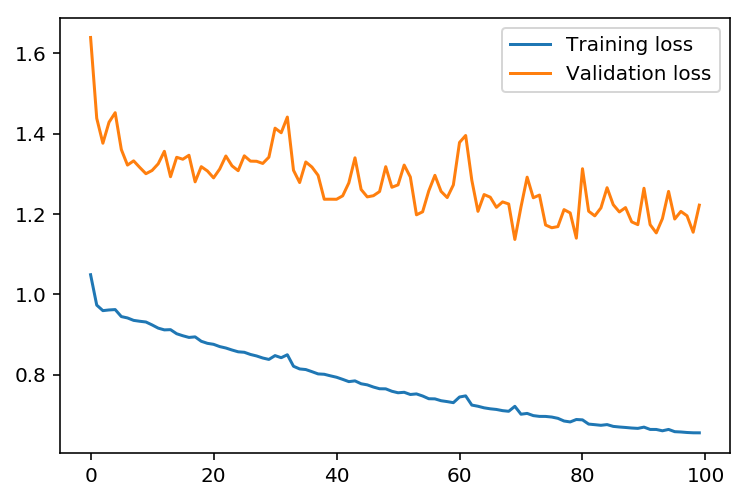

In [13]:
plt.plot(losses['train'], label='Training loss')
plt.plot(losses['validation'], label='Validation loss')
plt.legend()
plt.ylim()

## Check out your predictions

Here, use the test data to view how well your network is modeling the data. If something is completely wrong here, make sure each step in your network is implemented correctly.

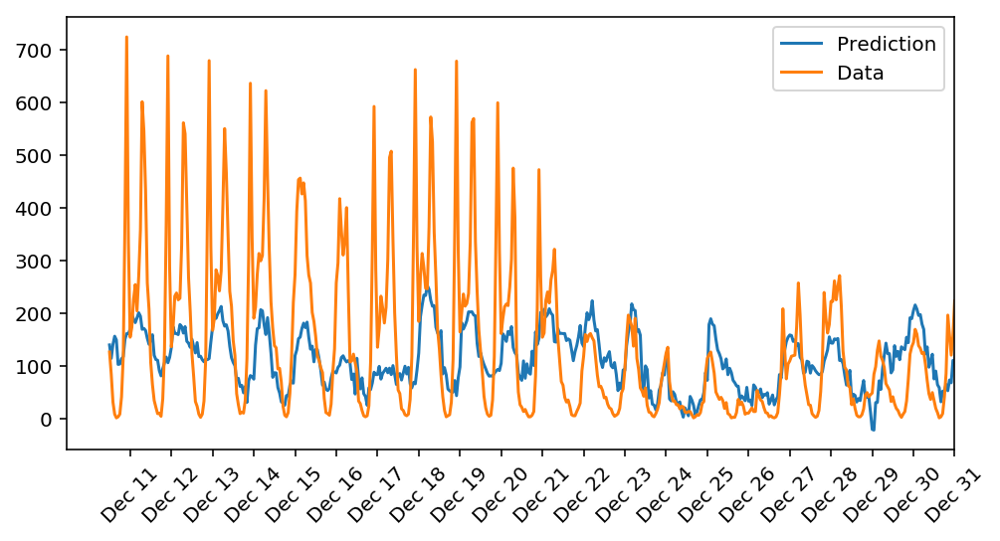

In [14]:
fig, ax = plt.subplots(figsize=(8,4))

mean, std = scaled_features['cnt']
predictions = network.run(test_features).T*std + mean
ax.plot(predictions[0], label='Prediction')
ax.plot((test_targets['cnt']*std + mean).values, label='Data')
ax.set_xlim(right=len(predictions))
ax.legend()

dates = pd.to_datetime(rides.ix[test_data.index]['dteday'])
dates = dates.apply(lambda d: d.strftime('%b %d'))
ax.set_xticks(np.arange(len(dates))[12::24])
_ = ax.set_xticklabels(dates[12::24], rotation=45)

## OPTIONAL: Thinking about your results(this question will not be evaluated in the rubric).
 
Answer these questions about your results. How well does the model predict the data? Where does it fail? Why does it fail where it does?

> **Note:** You can edit the text in this cell by double clicking on it. When you want to render the text, press control + enter

#### Your answer below

My code has passed all the test. I did experimented with hidden nodes and output nodes. When I increased the hidden layer to 5 and the output layer to 2. The validation line on the Training loss and the Validation loss chart was altered. Also if we now look at the new chart we have generated for h502neuralnetwork.jpg file the optomisation has increased. By carrying out this same processes. The Prediction is the optomisation will improve when we add more hidden nodes. This can be shown by looking at the the new h8o2validation.jpg. And also the new h802neuralnetwork.jpg
